# Introductory Options'24

# Hackathon Problem Statement

The goal of this problem statement is to design, implement, and backtest an options trading strategy. The objective is to combine your analytical and creative abilities to craft an efficient trading strategy. Use the insights and techniques learned during the course to optimize your results.

Below is a step-by-step guide to approaching the problem:

1. Read the Dataset
Select any stock listed in NIFTY 50 as the underlying asset for your strategy.
For NSE options data, you can use the NSE official website.
Link: https://www.nseindia.com/report-detail/fo_eq_security

2. Preprocess the Dataset
Preprocess the data you have obtained.
Handle any missing values using suitable technique (forward fill, interpolation
etc.).
Create new features that might be useful (lag variables, rolling statistics, spread
dynamics etc.).

3. Analyze the Stock with Indicators
Use a technical indicator or a combination of them of your choice to analyze the historical price movement of the stock and predict whether the underlying asset price will appreciate or decline.

4. Select the Option and Apply Strategy
Based on your forecast:
Decide whether to buy or sell an option of the underlying stock.
Implement any options trading strategy learned during the course (e.g., Straddle, Strangle, Bull Call Spread, etc.).

5. Risk Management
Incorporate risk management measures into your strategy to manage exposure effectively and minimize losses. Use tools such as stop-loss, position sizing, or other risk metrics.

6. Backtest the Strategy
Backtest your strategy on historical data for the timeframe 1st January 2022 to 29th December 2024.
Use relevant performance measures to analyze the effectiveness of your strategy (e.g., net returns, annual returns, Sharpe ratio, drawdown).
Assume no transaction costs and enough liquidity for simplification.
Compare the performance of different strategies.
For backtesting purpose, you can use libraries such as backtesting, backtrader etc.

# Roadmap

The given steps have been followed, in order to solve the Problem Statement of the Hackathon:-

1. Download the required Datasets, from the given link of NSE website. Choose any of the NIFTY50 stocks options for analysis.
I have chose the stock options of Reliance and have downloaded the data for both Call Option as well as Put Option, month-wise, for the time-period specified, in the problem statement of the Hackathon, from January 2022 to December 2024.

2. Install all the required libraries and modules, if not install before-hand and import them, in the coding environment.

3. Once the datasets are download, store them together in a single folder, which can be accessed either by path or by mounting Google Drive, while coding.

4. Access the datasets and load them in the coding environment.

5. Visualize the datasets, along with some basic information, such as Shape, Columns, Datatypes, Description (Statistical Summary), Null Values, etc..

6. Perform Data Pre-processing Operations, such as changing the datatypes of the columns, which would be necessary for further analysis and also treating the null values present in the datasets, mainly by interpolation, forward fill (ffill) and backward fill (bfill).

7. Perform Feature Engineering and create new features, which would be helpful for analysis. The features created include - Lag Variables, Rolling Statistics, Spread Dynamics, Relative Strenth Index (RSI), Simple Moving Averages (SMA), Exponential Moving Averages (EMA), Bollinger Bands, Change in Open Interest and its Ratio, Price Change Ratio, Ratio of Open Interest to Number of Contracts, Rolling Correlation, Volume - Weighted Average Price (VWAP), Implied Volatility Approximation, Historical Volatility, Normalized Volatility and Option Greeks.

8. Performed Technical Analysis.

9. Build 3 Machine Learning Models namely - Random Forest, Logistic Regression and XGBoost, by splitting the data into train_data and test_data and evaluated the performance of those 3 models, which would help in Technical Analysis of stocks options.

10. Option Trading Strategy is devised, by coding.

11. Risk Management is implemented.

12. Finally, Backtesting is performed on the data, ranging from January 1, 2022 to December 29, 2024, thereby, concluding this project.

In [138]:
# Importing the Necessary Libraries

# Libraries for Data Analysis and Data Visualization
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import plotly.graph_objects as go

# Libraries for Financial Analysis
import mplfinance as mpf
import pandas_ta as ta
from backtesting import Backtest
from backtesting import Strategy
from backtesting.lib import crossover

# Libraries for Machine Learning
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve, auc

# Library to maintain Clear Outputs
import warnings
warnings.filterwarnings("ignore")

# Other Libraries
import datetime as dt
import os
import sys
from glob import glob

In [4]:
# Loading all the Datasets

# Folder Path
df_reliance = "/content/drive/MyDrive/Options Data NSE"

# All dataset file paths in the form of a list
all_files = [os.path.join(df_reliance, f) for f in os.listdir(df_reliance) if f.endswith('.csv')]

# Loop through the list and load each dataset
for i, file in enumerate(all_files, start=1):
    print(f"Loading and displaying dataset {i}: {os.path.basename(file)}")
    df_reliance = pd.read_csv(file)

    # Printing all the dataset
    print(df_reliance)

    # Separator for Clarity in Output
    print("\n" + "="*50 + "\n")

Loading and displaying dataset 1: Reliance_January_2024_Monthly_CE.csv
      Symbol         Date       Expiry   Option type    Strike Price   Open    \
0     RELIANCE  01-Jan-2024  25-Jan-2024            CE          1840.0      -   
1     RELIANCE  01-Jan-2024  25-Jan-2024            CE          1860.0      -   
2     RELIANCE  01-Jan-2024  25-Jan-2024            CE          1880.0      -   
3     RELIANCE  01-Jan-2024  25-Jan-2024            CE          1900.0      -   
4     RELIANCE  01-Jan-2024  25-Jan-2024            CE          1920.0      -   
...        ...          ...          ...           ...             ...    ...   
1191  RELIANCE  25-Jan-2024  25-Jan-2024            CE          3080.0   0.05   
1192  RELIANCE  25-Jan-2024  25-Jan-2024            CE          3100.0   0.15   
1193  RELIANCE  25-Jan-2024  25-Jan-2024            CE          3120.0   0.15   
1194  RELIANCE  25-Jan-2024  25-Jan-2024            CE          3140.0   0.10   
1195  RELIANCE  25-Jan-2024  25-Jan-20

In [5]:
# Information about all the Datasets

"""
    The information includes the following:
    a. Columns of each dataset
    b. Datatypes of each column for every dataset (df.dtypes)
    c. Info about each dataset (df.info())
    d. Statistical Summary of each dataset (df.describe())
    e. Shape of each dataset (df.shape)
"""

# Folder Path
df_reliance = "/content/drive/MyDrive/Options Data NSE"

# All dataset file paths in the form of a list
all_files = [os.path.join(df_reliance, f) for f in os.listdir(df_reliance) if f.endswith('.csv')]

# Loop through and load each dataset
for i, file in enumerate(all_files, start=1):
    print(f"Processing dataset {i}: {os.path.basename(file)}")

    # Load the dataset
    df_reliance = pd.read_csv(file)

    # Print columns of the dataset
    print("\nColumns of the dataset:")
    print(df_reliance.columns.tolist())

    # Print datatypes of the columns
    print("\nDatatypes of the columns:")
    print(df_reliance.dtypes)

    # Info about the dataset
    print("\nDataset Info:")
    print(df_reliance.info())

    # Description of the dataset
    print("\nDataset Description:")
    print(df_reliance.describe())

    # Shape of the dataset
    print("\nDataset Shape:")
    print(df_reliance.shape)

    # Separator for Clarity in Output
    print("\n" + "="*50 + "\n")

Processing dataset 1: Reliance_January_2024_Monthly_CE.csv

Columns of the dataset:
['Symbol  ', 'Date  ', 'Expiry  ', 'Option type  ', 'Strike Price  ', 'Open  ', 'High  ', 'Low  ', 'Close  ', 'LTP  ', 'Settle Price  ', 'No. of contracts  ', 'Turnover * in  ₹ Lakhs', 'Premium Turnover ** in   ₹ Lakhs', 'Open Int  ', 'Change in OI  ', 'Underlying Value  ']

Datatypes of the columns:
Symbol                               object
Date                                 object
Expiry                               object
Option type                          object
Strike Price                        float64
Open                                 object
High                                 object
Low                                  object
Close                               float64
LTP                                  object
Settle Price                        float64
No. of contracts                     object
Turnover * in  ₹ Lakhs               object
Premium Turnover ** in   ₹ Lakhs     objec

In [46]:
# Data Cleaning

"""
    In this code cell, the following tasks have been performed:
    a. Stripping the column names of unncessary spaces, for clarity.
    b. Changing the datatypes of the columns, in order to carry out data preprocessing operations.
"""

# Folder Path
df_reliance = "/content/drive/MyDrive/Options Data NSE"

# All dataset file paths in the form of a list
all_files = [os.path.join(df_reliance, f) for f in os.listdir(df_reliance) if f.endswith('.csv')]

for file in all_files:
    print(f"Processing: {os.path.basename(file)}")

    # Load the dataset
    df_reliance = pd.read_csv(file)

    # Task 1: Get rid of unnecessary spaces from the Column names
    df_reliance.columns = df_reliance.columns.str.strip()

    # Print columns of the dataset, in order to verify
    print("\nColumns of the dataset:")
    print(df_reliance.columns.tolist())

    # Task 2: Change Datatypes of the Columns

    """
        Changing the datatypes to relevant datatypes, in order to carry out Data Preprocessing.
        The columns 'Date' and 'Expiry', in the given DataFrame shows Dates, which should be in the form of Date-Time.
        But, in the DataFrame, these columns are in the form of Object.
        So, changing their datatypes is required.
    """

    # Changing the Object dataype to Datetime datatype
    df_reliance['Date'] = pd.to_datetime(df_reliance['Date'])
    df_reliance['Expiry'] = pd.to_datetime(df_reliance['Expiry'])

    """
        Now, convert the other columns from object datatypes to float64 datatypes.
        Columns such as 'Open', 'High', 'Low', 'LTP', 'Settle Price', the columns of Turnover and Premium,
        which denotes the amount of price, i.e., currency values, should be in the form of Float, but instead they are
        in the form of object.
        Hence, the changing the datatype is necessary for data preprocessing.
        Also, some columns like -
        'No. of contracts', 'Open Int', 'Change in OI' are of object datatype.
        Although, they have integer data, so the datatype should be changed accordingly.
    """

    # Converting the Numerical Data of columns to float
    numeric_cols = ['Open', 'High', 'Low', 'LTP', 'Settle Price',
                    'Turnover * in  ₹ Lakhs', 'Premium Turnover ** in   ₹ Lakhs',
                    'No. of contracts', 'Open Int', 'Change in OI']

    for column in numeric_cols:
        df_reliance[column] = pd.to_numeric(df_reliance[column], errors='coerce')

    # Print datatypes of the columns, in order to verify
    print("\nDatatypes of the columns:")
    print(df_reliance.dtypes)

    # Separator for clarity
    print("\n" + "=" * 50 + "\n")

    # Overwrite the existing file with the cleaned dataset
    df_reliance.to_csv(file, index=False)
    print(f"File cleaned and saved: {os.path.basename(file)}")
    print("=" * 50)

Processing: Reliance_January_2024_Monthly_CE.csv

Columns of the dataset:
['Symbol', 'Date', 'Expiry', 'Option type', 'Strike Price', 'Open', 'High', 'Low', 'Close', 'LTP', 'Settle Price', 'No. of contracts', 'Turnover * in  ₹ Lakhs', 'Premium Turnover ** in   ₹ Lakhs', 'Open Int', 'Change in OI', 'Underlying Value']

Datatypes of the columns:
Symbol                                      object
Date                                datetime64[ns]
Expiry                              datetime64[ns]
Option type                                 object
Strike Price                               float64
Open                                       float64
High                                       float64
Low                                        float64
Close                                      float64
LTP                                        float64
Settle Price                               float64
No. of contracts                           float64
Turnover * in  ₹ Lakhs                    

In [7]:
# Check for Null Values

# Folder Path
df_reliance = "/content/drive/MyDrive/Options Data NSE"

# All dataset file paths in the form of a list
all_files = [os.path.join(df_reliance, f) for f in os.listdir(df_reliance) if f.endswith('.csv')]

#  Loop through and load each dataset
for i, file in enumerate(all_files, start=1):
    print(f"Processing dataset {i}: {os.path.basename(file)}")

    # Load the dataset
    df_reliance = pd.read_csv(file, na_values=[" ", "-", "NA", "N/A", "NULL"])

    # Check for null values
    print("\nNull Values in Dataset:")
    print(df_reliance.isnull().sum())

    # Separator for clarity
    print("\n" + "=" * 50 + "\n")

Processing dataset 1: Reliance_January_2024_Monthly_CE.csv

Null Values in Dataset:
Symbol                                0
Date                                  0
Expiry                                0
Option type                           0
Strike Price                          0
Open                                496
High                                496
Low                                 496
Close                                 0
LTP                                 368
Settle Price                          0
No. of contracts                    496
Turnover * in  ₹ Lakhs              496
Premium Turnover ** in   ₹ Lakhs    498
Open Int                            368
Change in OI                        519
Underlying Value                      0
dtype: int64


Processing dataset 2: Reliance_February_2024_Monthly_CE.csv

Null Values in Dataset:
Symbol                                0
Date                                  0
Expiry                                0
Option type     

In [39]:
# Treating Null Values

# Folder Path
df_reliance = "/content/drive/MyDrive/Options Data NSE"

# All dataset file paths in the form of a list
all_files = [os.path.join(df_reliance, f) for f in os.listdir(df_reliance) if f.endswith('.csv')]

for file in all_files:
    print(f"Processing: {os.path.basename(file)}")

    # Load the dataset
    df_reliance = pd.read_csv(file)

    # Treatment of Null Values
    for column in df_reliance.columns:
        if df_reliance[column].isnull().sum() > 0:
            if column in ['Open', 'High', 'Low', 'LTP', 'Settle Price', 'Open Int']:
                # Use Interpolation
                df_reliance[column] = df_reliance[column].interpolate(method = 'linear', limit_direction = 'both')
            elif column in ['No. of contracts', 'Turnover * in ₹ Lakhs', 'Premium Turnover ** in ₹ Lakhs', 'Change in OI']:
                # Use forward fill (ffill) as well as backward fill (bfill)
                df_reliance[column] = df_reliance[column].fillna(method = 'ffill').fillna(method = 'bfill')
            else:
                df_reliance[column] = df_reliance[column].fillna(df_reliance[column].mean())

    """
        The columns of 'Open', 'High', 'Low', 'LTP', 'Settle Price' are filled by Interpolation.
        It is so because, price tends to follow a continuous trend and interpolation is apt for filling gaps in such data.
        The columns of 'No. of contracts', 'Turnover * in ₹ Lakhs', 'Premium Turnover ** in ₹ Lakhs', are filled by ffill.
        Such columns are filled by forward fill as these values might be repeated over short intervals and
            forward fill (ffill) helps to maintain consistency without any abrupt changes.
        The column of 'Open Int' is treated by Interpolation as it captures gradual changes.
        In case of 'Change in OI', forward fill is used as it is effective for shorter gaps in sequential data.
        For filling of interpolation,
            limit_direction = 'both' has been used in the interpolate method to handle edge cases
            where null values appear at the start or end of the column.
        In case of columns treated with forward fill (ffill),
            backward fill (bfill) is applied as a fallback to handle cases
            where null values might exist at the beginning of the column.
    """

    # Check for Null Values, for verification purpose:
    print("\nNull Values in Dataset:") # This line was incorrectly indented
    print(df_reliance.isnull().sum())

    # Separator for clarity
    print("\n" + "=" * 50 + "\n")

    # Overwrite the existing file with the cleaned dataset
    df_reliance.to_csv(file, index=False)
    print(f"File cleaned and saved: {os.path.basename(file)}")
    print("=" * 50)

Processing: Reliance_January_2024_Monthly_CE.csv

Null Values in Dataset:
Symbol                              0
Date                                0
Expiry                              0
Option type                         0
Strike Price                        0
Open                                0
High                                0
Low                                 0
Close                               0
LTP                                 0
Settle Price                        0
No. of contracts                    0
Turnover * in  ₹ Lakhs              0
Premium Turnover ** in   ₹ Lakhs    0
Open Int                            0
Change in OI                        0
Underlying Value                    0
dtype: int64


File cleaned and saved: Reliance_January_2024_Monthly_CE.csv
Processing: Reliance_February_2024_Monthly_CE.csv

Null Values in Dataset:
Symbol                              0
Date                                0
Expiry                              0
Option type    

In [71]:
# Creating the New Datasets by Merging the Original ones for further operation

# Specifying the Path of the Folder, containing all the necessary Datasets
folder_path = "/content/drive/MyDrive/Options Data NSE"

# Function to Merge the Original Datasets and Create New Datasets
def merge_datasets(option_type, years, folder_path):

    """
        Datasets have been merged on the basis of Years as well as Option Types.

        Parameters:
            option_type (str): "CE" for Call Options or "PE" for Put Options
            years (list): List of years to include in the merge (e.g., [2022, 2023, 2024]).
            folder_path (str): Path to the folder containing datasets.

        Returns:
            pd.DataFrame: Merged DataFrame of specified datasets.
    """

    all_files = glob(os.path.join(folder_path, "*.csv"))
    merged_df = pd.DataFrame()

    for year in years:
        for file in all_files:
            if f"_{year}_" in file and (option_type is None or file.endswith(f"_{option_type}.csv")):
                df = pd.read_csv(file, parse_dates=["Date", "Expiry"])
                merged_df = pd.concat([merged_df, df], ignore_index=True)

    return merged_df

# Merge the Original Datasets and Create New ones

# Datasets for Year-wise Call Operations
df_ce_2022 = merge_datasets("CE", [2022], folder_path)
df_ce_2023 = merge_datasets("CE", [2023], folder_path)
df_ce_2024 = merge_datasets("CE", [2024], folder_path)

# Datasets for Year-wise Put Operations
df_pe_2022 = merge_datasets("PE", [2022], folder_path)
df_pe_2023 = merge_datasets("PE", [2023], folder_path)
df_pe_2024 = merge_datasets("PE", [2024], folder_path)

# Complete Dataset for Call Option
df_ce_all = merge_datasets("CE", [2022, 2023, 2024], folder_path)

# Complete Dataset for Put Operation
df_pe_all = merge_datasets("PE", [2022, 2023, 2024], folder_path)

# Datasets for Year-wise Combined Options (Call Options as well as Put Options)
df_ce_pe_2022 = merge_datasets(None, [2022], folder_path)
df_ce_pe_2023 = merge_datasets(None, [2023], folder_path)
df_ce_pe_2024 = merge_datasets(None, [2024], folder_path)

# The Mega Datasets (Containing Call as well as Put Options Data for Reliance Stocks from January 2022 to December 2024)
df_options_combo = merge_datasets(None, [2022, 2023, 2024], folder_path)

# Save the Datasets in the Drive

# Specify the directory to save the datasets
save_dir = '/content/drive/MyDrive/Merged Options Data NSE'  # Adjust the path as needed
os.makedirs(save_dir, exist_ok=True)  # Create the directory if it doesn't exist

# Function to save a DataFrame to a CSV file
def save_dataset(df, filename):
    filepath = os.path.join(save_dir, filename)
    df.to_csv(filepath, index=False)
    print(f"Dataset saved to: {filepath}")

# Save the datasets
save_dataset(df_ce_2022, 'df_ce_2022.csv')
save_dataset(df_ce_2023, 'df_ce_2023.csv')
save_dataset(df_ce_2024, 'df_ce_2024.csv')
save_dataset(df_pe_2022, 'df_pe_2022.csv')
save_dataset(df_pe_2023, 'df_pe_2023.csv')
save_dataset(df_pe_2024, 'df_pe_2024.csv')
save_dataset(df_ce_all, 'df_ce_all.csv')
save_dataset(df_pe_all, 'df_pe_all.csv')
save_dataset(df_ce_pe_2022, 'df_ce_pe_2022.csv')
save_dataset(df_ce_pe_2023, 'df_ce_pe_2023.csv')
save_dataset(df_ce_pe_2024, 'df_ce_pe_2024.csv')
save_dataset(df_options_combo, 'df_options_combo.csv')

Dataset saved to: /content/drive/MyDrive/Merged Options Data NSE/df_ce_2022.csv
Dataset saved to: /content/drive/MyDrive/Merged Options Data NSE/df_ce_2023.csv
Dataset saved to: /content/drive/MyDrive/Merged Options Data NSE/df_ce_2024.csv
Dataset saved to: /content/drive/MyDrive/Merged Options Data NSE/df_pe_2022.csv
Dataset saved to: /content/drive/MyDrive/Merged Options Data NSE/df_pe_2023.csv
Dataset saved to: /content/drive/MyDrive/Merged Options Data NSE/df_pe_2024.csv
Dataset saved to: /content/drive/MyDrive/Merged Options Data NSE/df_ce_all.csv
Dataset saved to: /content/drive/MyDrive/Merged Options Data NSE/df_pe_all.csv
Dataset saved to: /content/drive/MyDrive/Merged Options Data NSE/df_ce_pe_2022.csv
Dataset saved to: /content/drive/MyDrive/Merged Options Data NSE/df_ce_pe_2023.csv
Dataset saved to: /content/drive/MyDrive/Merged Options Data NSE/df_ce_pe_2024.csv
Dataset saved to: /content/drive/MyDrive/Merged Options Data NSE/df_options_combo.csv


# Visualize the Created Datasets

In [14]:
# Call Options for 2022
df_ce_2022

,Symbol,Date,Expiry,Option type,Strike Price,Open,High,Low,Close,LTP,Settle Price,No. of contracts,Turnover * in ₹ Lakhs,Premium Turnover ** in ₹ Lakhs,Open Int,Change in OI,Underlying Value
0,RELIANCE,2022-01-03,2022-01-27,CE,1800.0,397.0000,397.0000,397.00,523.00,523.00,608.6,2.0,23162.666319,294.426574,5250.0,-2500.0,2403.85
1,RELIANCE,2022-01-03,2022-01-27,CE,1820.0,397.0000,397.0000,397.00,799.25,510.40,588.7,2.0,23162.666319,294.426574,4925.0,-2500.0,2403.85
2,RELIANCE,2022-01-03,2022-01-27,CE,1840.0,397.0000,397.0000,397.00,780.00,497.80,568.8,2.0,23162.666319,294.426574,4600.0,-2500.0,2403.85
3,RELIANCE,2022-01-03,2022-01-27,CE,1860.0,397.0000,397.0000,397.00,760.85,485.20,548.9,2.0,23162.666319,294.426574,4275.0,-2500.0,2403.85
4,RELIANCE,2022-01-03,2022-01-27,CE,1880.0,397.0000,397.0000,397.00,741.80,472.60,529.0,2.0,23162.666319,294.426574,3950.0,-2500.0,2403.85
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13894,RELIANCE,2022-12-29,2022-12-29,CE,3140.0,0.0750,0.0750,0.05,0.10,0.10,2543.3,18.0,22198.148178,219.485299,13750.0,-4000.0,2543.30
13895,RELIANCE,2022-12-29,2022-12-29,CE,3160.0,0.0625,0.0625,0.05,0.15,0.15,2543.3,18.0,22198.148178,219.485299,12500.0,-4000.0,2543.30
13896,RELIANCE,2022-12-29,2022-12-29,CE,3180.0,0.0500,0.0500,0.05,0.05,0.05,2543.3,4.0,31.800000,219.485299,7500.0,-1000.0,2543.30
13897,RELIANCE,2022-12-29,2022-12-29,CE,3200.0,0.0500,0.9500,0.05,0.05,0.05,2543.3,24.0,192.010000,0.010000,36750.0,-3750.0,2543.30


In [15]:
# Statistical Summary of Call Options Data for 2022
df_ce_2022.describe().T

,count,mean,min,25%,50%,75%,max,std
Date,13899,2022-06-20 13:57:13.714655744,2022-01-03 00:00:00,2022-03-24 00:00:00,2022-06-10 00:00:00,2022-10-04 00:00:00,2022-12-29 00:00:00,NaN
Expiry,13899,2022-07-03 10:45:39.823009024,2022-01-27 00:00:00,2022-03-31 00:00:00,2022-06-30 00:00:00,2022-10-27 00:00:00,2022-12-29 00:00:00,NaN
Strike Price,13899.0,2529.091302,1800.0,2200.0,2540.0,2860.0,3220.0,391.86967
Open,13899.0,136.385003,0.05,2.45,49.3,236.95,1005.0,173.325537
High,13899.0,142.685657,0.05,2.929167,60.0,246.4,1013.0,175.718442
Low,13899.0,130.028704,0.05,1.8,39.4,225.100962,997.0,170.75065
Close,13899.0,181.308972,0.05,3.375,59.95,318.85,1000.0,224.426924
LTP,13899.0,180.914244,0.05,2.15,55.5,333.2,1000.0,225.74262
Settle Price,13899.0,311.957349,0.05,2.8,82.35,399.05,2819.85,574.961953
No. of contracts,13899.0,2408.716526,1.0,11.0,142.0,1237.0,104428.0,6564.709659


In [16]:
# Call Options for 2023
df_ce_2023

,Symbol,Date,Expiry,Option type,Strike Price,Open,High,Low,Close,LTP,Settle Price,No. of contracts,Turnover * in ₹ Lakhs,Premium Turnover ** in ₹ Lakhs,Open Int,Change in OI,Underlying Value
0,RELIANCE,2023-01-02,2023-01-25,CE,1920.0,475.35,475.35,475.35,571.55,604.00,664.00,1.0,21363.247436,211.986949,500.0,-250.0,2575.90
1,RELIANCE,2023-01-02,2023-01-25,CE,1920.0,475.35,475.35,475.35,571.55,604.00,664.00,1.0,21363.247436,211.986949,500.0,-250.0,2575.90
2,RELIANCE,2023-01-02,2023-01-25,CE,1940.0,475.35,475.35,475.35,604.00,604.00,644.10,1.0,21363.247436,211.986949,500.0,-250.0,2575.90
3,RELIANCE,2023-01-02,2023-01-25,CE,1940.0,475.35,475.35,475.35,604.00,604.00,644.10,1.0,21363.247436,211.986949,500.0,-250.0,2575.90
4,RELIANCE,2023-01-02,2023-01-25,CE,1960.0,475.35,475.35,475.35,535.40,591.20,624.20,1.0,21363.247436,211.986949,900.0,-250.0,2575.90
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12272,RELIANCE,2023-12-28,2023-12-28,CE,2880.0,0.10,0.25,0.05,0.15,0.15,2605.55,274.0,37046.136847,379.573934,8000.0,-55250.0,2605.55
12273,RELIANCE,2023-12-28,2023-12-28,CE,2900.0,0.05,0.25,0.05,0.05,0.05,2605.55,189.0,1370.300000,0.050000,41500.0,-21750.0,2605.55
12274,RELIANCE,2023-12-28,2023-12-28,CE,2920.0,0.05,0.05,0.05,0.05,0.05,2605.55,1.0,7.300000,379.573934,4500.0,-21750.0,2605.55
12275,RELIANCE,2023-12-28,2023-12-28,CE,2940.0,0.05,0.05,0.05,0.05,0.05,2605.55,61.0,448.360000,0.010000,11000.0,-15000.0,2605.55


In [17]:
# Statistical Summary of Call Options Data for 2023
df_ce_2023.describe().T

,count,mean,min,25%,50%,75%,max,std
Date,12277,2023-06-26 06:26:49.839537408,2023-01-02 00:00:00,2023-03-21 00:00:00,2023-06-26 00:00:00,2023-09-28 00:00:00,2023-12-28 00:00:00,NaN
Expiry,12277,2023-07-09 03:19:51.985012736,2023-01-25 00:00:00,2023-03-29 00:00:00,2023-06-29 00:00:00,2023-09-28 00:00:00,2023-12-28 00:00:00,NaN
Strike Price,12277.0,2448.79205,1800.0,2180.0,2440.0,2720.0,3220.0,332.382538
Open,12277.0,102.86828,0.05,1.6,37.0,179.9,785.0,129.729981
High,12277.0,106.918915,0.05,1.85,43.2,186.675,785.0,131.732644
Low,12277.0,98.86873,0.05,1.2,29.369231,174.236364,770.0,128.399671
Close,12277.0,147.468934,0.05,1.75,40.95,259.25,775.15,189.655778
LTP,12277.0,117.802549,0.05,1.4,34.5,213.0,770.0,148.632224
Settle Price,12277.0,274.289806,0.05,1.75,63.45,322.0,2841.8,551.740503
No. of contracts,12277.0,2889.527083,1.0,12.0,102.0,1332.0,133339.0,7808.021551


In [18]:
# Call Options for 2024
df_ce_2024

,Symbol,Date,Expiry,Option type,Strike Price,Open,High,Low,Close,LTP,Settle Price,No. of contracts,Turnover * in ₹ Lakhs,Premium Turnover ** in ₹ Lakhs,Open Int,Change in OI,Underlying Value
0,RELIANCE,2024-01-01,2024-01-25,CE,1840.0,505.00,505.00,505.00,424.80,505.00,758.40,1.0,38533.707314,404.108696,12250.0,-250.0,2590.25
1,RELIANCE,2024-01-01,2024-01-25,CE,1860.0,505.00,505.00,505.00,406.40,505.00,738.50,1.0,38533.707314,404.108696,12250.0,-250.0,2590.25
2,RELIANCE,2024-01-01,2024-01-25,CE,1880.0,505.00,505.00,505.00,388.25,505.00,718.60,1.0,38533.707314,404.108696,12250.0,-250.0,2590.25
3,RELIANCE,2024-01-01,2024-01-25,CE,1900.0,505.00,505.00,505.00,370.30,505.00,698.65,1.0,38533.707314,404.108696,12250.0,-250.0,2590.25
4,RELIANCE,2024-01-01,2024-01-25,CE,1920.0,505.00,505.00,505.00,352.65,505.00,678.75,1.0,38533.707314,404.108696,12250.0,-250.0,2590.25
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11806,RELIANCE,2024-12-26,2024-12-26,CE,1480.0,0.05,0.10,0.05,0.05,0.05,1216.55,83.0,614.220000,0.020000,124000.0,-31500.0,1216.55
11807,RELIANCE,2024-12-26,2024-12-26,CE,1500.0,0.05,0.10,0.05,0.05,0.05,1216.55,2653.0,19898.290000,0.790000,2267500.0,-91000.0,1216.55
11808,RELIANCE,2024-12-26,2024-12-26,CE,1520.0,0.05,0.10,0.05,0.05,0.05,1216.55,753.0,5722.990000,0.190000,325500.0,-79500.0,1216.55
11809,RELIANCE,2024-12-26,2024-12-26,CE,1580.0,0.05,0.05,0.05,0.05,0.05,1216.55,17.0,134.300000,334.689756,16500.0,-500.0,1216.55


In [19]:
# Statistical Summary of Call Options Data for 2024
df_ce_2024.describe().T

,count,mean,min,25%,50%,75%,max,std
Date,11811,2024-06-23 00:59:22.509524992,2024-01-01 00:00:00,2024-03-12 00:00:00,2024-06-21 00:00:00,2024-10-01 00:00:00,2024-12-26 00:00:00,NaN
Expiry,11811,2024-07-05 21:13:05.471170816,2024-01-25 00:00:00,2024-03-28 00:00:00,2024-06-27 00:00:00,2024-10-31 00:00:00,2024-12-26 00:00:00,NaN
Strike Price,11811.0,2594.837016,1000.0,2340.0,2760.0,3080.0,3680.0,660.771619
Open,11811.0,127.107637,0.05,3.05,45.6,197.8,980.0,170.217456
High,11811.0,133.393341,0.05,3.7,54.7,209.1,980.0,173.139178
Low,11811.0,120.539605,0.05,2.1,35.4,187.1625,960.0,168.311092
Close,11811.0,140.88051,0.05,2.6,46.35,229.15,1032.05,187.188736
LTP,11811.0,138.331701,0.05,2.55,45.0,228.875,973.85,182.195032
Settle Price,11811.0,284.334136,0.05,3.35,63.0,305.2,3061.1,594.532606
No. of contracts,11811.0,3728.070104,1.0,30.0,390.0,3075.5,146641.0,8391.01578


In [20]:
# Put Options for 2022
df_pe_2022

,Symbol,Date,Expiry,Option type,Strike Price,Open,High,Low,Close,LTP,Settle Price,No. of contracts,Turnover * in ₹ Lakhs,Premium Turnover ** in ₹ Lakhs,Open Int,Change in OI,Underlying Value
0,RELIANCE,2022-01-03,2022-01-27,PE,1800.0,2.00,2.40,1.45,1.80,2.0,1.80,111.0,500.000000,0.500000,43000.0,6000.0,2403.85
1,RELIANCE,2022-01-03,2022-01-27,PE,1820.0,2.05,2.40,1.54,3.20,2.0,0.10,111.0,10162.319318,110.641597,47150.0,6000.0,2403.85
2,RELIANCE,2022-01-03,2022-01-27,PE,1840.0,2.10,2.40,1.63,3.80,2.0,0.10,111.0,10162.319318,110.641597,51300.0,6000.0,2403.85
3,RELIANCE,2022-01-03,2022-01-27,PE,1860.0,2.15,2.40,1.72,4.45,2.0,0.15,111.0,10162.319318,110.641597,55450.0,6000.0,2403.85
4,RELIANCE,2022-01-03,2022-01-27,PE,1880.0,2.20,2.40,1.81,5.20,2.0,0.25,111.0,10162.319318,110.641597,59600.0,6000.0,2403.85
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13990,RELIANCE,2022-12-29,2022-12-29,PE,3140.0,610.05,611.85,604.70,777.40,604.7,2543.30,11.0,11356.981427,113.398515,1600.0,-500.0,2543.30
13991,RELIANCE,2022-12-29,2022-12-29,PE,3160.0,629.20,630.40,624.80,796.25,624.8,2543.30,11.0,11356.981427,113.398515,1150.0,-500.0,2543.30
13992,RELIANCE,2022-12-29,2022-12-29,PE,3180.0,648.35,648.95,644.90,815.25,644.9,2543.30,11.0,11356.981427,113.398515,700.0,-500.0,2543.30
13993,RELIANCE,2022-12-29,2022-12-29,PE,3200.0,667.50,667.50,665.00,665.00,665.0,2543.30,19.0,183.690000,31.690000,250.0,-4500.0,2543.30


In [21]:
# Statistical Summary of Put Options Data for 2022
df_pe_2022.describe().T

,count,mean,min,25%,50%,75%,max,std
Date,13995,2022-07-03 22:22:33.569132032,2022-01-03 00:00:00,2022-03-24 00:00:00,2022-07-06 00:00:00,2022-10-03 00:00:00,2022-12-29 00:00:00,NaN
Expiry,13995,2022-07-16 21:06:31.254019328,2022-01-27 00:00:00,2022-03-31 00:00:00,2022-07-28 00:00:00,2022-10-27 00:00:00,2022-12-29 00:00:00,NaN
Strike Price,13995.0,2539.815648,1800.0,2200.0,2540.0,2880.0,3220.0,389.218931
Open,13995.0,131.806197,0.05,2.3,54.6,232.919444,792.0,159.443323
High,13995.0,138.573503,0.05,2.8,66.4,243.957639,793.0,162.354113
Low,13995.0,126.071165,0.05,1.6,43.8,223.76875,792.0,157.496461
Close,13995.0,185.085138,0.05,5.2,68.9,339.05,853.3,219.936068
LTP,13995.0,170.59537,0.05,2.05,63.65,308.775,831.0,206.430948
Settle Price,13995.0,314.032345,0.05,2.6,100.7,415.55,2634.75,559.132599
No. of contracts,13995.0,1156.460807,1.0,8.0,56.0,643.0,105233.0,3241.1648


In [22]:
# Put Options for 2023
df_pe_2023

,Symbol,Date,Expiry,Option type,Strike Price,Open,High,Low,Close,LTP,Settle Price,No. of contracts,Turnover * in ₹ Lakhs,Premium Turnover ** in ₹ Lakhs,Open Int,Change in OI,Underlying Value
0,RELIANCE,2023-01-02,2023-01-25,PE,1920.0,1.15,1.15,0.80,9.80,0.85,0.05,139.0,10808.181240,116.175211,45500.0,500.0,2575.90
1,RELIANCE,2023-01-02,2023-01-25,PE,1920.0,1.15,1.15,0.80,9.80,0.85,0.05,139.0,10808.181240,116.175211,45500.0,500.0,2575.90
2,RELIANCE,2023-01-02,2023-01-25,PE,1940.0,1.15,1.15,0.80,11.35,0.85,0.05,139.0,10808.181240,116.175211,45500.0,500.0,2575.90
3,RELIANCE,2023-01-02,2023-01-25,PE,1940.0,1.15,1.15,0.80,11.35,0.85,0.05,139.0,10808.181240,116.175211,45500.0,500.0,2575.90
4,RELIANCE,2023-01-02,2023-01-25,PE,1960.0,1.15,1.15,0.80,13.05,0.85,0.05,139.0,10808.181240,116.175211,45500.0,500.0,2575.90
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12272,RELIANCE,2023-12-28,2023-12-28,PE,2880.0,275.62,275.62,272.52,505.65,280.80,2605.55,180.0,15991.494169,128.498769,13650.0,37250.0,2605.55
12273,RELIANCE,2023-12-28,2023-12-28,PE,2900.0,291.90,291.90,291.90,291.90,291.90,2605.55,2.0,15.960000,1.460000,500.0,500.0,2605.55
12274,RELIANCE,2023-12-28,2023-12-28,PE,2920.0,291.90,291.90,291.90,542.70,291.90,2605.55,2.0,15991.494169,128.498769,500.0,500.0,2605.55
12275,RELIANCE,2023-12-28,2023-12-28,PE,2940.0,291.90,291.90,291.90,561.40,291.90,2605.55,2.0,15991.494169,128.498769,500.0,500.0,2605.55


In [23]:
# Statistical Summary of Put Options Data for 2023
df_pe_2023.describe().T

,count,mean,min,25%,50%,75%,max,std
Date,12277,2023-06-26 06:26:49.839537408,2023-01-02 00:00:00,2023-03-21 00:00:00,2023-06-26 00:00:00,2023-09-28 00:00:00,2023-12-28 00:00:00,NaN
Expiry,12277,2023-07-09 03:19:51.985012736,2023-01-25 00:00:00,2023-03-29 00:00:00,2023-06-29 00:00:00,2023-09-28 00:00:00,2023-12-28 00:00:00,NaN
Strike Price,12277.0,2448.813228,1800.0,2180.0,2440.0,2720.0,3220.0,332.375948
Open,12277.0,124.783408,0.05,1.45,44.2,214.640909,815.0,159.083984
High,12277.0,129.657168,0.05,1.75,53.0,221.0,815.0,161.2992
Low,12277.0,120.455687,0.05,1.05,36.75,208.4625,815.0,157.449939
Close,12277.0,140.265456,0.05,1.95,38.0,247.8,815.0,180.452516
LTP,12277.0,138.575629,0.05,1.11,34.5,235.0,815.0,182.963012
Settle Price,12277.0,282.800145,0.05,1.55,74.1,329.75,2841.8,552.370464
No. of contracts,12277.0,1392.958622,1.0,8.0,49.0,651.0,46995.0,3649.245247


In [24]:
# Put Options for 2024
df_pe_2024

,Symbol,Date,Expiry,Option type,Strike Price,Open,High,Low,Close,LTP,Settle Price,No. of contracts,Turnover * in ₹ Lakhs,Premium Turnover ** in ₹ Lakhs,Open Int,Change in OI,Underlying Value
0,RELIANCE,2024-01-01,2024-01-25,PE,1840.0,1.45,1.45,0.85,5.55,1.10,0.05,65.0,18074.270435,162.090501,5750.0,2250.0,2590.25
1,RELIANCE,2024-01-01,2024-01-25,PE,1860.0,1.45,1.45,0.85,6.80,1.10,0.05,65.0,18074.270435,162.090501,5750.0,2250.0,2590.25
2,RELIANCE,2024-01-01,2024-01-25,PE,1880.0,1.45,1.45,0.85,8.25,1.10,0.05,65.0,18074.270435,162.090501,5750.0,2250.0,2590.25
3,RELIANCE,2024-01-01,2024-01-25,PE,1900.0,1.45,1.45,0.85,9.95,1.10,0.05,65.0,18074.270435,162.090501,5750.0,2250.0,2590.25
4,RELIANCE,2024-01-01,2024-01-25,PE,1920.0,1.45,1.45,0.85,11.95,1.10,0.05,65.0,18074.270435,162.090501,5750.0,2250.0,2590.25
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11680,RELIANCE,2024-12-26,2024-12-26,PE,1450.0,226.45,237.50,224.00,236.30,235.50,1216.55,1066.0,8956.910000,1228.400000,215000.0,-326500.0,1216.55
11681,RELIANCE,2024-12-26,2024-12-26,PE,1460.0,234.00,246.85,234.00,246.05,246.85,1216.55,224.0,1902.460000,267.260000,33000.0,-97000.0,1216.55
11682,RELIANCE,2024-12-26,2024-12-26,PE,1480.0,256.65,268.45,255.00,268.00,268.00,1216.55,63.0,548.070000,81.870000,73000.0,-20500.0,1216.55
11683,RELIANCE,2024-12-26,2024-12-26,PE,1500.0,276.65,287.35,273.80,285.35,286.00,1216.55,2723.0,24225.110000,3802.610000,665500.0,-759500.0,1216.55


In [25]:
# Statistical Summary of Put Options Data for 2024
df_pe_2024.describe().T

,count,mean,min,25%,50%,75%,max,std
Date,11685,2024-06-21 23:31:09.781771520,2024-01-01 00:00:00,2024-03-12 00:00:00,2024-06-21 00:00:00,2024-09-26 00:00:00,2024-12-26 00:00:00,NaN
Expiry,11685,2024-07-04 20:31:51.373555712,2024-01-25 00:00:00,2024-03-28 00:00:00,2024-06-27 00:00:00,2024-09-26 00:00:00,2024-12-26 00:00:00,NaN
Strike Price,11685.0,2579.852803,1000.0,2340.0,2740.0,3060.0,3640.0,655.641827
Open,11685.0,99.445877,0.05,1.8,30.65,169.85,726.9,130.885053
High,11685.0,106.266207,0.05,2.25,40.0,182.35,746.85,134.300231
Low,11685.0,93.184039,0.05,1.2,22.276923,157.05,715.0,127.934158
Close,11685.0,118.853017,0.05,2.1,34.95,188.75,947.2,168.653472
LTP,11685.0,104.72721,0.05,1.5,27.1,185.55,739.0,137.562718
Settle Price,11685.0,242.409501,0.05,1.65,39.55,232.95,3061.1,585.031357
No. of contracts,11685.0,1860.303723,1.0,18.0,133.0,1465.0,68800.0,4180.747284


In [26]:
# Call Options Data
df_ce_all

,Symbol,Date,Expiry,Option type,Strike Price,Open,High,Low,Close,LTP,Settle Price,No. of contracts,Turnover * in ₹ Lakhs,Premium Turnover ** in ₹ Lakhs,Open Int,Change in OI,Underlying Value
0,RELIANCE,2022-01-03,2022-01-27,CE,1800.0,397.00,397.00,397.00,523.00,523.00,608.60,2.0,23162.666319,294.426574,5250.0,-2500.0,2403.85
1,RELIANCE,2022-01-03,2022-01-27,CE,1820.0,397.00,397.00,397.00,799.25,510.40,588.70,2.0,23162.666319,294.426574,4925.0,-2500.0,2403.85
2,RELIANCE,2022-01-03,2022-01-27,CE,1840.0,397.00,397.00,397.00,780.00,497.80,568.80,2.0,23162.666319,294.426574,4600.0,-2500.0,2403.85
3,RELIANCE,2022-01-03,2022-01-27,CE,1860.0,397.00,397.00,397.00,760.85,485.20,548.90,2.0,23162.666319,294.426574,4275.0,-2500.0,2403.85
4,RELIANCE,2022-01-03,2022-01-27,CE,1880.0,397.00,397.00,397.00,741.80,472.60,529.00,2.0,23162.666319,294.426574,3950.0,-2500.0,2403.85
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37982,RELIANCE,2024-12-26,2024-12-26,CE,1480.0,0.05,0.10,0.05,0.05,0.05,1216.55,83.0,614.220000,0.020000,124000.0,-31500.0,1216.55
37983,RELIANCE,2024-12-26,2024-12-26,CE,1500.0,0.05,0.10,0.05,0.05,0.05,1216.55,2653.0,19898.290000,0.790000,2267500.0,-91000.0,1216.55
37984,RELIANCE,2024-12-26,2024-12-26,CE,1520.0,0.05,0.10,0.05,0.05,0.05,1216.55,753.0,5722.990000,0.190000,325500.0,-79500.0,1216.55
37985,RELIANCE,2024-12-26,2024-12-26,CE,1580.0,0.05,0.05,0.05,0.05,0.05,1216.55,17.0,134.300000,334.689756,16500.0,-500.0,1216.55


In [27]:
# Statistical Summary of Call Options Data
df_ce_all.describe().T

,count,mean,min,25%,50%,75%,max,std
Date,37987,2023-06-03 10:22:51.690315264,2022-01-03 00:00:00,2022-08-05 00:00:00,2023-05-22 00:00:00,2024-02-26 00:00:00,2024-12-26 00:00:00,NaN
Expiry,37987,2023-06-16 07:01:59.314502144,2022-01-27 00:00:00,2022-08-25 00:00:00,2023-05-25 00:00:00,2024-02-29 00:00:00,2024-12-26 00:00:00,NaN
Strike Price,37987.0,2523.581225,1000.0,2200.0,2560.0,2880.0,3680.0,480.657446
Open,37987.0,122.668211,0.05,2.25,43.75,203.878693,1005.0,160.125461
High,37987.0,128.237034,0.05,2.65,52.35,212.8125,1013.0,162.655226
Low,37987.0,117.007756,0.05,1.6,34.576923,194.55,997.0,158.034725
Close,37987.0,157.802122,0.05,2.45,49.4,266.1,1032.05,203.155038
LTP,37987.0,147.27735,0.05,1.9,44.8,253.3,1000.0,191.896338
Settle Price,37987.0,291.194925,0.05,2.5,69.0,343.65,3061.1,574.011426
No. of contracts,37987.0,2974.325717,1.0,15.0,170.0,1782.0,146641.0,7593.163479


In [28]:
# Put Options Data
df_pe_all

,Symbol,Date,Expiry,Option type,Strike Price,Open,High,Low,Close,LTP,Settle Price,No. of contracts,Turnover * in ₹ Lakhs,Premium Turnover ** in ₹ Lakhs,Open Int,Change in OI,Underlying Value
0,RELIANCE,2022-01-03,2022-01-27,PE,1800.0,2.00,2.40,1.45,1.80,2.00,1.80,111.0,500.000000,0.500000,43000.0,6000.0,2403.85
1,RELIANCE,2022-01-03,2022-01-27,PE,1820.0,2.05,2.40,1.54,3.20,2.00,0.10,111.0,10162.319318,110.641597,47150.0,6000.0,2403.85
2,RELIANCE,2022-01-03,2022-01-27,PE,1840.0,2.10,2.40,1.63,3.80,2.00,0.10,111.0,10162.319318,110.641597,51300.0,6000.0,2403.85
3,RELIANCE,2022-01-03,2022-01-27,PE,1860.0,2.15,2.40,1.72,4.45,2.00,0.15,111.0,10162.319318,110.641597,55450.0,6000.0,2403.85
4,RELIANCE,2022-01-03,2022-01-27,PE,1880.0,2.20,2.40,1.81,5.20,2.00,0.25,111.0,10162.319318,110.641597,59600.0,6000.0,2403.85
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37952,RELIANCE,2024-12-26,2024-12-26,PE,1450.0,226.45,237.50,224.00,236.30,235.50,1216.55,1066.0,8956.910000,1228.400000,215000.0,-326500.0,1216.55
37953,RELIANCE,2024-12-26,2024-12-26,PE,1460.0,234.00,246.85,234.00,246.05,246.85,1216.55,224.0,1902.460000,267.260000,33000.0,-97000.0,1216.55
37954,RELIANCE,2024-12-26,2024-12-26,PE,1480.0,256.65,268.45,255.00,268.00,268.00,1216.55,63.0,548.070000,81.870000,73000.0,-20500.0,1216.55
37955,RELIANCE,2024-12-26,2024-12-26,PE,1500.0,276.65,287.35,273.80,285.35,286.00,1216.55,2723.0,24225.110000,3802.610000,665500.0,-759500.0,1216.55


In [29]:
# Statistical Summary of Put Options Data
df_pe_all.describe().T

,count,mean,min,25%,50%,75%,max,std
Date,37957,2023-06-05 20:50:46.015227904,2022-01-03 00:00:00,2022-09-09 00:00:00,2023-05-18 00:00:00,2024-02-22 00:00:00,2024-12-26 00:00:00,NaN
Expiry,37957,2023-06-18 18:27:03.542429440,2022-01-27 00:00:00,2022-09-29 00:00:00,2023-05-25 00:00:00,2024-02-29 00:00:00,2024-12-26 00:00:00,NaN
Strike Price,37957.0,2522.706747,1000.0,2200.0,2560.0,2880.0,3640.0,476.223444
Open,37957.0,119.57264,0.05,1.85,42.75,204.45,815.0,151.724036
High,37957.0,125.743811,0.05,2.25,52.95,215.0,815.0,154.491503
Low,37957.0,114.13062,0.05,1.3,33.55,196.21,815.0,149.673673
Close,37957.0,150.198988,0.05,2.85,45.4,255.0,947.2,194.6923
LTP,37957.0,139.961342,0.05,1.55,39.8,239.0,831.0,181.912575
Settle Price,37957.0,281.881473,0.05,1.9,67.7,326.05,3061.1,565.830964
No. of contracts,37957.0,1449.631715,1.0,10.0,70.0,878.0,105233.0,3693.957861


In [30]:
# 2022 Data
df_ce_pe_2022

,Symbol,Date,Expiry,Option type,Strike Price,Open,High,Low,Close,LTP,Settle Price,No. of contracts,Turnover * in ₹ Lakhs,Premium Turnover ** in ₹ Lakhs,Open Int,Change in OI,Underlying Value
0,RELIANCE,2022-01-03,2022-01-27,CE,1800.0,397.00,397.00,397.0,523.00,523.0,608.6,2.0,23162.666319,294.426574,5250.0,-2500.0,2403.85
1,RELIANCE,2022-01-03,2022-01-27,CE,1820.0,397.00,397.00,397.0,799.25,510.4,588.7,2.0,23162.666319,294.426574,4925.0,-2500.0,2403.85
2,RELIANCE,2022-01-03,2022-01-27,CE,1840.0,397.00,397.00,397.0,780.00,497.8,568.8,2.0,23162.666319,294.426574,4600.0,-2500.0,2403.85
3,RELIANCE,2022-01-03,2022-01-27,CE,1860.0,397.00,397.00,397.0,760.85,485.2,548.9,2.0,23162.666319,294.426574,4275.0,-2500.0,2403.85
4,RELIANCE,2022-01-03,2022-01-27,CE,1880.0,397.00,397.00,397.0,741.80,472.6,529.0,2.0,23162.666319,294.426574,3950.0,-2500.0,2403.85
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27889,RELIANCE,2022-12-29,2022-12-29,PE,3140.0,610.05,611.85,604.7,777.40,604.7,2543.3,11.0,11356.981427,113.398515,1600.0,-500.0,2543.30
27890,RELIANCE,2022-12-29,2022-12-29,PE,3160.0,629.20,630.40,624.8,796.25,624.8,2543.3,11.0,11356.981427,113.398515,1150.0,-500.0,2543.30
27891,RELIANCE,2022-12-29,2022-12-29,PE,3180.0,648.35,648.95,644.9,815.25,644.9,2543.3,11.0,11356.981427,113.398515,700.0,-500.0,2543.30
27892,RELIANCE,2022-12-29,2022-12-29,PE,3200.0,667.50,667.50,665.0,665.00,665.0,2543.3,19.0,183.690000,31.690000,250.0,-4500.0,2543.30


In [31]:
# Statistical Summary of 2022 Data
df_ce_pe_2022.describe().T

,count,mean,min,25%,50%,75%,max,std
Date,27894,2022-06-27 06:42:58.619057920,2022-01-03 00:00:00,2022-03-24 00:00:00,2022-06-23 00:00:00,2022-10-04 00:00:00,2022-12-29 00:00:00,NaN
Expiry,27894,2022-07-10 04:29:22.443536128,2022-01-27 00:00:00,2022-03-31 00:00:00,2022-06-30 00:00:00,2022-10-27 00:00:00,2022-12-29 00:00:00,NaN
Strike Price,27894.0,2534.471929,1800.0,2200.0,2540.0,2880.0,3220.0,390.571798
Open,27894.0,134.08772,0.05,2.4,52.0,234.672917,1005.0,166.518032
High,27894.0,140.622504,0.05,2.9,63.6225,245.01875,1013.0,169.154784
Low,27894.0,128.043124,0.05,1.7,41.626087,224.657292,997.0,164.243482
Close,27894.0,183.203553,0.05,4.1,64.55,329.85,1000.0,222.189154
LTP,27894.0,175.73705,0.05,2.1,59.6,319.2875,1000.0,216.326869
Settle Price,27894.0,312.998418,0.05,2.7,91.475,405.45,2819.85,567.066053
No. of contracts,27894.0,1780.433785,1.0,9.0,82.0,909.75,105233.0,5209.153715


In [32]:
# 2023 Data
df_ce_pe_2023

,Symbol,Date,Expiry,Option type,Strike Price,Open,High,Low,Close,LTP,Settle Price,No. of contracts,Turnover * in ₹ Lakhs,Premium Turnover ** in ₹ Lakhs,Open Int,Change in OI,Underlying Value
0,RELIANCE,2023-01-02,2023-01-25,CE,1920.0,475.35,475.35,475.35,571.55,604.0,664.00,1.0,21363.247436,211.986949,500.0,-250.0,2575.90
1,RELIANCE,2023-01-02,2023-01-25,CE,1920.0,475.35,475.35,475.35,571.55,604.0,664.00,1.0,21363.247436,211.986949,500.0,-250.0,2575.90
2,RELIANCE,2023-01-02,2023-01-25,CE,1940.0,475.35,475.35,475.35,604.00,604.0,644.10,1.0,21363.247436,211.986949,500.0,-250.0,2575.90
3,RELIANCE,2023-01-02,2023-01-25,CE,1940.0,475.35,475.35,475.35,604.00,604.0,644.10,1.0,21363.247436,211.986949,500.0,-250.0,2575.90
4,RELIANCE,2023-01-02,2023-01-25,CE,1960.0,475.35,475.35,475.35,535.40,591.2,624.20,1.0,21363.247436,211.986949,900.0,-250.0,2575.90
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24549,RELIANCE,2023-12-28,2023-12-28,PE,2880.0,275.62,275.62,272.52,505.65,280.8,2605.55,180.0,15991.494169,128.498769,13650.0,37250.0,2605.55
24550,RELIANCE,2023-12-28,2023-12-28,PE,2900.0,291.90,291.90,291.90,291.90,291.9,2605.55,2.0,15.960000,1.460000,500.0,500.0,2605.55
24551,RELIANCE,2023-12-28,2023-12-28,PE,2920.0,291.90,291.90,291.90,542.70,291.9,2605.55,2.0,15991.494169,128.498769,500.0,500.0,2605.55
24552,RELIANCE,2023-12-28,2023-12-28,PE,2940.0,291.90,291.90,291.90,561.40,291.9,2605.55,2.0,15991.494169,128.498769,500.0,500.0,2605.55


In [33]:
# Statistical Summary of 2023 Data
df_ce_pe_2023.describe().T

,count,mean,min,25%,50%,75%,max,std
Date,24554,2023-06-26 06:26:49.839537408,2023-01-02 00:00:00,2023-03-21 00:00:00,2023-06-26 00:00:00,2023-09-28 00:00:00,2023-12-28 00:00:00,NaN
Expiry,24554,2023-07-09 03:19:51.985012736,2023-01-25 00:00:00,2023-03-29 00:00:00,2023-06-29 00:00:00,2023-09-28 00:00:00,2023-12-28 00:00:00,NaN
Strike Price,24554.0,2448.802639,1800.0,2180.0,2440.0,2720.0,3220.0,332.372474
Open,24554.0,113.825844,0.05,1.5,40.275,195.99375,815.0,145.561005
High,24554.0,118.288042,0.05,1.8,47.607143,203.0,815.0,147.695091
Low,24554.0,109.662209,0.05,1.1,32.7,190.05,815.0,144.062982
Close,24554.0,143.867195,0.05,1.8,39.2,253.95,815.0,185.14262
LTP,24554.0,128.189089,0.05,1.25,34.5,223.0,815.0,167.003754
Settle Price,24554.0,278.544975,0.05,1.65,68.45,325.2,2841.8,552.060731
No. of contracts,24554.0,2141.242852,1.0,10.0,70.0,960.75,133339.0,6139.994716


In [34]:
# 2024 Data
df_ce_pe_2024

,Symbol,Date,Expiry,Option type,Strike Price,Open,High,Low,Close,LTP,Settle Price,No. of contracts,Turnover * in ₹ Lakhs,Premium Turnover ** in ₹ Lakhs,Open Int,Change in OI,Underlying Value
0,RELIANCE,2024-01-01,2024-01-25,CE,1840.0,505.00,505.00,505.0,424.80,505.00,758.40,1.0,38533.707314,404.108696,12250.0,-250.0,2590.25
1,RELIANCE,2024-01-01,2024-01-25,CE,1860.0,505.00,505.00,505.0,406.40,505.00,738.50,1.0,38533.707314,404.108696,12250.0,-250.0,2590.25
2,RELIANCE,2024-01-01,2024-01-25,CE,1880.0,505.00,505.00,505.0,388.25,505.00,718.60,1.0,38533.707314,404.108696,12250.0,-250.0,2590.25
3,RELIANCE,2024-01-01,2024-01-25,CE,1900.0,505.00,505.00,505.0,370.30,505.00,698.65,1.0,38533.707314,404.108696,12250.0,-250.0,2590.25
4,RELIANCE,2024-01-01,2024-01-25,CE,1920.0,505.00,505.00,505.0,352.65,505.00,678.75,1.0,38533.707314,404.108696,12250.0,-250.0,2590.25
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23491,RELIANCE,2024-12-26,2024-12-26,PE,1450.0,226.45,237.50,224.0,236.30,235.50,1216.55,1066.0,8956.910000,1228.400000,215000.0,-326500.0,1216.55
23492,RELIANCE,2024-12-26,2024-12-26,PE,1460.0,234.00,246.85,234.0,246.05,246.85,1216.55,224.0,1902.460000,267.260000,33000.0,-97000.0,1216.55
23493,RELIANCE,2024-12-26,2024-12-26,PE,1480.0,256.65,268.45,255.0,268.00,268.00,1216.55,63.0,548.070000,81.870000,73000.0,-20500.0,1216.55
23494,RELIANCE,2024-12-26,2024-12-26,PE,1500.0,276.65,287.35,273.8,285.35,286.00,1216.55,2723.0,24225.110000,3802.610000,665500.0,-759500.0,1216.55


In [35]:
# Statistical Summary of 2024 Data
df_ce_pe_2024.describe().T

,count,mean,min,25%,50%,75%,max,std
Date,23496,2024-06-22 12:19:22.002042880,2024-01-01 00:00:00,2024-03-12 00:00:00,2024-06-21 00:00:00,2024-09-26 00:00:00,2024-12-26 00:00:00,NaN
Expiry,23496,2024-07-05 08:56:26.721144320,2024-01-25 00:00:00,2024-03-28 00:00:00,2024-06-27 00:00:00,2024-09-26 00:00:00,2024-12-26 00:00:00,NaN
Strike Price,23496.0,2587.385087,1000.0,2340.0,2760.0,3060.0,3680.0,658.254107
Open,23496.0,113.350927,0.05,2.3,38.0,182.8125,980.0,152.55986
High,23496.0,119.90251,0.05,2.85,47.15,193.01375,980.0,155.633648
Low,23496.0,106.935171,0.05,1.55,28.2,171.301562,960.0,150.220149
Close,23496.0,129.925826,0.05,2.35,39.75,207.2,1032.05,178.548165
LTP,23496.0,121.61956,0.05,1.95,35.675,201.925,973.85,162.415343
Settle Price,23496.0,263.484231,0.05,2.4,50.4,263.7625,3061.1,590.186432
No. of contracts,23496.0,2799.194969,1.0,22.0,217.0,2131.0,146641.0,6704.931418


In [36]:
# The Mega Dataset
df_options_combo

,Symbol,Date,Expiry,Option type,Strike Price,Open,High,Low,Close,LTP,Settle Price,No. of contracts,Turnover * in ₹ Lakhs,Premium Turnover ** in ₹ Lakhs,Open Int,Change in OI,Underlying Value
0,RELIANCE,2022-01-03,2022-01-27,CE,1800.0,397.00,397.00,397.0,523.00,523.00,608.60,2.0,23162.666319,294.426574,5250.0,-2500.0,2403.85
1,RELIANCE,2022-01-03,2022-01-27,CE,1820.0,397.00,397.00,397.0,799.25,510.40,588.70,2.0,23162.666319,294.426574,4925.0,-2500.0,2403.85
2,RELIANCE,2022-01-03,2022-01-27,CE,1840.0,397.00,397.00,397.0,780.00,497.80,568.80,2.0,23162.666319,294.426574,4600.0,-2500.0,2403.85
3,RELIANCE,2022-01-03,2022-01-27,CE,1860.0,397.00,397.00,397.0,760.85,485.20,548.90,2.0,23162.666319,294.426574,4275.0,-2500.0,2403.85
4,RELIANCE,2022-01-03,2022-01-27,CE,1880.0,397.00,397.00,397.0,741.80,472.60,529.00,2.0,23162.666319,294.426574,3950.0,-2500.0,2403.85
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
75939,RELIANCE,2024-12-26,2024-12-26,PE,1450.0,226.45,237.50,224.0,236.30,235.50,1216.55,1066.0,8956.910000,1228.400000,215000.0,-326500.0,1216.55
75940,RELIANCE,2024-12-26,2024-12-26,PE,1460.0,234.00,246.85,234.0,246.05,246.85,1216.55,224.0,1902.460000,267.260000,33000.0,-97000.0,1216.55
75941,RELIANCE,2024-12-26,2024-12-26,PE,1480.0,256.65,268.45,255.0,268.00,268.00,1216.55,63.0,548.070000,81.870000,73000.0,-20500.0,1216.55
75942,RELIANCE,2024-12-26,2024-12-26,PE,1500.0,276.65,287.35,273.8,285.35,286.00,1216.55,2723.0,24225.110000,3802.610000,665500.0,-759500.0,1216.55


In [37]:
# Statistical Summary of the Combined Dataset
df_options_combo.describe().T

,count,mean,min,25%,50%,75%,max,std
Date,75944,2023-06-04 15:36:07.281154560,2022-01-03 00:00:00,2022-08-22 00:00:00,2023-05-19 00:00:00,2024-02-23 00:00:00,2024-12-26 00:00:00,NaN
Expiry,75944,2023-06-17 12:43:49.179395328,2022-01-27 00:00:00,2022-08-25 00:00:00,2023-05-25 00:00:00,2024-02-29 00:00:00,2024-12-26 00:00:00,NaN
Strike Price,75944.0,2523.144159,1000.0,2200.0,2560.0,2880.0,3680.0,478.443507
Open,75944.0,121.121037,0.05,2.0,43.2,204.1875,1005.0,155.989634
High,75944.0,126.990915,0.05,2.45,52.65,214.0,1013.0,158.631358
Low,75944.0,115.569756,0.05,1.45,34.1,195.5,997.0,153.918346
Close,75944.0,154.002057,0.05,2.65,47.225,260.45,1032.05,199.005343
LTP,75944.0,143.620791,0.05,1.736458,42.3,245.1,1000.0,187.007628
Settle Price,75944.0,286.540039,0.05,2.2,68.45,335.15,3061.1,569.95276
No. of contracts,75944.0,2212.279864,1.0,12.0,105.0,1262.0,146641.0,6019.977748


# Feature Engineering

In [49]:
# Code for Feature Engineering

# Defining the Function of Feature Engineering
def feature_engineering(df):

    """
        Applies Feature Engineering to the given DataFrame.
        Parameter:
            df --> which is a Pandas DataFrame object.
            This is the Dataset to be processed.
        Returns:
            df --> which will also be a Pandas DataFrame object.
            This will be the processed Dataset, with new features.
    """

    """
        Although, the Date column was made a DateTime datatype column, but to avoid confusion,
            let's just convert it once more.
    """

    df['Date'] = pd.to_datetime(df['Date'])

    # Sort the Dates
    df.sort_values('Date', inplace=True)

    # 1. Lag Variables
    for col in ['Open', 'High', 'Low', 'Close', 'LTP', 'Settle Price']:
        # Lags of 1 and 2 days
        for lag in [1, 2]:
            df[f'{col}_Lag{lag}'] = df[col].shift(lag)

    # 2. Rolling Statistics (Mean, Standard Deviation, Sum)
    window_sizes = [5, 10, 20]
    for col in ['Close', 'LTP', 'Settle Price']:
        for window in window_sizes:
            # 2a. Rolling Statistics - Mean
            df[f'{col}_RollingMean_{window}'] = df[col].rolling(window).mean()
            # 2b. Rolling Statistics - Standard Deviation (std)
            df[f'{col}_RollingStd_{window}'] = df[col].rolling(window).std()
            # 2c. Rolling Statistics - Sum
            df[f'{col}_RollingSum_{window}'] = df[col].rolling(window).sum()

    # 3. Spread Dynamics (High - Low Spread, Open - Close Spread)
    df['High_Low_Spread'] = df['High'] - df['Low']
    df['Open_Close_Spread'] = df['Open'] - df['Close']

    # 4. Relative Strength Index (RSI)
    def calculate_rsi(data, window=14):
        delta = data.diff()
        gain = (delta.where(delta > 0, 0)).rolling(window=window).mean()
        loss = (-delta.where(delta < 0, 0)).rolling(window=window).mean()
        rs = gain / loss
        return 100 - (100 / (1 + rs))
    df['RSI'] = calculate_rsi(df['Close'])

    # 5. Simple Moving Averages (SMA)
    for window in [10, 20, 30, 50, 90, 100, 180, 200]:
        df[f'MA_{window}'] = df['Close'].rolling(window).mean()

    # 6. Bollinger Bands
    df['Upper_Band'] = df['Close'].rolling(20).mean() + 2 * df['Close'].rolling(20).std()
    df['Lower_Band'] = df['Close'].rolling(20).mean() - 2 * df['Close'].rolling(20).std()

    # 7. Change in Open Interest
    df['Open_Int_Change'] = df['Open Int'] - df['Open Int'].shift(1)
    df['Open_Int_Change_Ratio'] = df['Open_Int_Change'] / df['Open Int'].shift(1)

    # 8. Price Change Ratio
    df['Price_Change_Ratio'] = df['Close'] - df['Open'] / df['Open']

    # 9. Exponential Moving Averages (EMA)
    for window in [10, 20, 30, 50, 90, 100, 180, 200]:
        df[f'EMA_{window}'] = df['Close'].ewm(span=window, adjust=False).mean()

    # 10. Ratio of Open Interest to Number of Contracts
    df['Open_Int_to_Contracts'] = df['Open Int'] / df['No. of contracts']

    # 11. Rolling Correlation between Close and Underlying Value
    for window in [5, 10, 20]:
            df[f'Rolling_Corr_Close_Underlying_{window}'] = df['Close'].rolling(window).corr(df['Underlying Value'])

    # 12. Volume Weighted Average Price (VWAP)
    df['VWAP'] = df['Turnover * in  ₹ Lakhs'] / df['No. of contracts']

    # 13. Implied Volatility Approximation
    df['IV_Approx'] = (df['High'] - df['Low']) / df['Close']

    # 14. Historical Volatility
    df['Log_Return'] = np.log(df['Close'] / df['Close'].shift(1))
    df['Historical_Volatility'] = df['Log_Return'].rolling(window=20).std() * np.sqrt(252)
        # Annualized, hence the number 252 is taken

    # 15. Normalized Volatility
    df['Normalized_Volatility'] = df['Historical_Volatility'] / df['Close']

    # 16. Option Greeks
    if all(x in df.columns for x in ['Close', 'Strike Price', 'Underlying Value', 'Open Int']):
        df['Delta'] = (df['Close'] - df['Strike Price']) / df['Underlying Value']
        df['Gamma'] = np.gradient(df['Delta']) / df['Underlying Value']
        df['Vega'] = df['IV_Approx'] * np.sqrt(df['Open Int'])

    return df

# All the Datasets, given in the form of a Dictionary

datasets = {
    "df_ce_2022": df_ce_2022,
    "df_ce_2023": df_ce_2023,
    "df_ce_2024": df_ce_2024,
    "df_pe_2022": df_pe_2022,
    "df_pe_2023": df_pe_2023,
    "df_pe_2024": df_pe_2024,
    "df_ce_all": df_ce_all,
    "df_pe_all": df_pe_all,
    "df_ce_pe_2022": df_ce_pe_2022,
    "df_ce_pe_2023": df_ce_pe_2023,
    "df_ce_pe_2024": df_ce_pe_2024,
    "df_options_combo": df_options_combo
}

# Apply feature engineering to each dataset and print the updated data
for name, dataset in datasets.items():
    print(f"\nProcessed Dataset: {name}")
    datasets[name] = feature_engineering(dataset)
    print(datasets[name].head())

"""
    Explanation of the Added Features:-
    1. Lag Variable:
        1-day and 2-day lagged values for price-related columns.
    2. Rolling Statistics:
        Mean, standard deviation, and sum for multiple windows. Window sizes of 5, 10 and 20 have been taken.
    3. Spread Dynamics:
        High - Low and Open - Close spreads.
    4. Relative Strength Index (RSI):
        Calculated over a 14-day window.
    5. Simple Moving Averages:
        Calculated for 10, 20, 30, 50, 90, 100, 180 and 200 days window.
    6. Bollinger Bands:
        Technical Analysis tools that help to gauge market volatility.
    7. Change in Open Interest:
        Day-to-day changes and ratios.
    8. Price Change Ratio:
    9. Exponential Moving Averages:
        Calculated for 10, 20, 30, 50, 90, 100, 180 and 200 days window, same as Simple Moving Averages.
    10. Ratio of Open Interest to Number of Contracts:
        Ratio of open interest to the number of contracts.
    11. Rolling Correlation:
        Correlation between Close and Underlying Value.
    12. Volume - Weighted Average Price (VWAP):
        Ratio of Turnover to Number of Contracts, indicating the average price at which the stock/options are traded.
    13. Implied Volatility:
        Approximation based on price dynamics.
    14. Historical Volatility:
        Annualized standard deviation of log returns.
    15. Normalized Volatility:
        Scaled volatility.
    16. Option Greeks:
        Approximations for delta, gamma, and vega.
"""


Processed Dataset: df_ce_2022
      Symbol       Date     Expiry Option type  Strike Price    Open    High  \
0   RELIANCE 2022-01-03 2022-01-27          CE        1800.0  397.00  397.00   
34  RELIANCE 2022-01-03 2022-01-27          CE        2480.0   29.65   38.00   
37  RELIANCE 2022-01-03 2022-01-27          CE        2540.0   17.55   21.35   
38  RELIANCE 2022-01-03 2022-01-27          CE        2560.0   15.95   18.00   
39  RELIANCE 2022-01-03 2022-01-27          CE        2580.0   12.30   14.55   

       Low   Close     LTP  ...  Rolling_Corr_Close_Underlying_10  \
0   397.00  523.00  523.00  ...                               NaN   
34   27.65   35.75   37.50  ...                               NaN   
37   16.55   20.45   21.30  ...                               NaN   
38   13.65   16.75   18.00  ...                               NaN   
39   11.25   13.80   14.55  ...                               NaN   

    Rolling_Corr_Close_Underlying_20          VWAP  IV_Approx  Log_Return

'\n    Explanation of the Added Features:-\n    1. Lag Variable:\n        1-day and 2-day lagged values for price-related columns.\n    2. Rolling Statistics:\n        Mean, standard deviation, and sum for multiple windows. Window sizes of 5, 10 and 20 have been taken.\n    3. Spread Dynamics:\n        High - Low and Open - Close spreads.\n    4. Relative Strength Index (RSI):\n        Calculated over a 14-day window.\n    5. Simple Moving Averages:\n        Calculated for 10, 20, 30, 50, 90, 100, 180 and 200 days window.\n    6. Bollinger Bands:\n        Technical Analysis tools that help to gauge market volatility.\n    7. Change in Open Interest:\n        Day-to-day changes and ratios.\n    8. Price Change Ratio:\n    9. Exponential Moving Averages:\n        Calculated for 10, 20, 30, 50, 90, 100, 180 and 200 days window, same as Simple Moving Averages.\n    10. Ratio of Open Interest to Number of Contracts:\n        Ratio of open interest to the number of contracts.\n    11. Rollin

# Data Visualization

--- EDA for df_ce_2022 ---



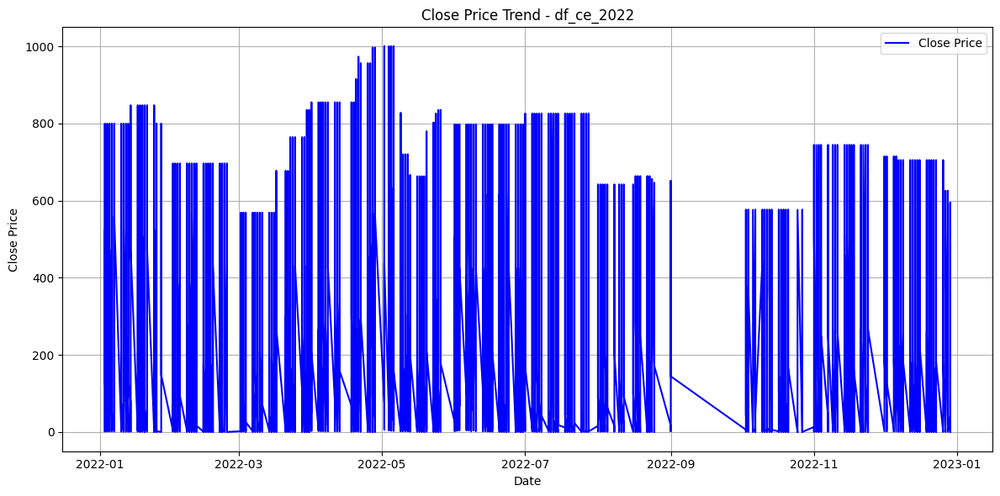

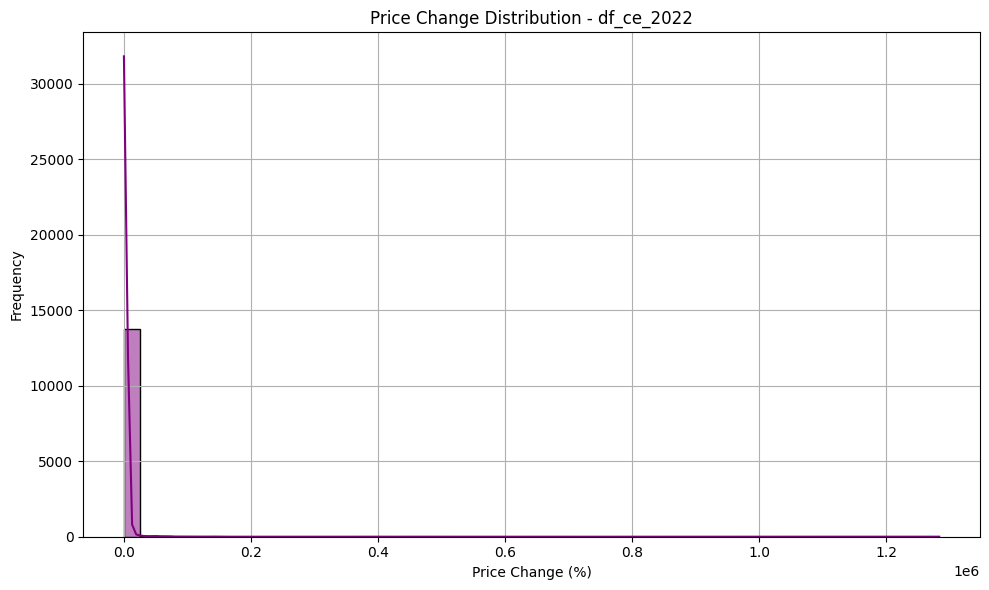

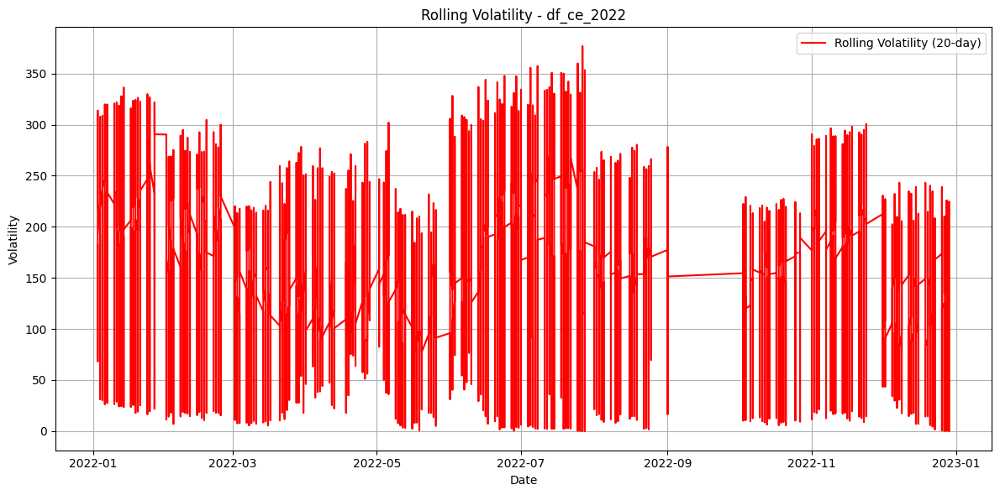

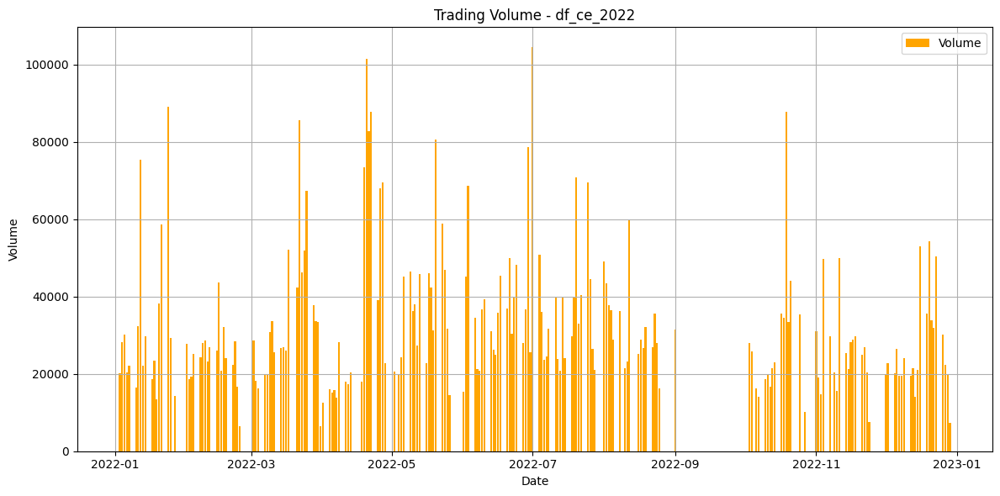

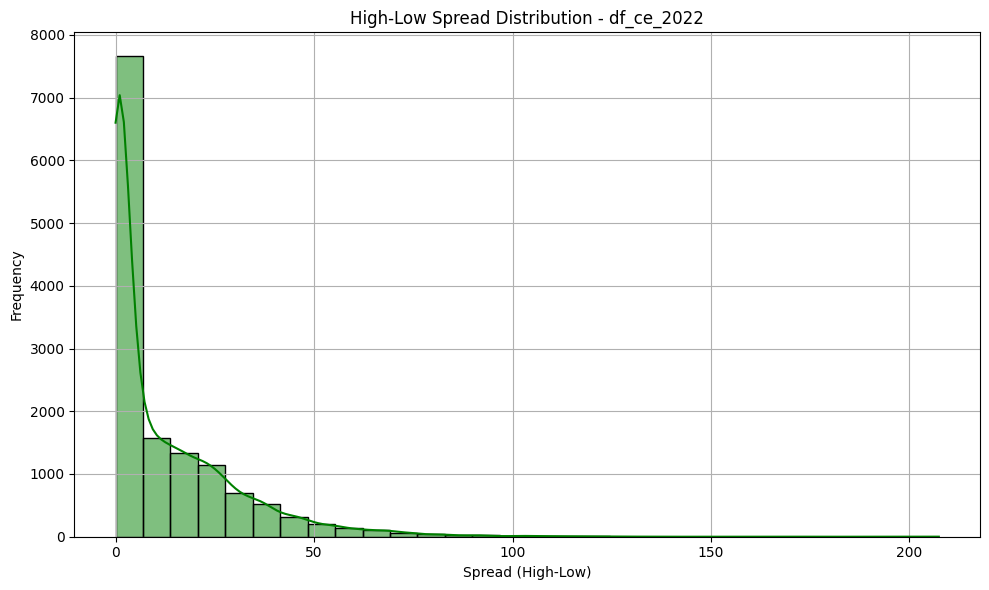


EDA Completed for df_ce_2022 


--- EDA for df_ce_2023 ---



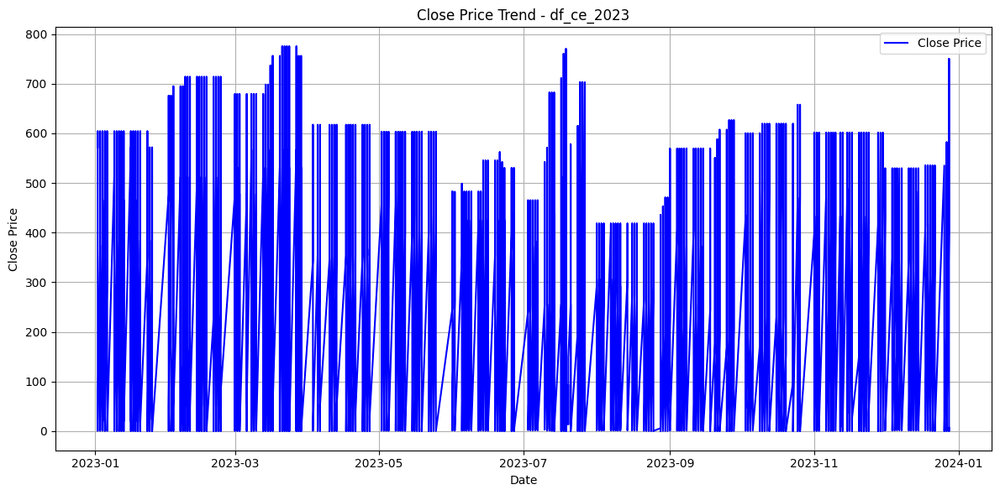

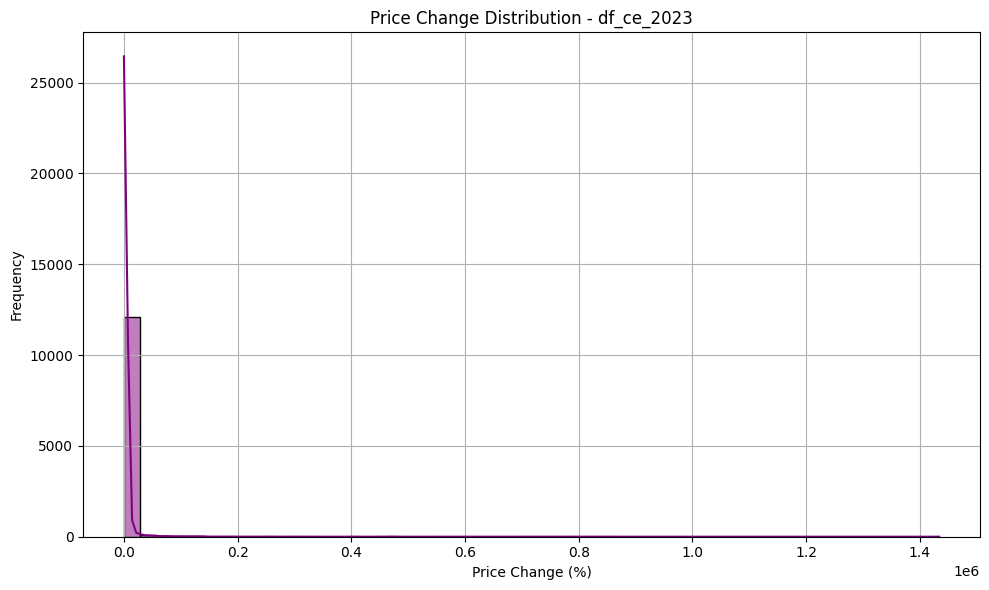

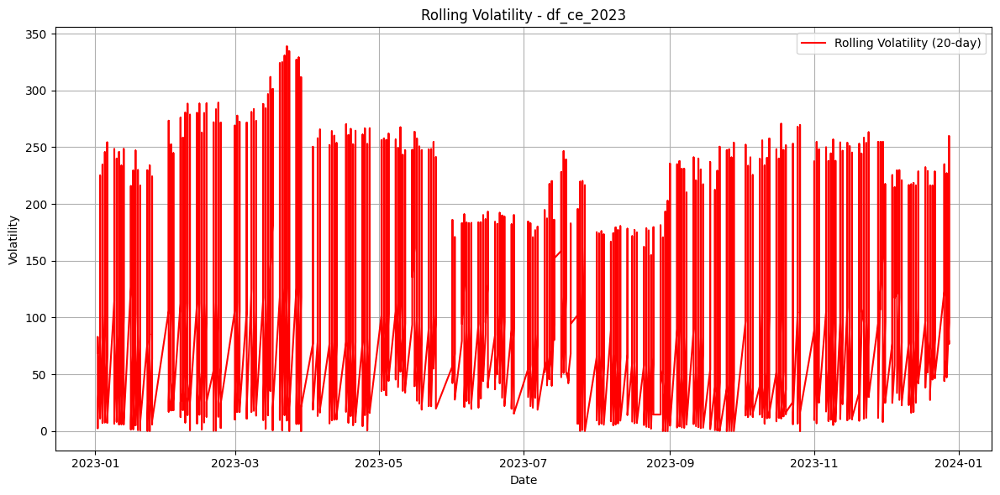

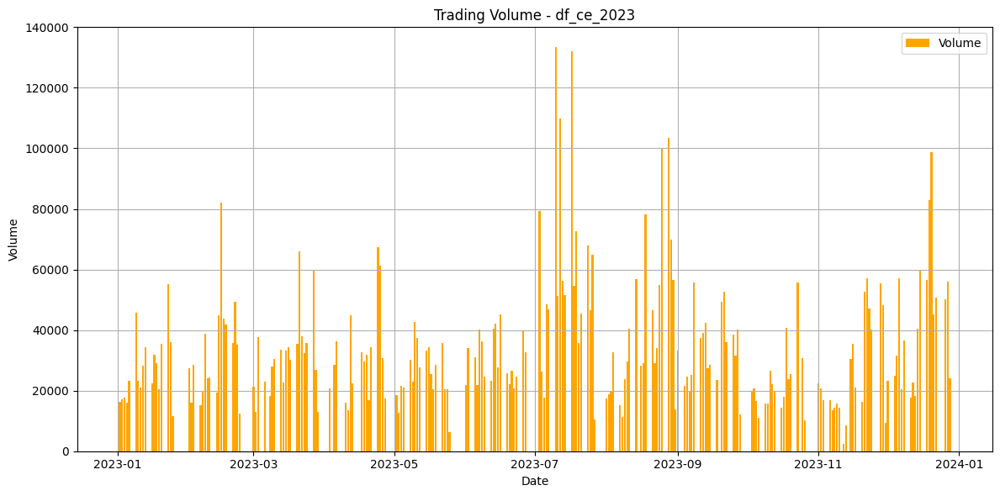

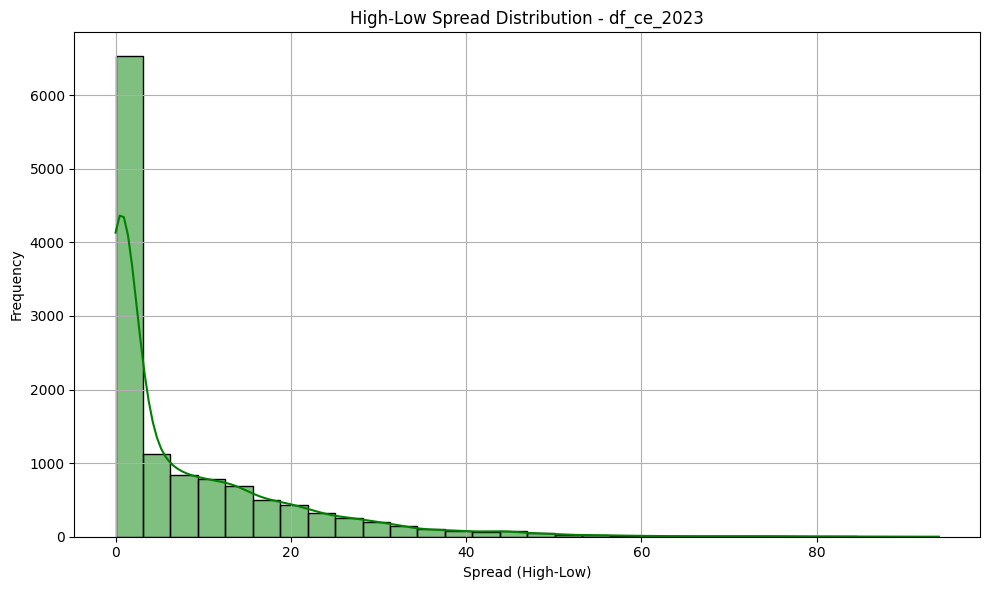


EDA Completed for df_ce_2023 


--- EDA for df_ce_2024 ---



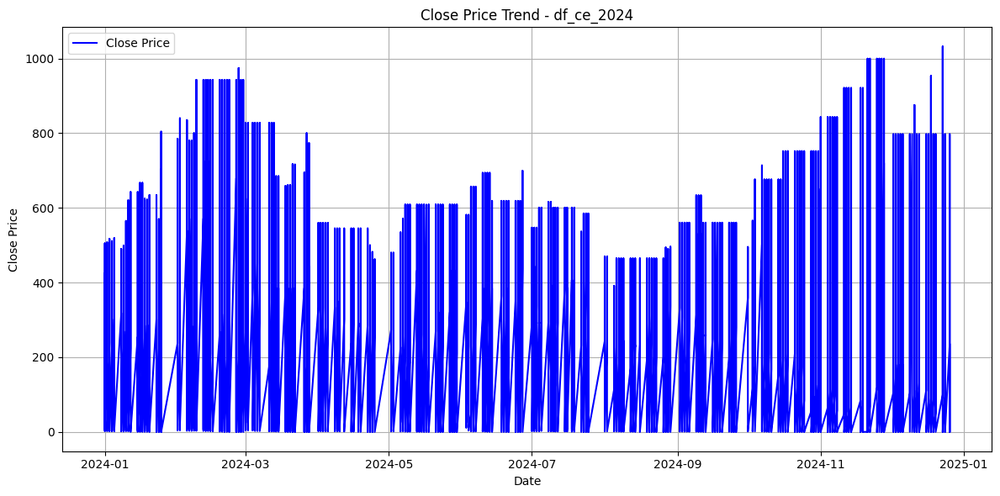

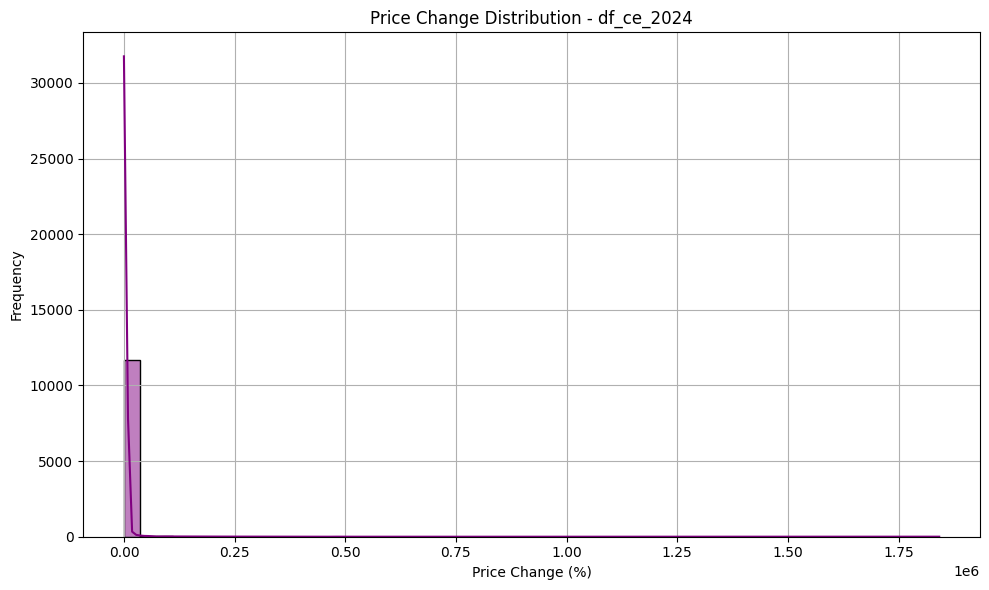

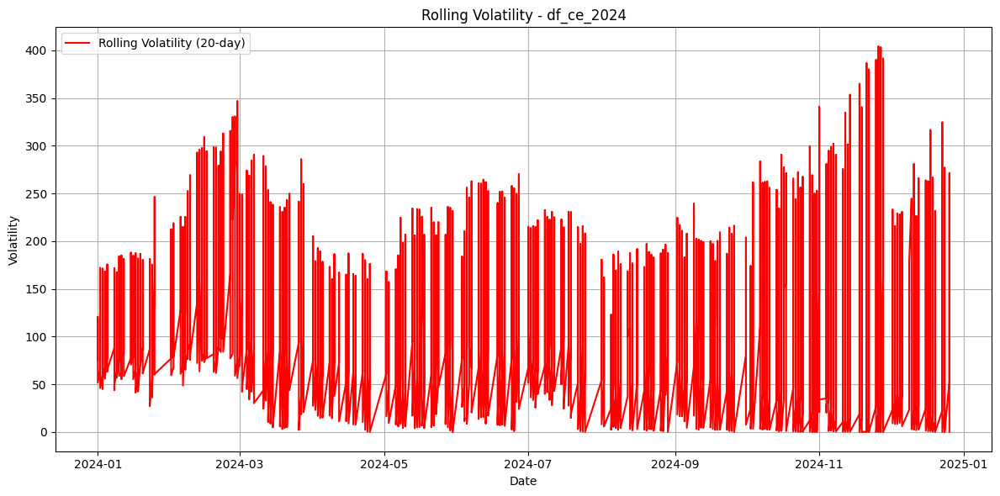

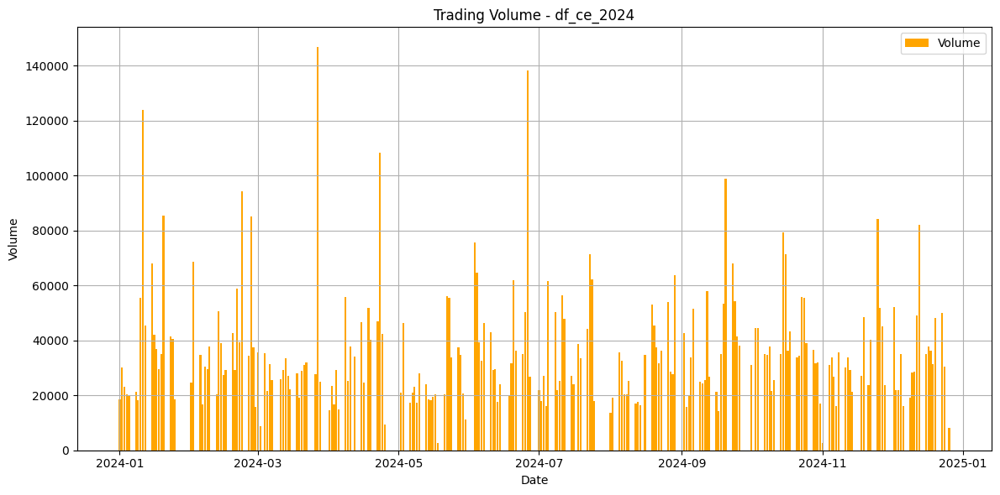

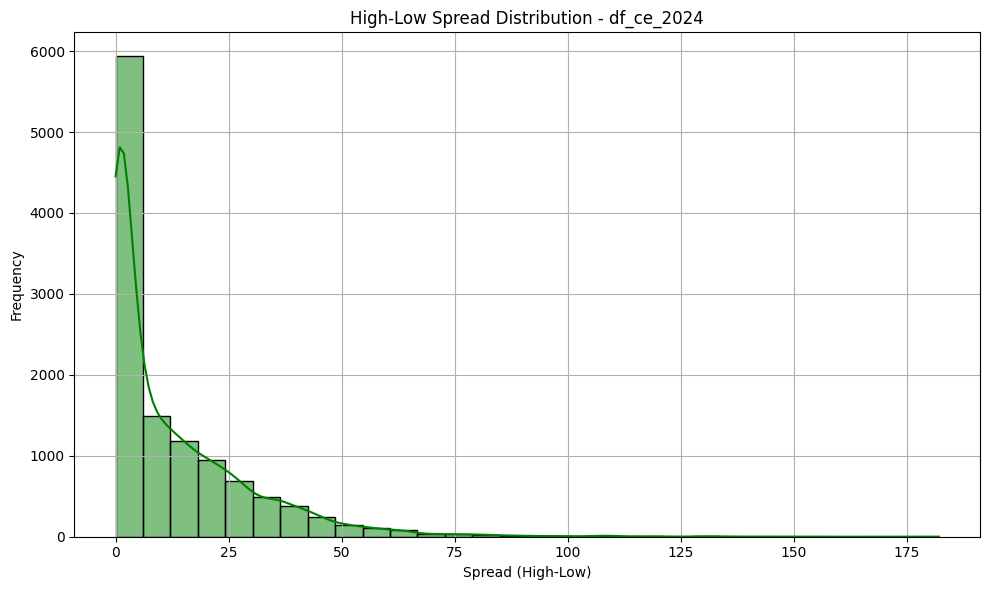


EDA Completed for df_ce_2024 


--- EDA for df_pe_2022 ---



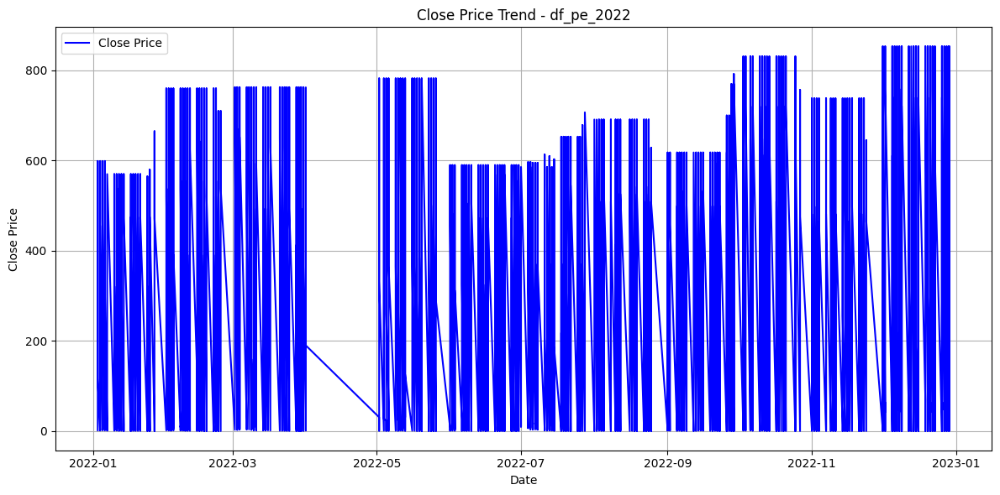

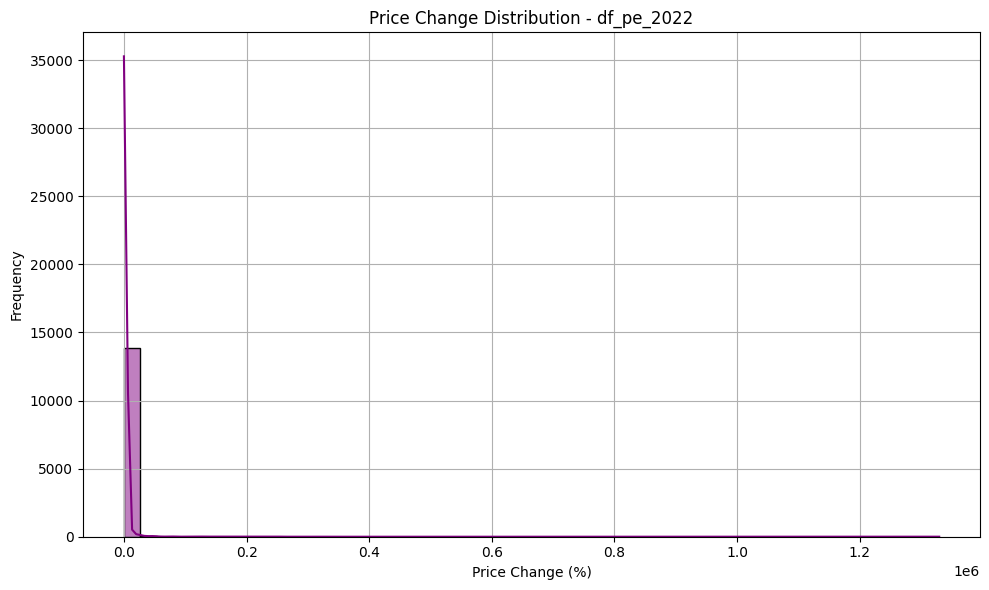

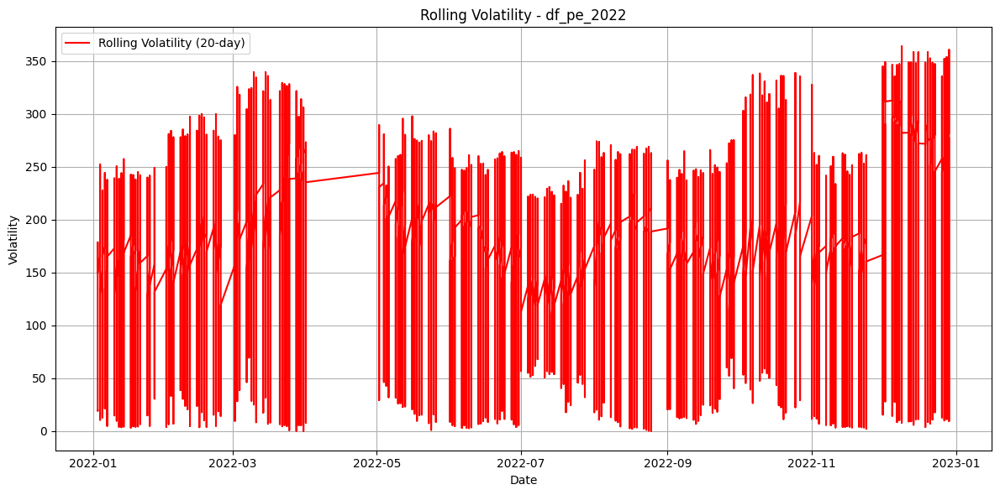

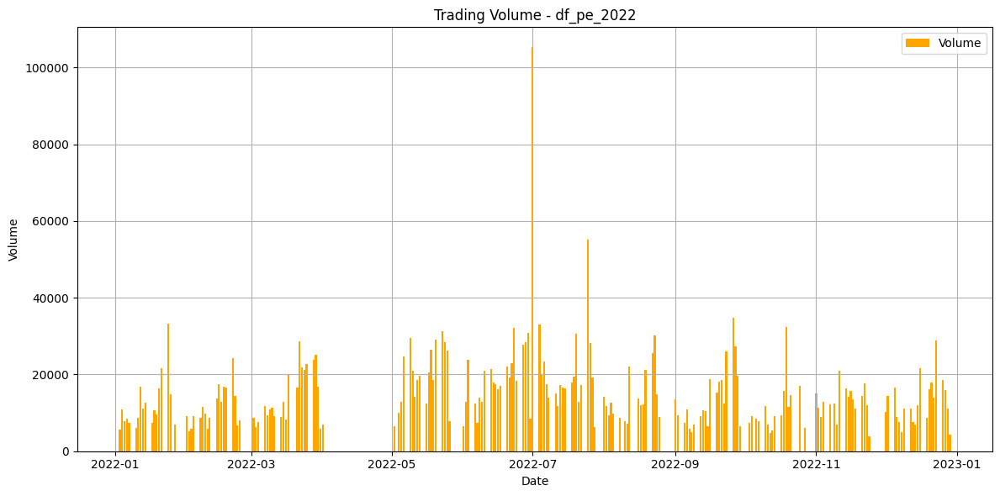

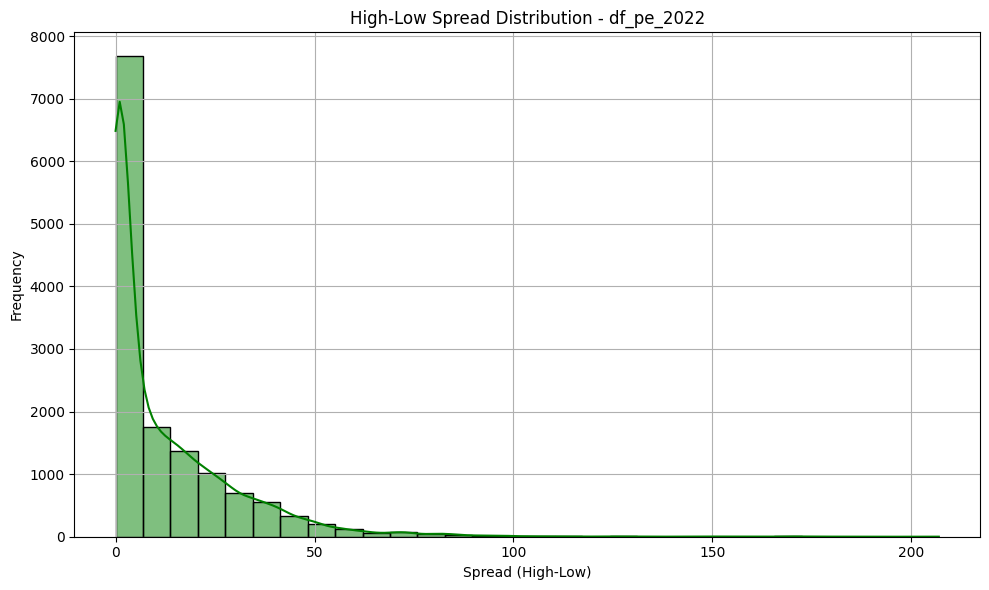


EDA Completed for df_pe_2022 


--- EDA for df_pe_2023 ---



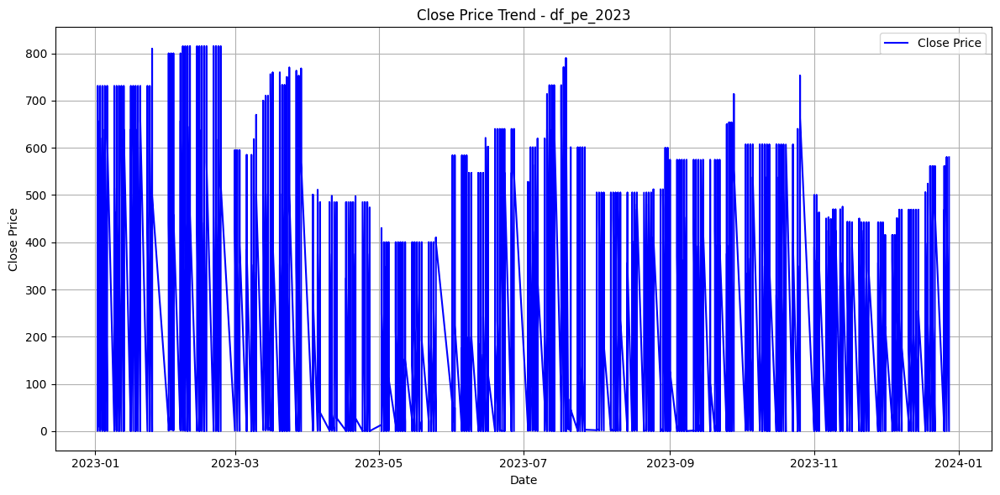

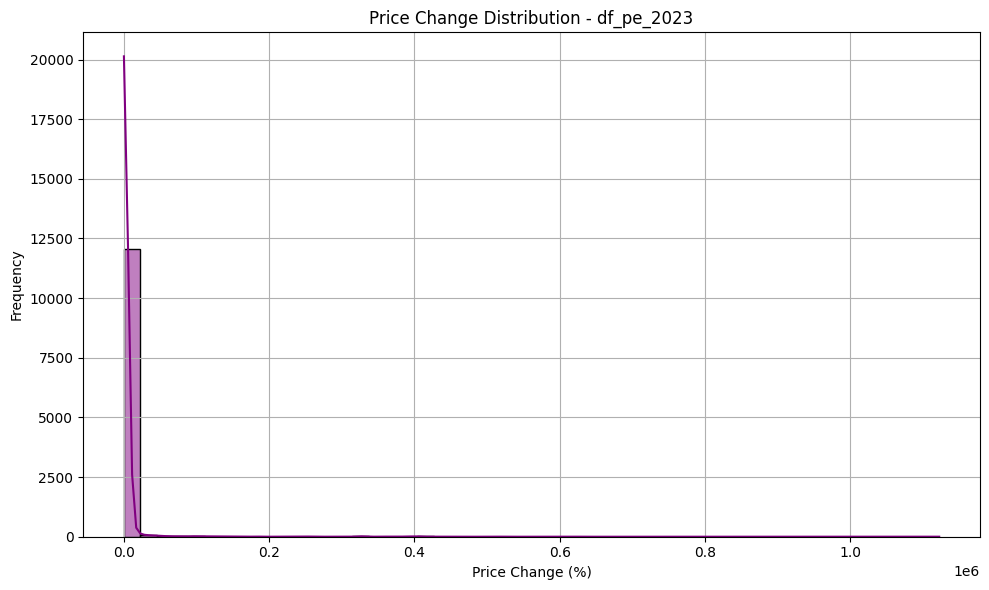

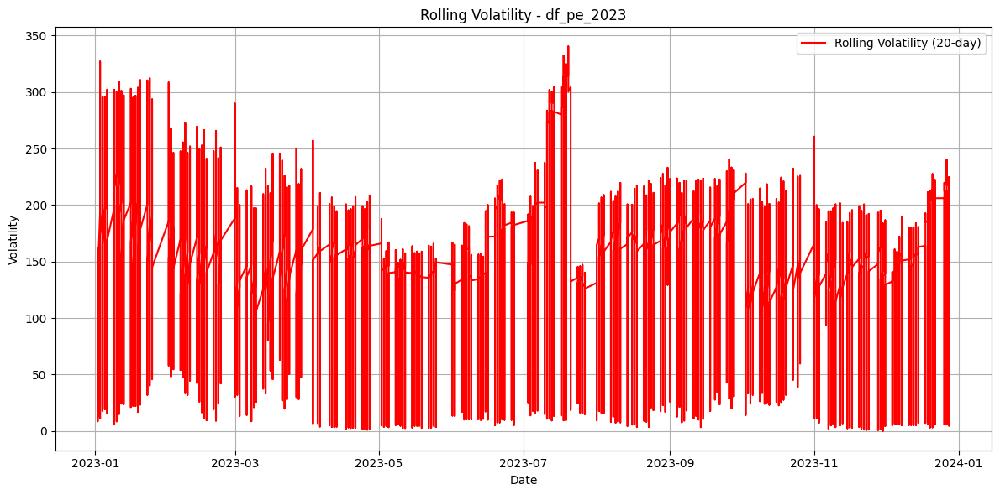

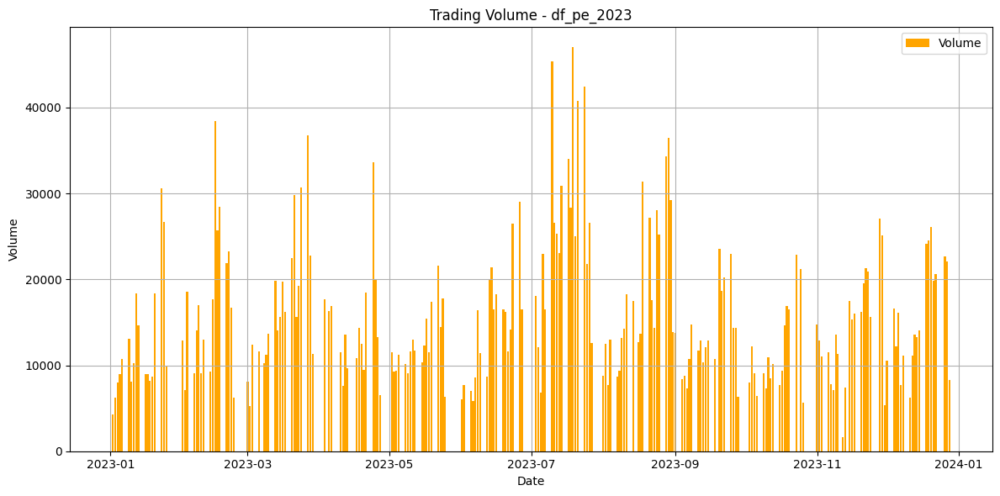

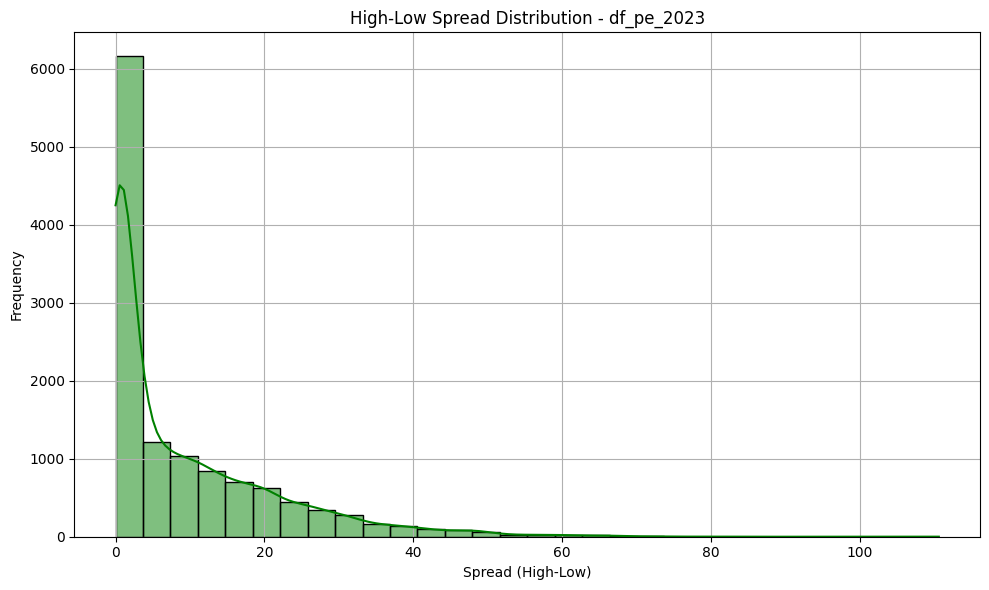


EDA Completed for df_pe_2023 


--- EDA for df_pe_2024 ---



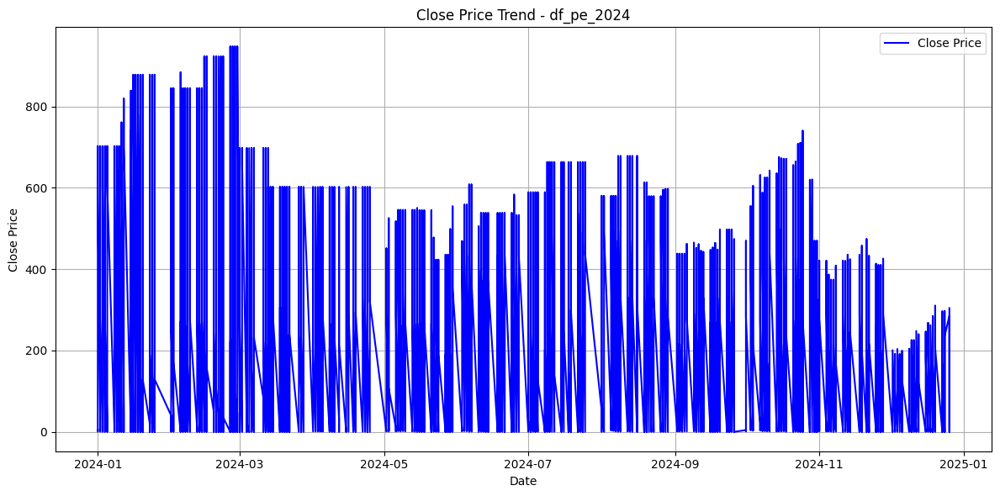

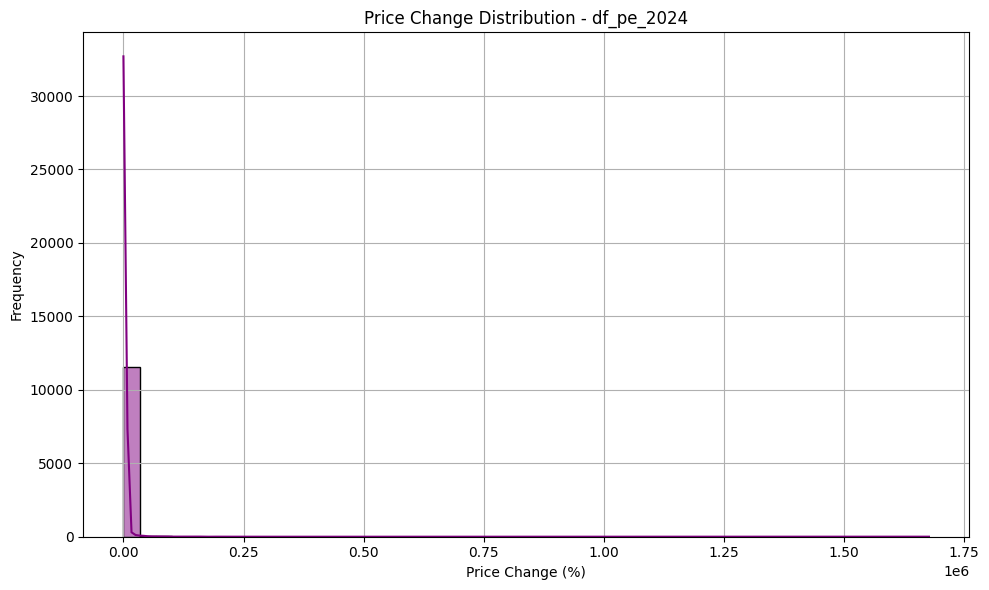

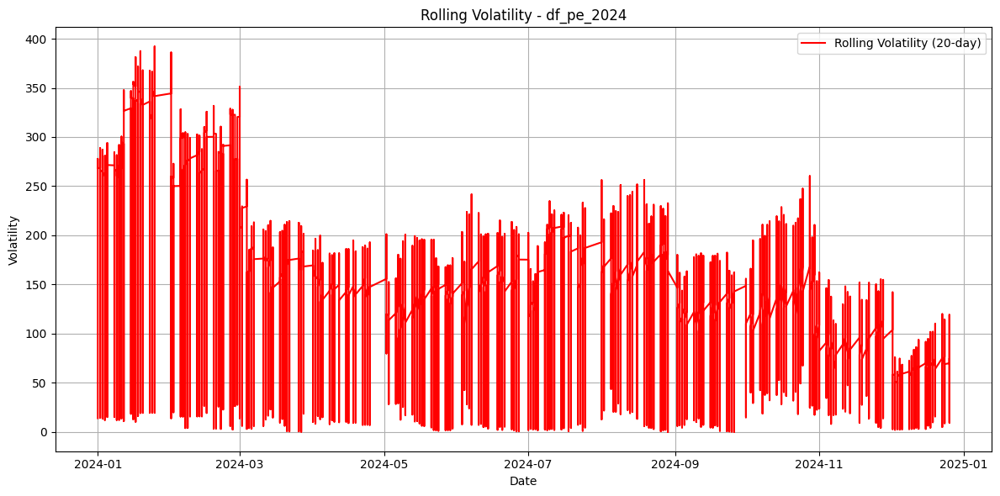

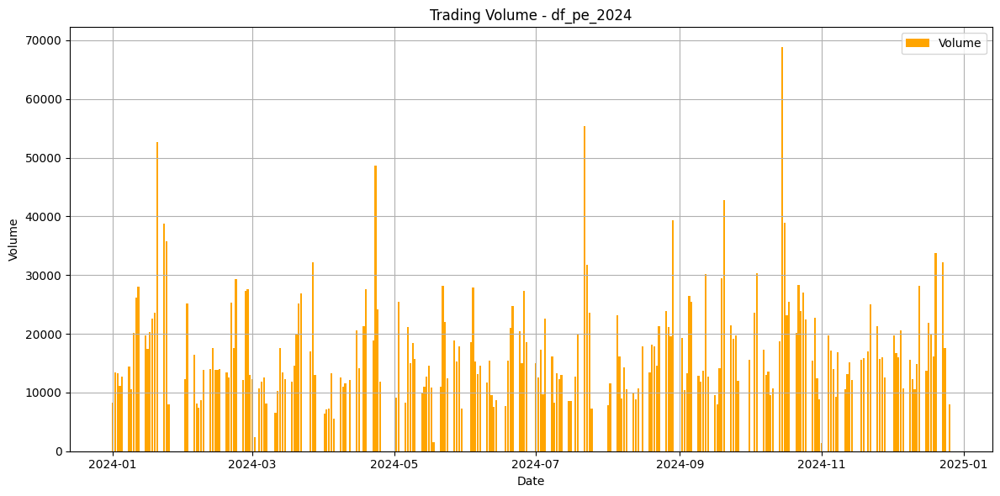

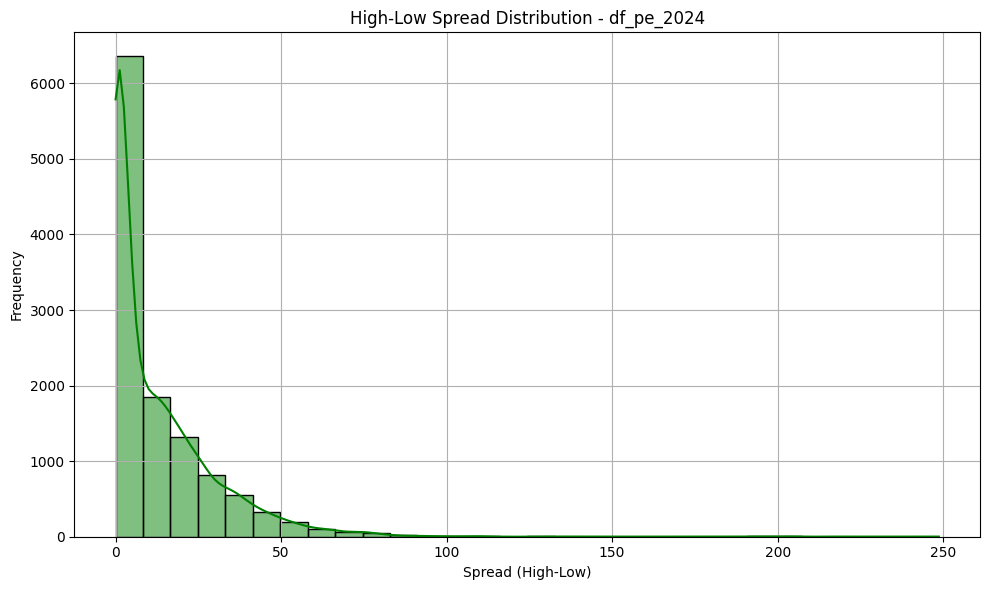


EDA Completed for df_pe_2024 


--- EDA for df_ce_all ---



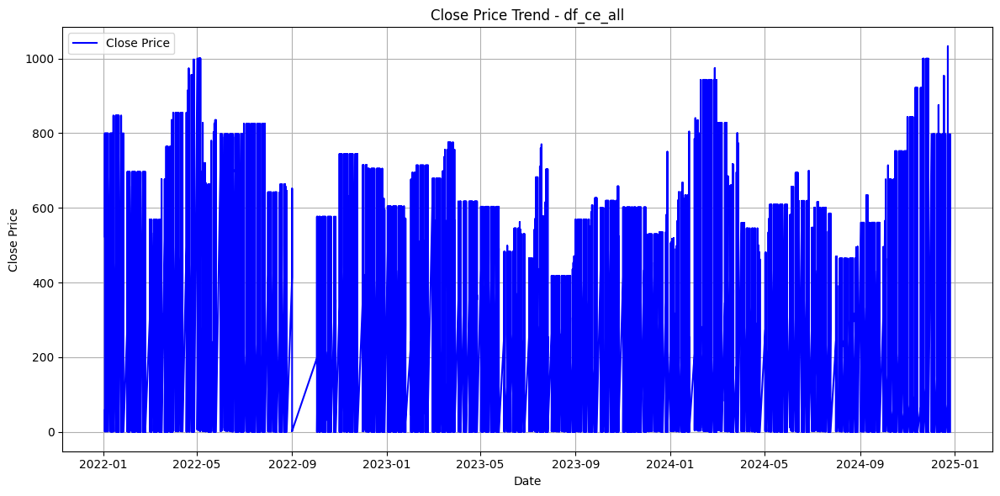

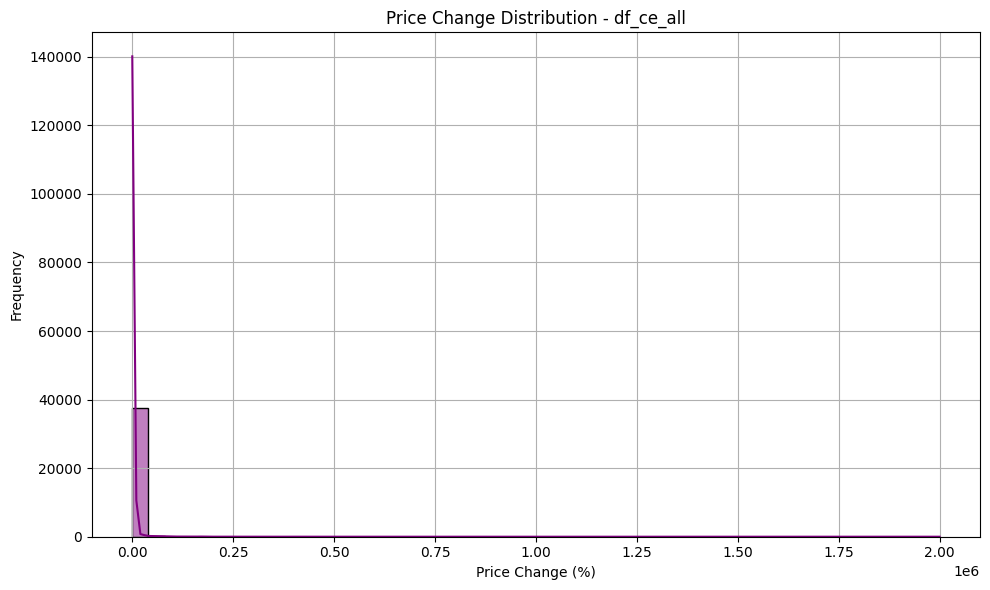

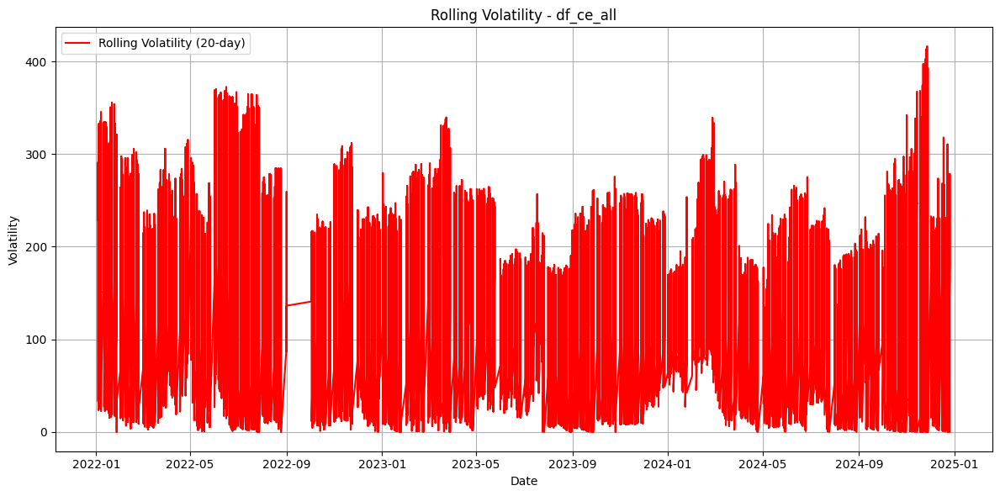

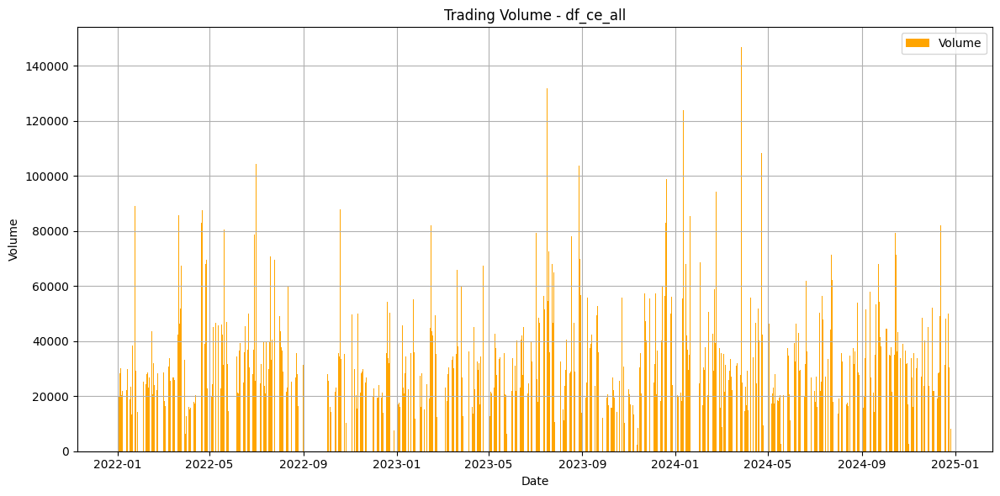

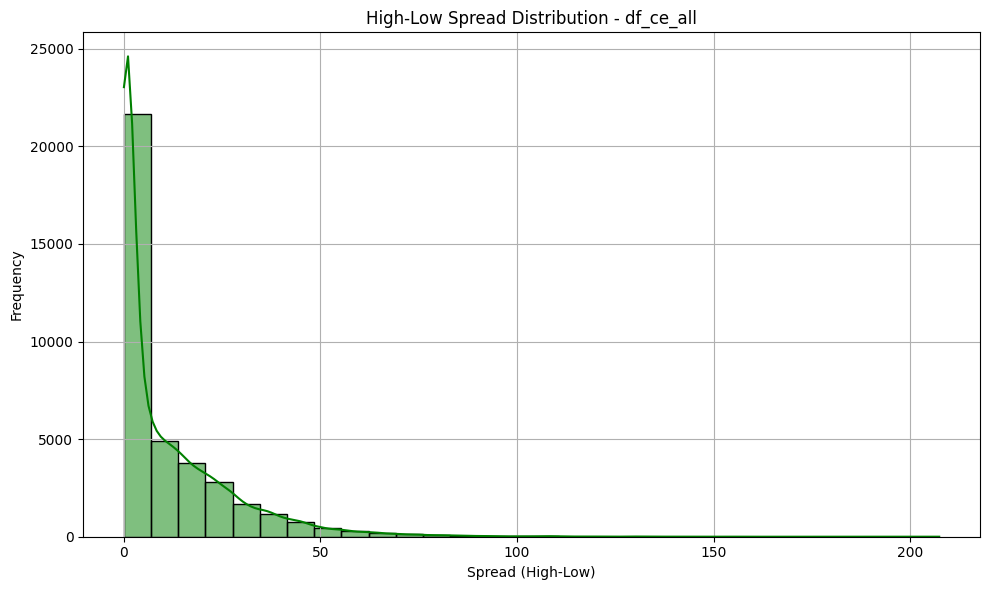


EDA Completed for df_ce_all 


--- EDA for df_pe_all ---



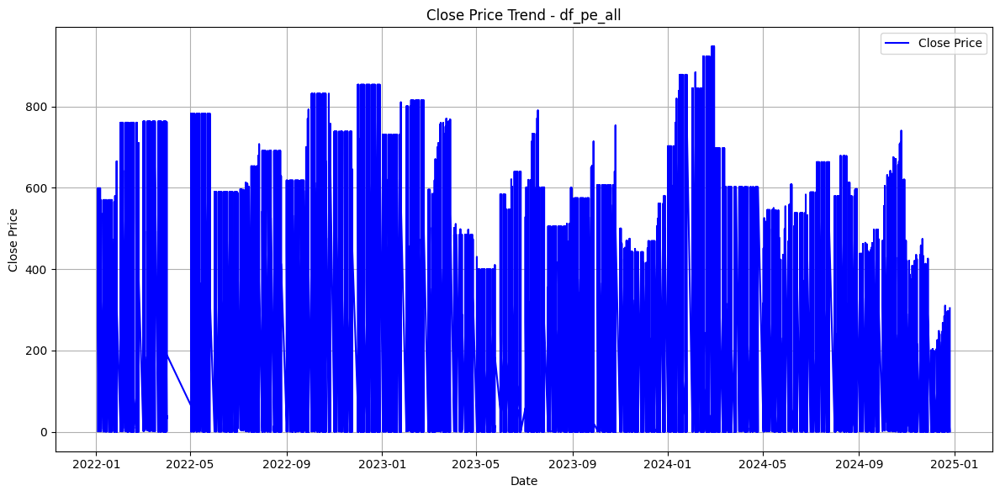

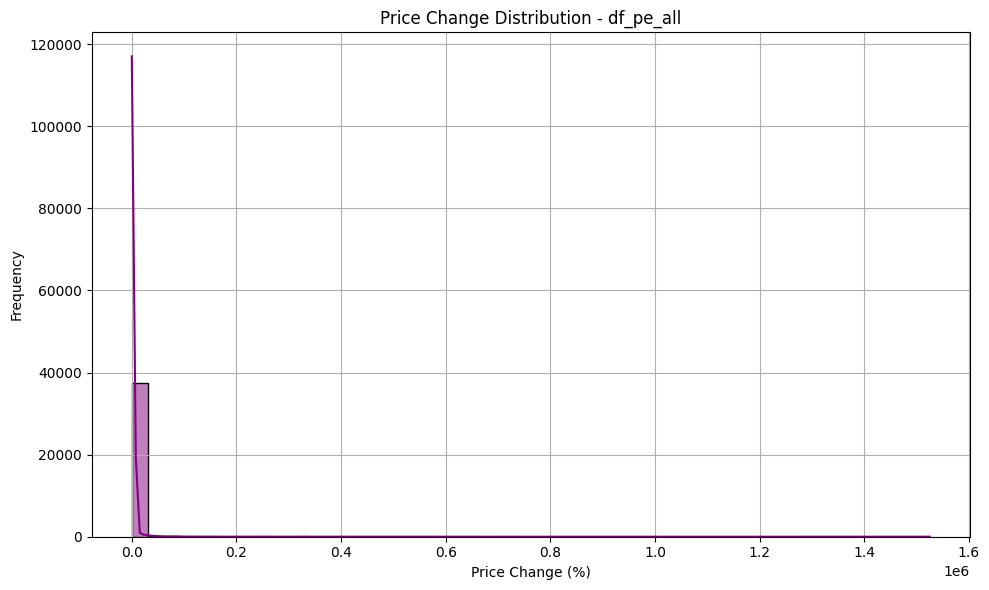

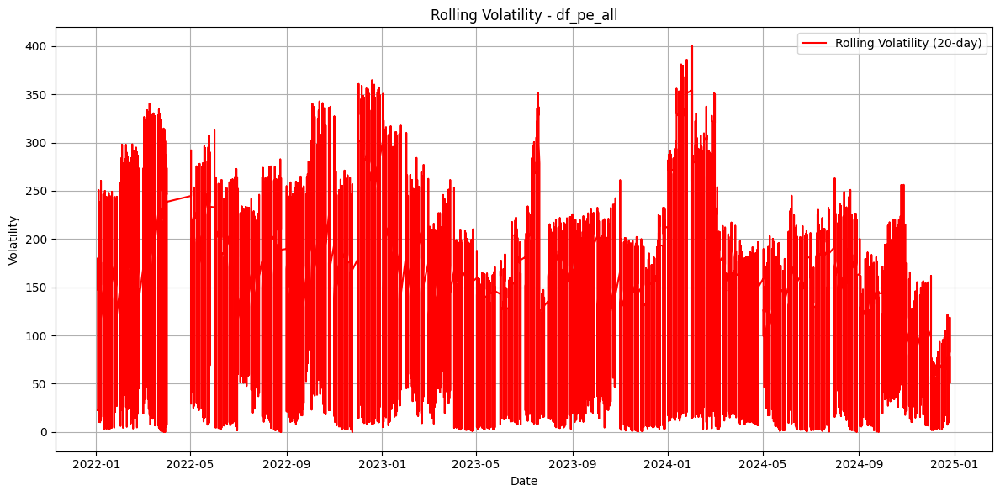

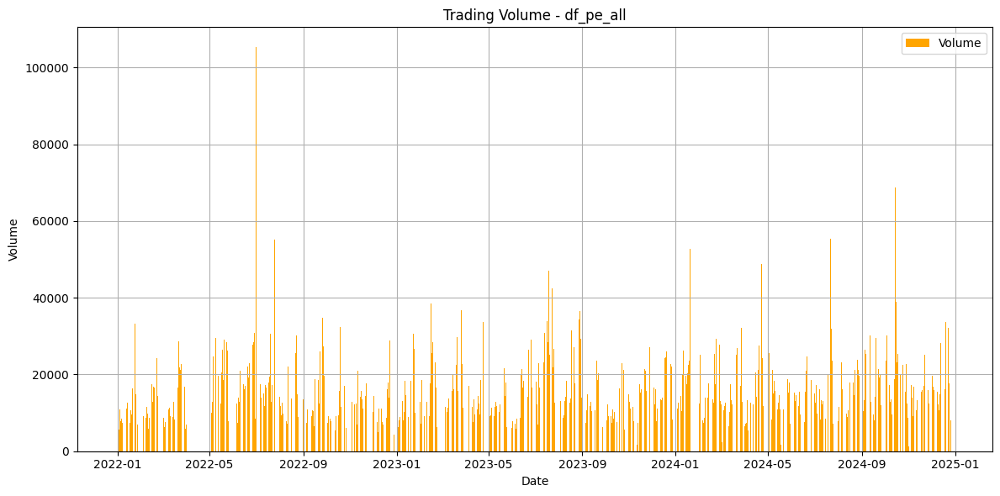

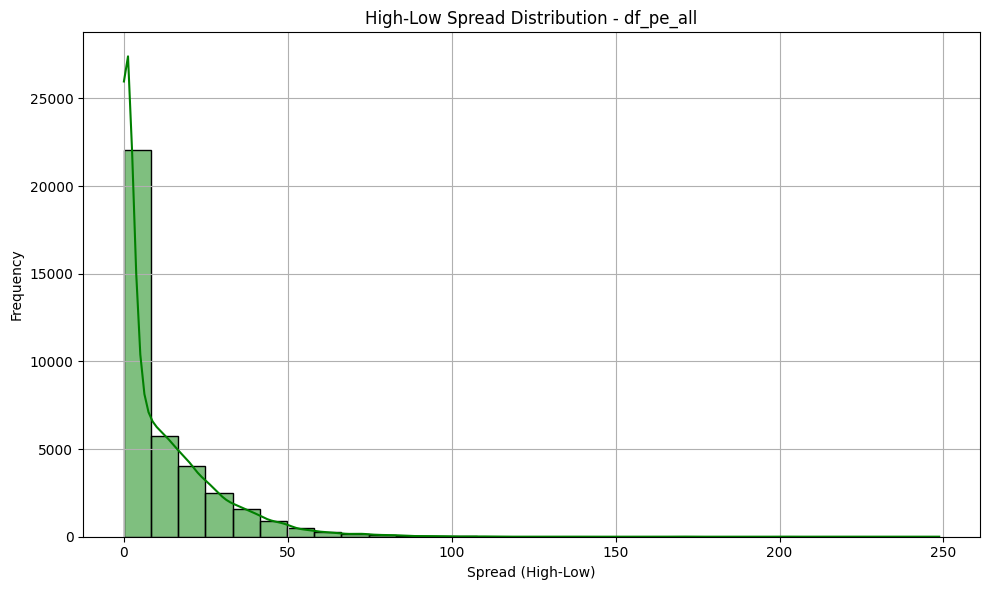


EDA Completed for df_pe_all 


--- EDA for df_ce_pe_2022 ---



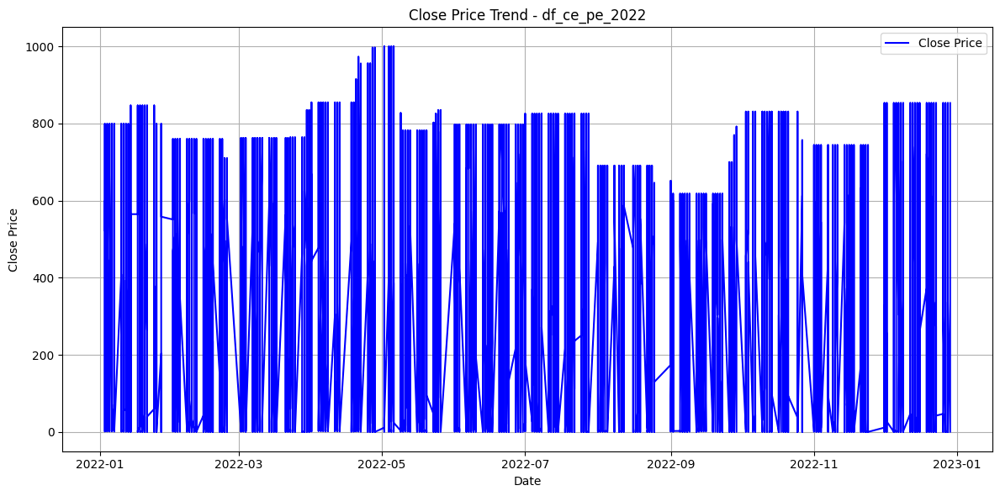

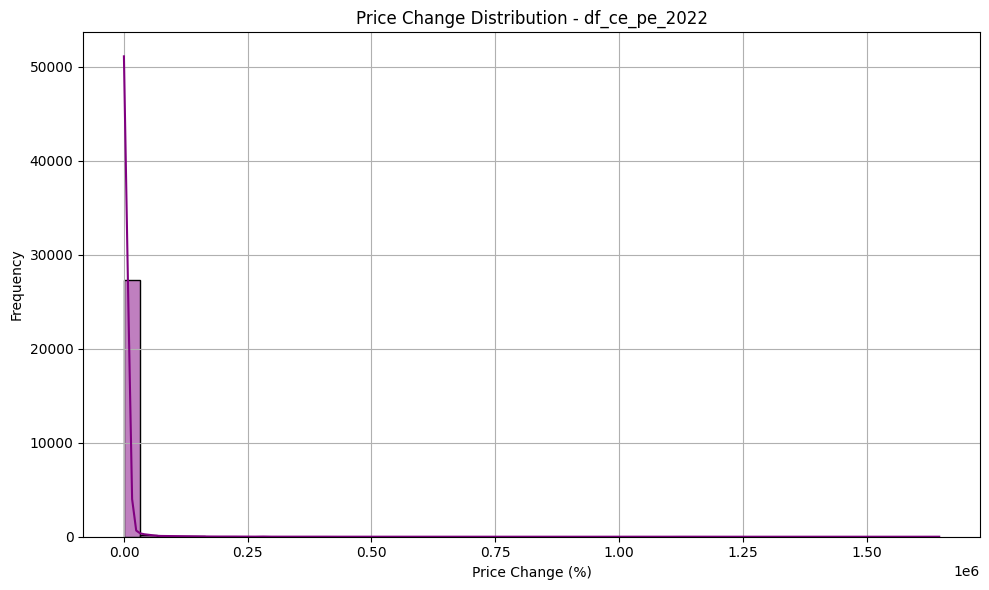

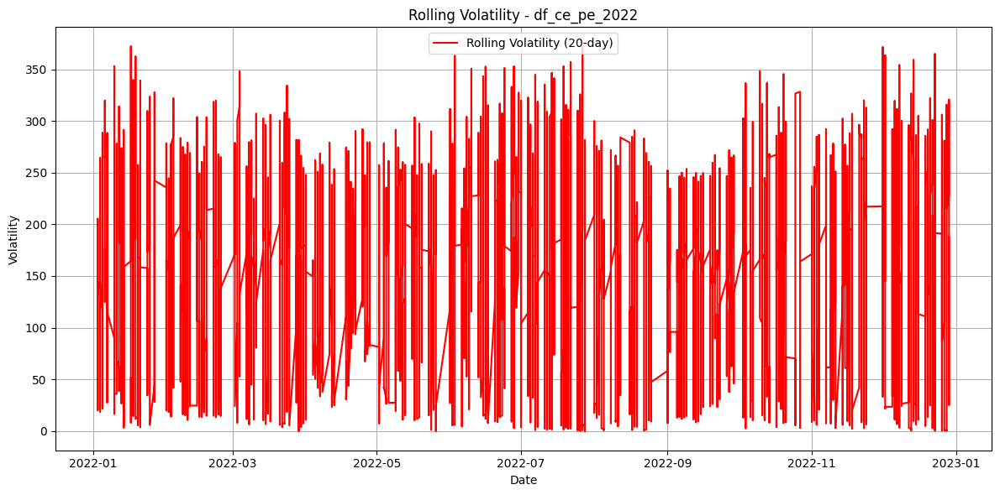

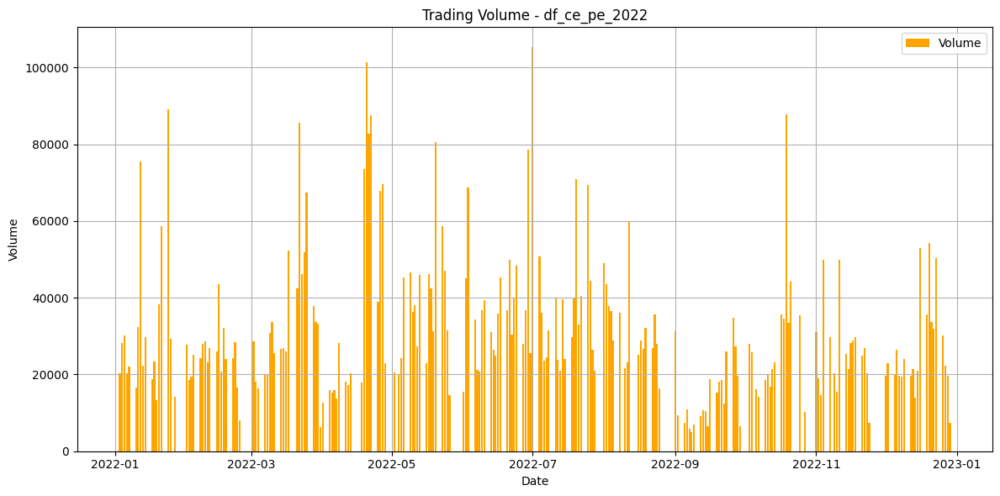

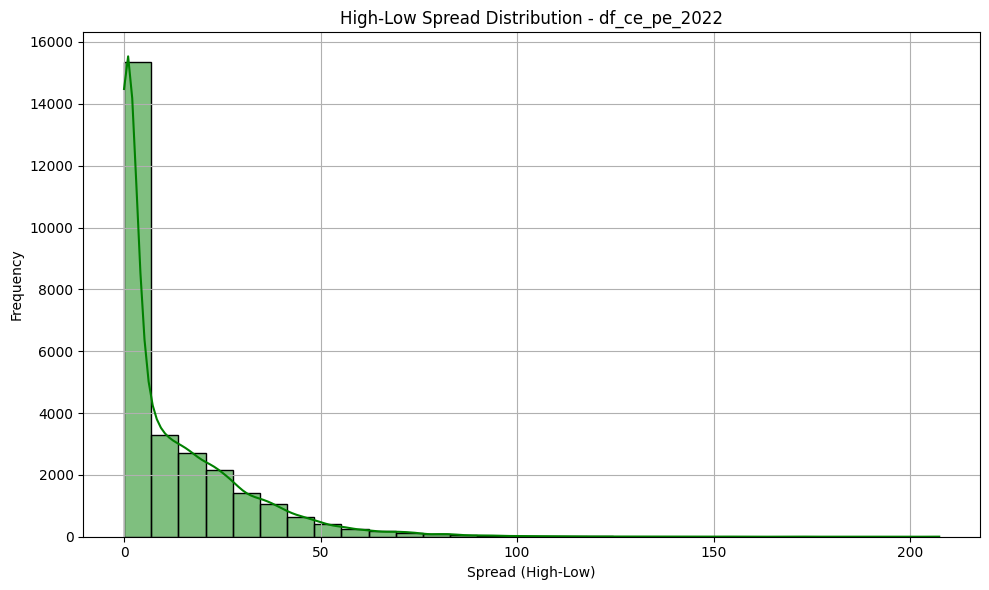


EDA Completed for df_ce_pe_2022 


--- EDA for df_ce_pe_2023 ---



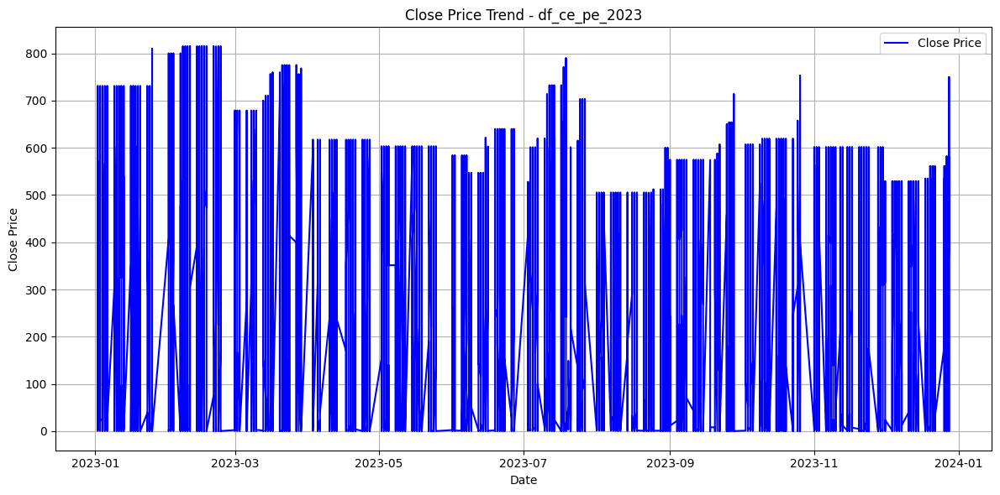

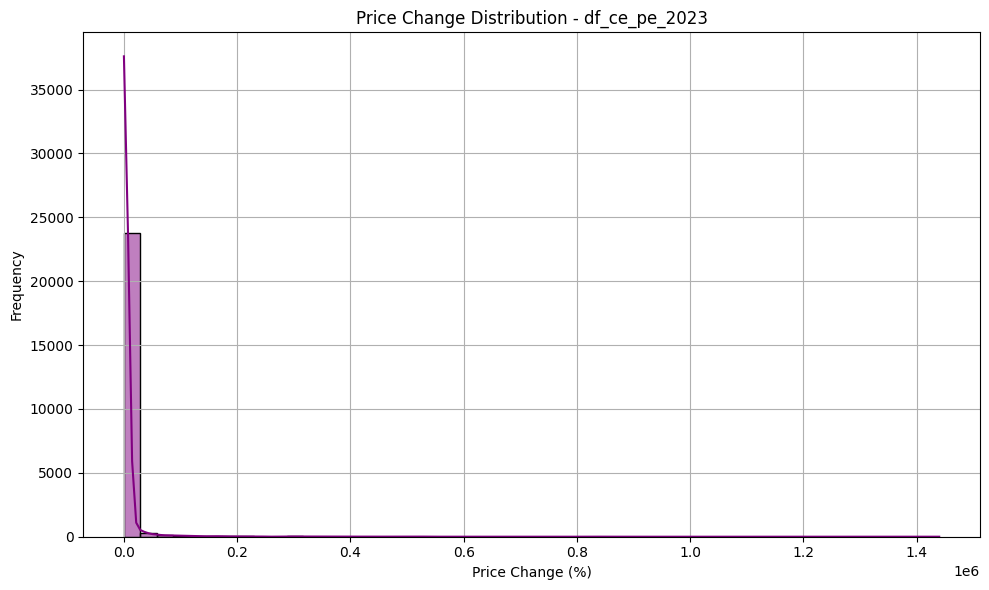

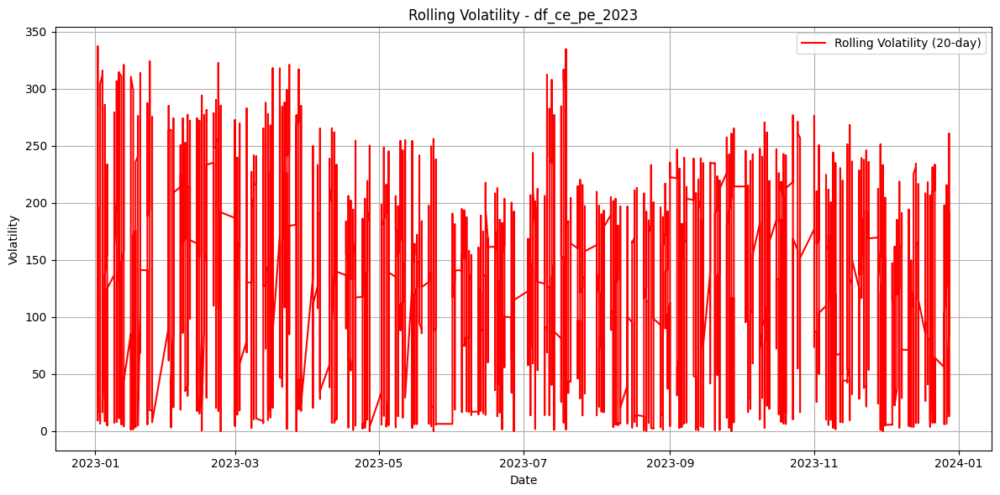

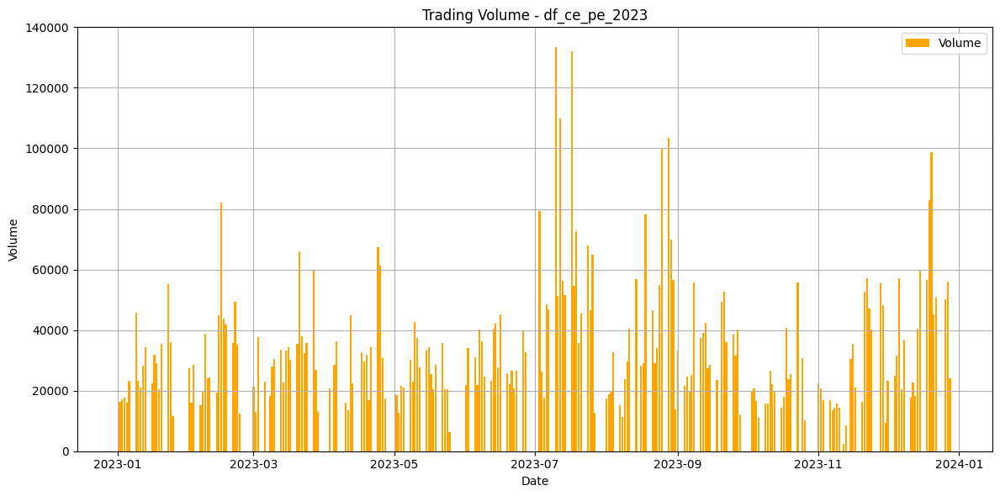

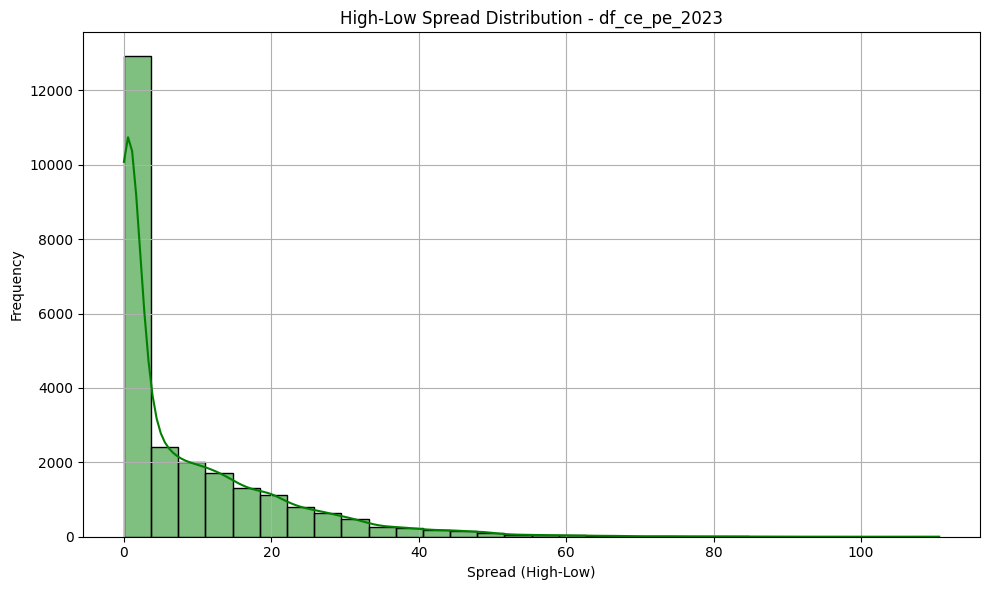


EDA Completed for df_ce_pe_2023 


--- EDA for df_ce_pe_2024 ---



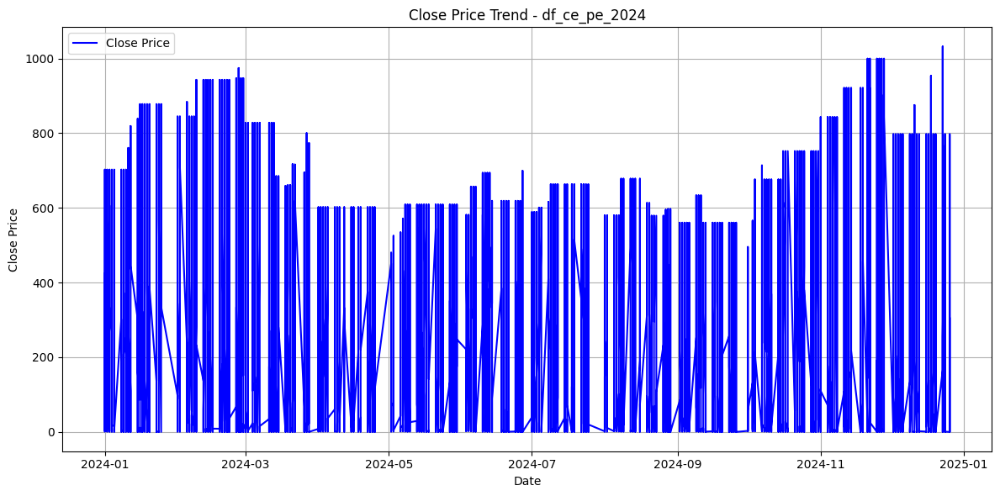

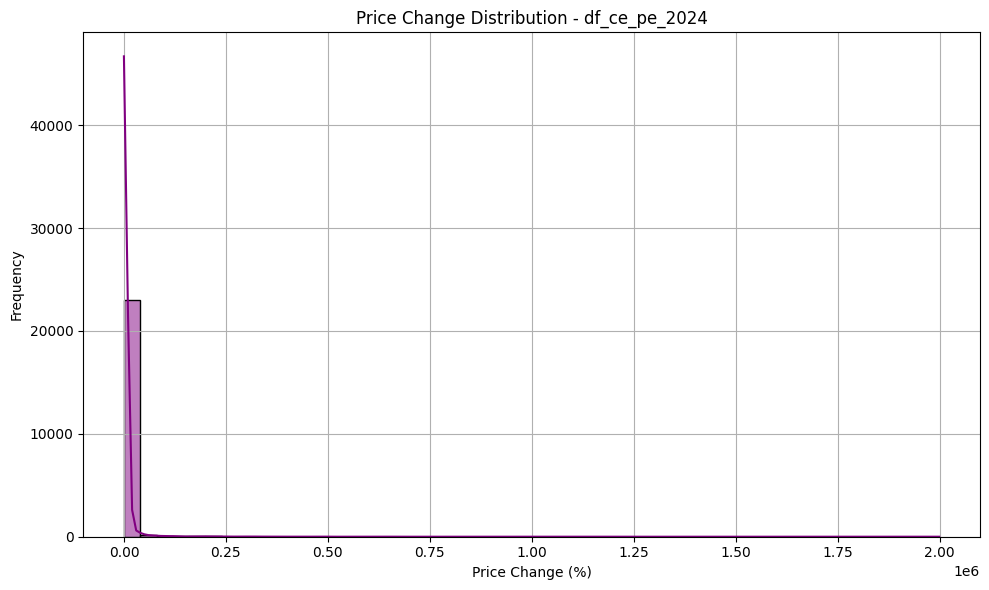

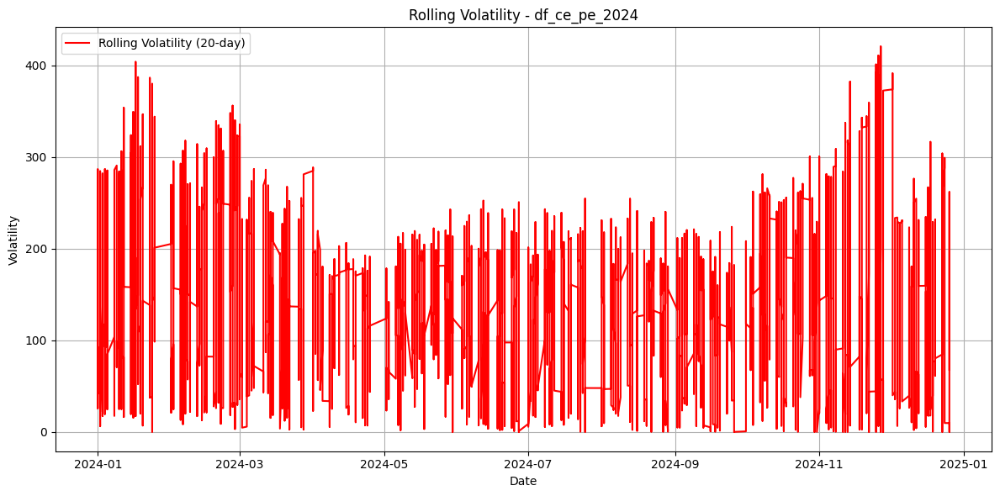

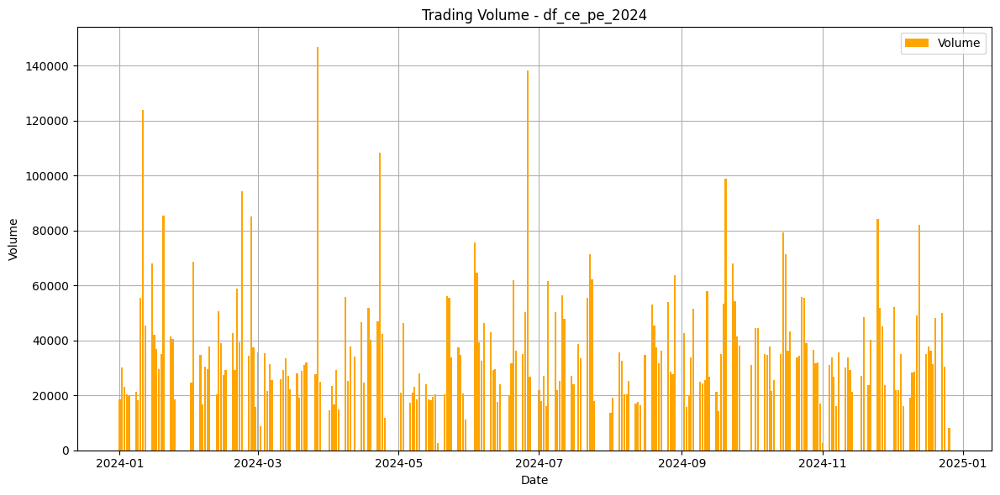

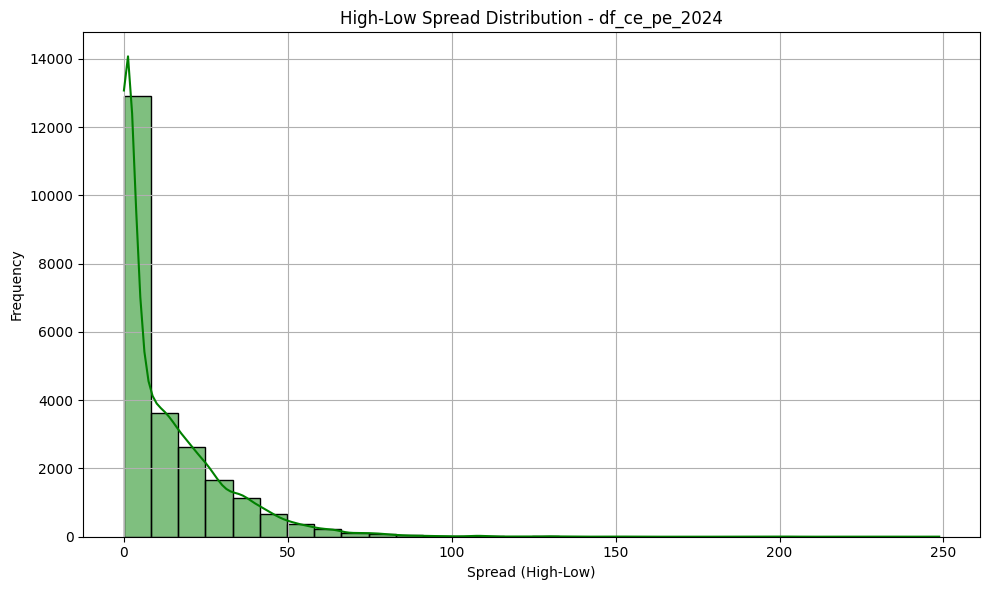


EDA Completed for df_ce_pe_2024 


--- EDA for df_options_combo ---



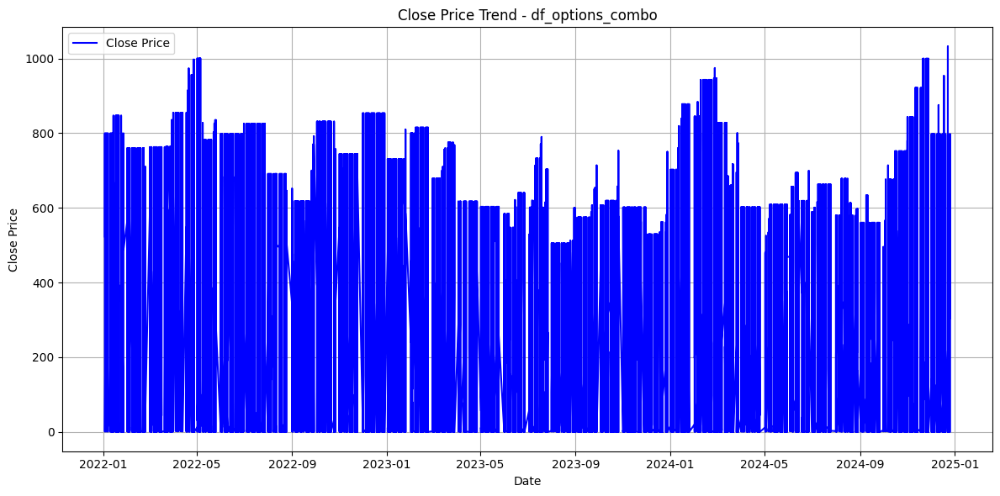

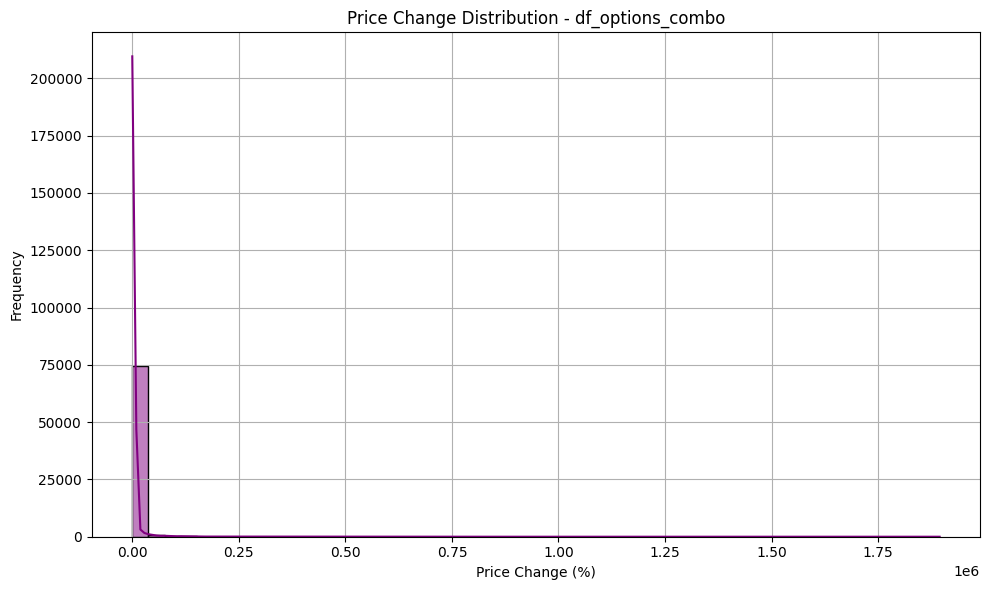

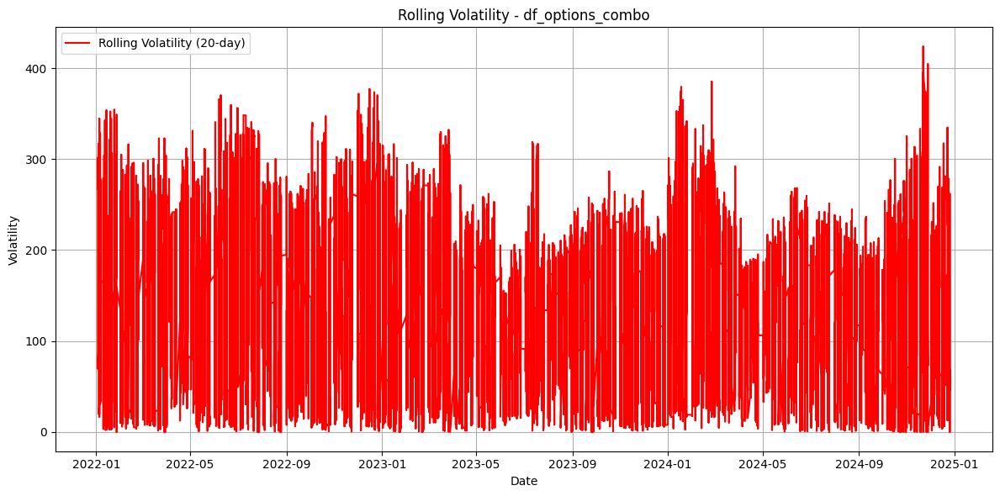

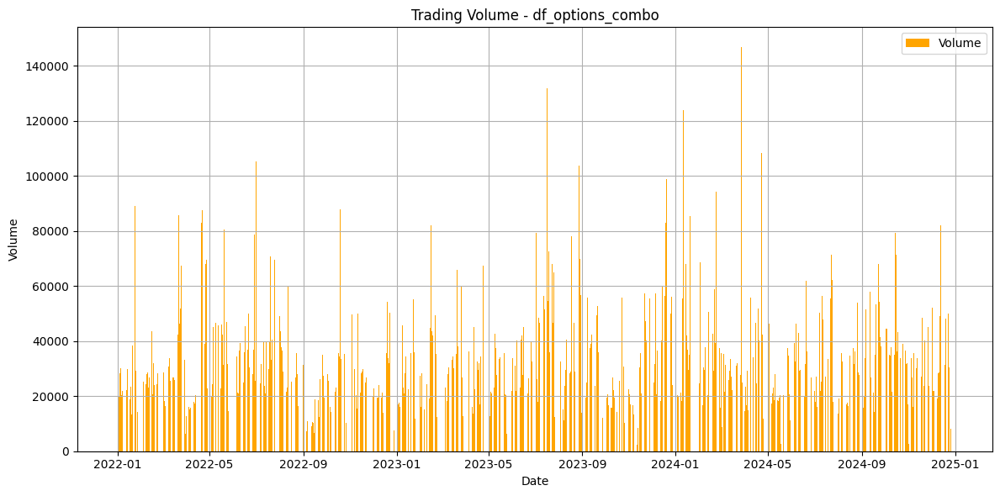

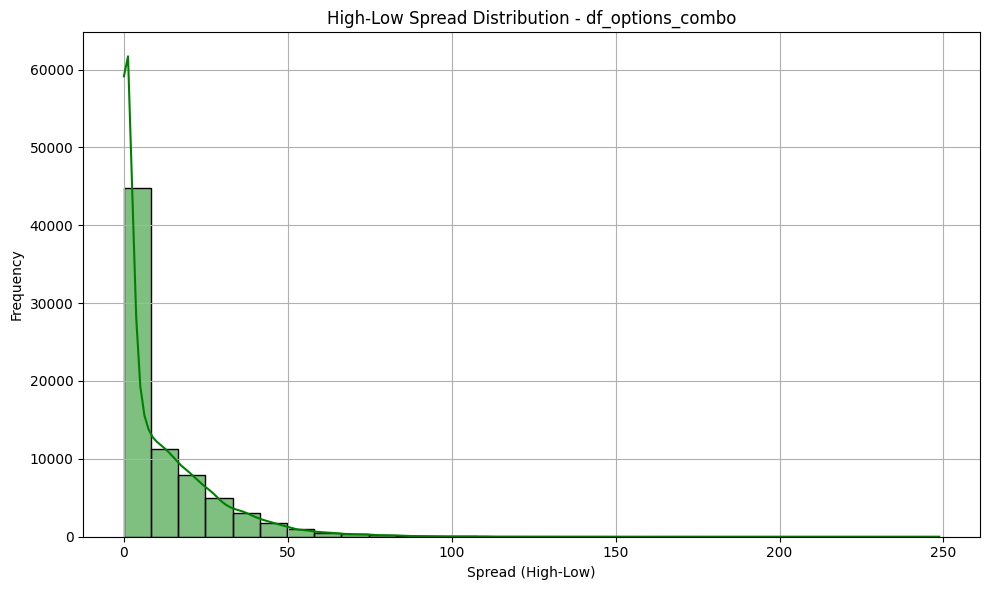


EDA Completed for df_options_combo 




In [55]:
# Code for Exploratory Data Analysis (EDA)

# Data Visualization - 1

# Defining the function for EDA
def perform_eda(df, dataset_name):
    print(f"--- EDA for {dataset_name} ---\n")

    # 1. Time - Series Visualization
    plt.figure(figsize=(12, 6))
    plt.plot(df['Date'], df['Close'], label='Close Price', color='blue')
    plt.title(f"Close Price Trend - {dataset_name}")
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.tight_layout()
    plt.show()

    # 2. Distribution of Price Changes
    df['Price Change'] = df['Close'].pct_change() * 100
    plt.figure(figsize=(10, 6))
    sns.histplot(df['Price Change'].dropna(), bins=50, kde=True, color='purple')
    plt.title(f"Price Change Distribution - {dataset_name}")
    plt.xlabel('Price Change (%)')
    plt.ylabel('Frequency')
    plt.grid()
    plt.tight_layout()
    plt.show()

    # 3. Rolling Volatility
    df['Rolling Volatility'] = df['Close'].rolling(window=20).std()
    plt.figure(figsize=(12, 6))
    plt.plot(df['Date'], df['Rolling Volatility'], label='Rolling Volatility (20-day)', color='red')
    plt.title(f"Rolling Volatility - {dataset_name}")
    plt.xlabel('Date')
    plt.ylabel('Volatility')
    plt.legend()
    plt.grid()
    plt.tight_layout()
    plt.show()

    # 4. Volume Analysis
    plt.figure(figsize=(12, 6))
    plt.bar(df['Date'], df['No. of contracts'], color='orange', label='Volume')
    plt.title(f"Trading Volume - {dataset_name}")
    plt.xlabel('Date')
    plt.ylabel('Volume')
    plt.legend()
    plt.grid()
    plt.tight_layout()
    plt.show()

    # 5. Spread Analysis
    plt.figure(figsize=(10, 6))
    df['High_Low_Spread'] = df['High'] - df['Low']
    sns.histplot(df['High_Low_Spread'], bins=30, kde=True, color='green')
    plt.title(f"High-Low Spread Distribution - {dataset_name}")
    plt.xlabel('Spread (High-Low)')
    plt.ylabel('Frequency')
    plt.grid()
    plt.tight_layout()
    plt.show()

    print("\nEDA Completed for", dataset_name, "\n\n")

# List of datasets
datasets = {
    "df_ce_2022": df_ce_2022,
    "df_ce_2023": df_ce_2023,
    "df_ce_2024": df_ce_2024,
    "df_pe_2022": df_pe_2022,
    "df_pe_2023": df_pe_2023,
    "df_pe_2024": df_pe_2024,
    "df_ce_all": df_ce_all,
    "df_pe_all": df_pe_all,
    "df_ce_pe_2022": df_ce_pe_2022,
    "df_ce_pe_2023": df_ce_pe_2023,
    "df_ce_pe_2024": df_ce_pe_2024,
    "df_options_combo": df_options_combo
}

# Perform EDA for each dataset
for name, dataset in datasets.items():
    perform_eda(dataset, name)

--- Correlation Heatmap for df_ce_2022 ---



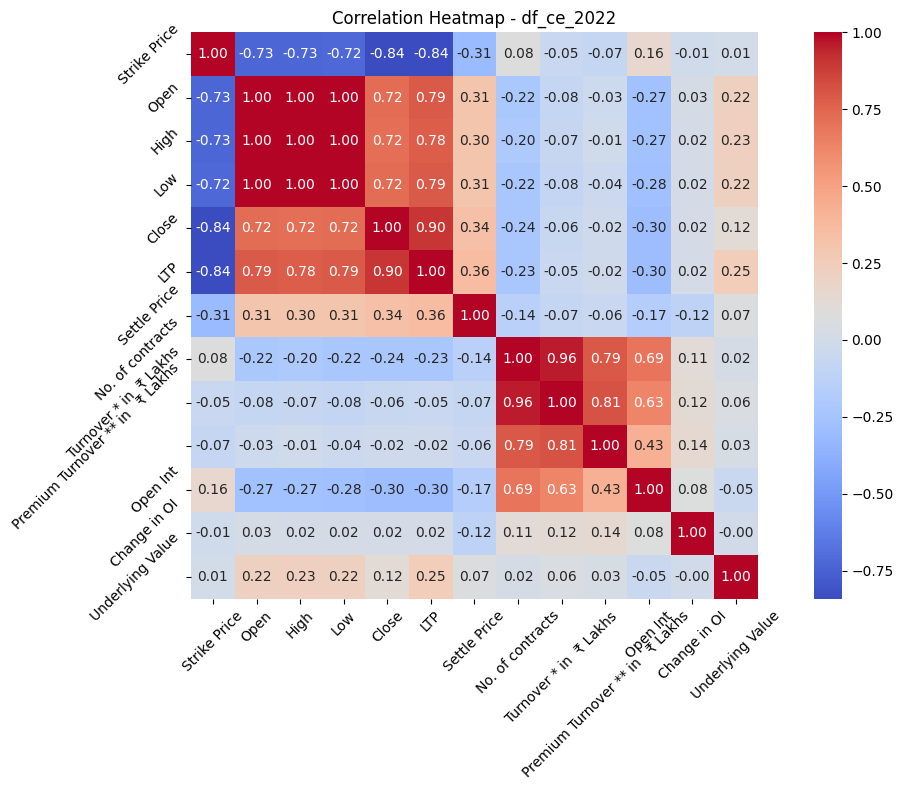

Correlation Heatmap plotted for df_ce_2022.

--- Correlation Heatmap for df_ce_2023 ---



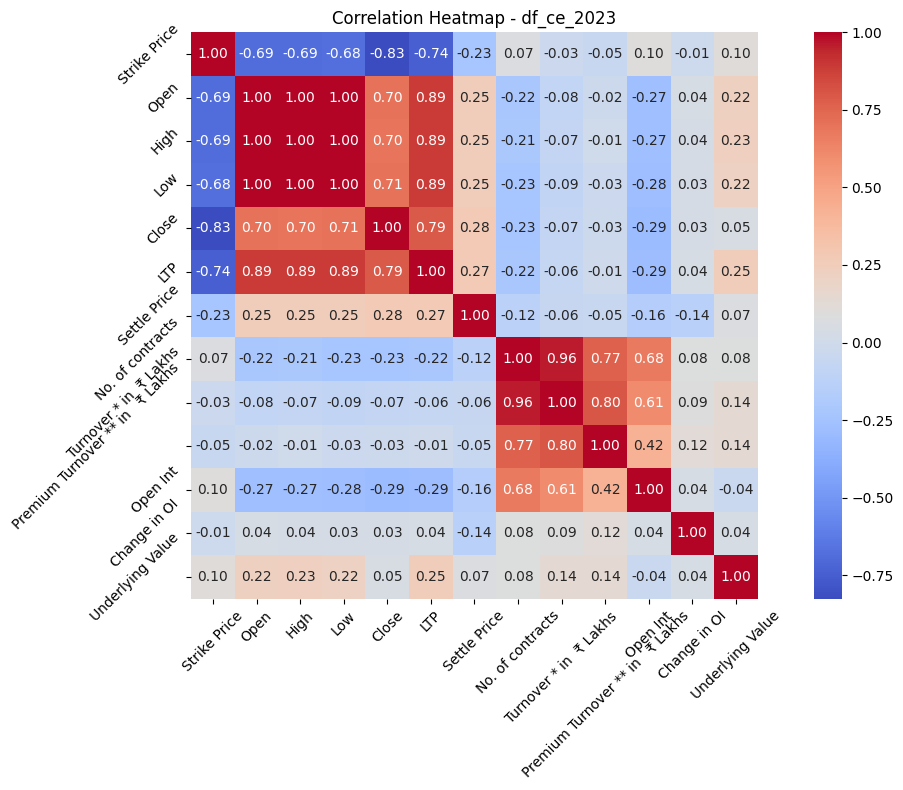

Correlation Heatmap plotted for df_ce_2023.

--- Correlation Heatmap for df_ce_2024 ---



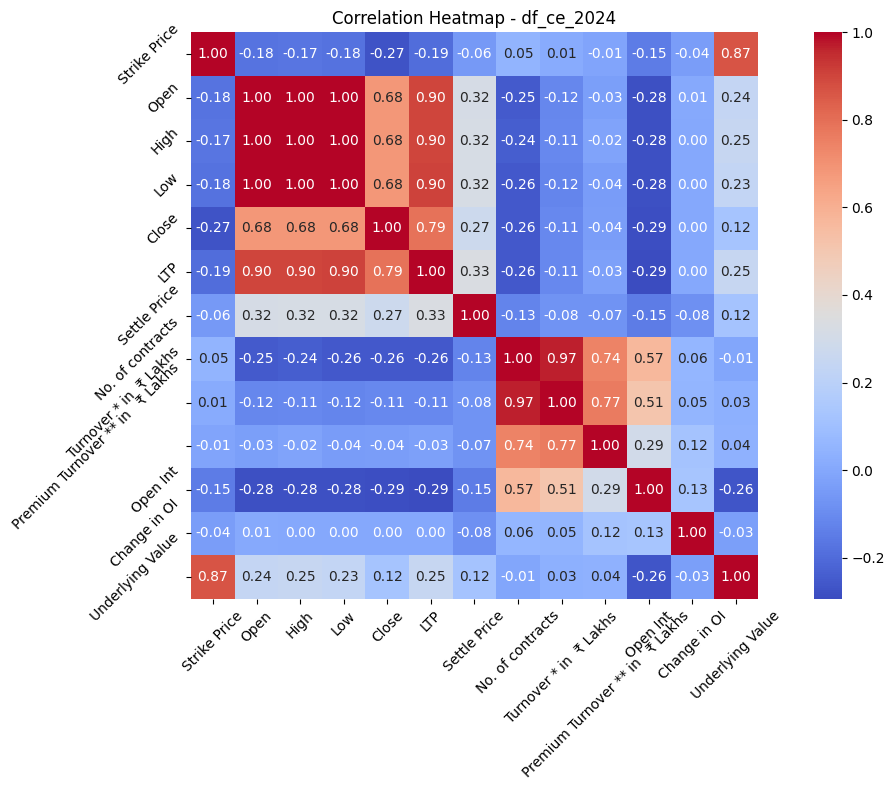

Correlation Heatmap plotted for df_ce_2024.

--- Correlation Heatmap for df_pe_2022 ---



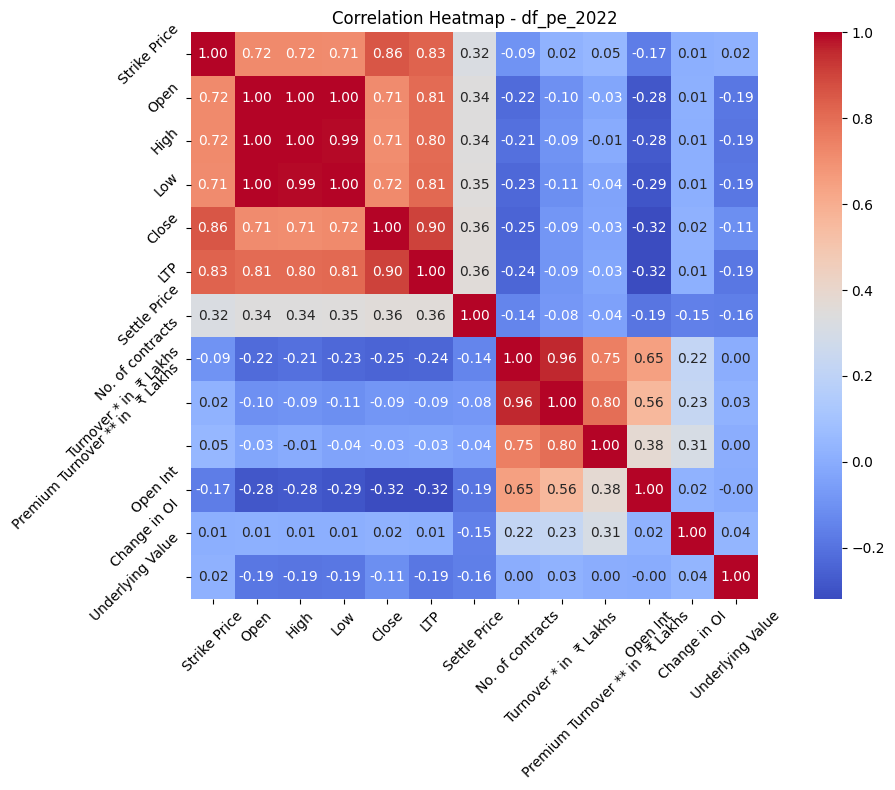

Correlation Heatmap plotted for df_pe_2022.

--- Correlation Heatmap for df_pe_2023 ---



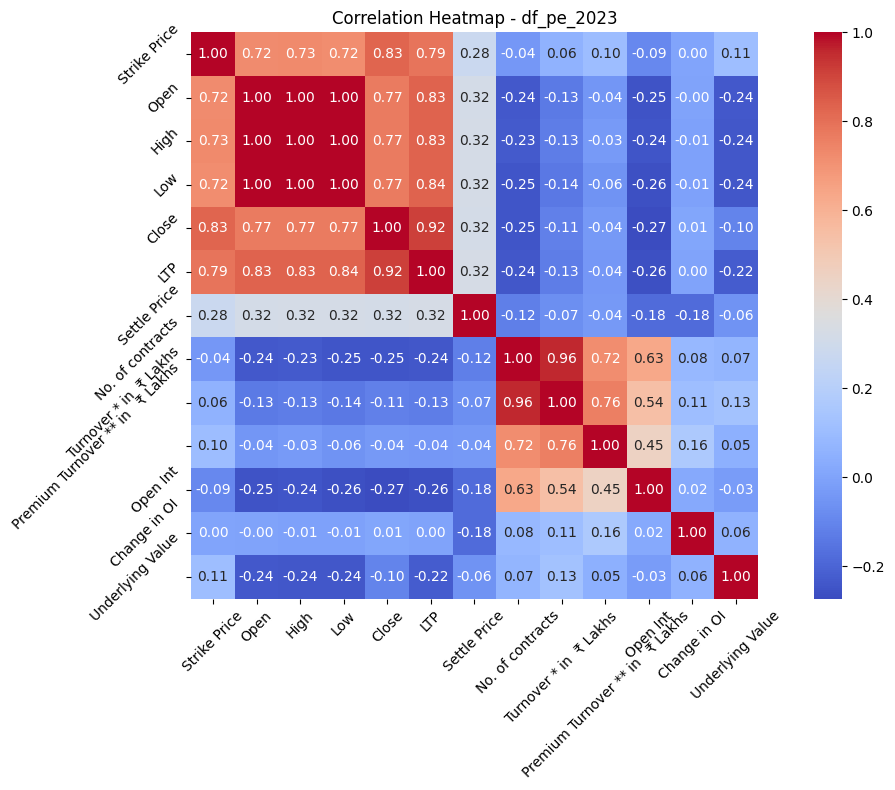

Correlation Heatmap plotted for df_pe_2023.

--- Correlation Heatmap for df_pe_2024 ---



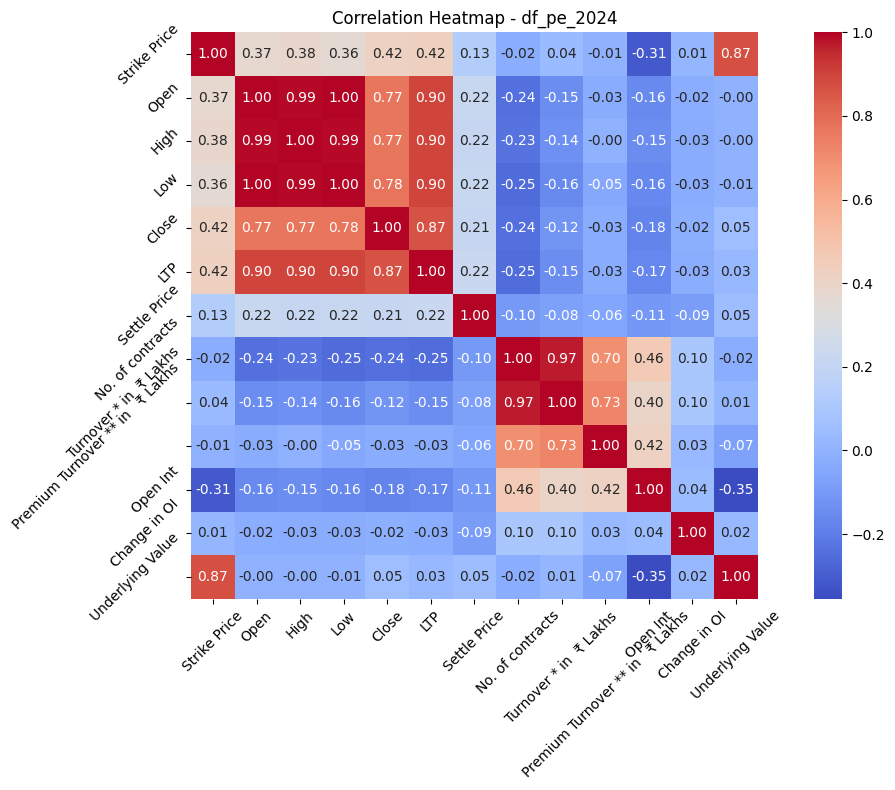

Correlation Heatmap plotted for df_pe_2024.

--- Correlation Heatmap for df_ce_all ---



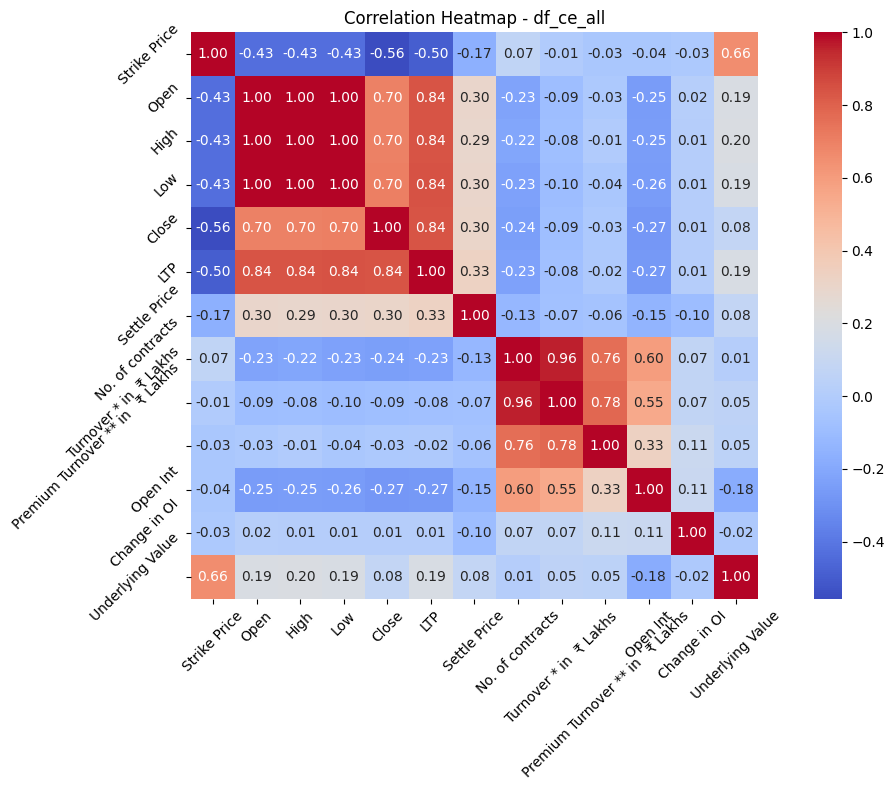

Correlation Heatmap plotted for df_ce_all.

--- Correlation Heatmap for df_pe_all ---



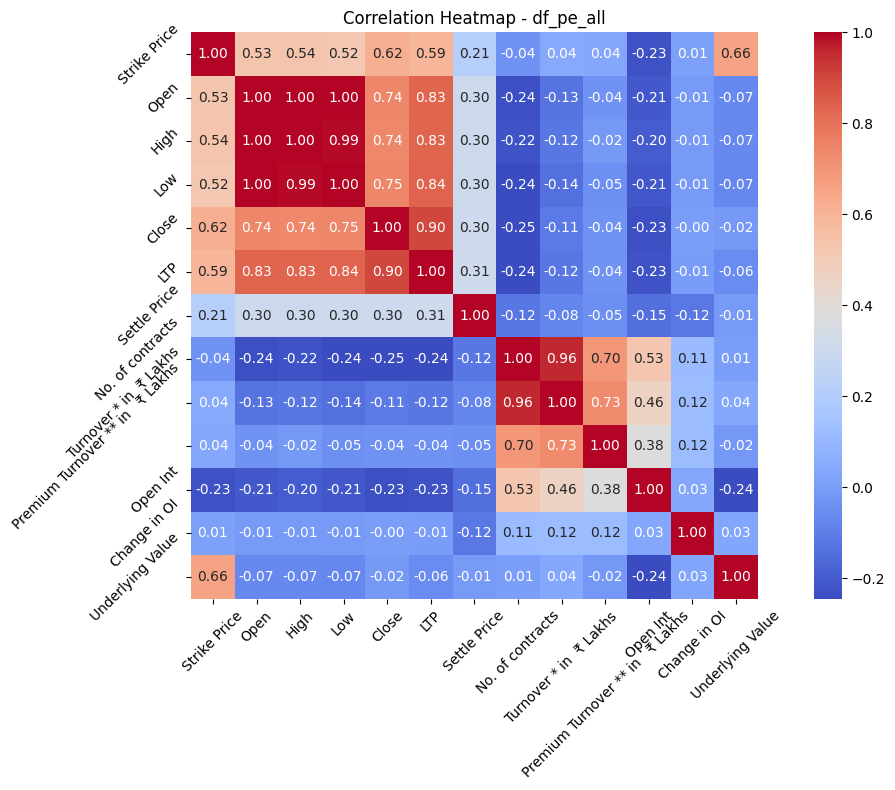

Correlation Heatmap plotted for df_pe_all.

--- Correlation Heatmap for df_ce_pe_2022 ---



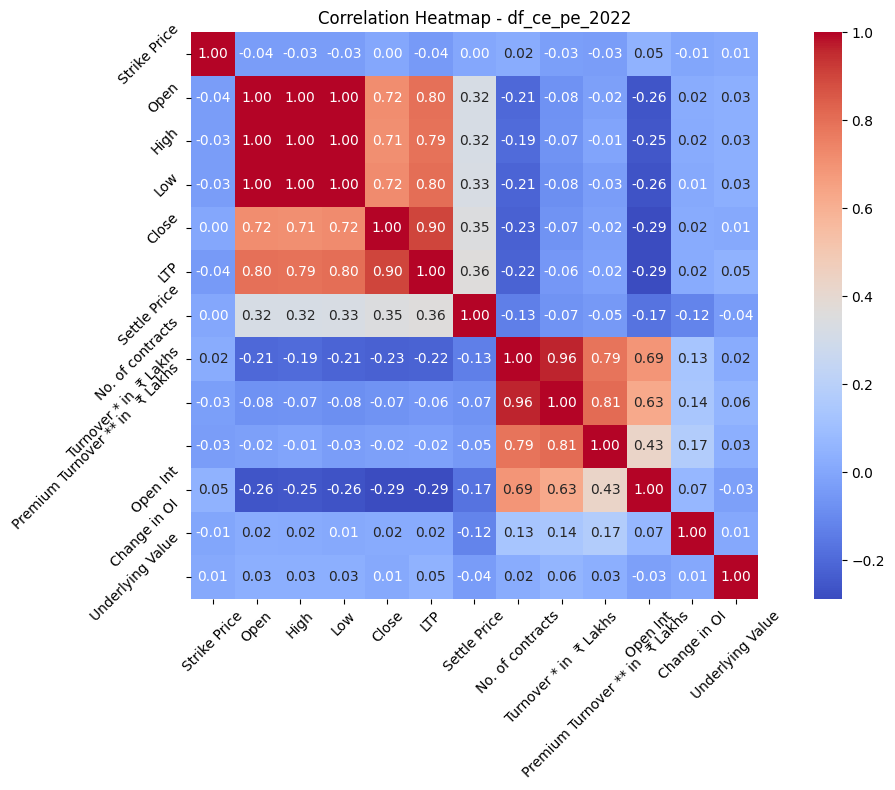

Correlation Heatmap plotted for df_ce_pe_2022.

--- Correlation Heatmap for df_ce_pe_2023 ---



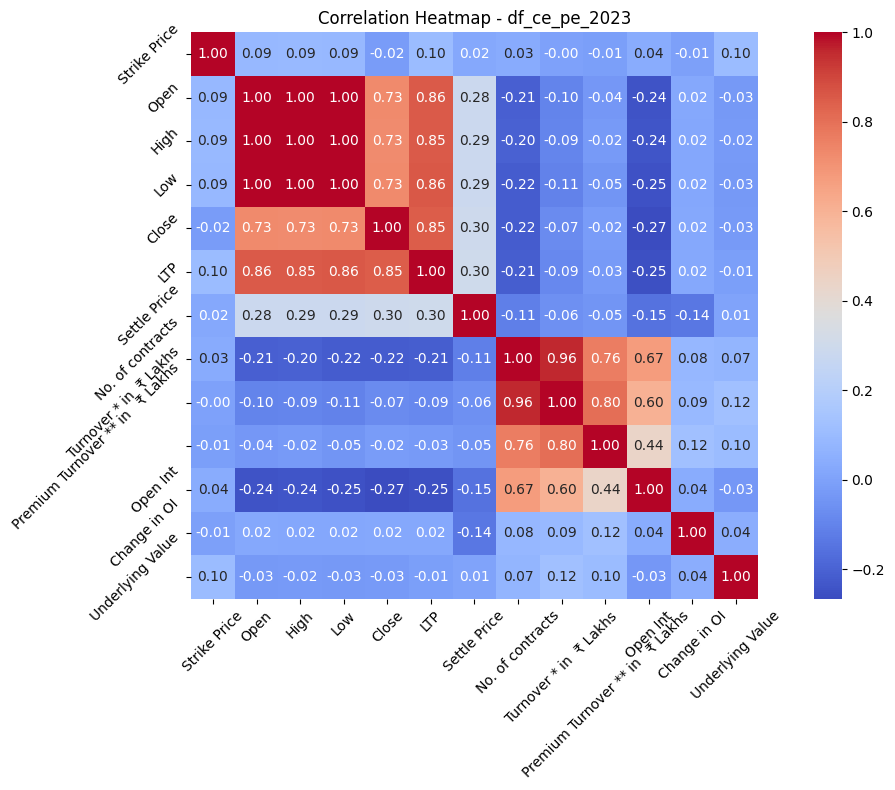

Correlation Heatmap plotted for df_ce_pe_2023.

--- Correlation Heatmap for df_ce_pe_2024 ---



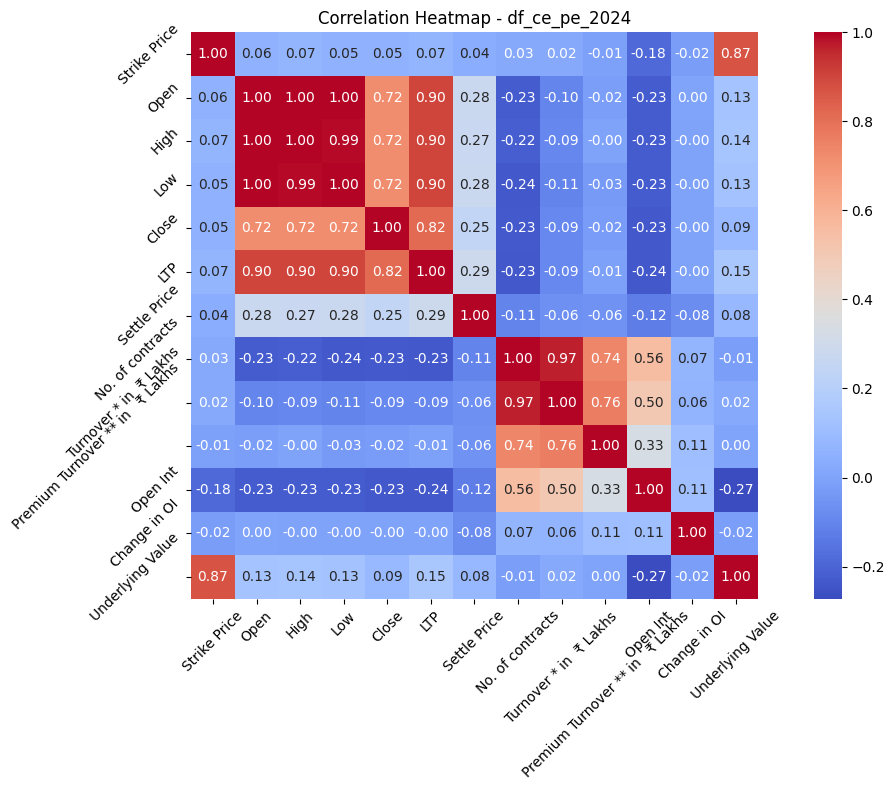

Correlation Heatmap plotted for df_ce_pe_2024.

--- Correlation Heatmap for df_options_combo ---



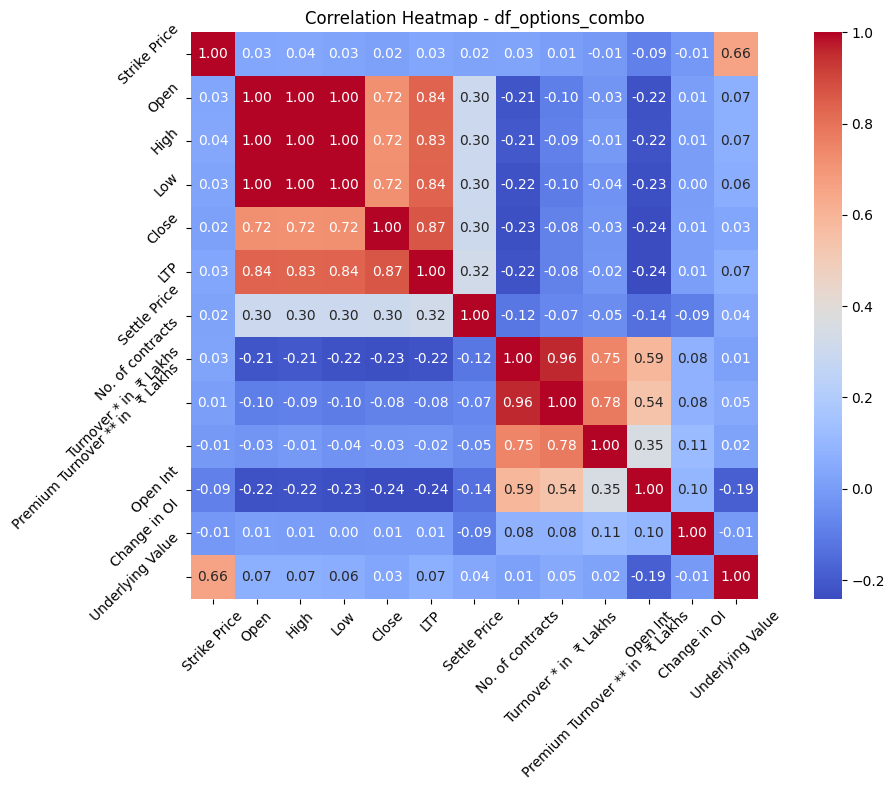

Correlation Heatmap plotted for df_options_combo.



In [56]:
# Correlation Heatmap

# Data Visualization - 2

# Function to plot correlation heatmap
def plot_correlation_heatmap(df, dataset_name):
    print(f"--- Correlation Heatmap for {dataset_name} ---\n")

    # Specify the columns for correlation
    columns = [
        'Strike Price', 'Open', 'High', 'Low', 'Close', 'LTP', 'Settle Price',
        'No. of contracts', 'Turnover * in  ₹ Lakhs', 'Premium Turnover ** in   ₹ Lakhs',
        'Open Int', 'Change in OI', 'Underlying Value'
    ]

    # Filter DataFrame for specified columns
    available_columns = [col for col in columns if col in df.columns]
    if not available_columns:
        print(f"No specified columns found in {dataset_name}.")
        return

    # Calculate correlation matrix
    corr_matrix = df[available_columns].corr()

    # Plot heatmap
    plt.figure(figsize=(12, 8))
    sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap='coolwarm', cbar=True, square=True)
    plt.title(f"Correlation Heatmap - {dataset_name}")
    plt.xticks(rotation=45)
    plt.yticks(rotation=45)
    plt.tight_layout()
    plt.show()

    print(f"Correlation Heatmap plotted for {dataset_name}.\n")

# List of datasets
datasets = {
    "df_ce_2022": df_ce_2022,
    "df_ce_2023": df_ce_2023,
    "df_ce_2024": df_ce_2024,
    "df_pe_2022": df_pe_2022,
    "df_pe_2023": df_pe_2023,
    "df_pe_2024": df_pe_2024,
    "df_ce_all": df_ce_all,
    "df_pe_all": df_pe_all,
    "df_ce_pe_2022": df_ce_pe_2022,
    "df_ce_pe_2023": df_ce_pe_2023,
    "df_ce_pe_2024": df_ce_pe_2024,
    "df_options_combo": df_options_combo
}

# Plot correlation heatmap for each dataset
for name, dataset in datasets.items():
    plot_correlation_heatmap(dataset, name)

--- Candlestick Chart for df_ce_2022 ---



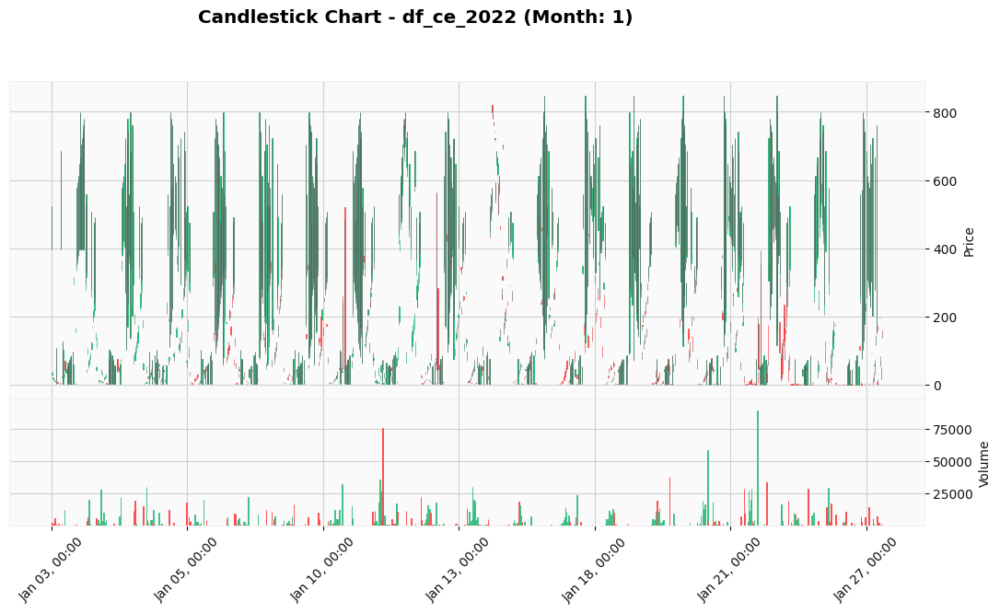

Candlestick Chart plotted for df_ce_2022 - Month 1.



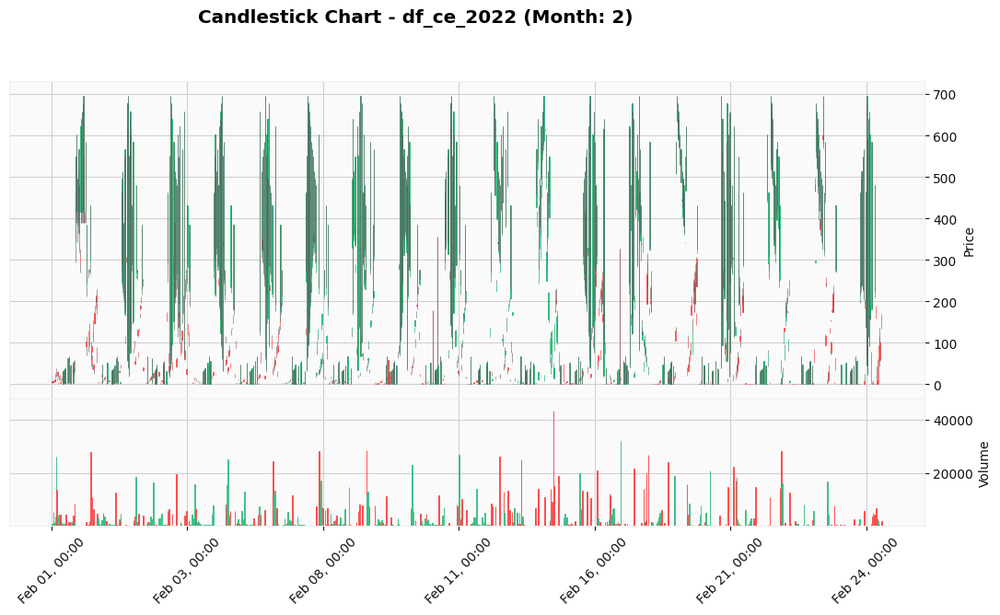

Candlestick Chart plotted for df_ce_2022 - Month 2.



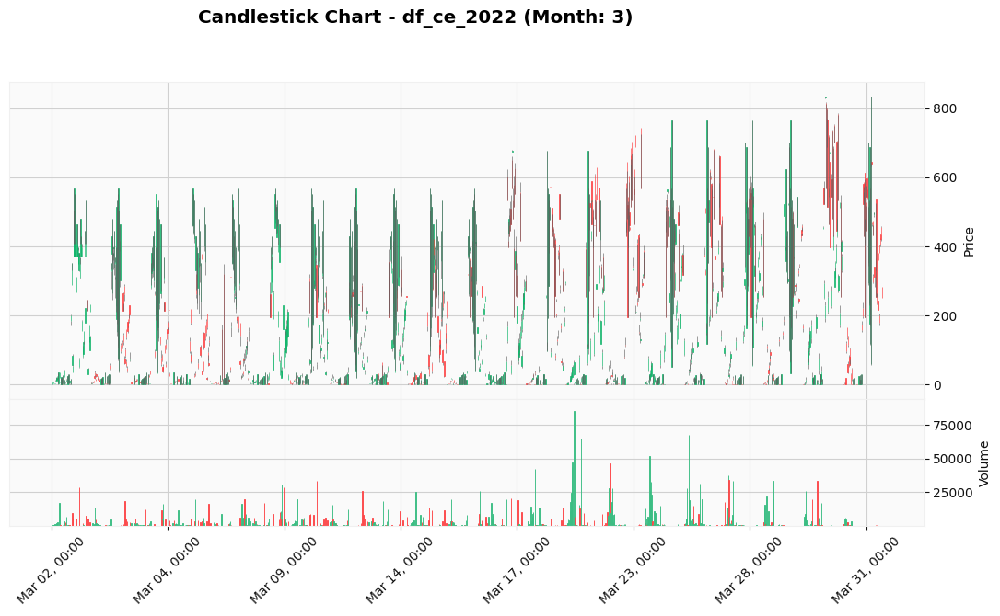

Candlestick Chart plotted for df_ce_2022 - Month 3.



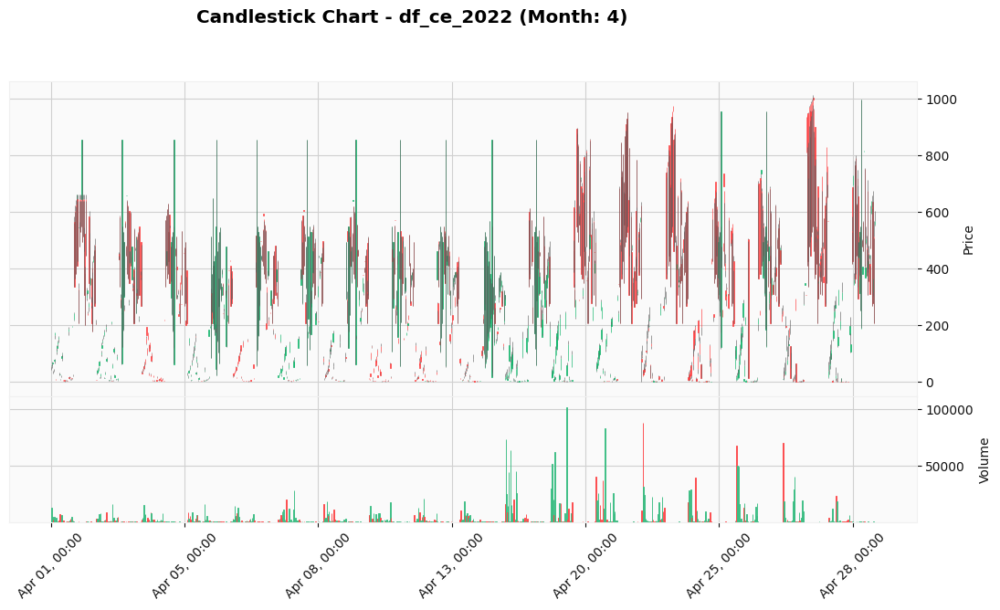

Candlestick Chart plotted for df_ce_2022 - Month 4.



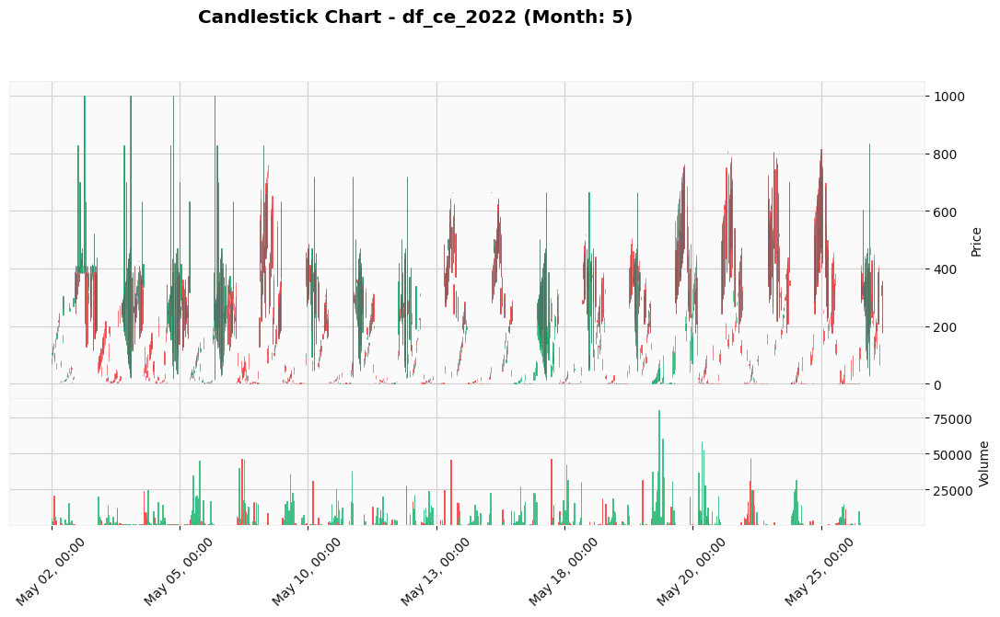

Candlestick Chart plotted for df_ce_2022 - Month 5.



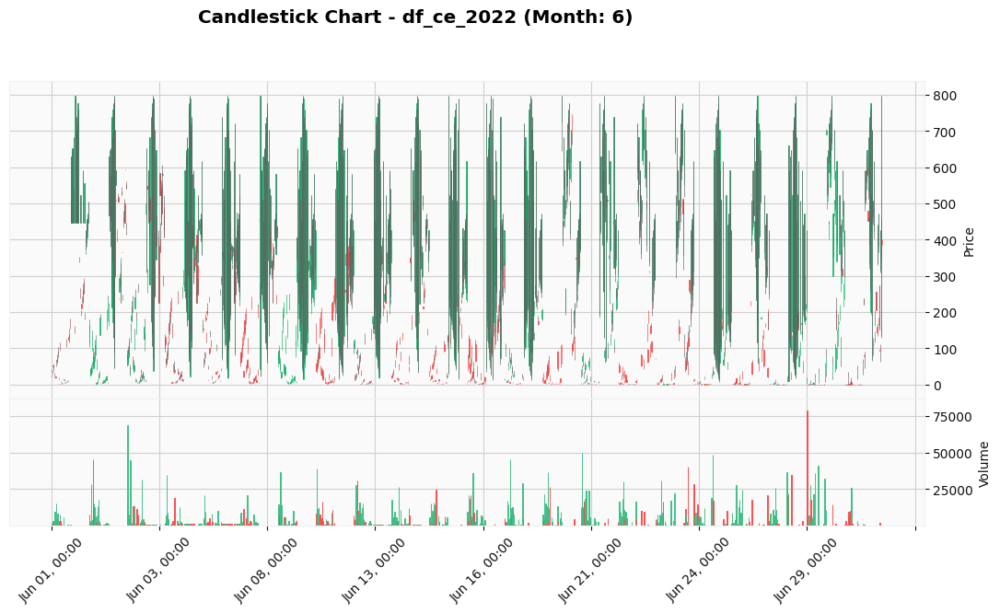

Candlestick Chart plotted for df_ce_2022 - Month 6.



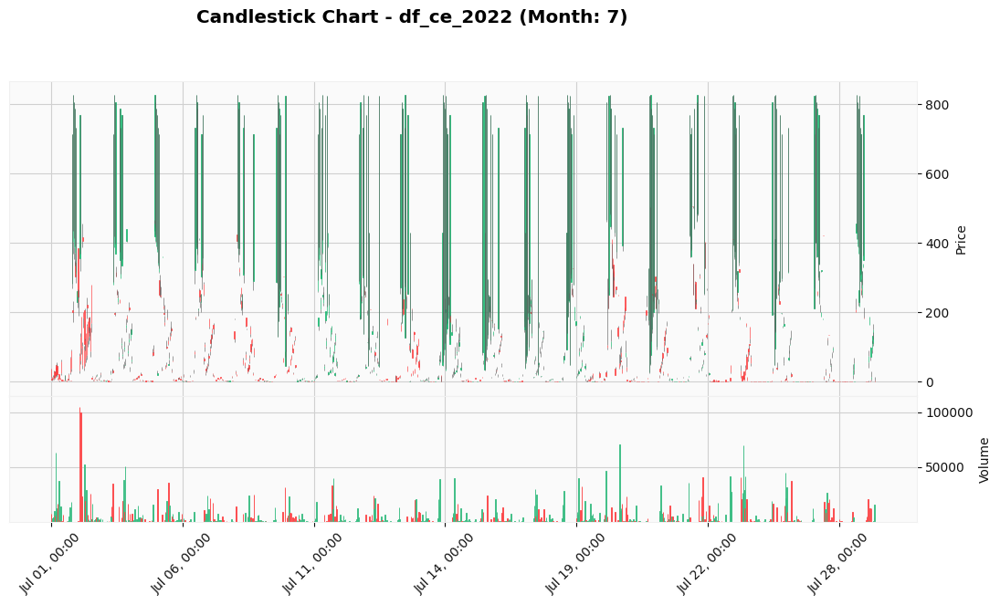

Candlestick Chart plotted for df_ce_2022 - Month 7.



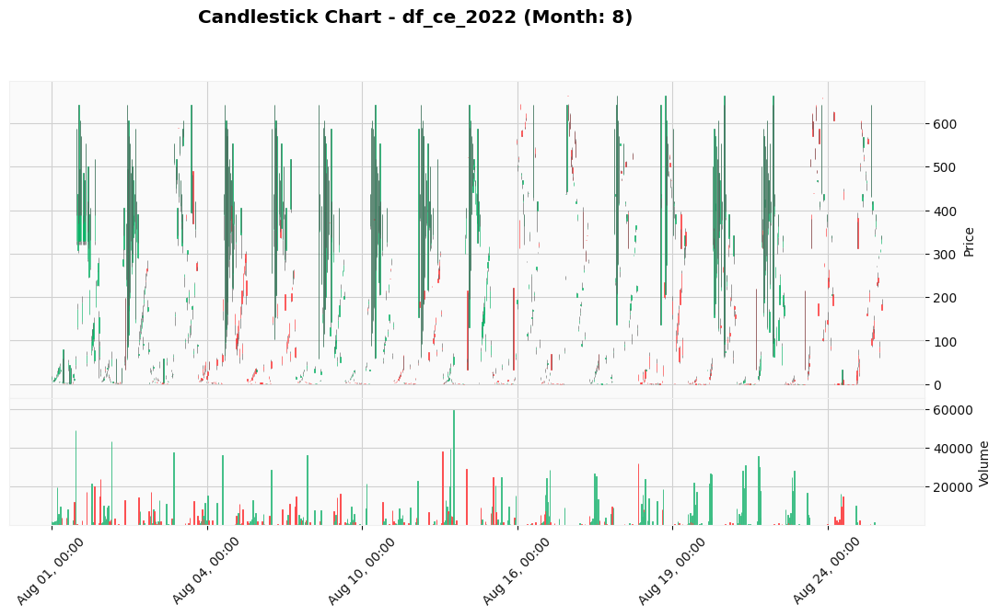

Candlestick Chart plotted for df_ce_2022 - Month 8.



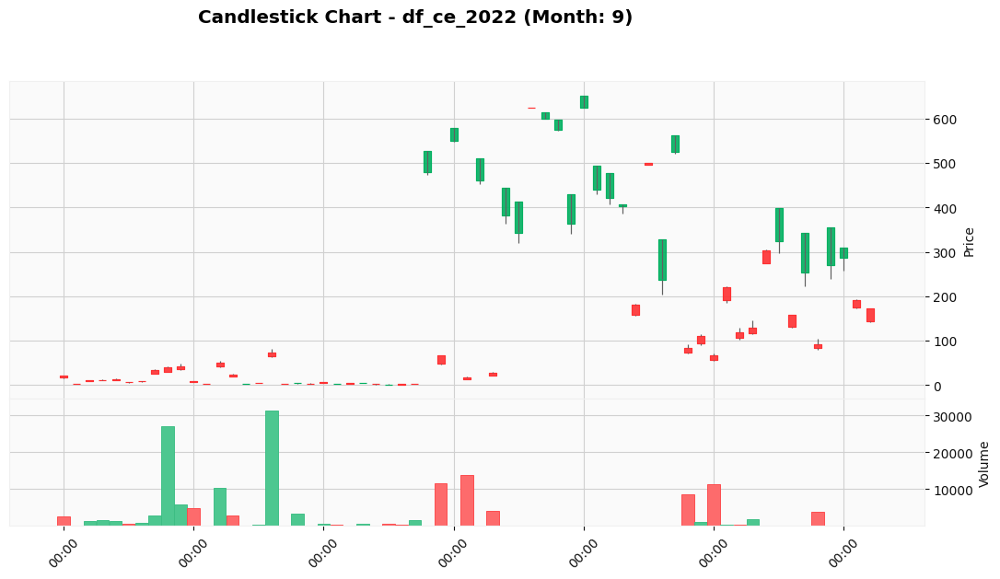

Candlestick Chart plotted for df_ce_2022 - Month 9.



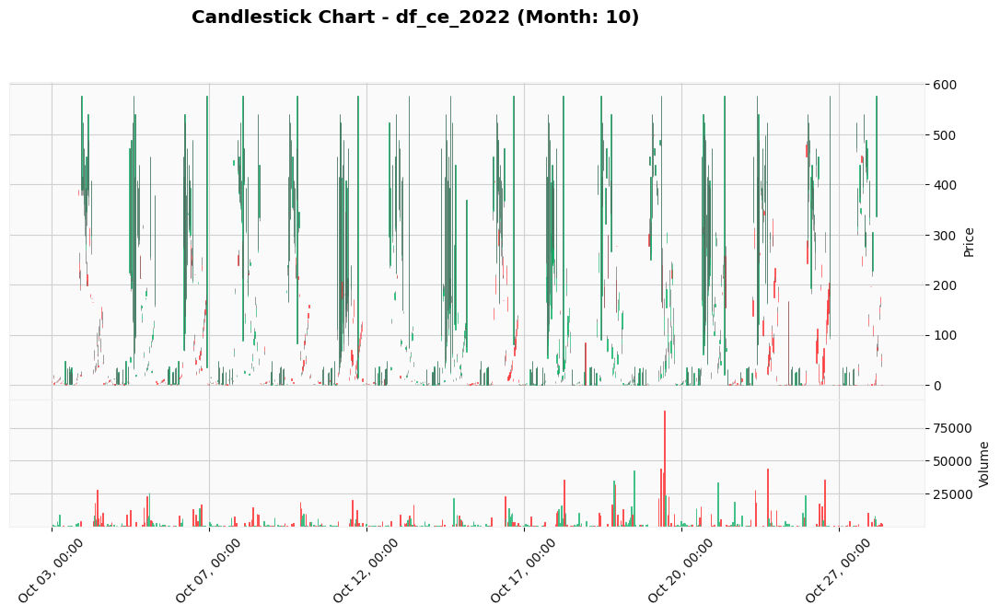

Candlestick Chart plotted for df_ce_2022 - Month 10.



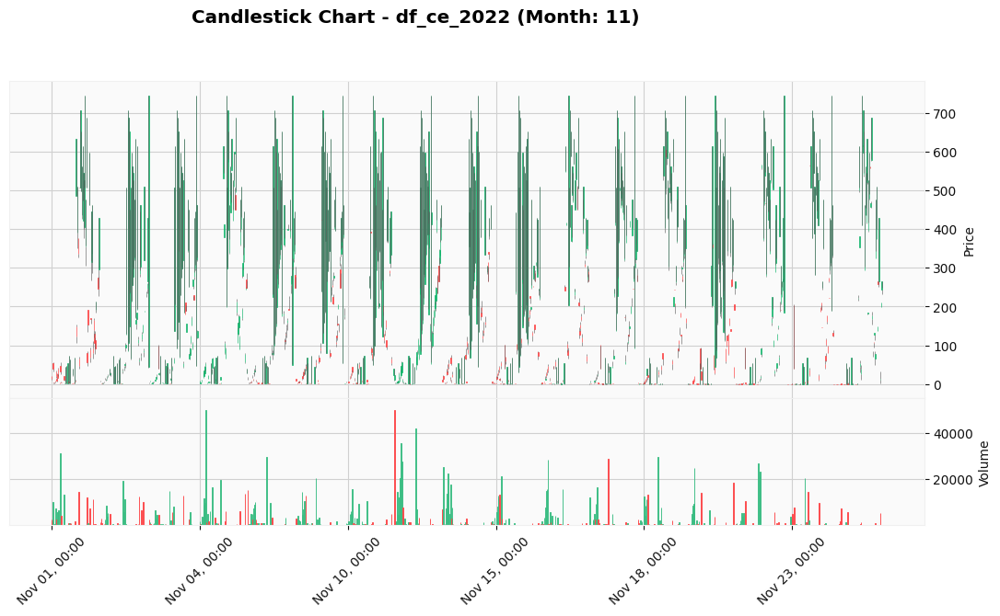

Candlestick Chart plotted for df_ce_2022 - Month 11.



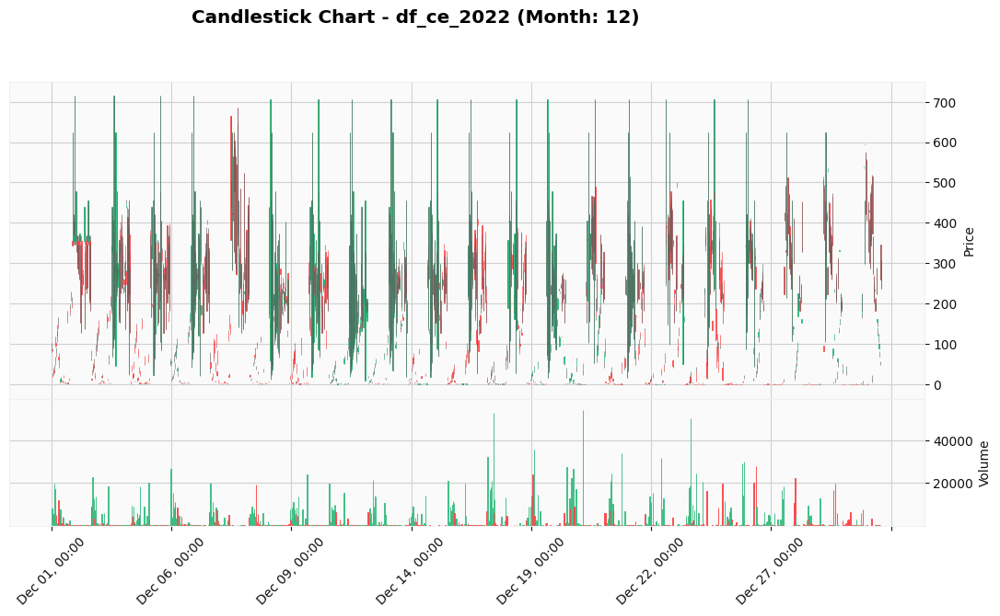

Candlestick Chart plotted for df_ce_2022 - Month 12.

--- Candlestick Chart for df_ce_2023 ---



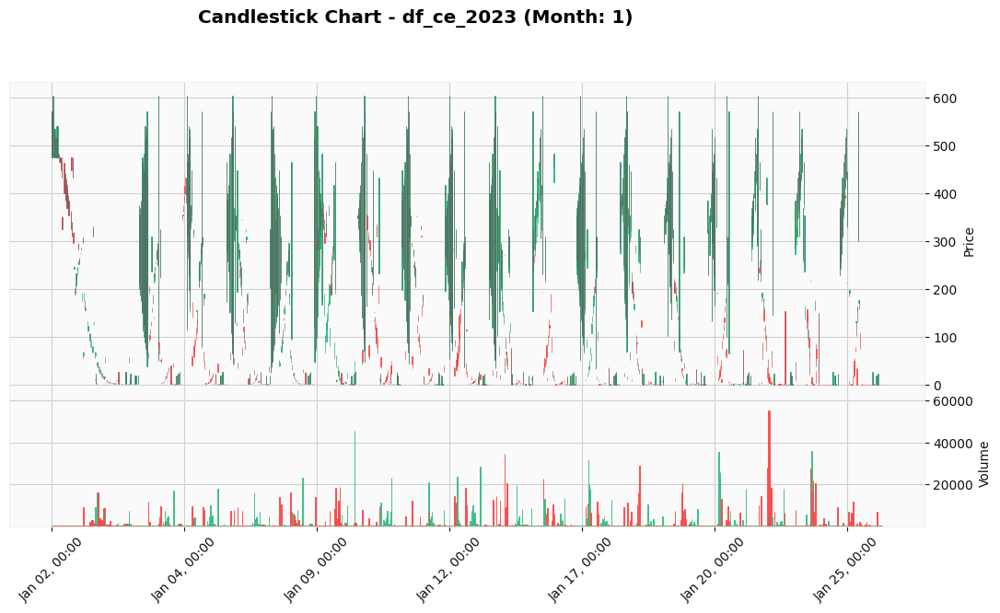

Candlestick Chart plotted for df_ce_2023 - Month 1.



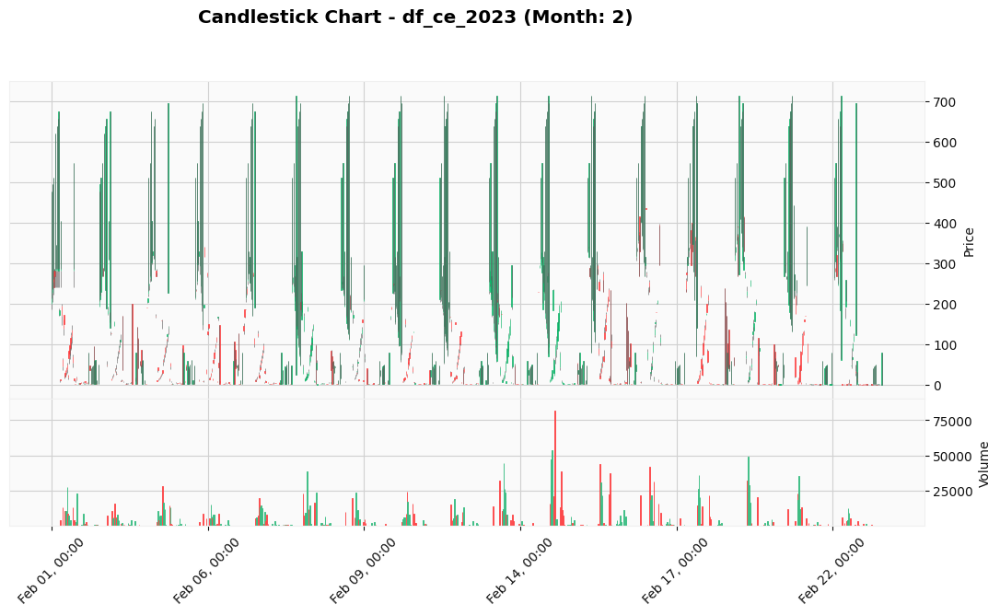

Candlestick Chart plotted for df_ce_2023 - Month 2.



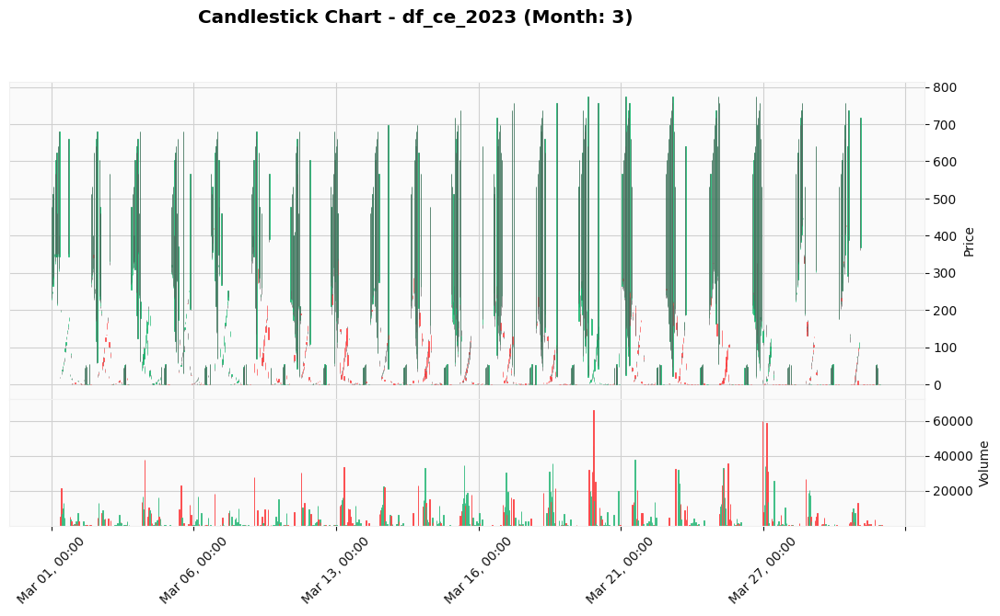

Candlestick Chart plotted for df_ce_2023 - Month 3.



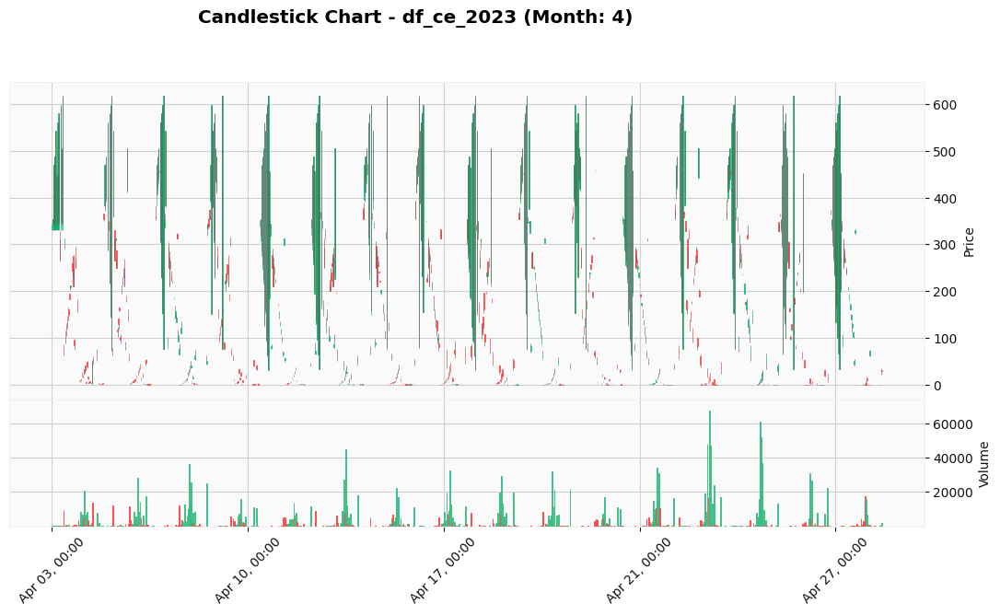

Candlestick Chart plotted for df_ce_2023 - Month 4.



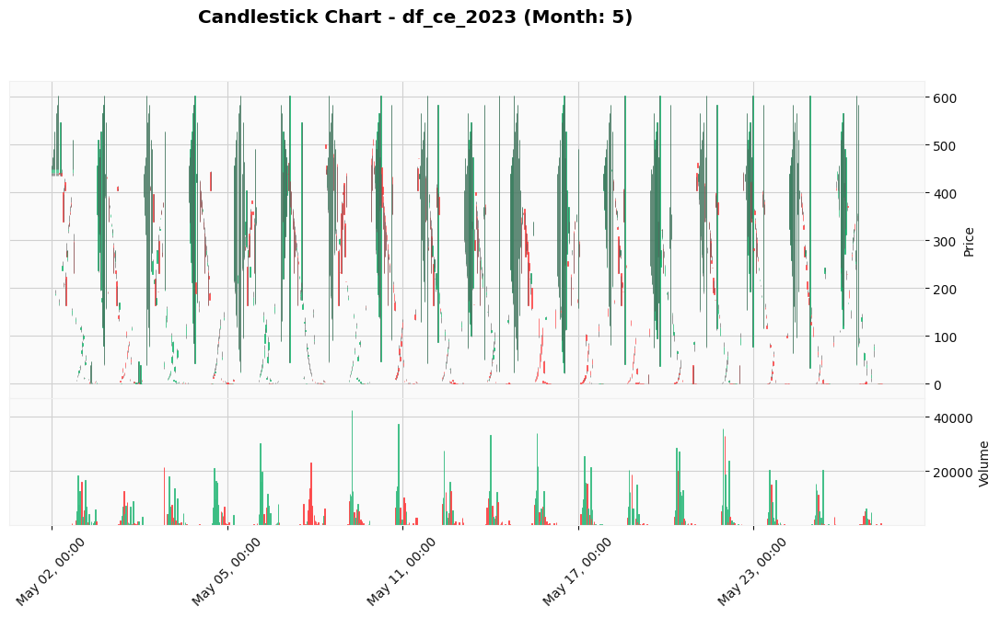

Candlestick Chart plotted for df_ce_2023 - Month 5.



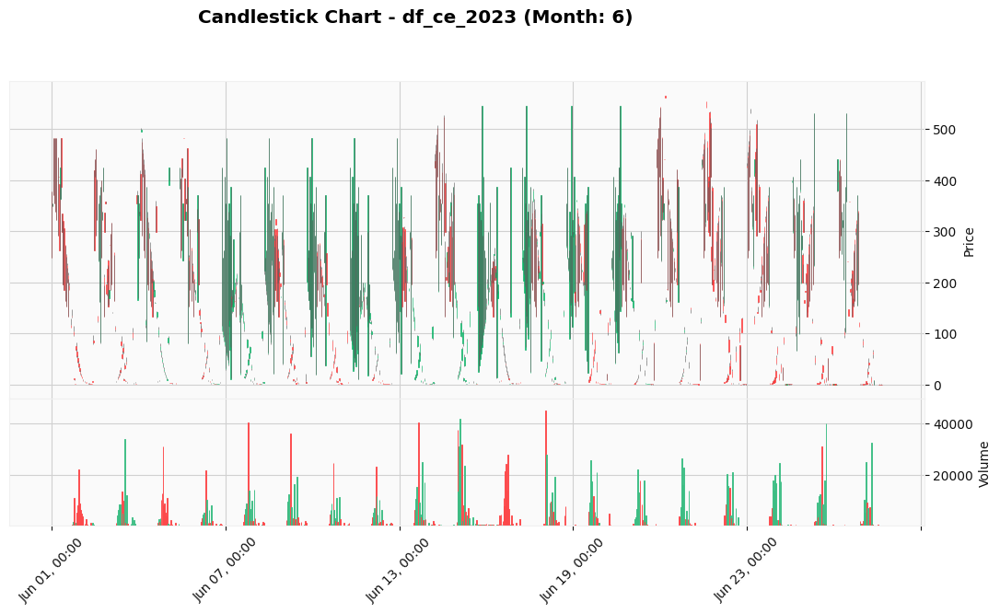

Candlestick Chart plotted for df_ce_2023 - Month 6.



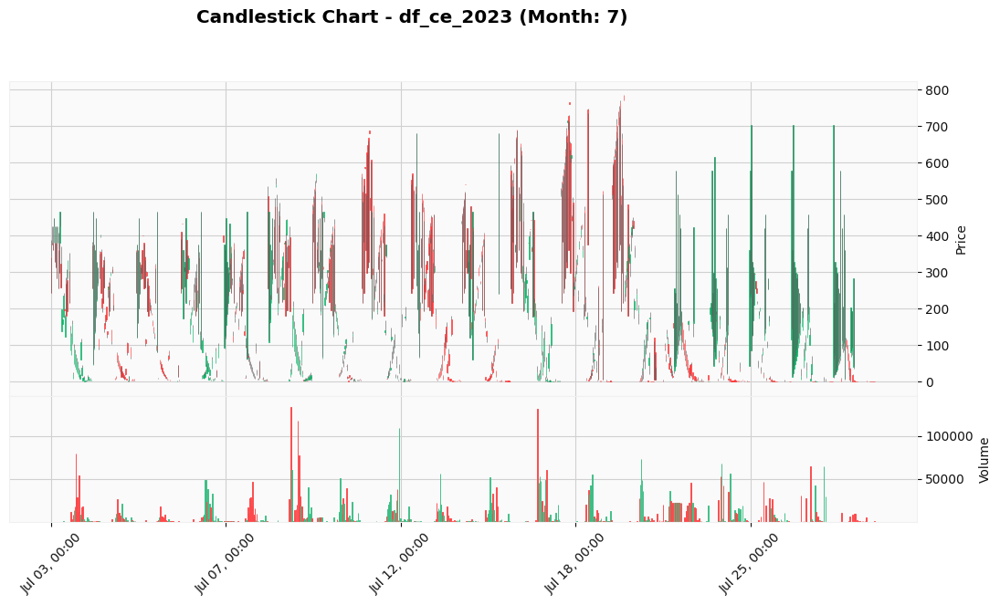

Candlestick Chart plotted for df_ce_2023 - Month 7.



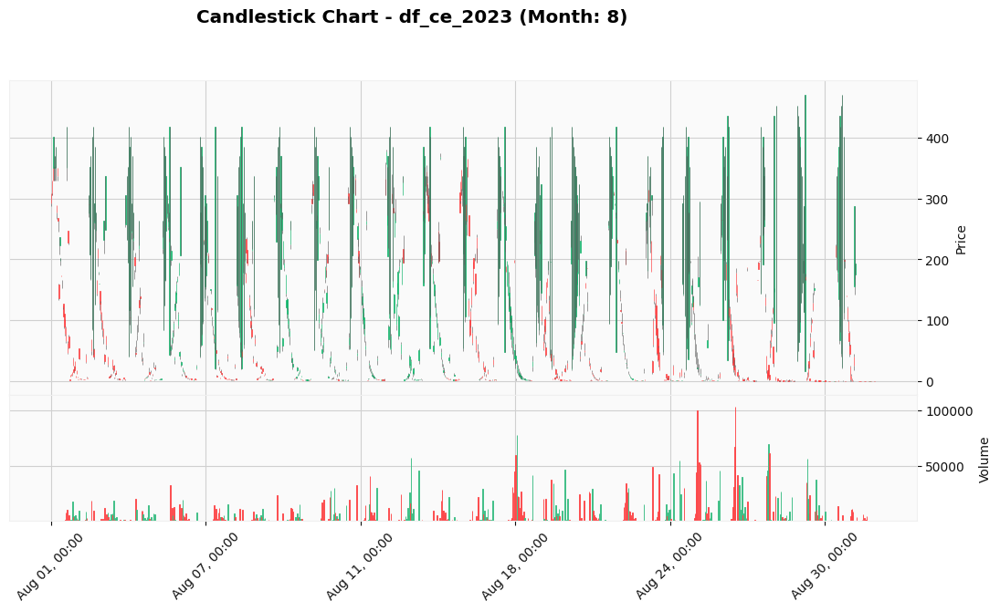

Candlestick Chart plotted for df_ce_2023 - Month 8.



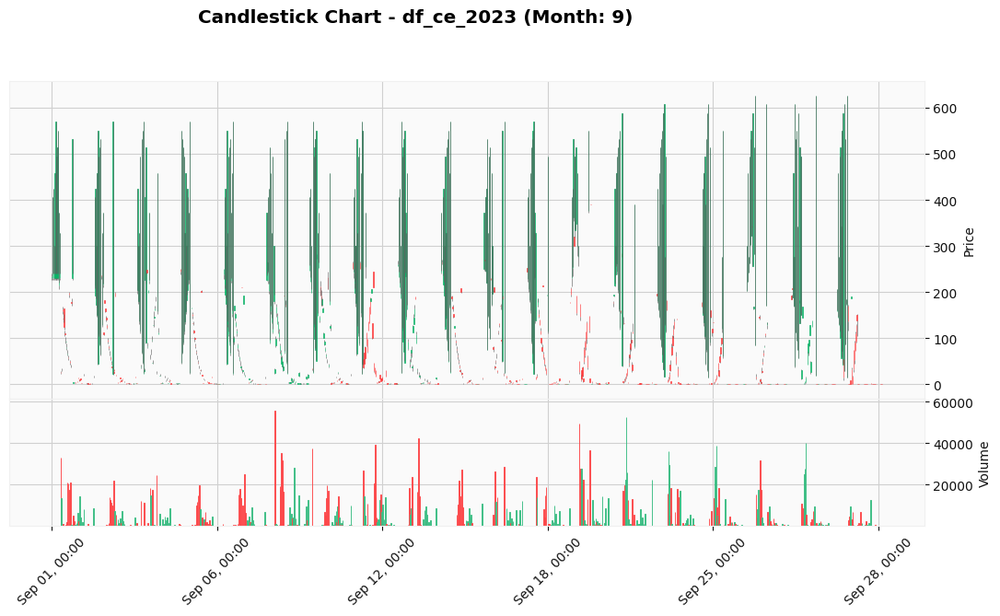

Candlestick Chart plotted for df_ce_2023 - Month 9.



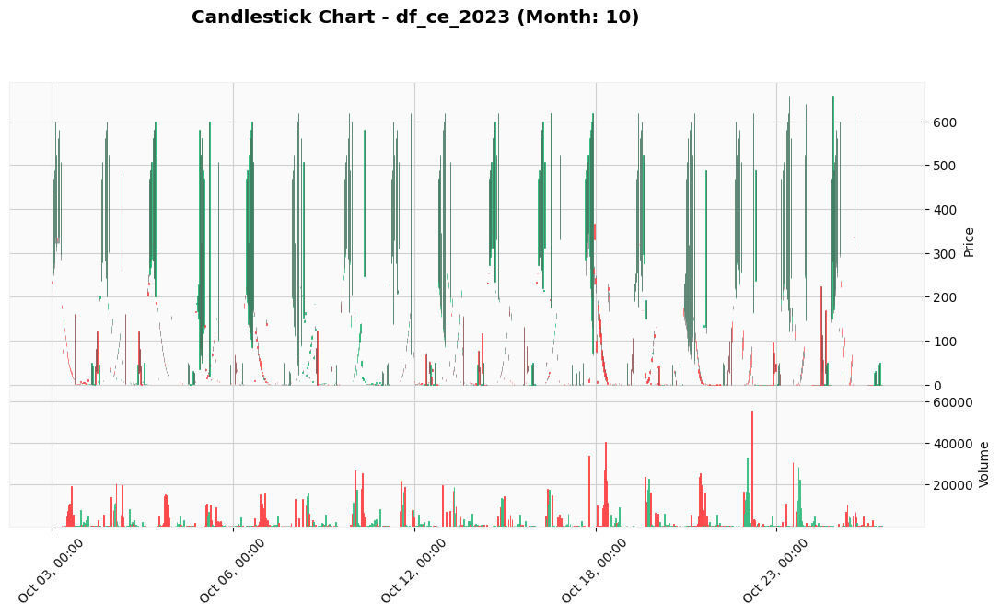

Candlestick Chart plotted for df_ce_2023 - Month 10.



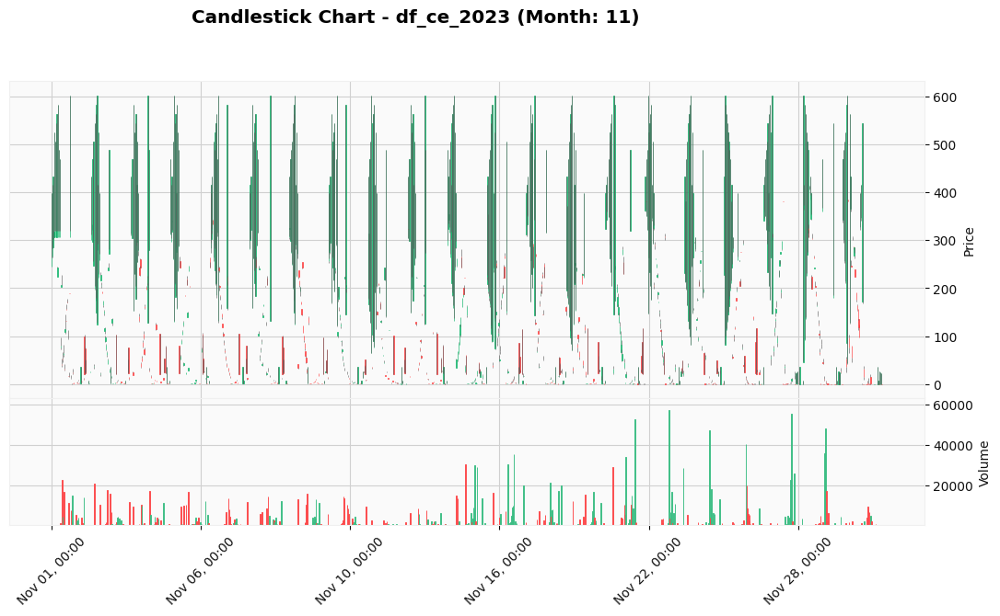

Candlestick Chart plotted for df_ce_2023 - Month 11.



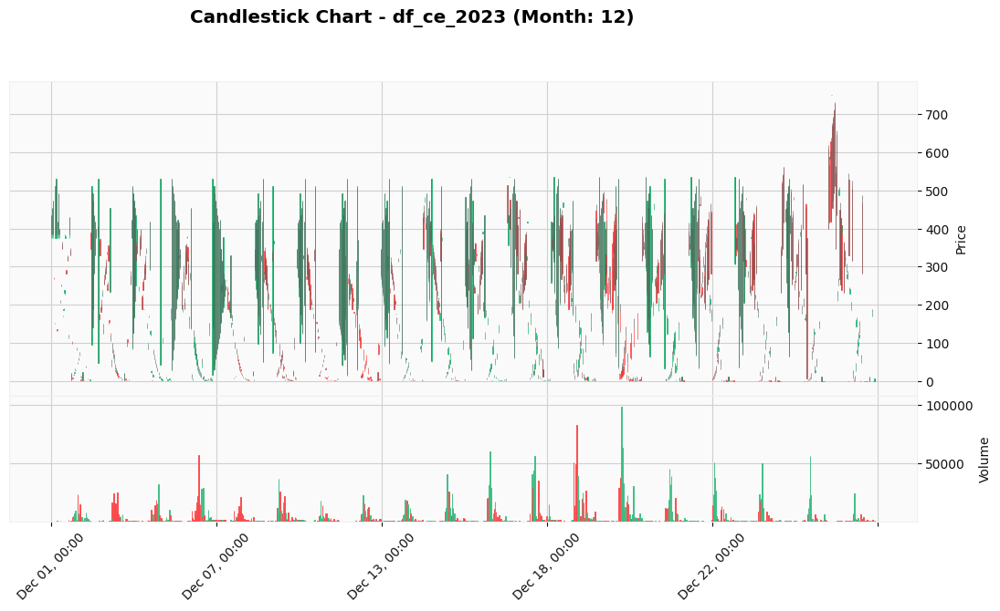

Candlestick Chart plotted for df_ce_2023 - Month 12.

--- Candlestick Chart for df_ce_2024 ---



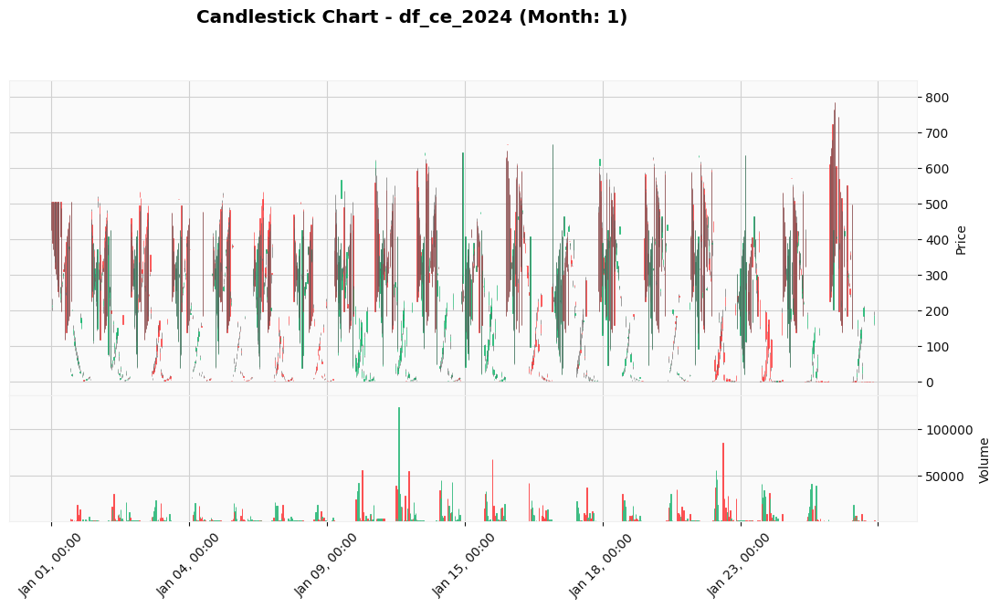

Candlestick Chart plotted for df_ce_2024 - Month 1.



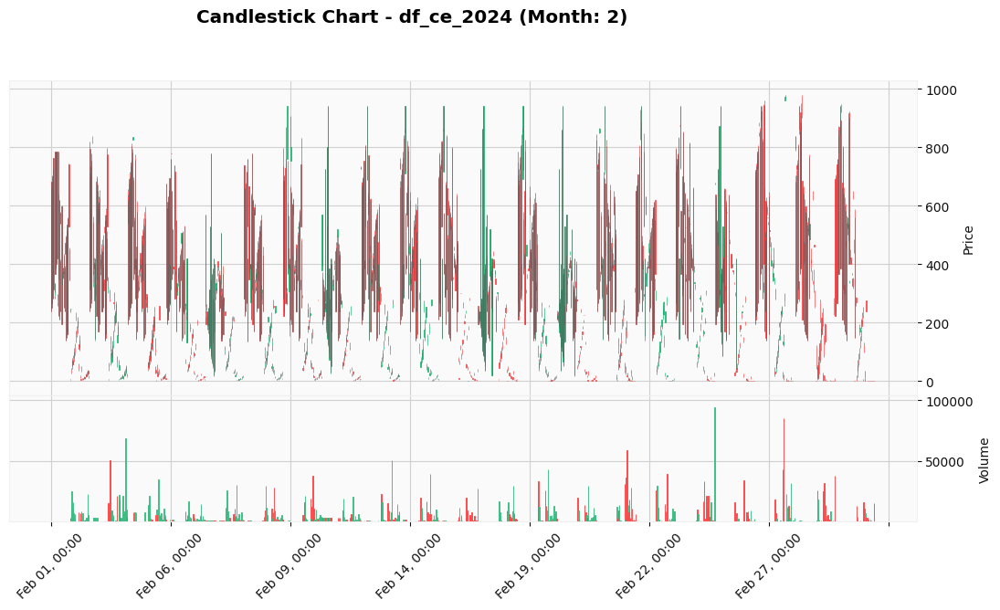

Candlestick Chart plotted for df_ce_2024 - Month 2.



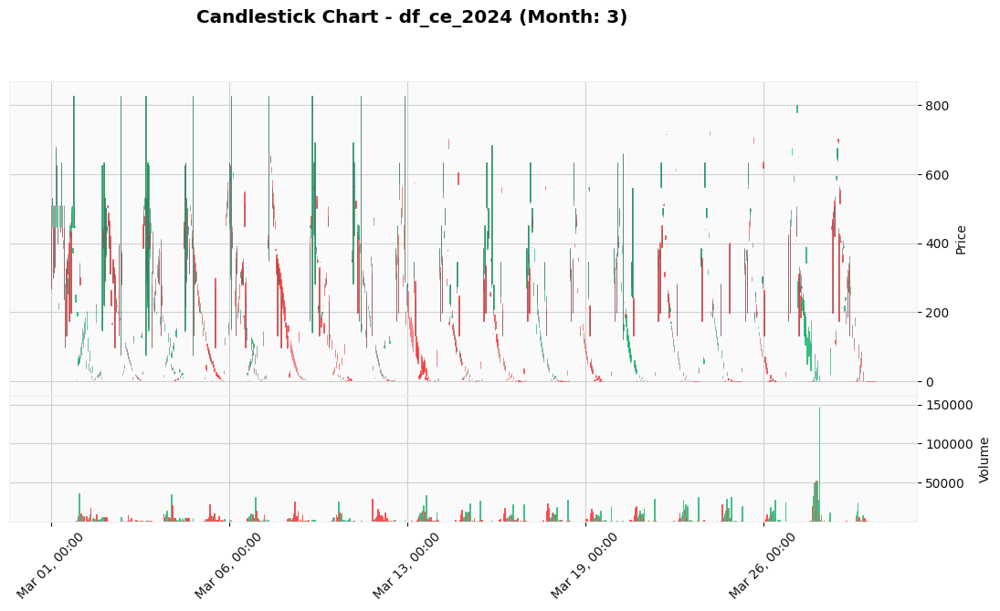

Candlestick Chart plotted for df_ce_2024 - Month 3.



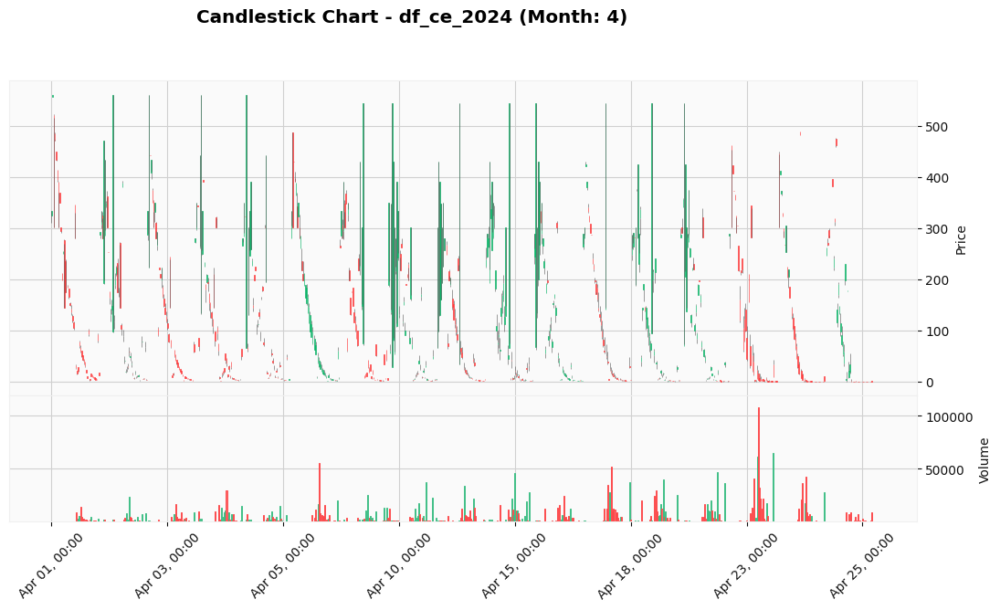

Candlestick Chart plotted for df_ce_2024 - Month 4.



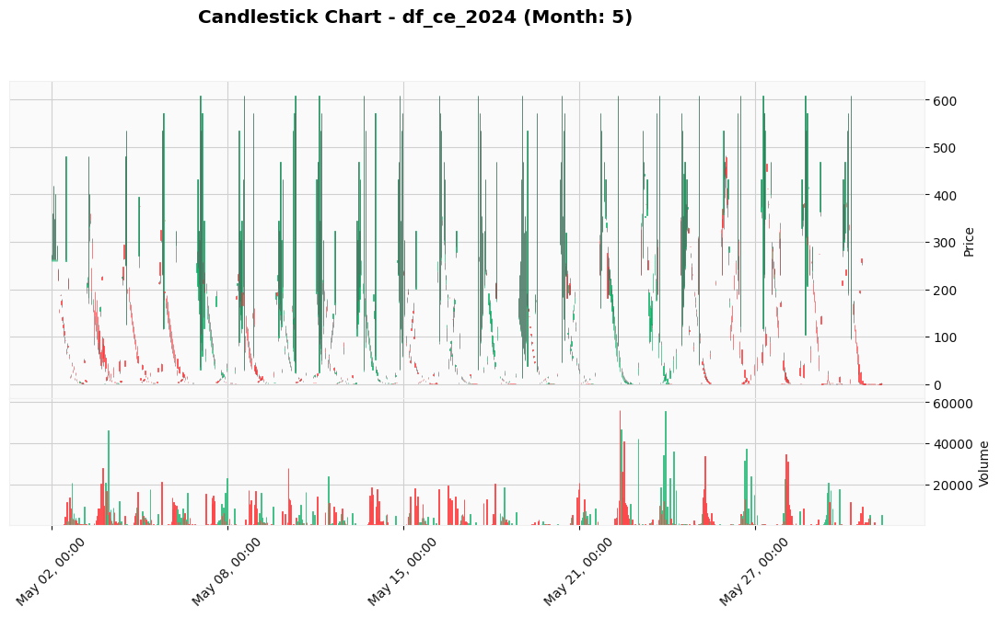

Candlestick Chart plotted for df_ce_2024 - Month 5.



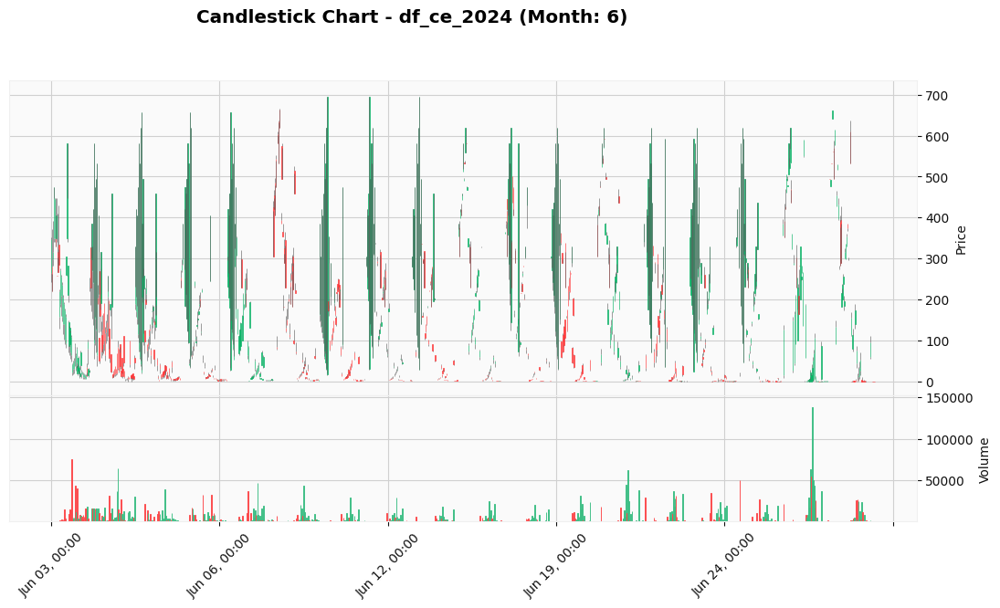

Candlestick Chart plotted for df_ce_2024 - Month 6.



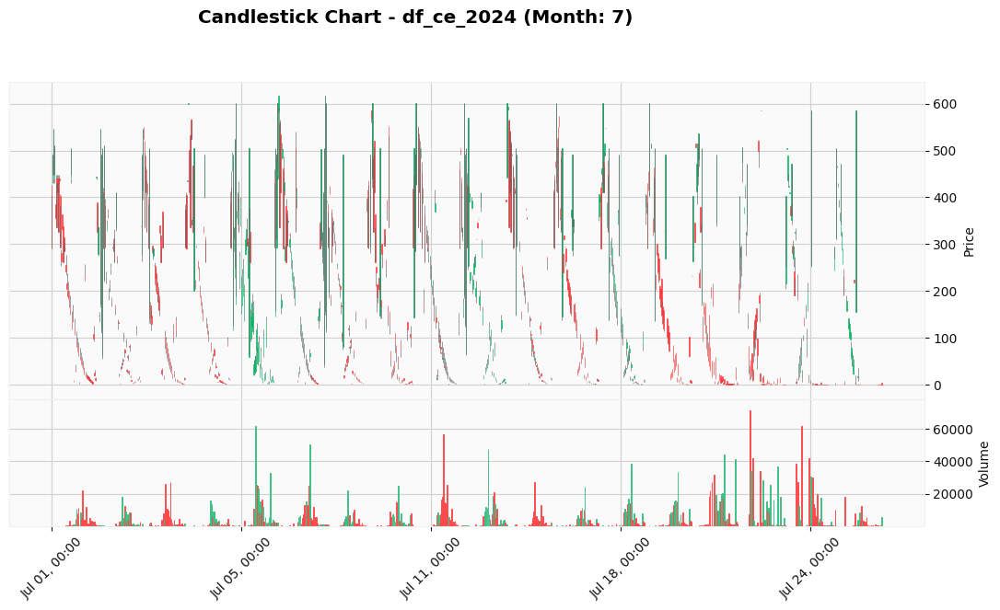

Candlestick Chart plotted for df_ce_2024 - Month 7.



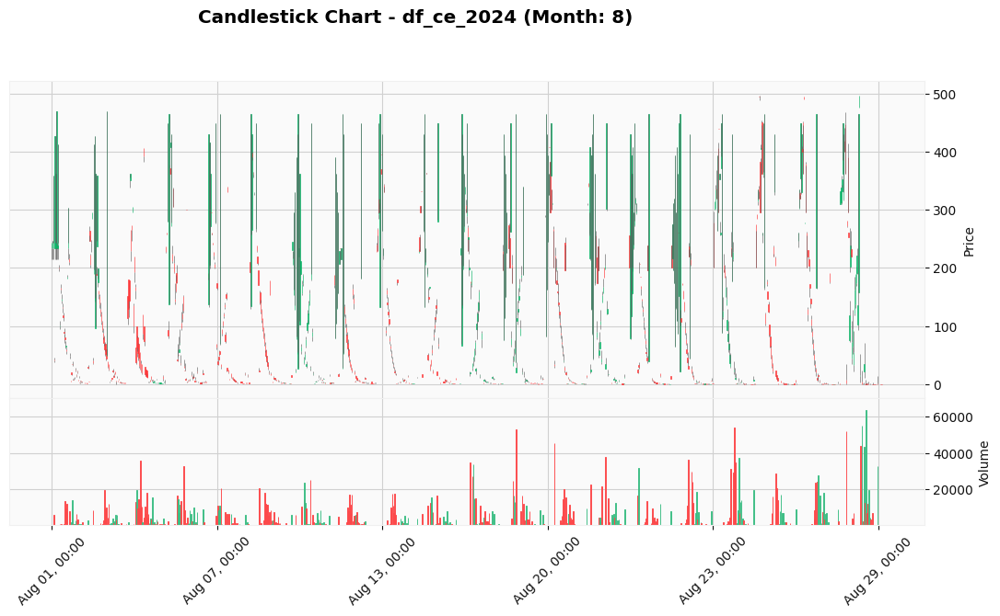

Candlestick Chart plotted for df_ce_2024 - Month 8.



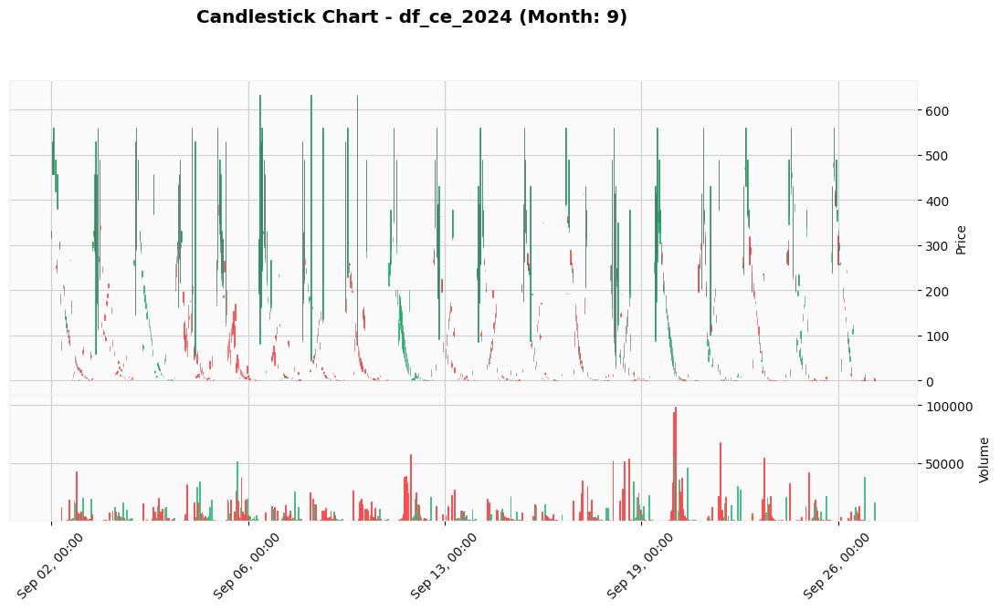

Candlestick Chart plotted for df_ce_2024 - Month 9.



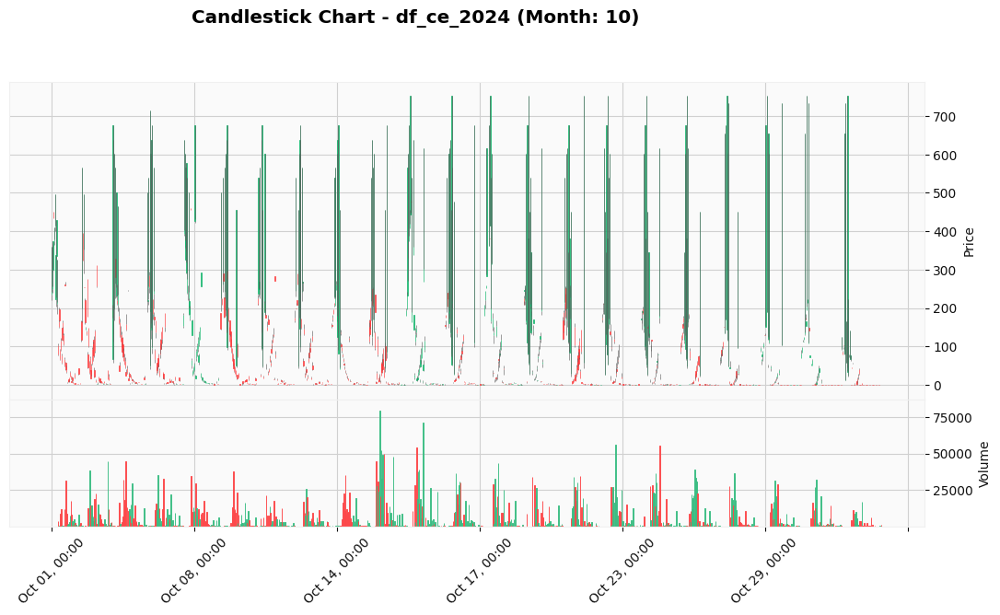

Candlestick Chart plotted for df_ce_2024 - Month 10.



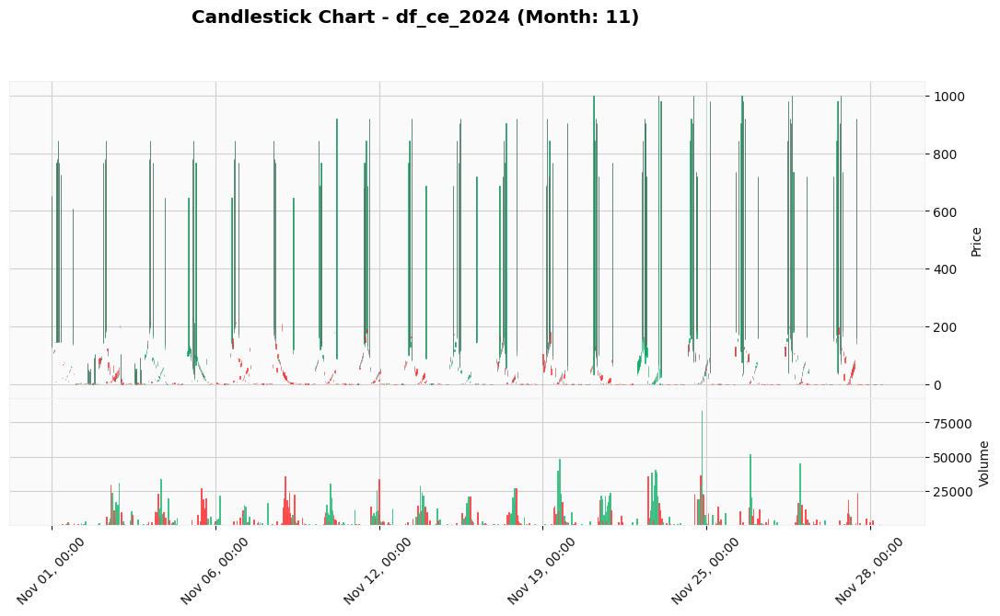

Candlestick Chart plotted for df_ce_2024 - Month 11.



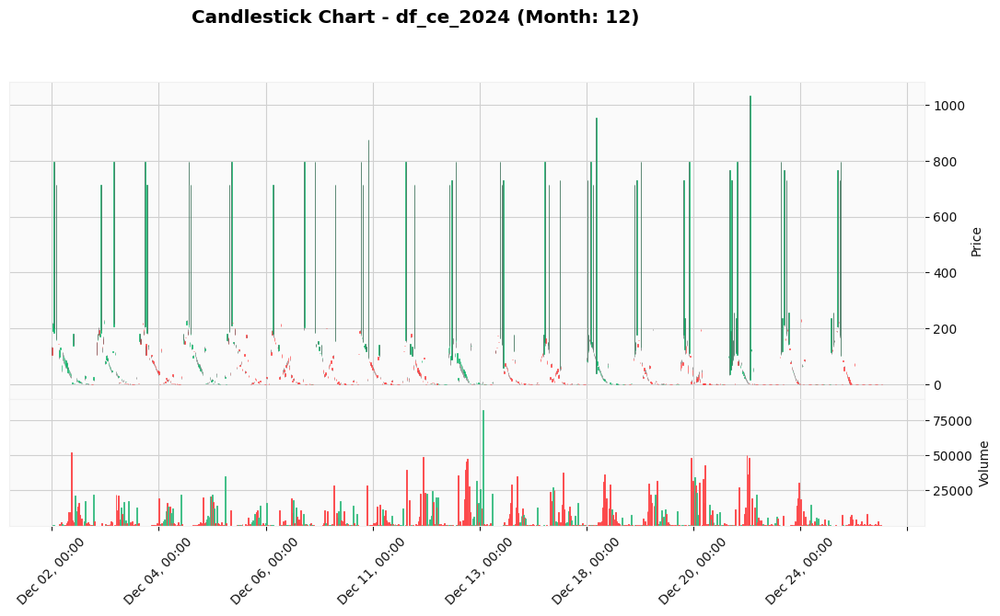

Candlestick Chart plotted for df_ce_2024 - Month 12.

--- Candlestick Chart for df_pe_2022 ---



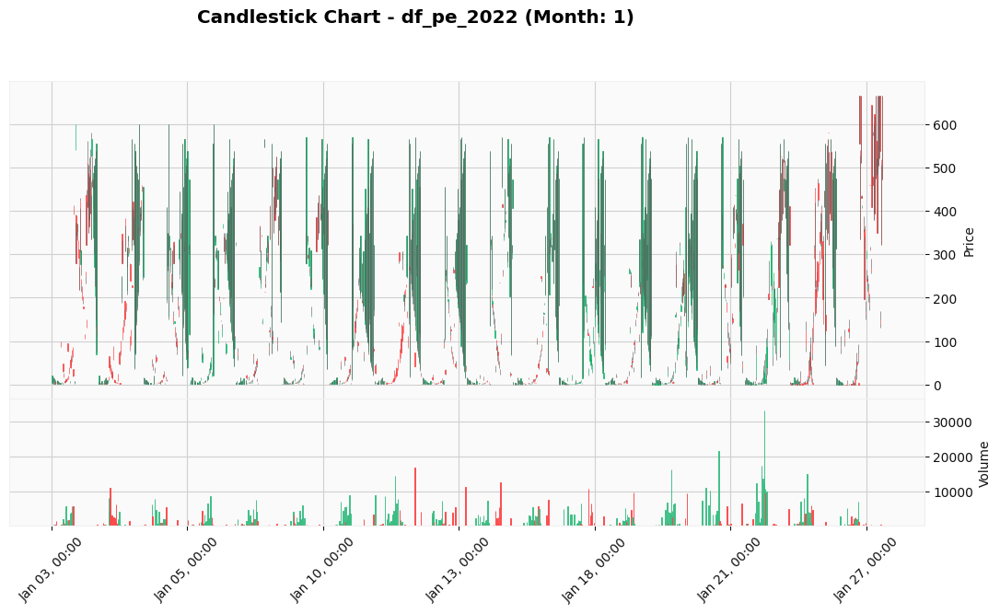

Candlestick Chart plotted for df_pe_2022 - Month 1.



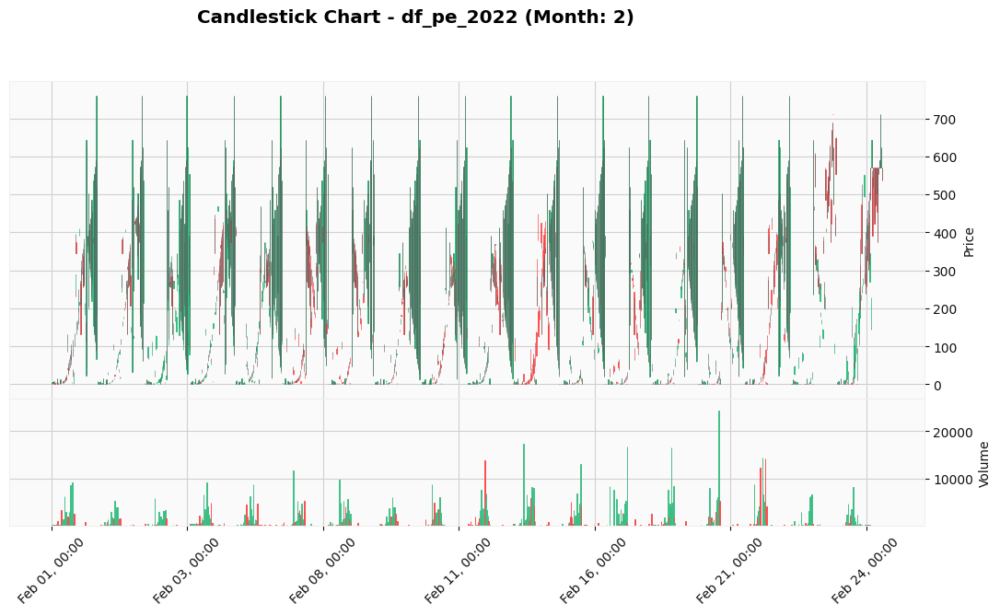

Candlestick Chart plotted for df_pe_2022 - Month 2.



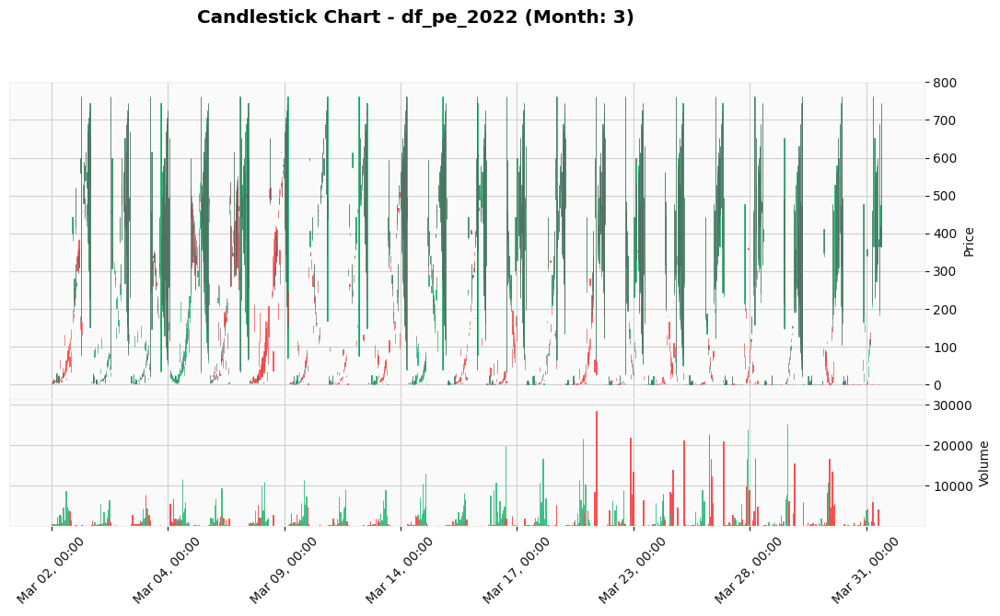

Candlestick Chart plotted for df_pe_2022 - Month 3.



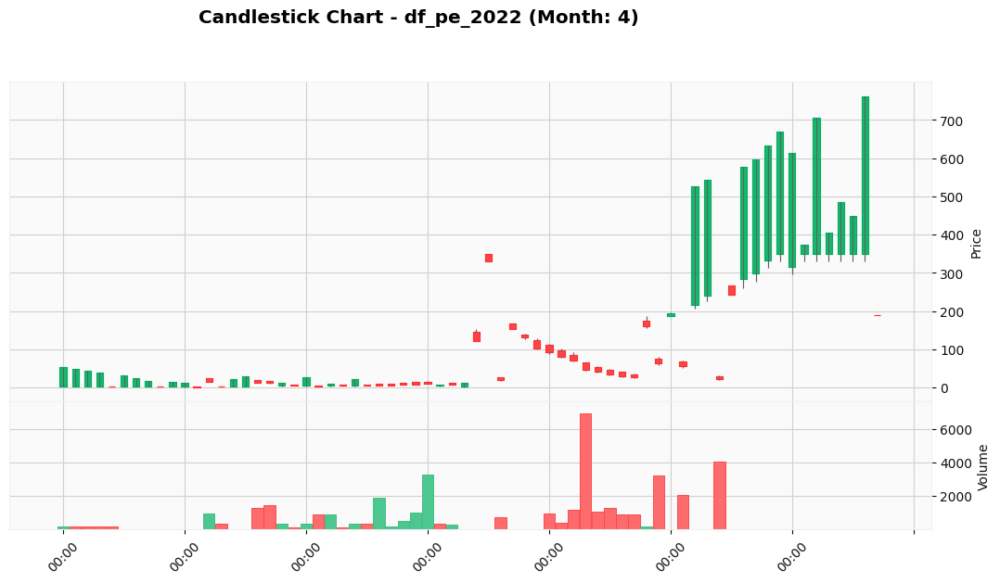

Candlestick Chart plotted for df_pe_2022 - Month 4.



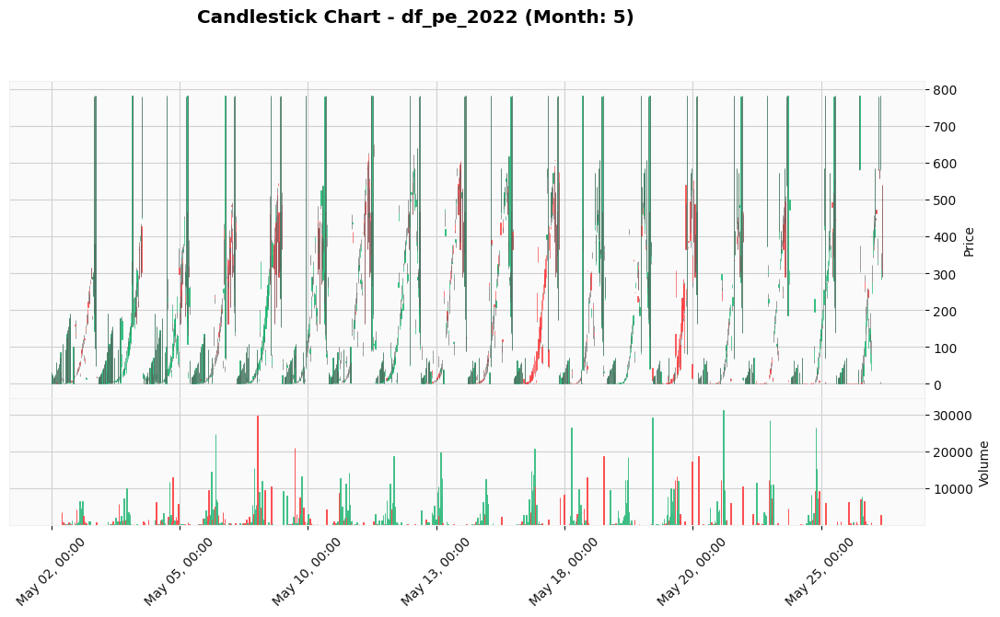

Candlestick Chart plotted for df_pe_2022 - Month 5.



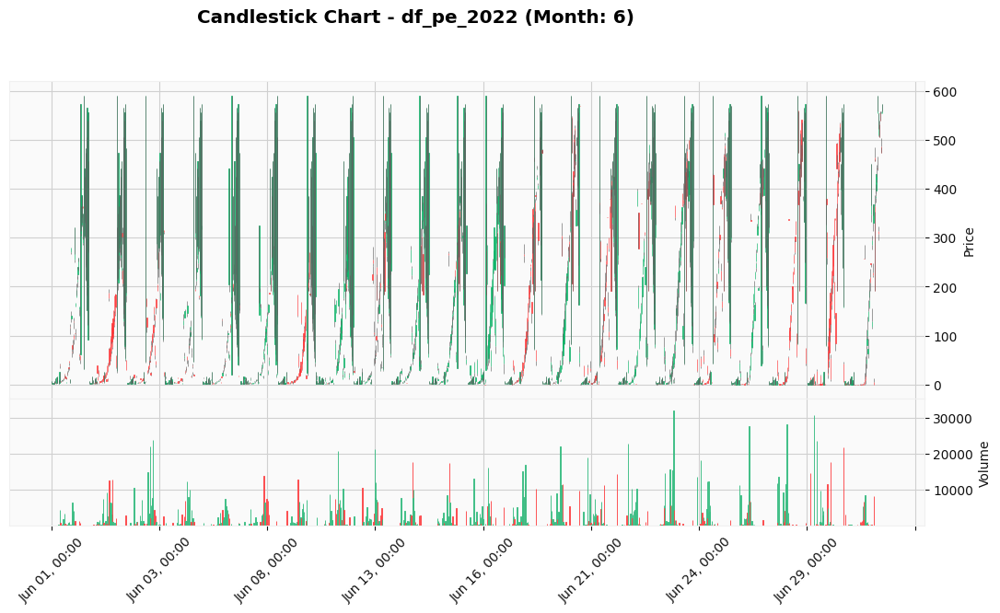

Candlestick Chart plotted for df_pe_2022 - Month 6.



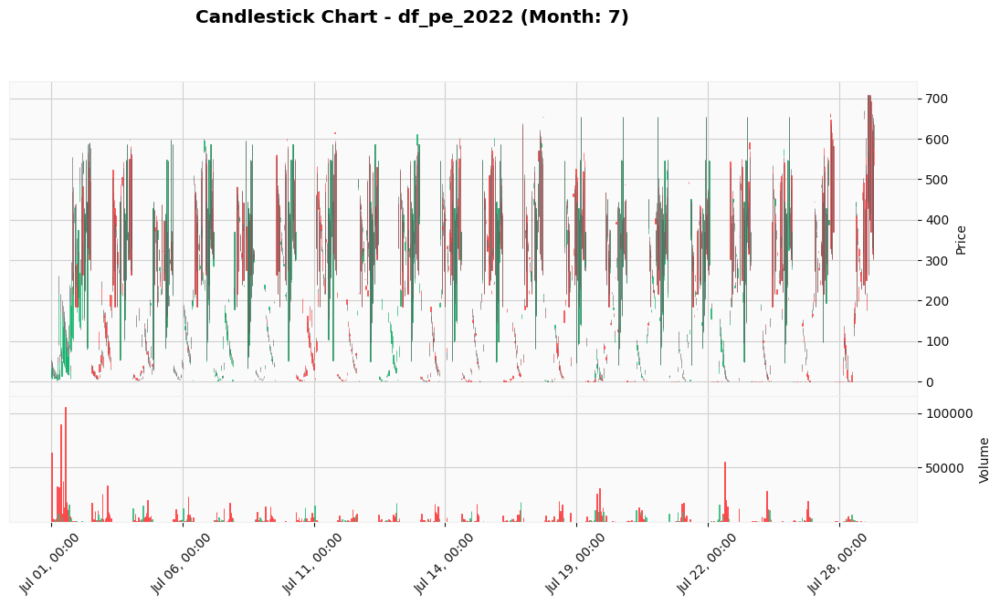

Candlestick Chart plotted for df_pe_2022 - Month 7.



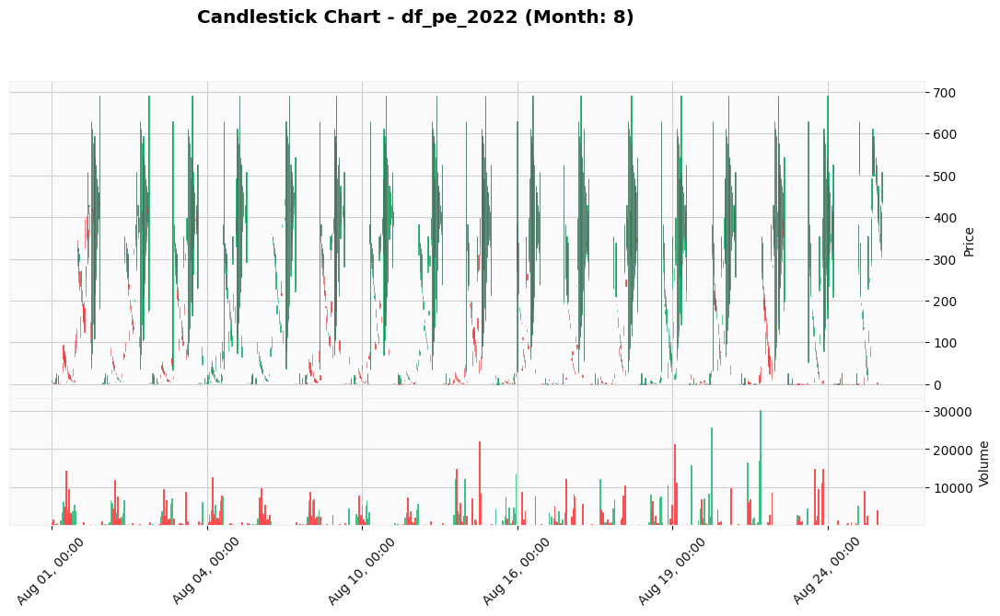

Candlestick Chart plotted for df_pe_2022 - Month 8.



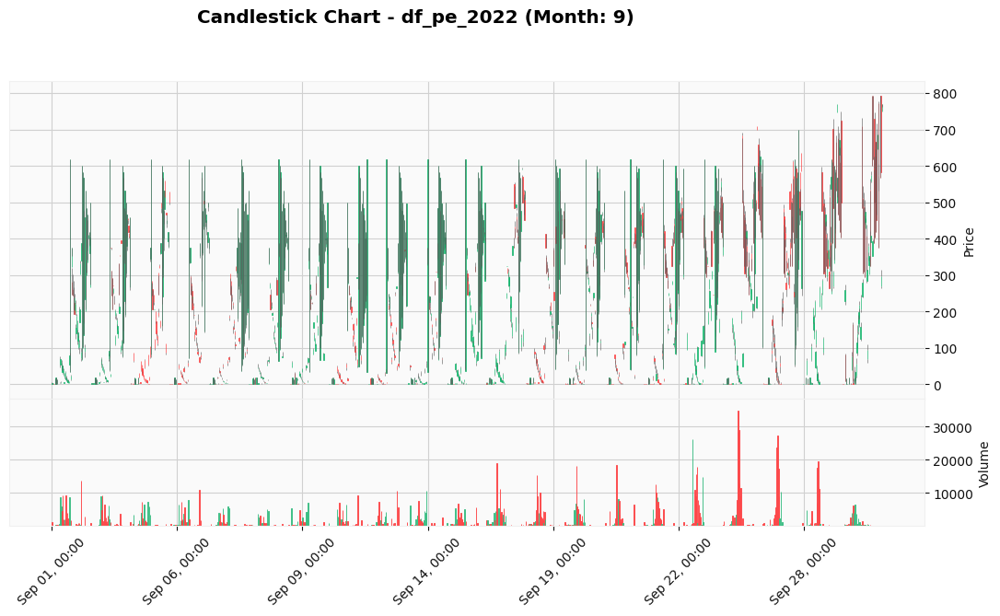

Candlestick Chart plotted for df_pe_2022 - Month 9.



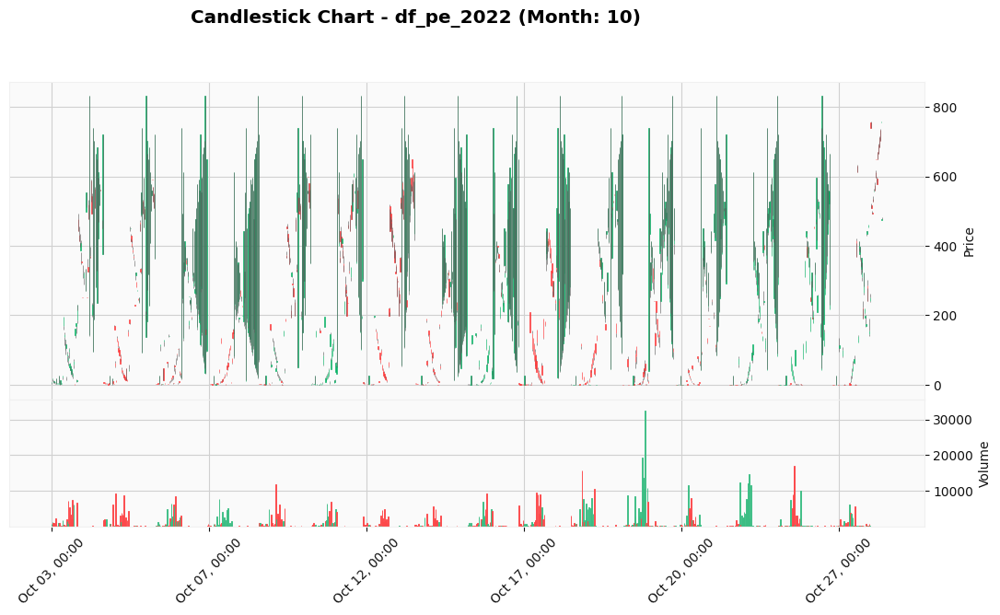

Candlestick Chart plotted for df_pe_2022 - Month 10.



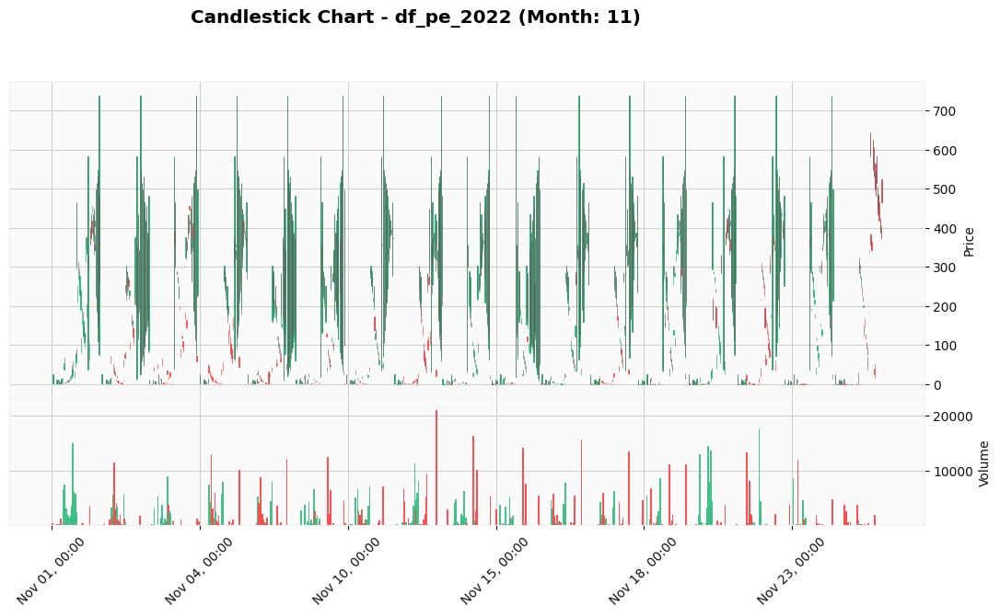

Candlestick Chart plotted for df_pe_2022 - Month 11.



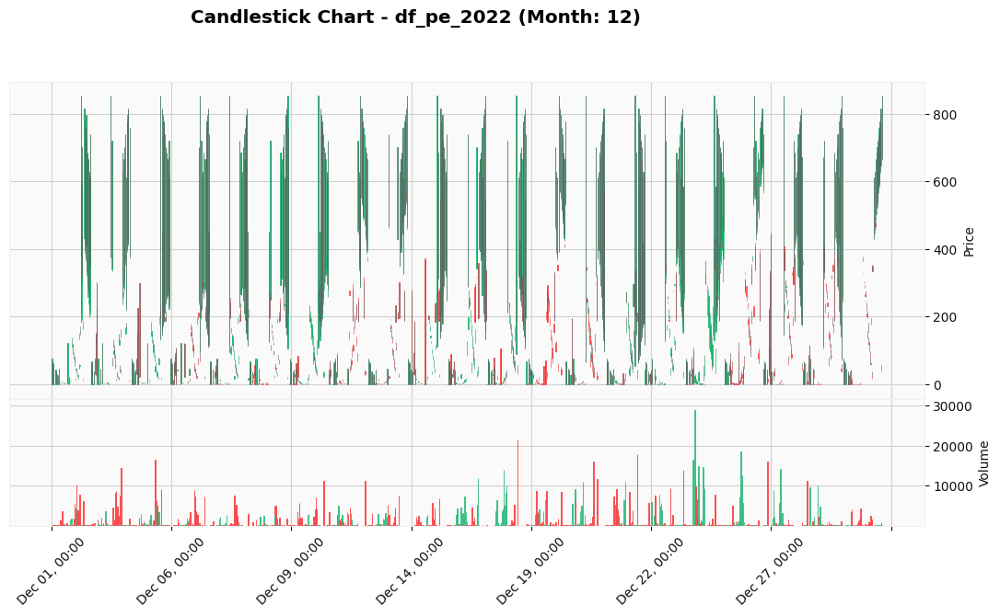

Candlestick Chart plotted for df_pe_2022 - Month 12.

--- Candlestick Chart for df_pe_2023 ---



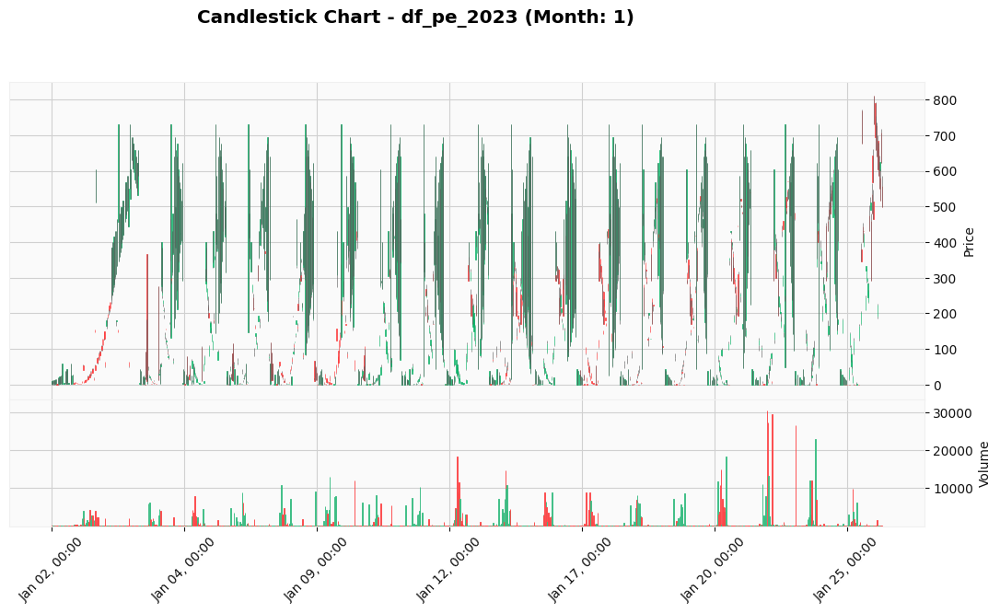

Candlestick Chart plotted for df_pe_2023 - Month 1.



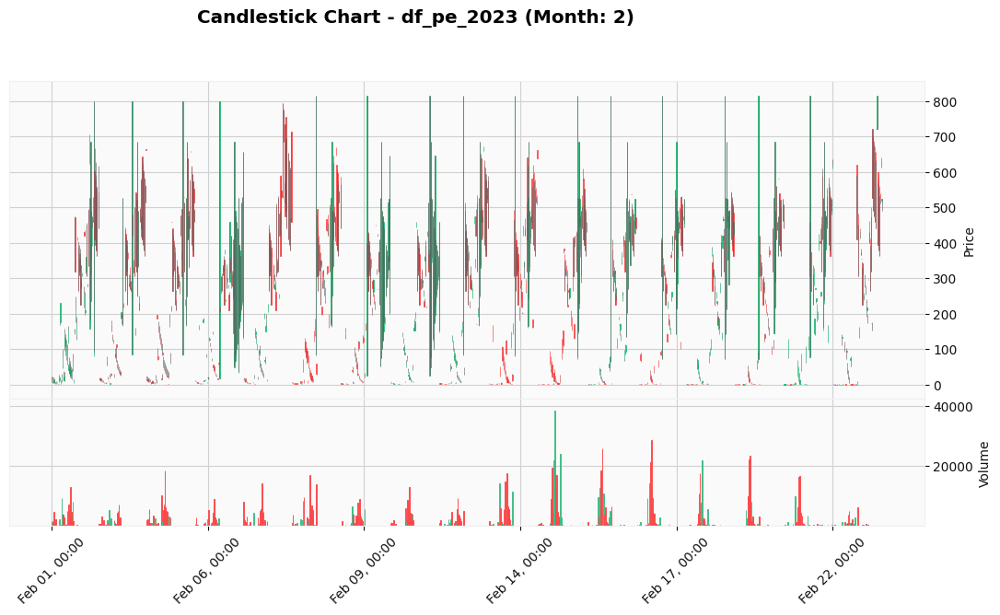

Candlestick Chart plotted for df_pe_2023 - Month 2.



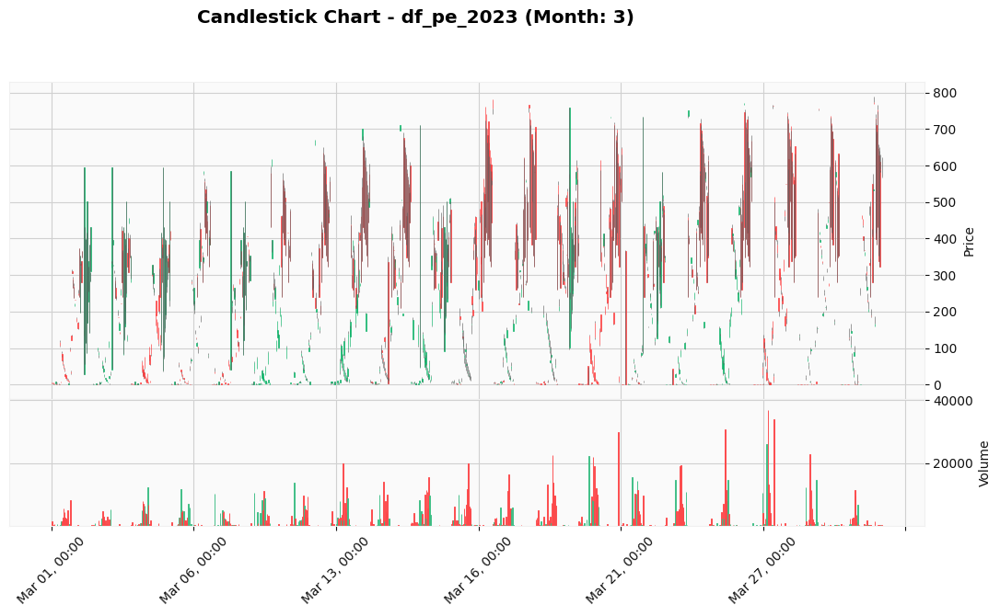

Candlestick Chart plotted for df_pe_2023 - Month 3.



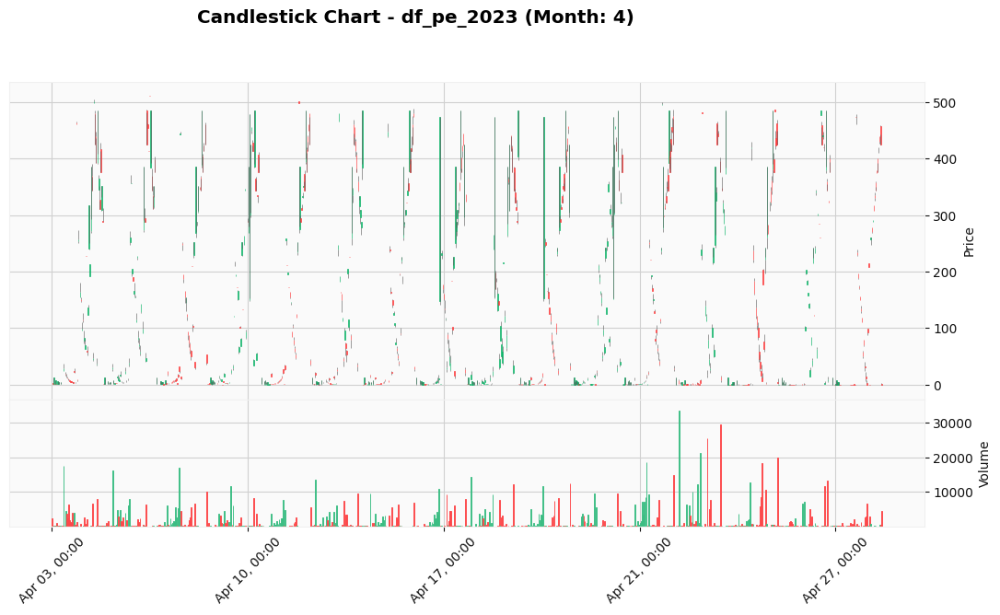

Candlestick Chart plotted for df_pe_2023 - Month 4.



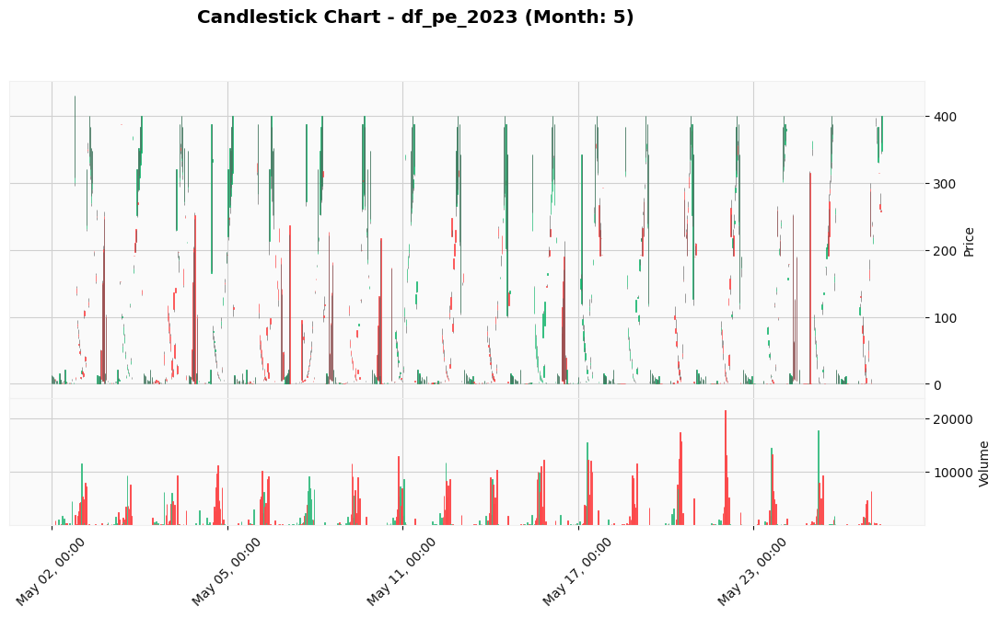

Candlestick Chart plotted for df_pe_2023 - Month 5.



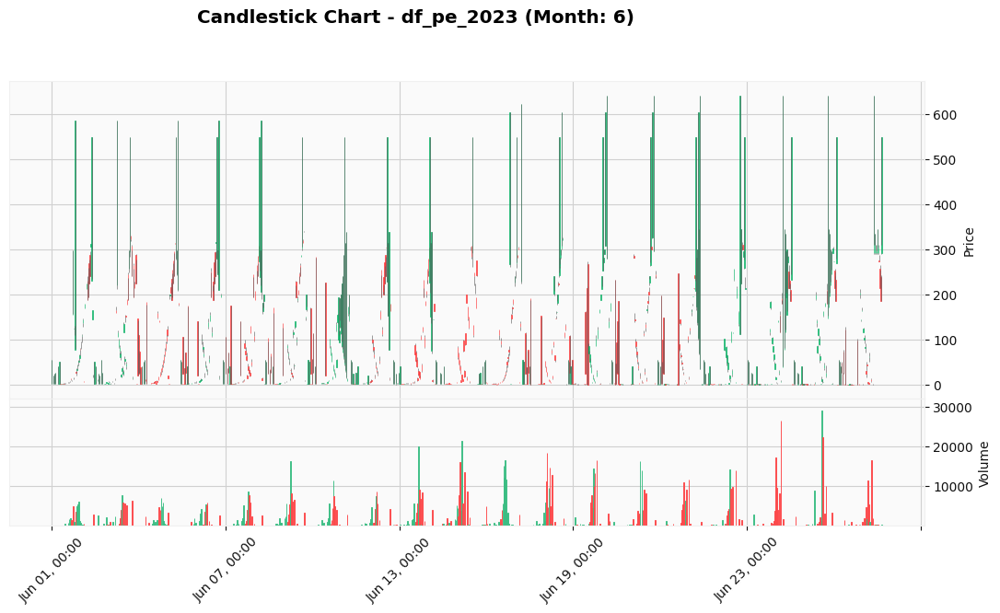

Candlestick Chart plotted for df_pe_2023 - Month 6.



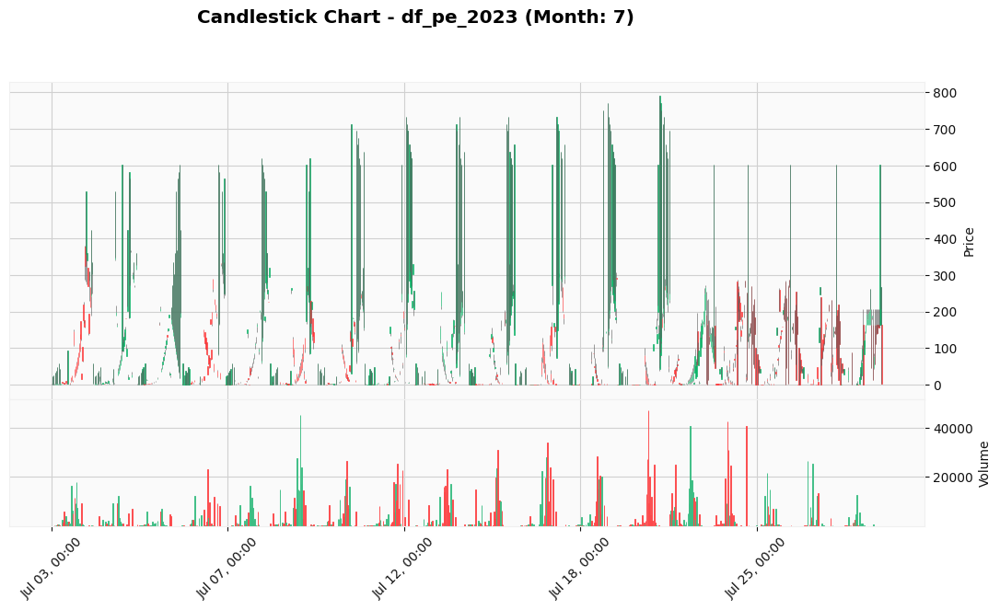

Candlestick Chart plotted for df_pe_2023 - Month 7.



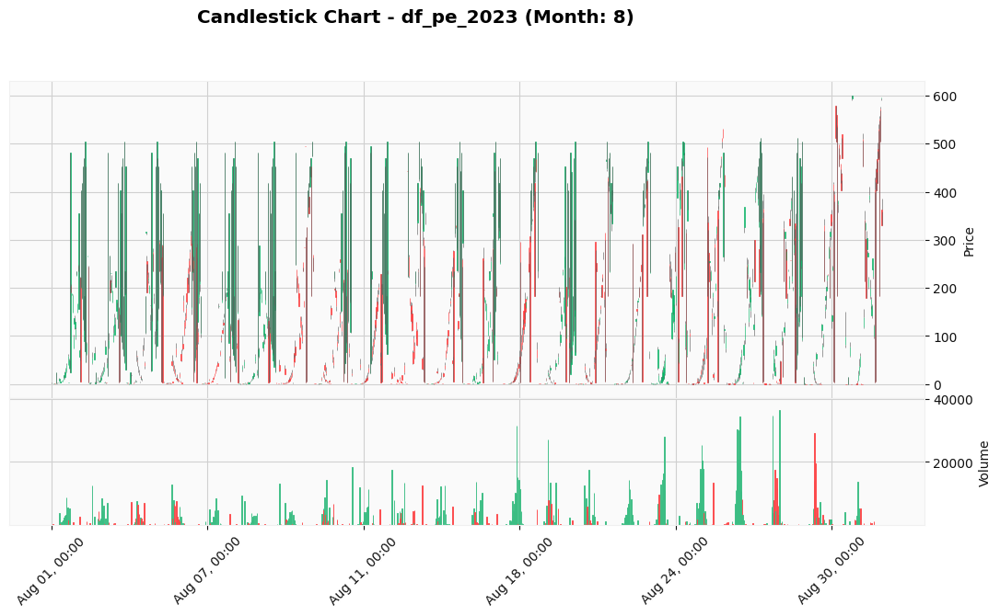

Candlestick Chart plotted for df_pe_2023 - Month 8.



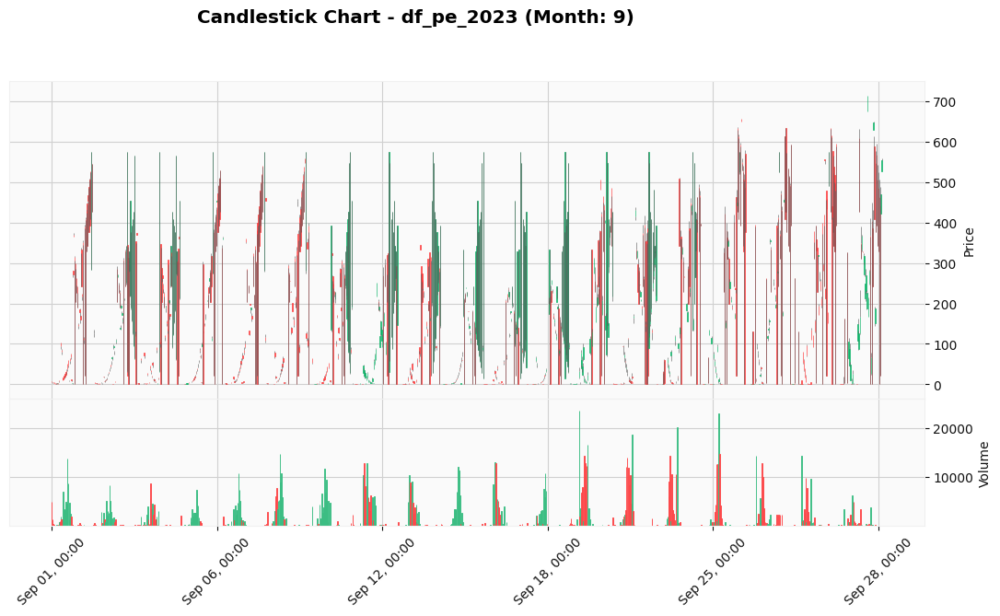

Candlestick Chart plotted for df_pe_2023 - Month 9.



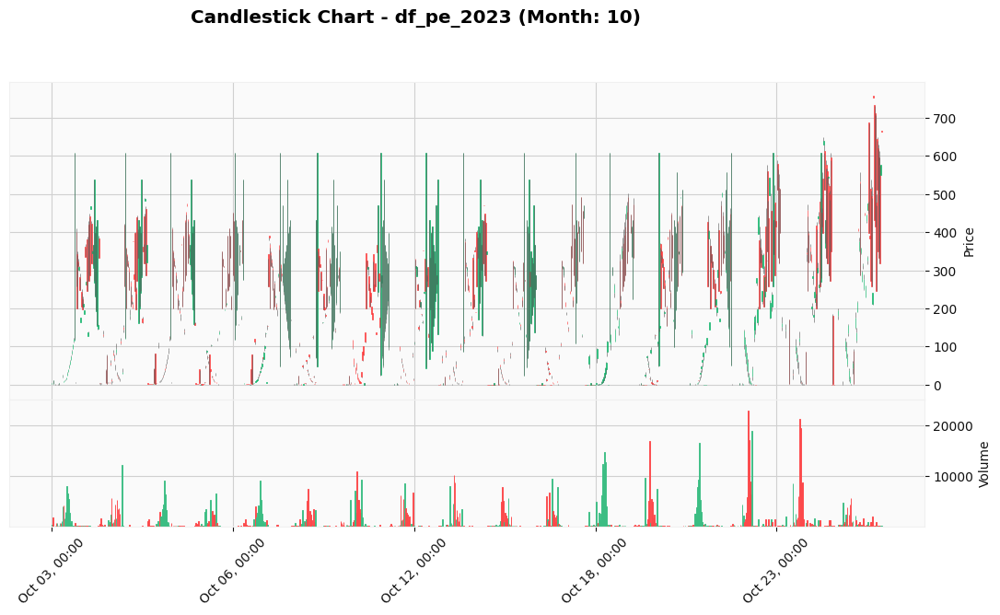

Candlestick Chart plotted for df_pe_2023 - Month 10.



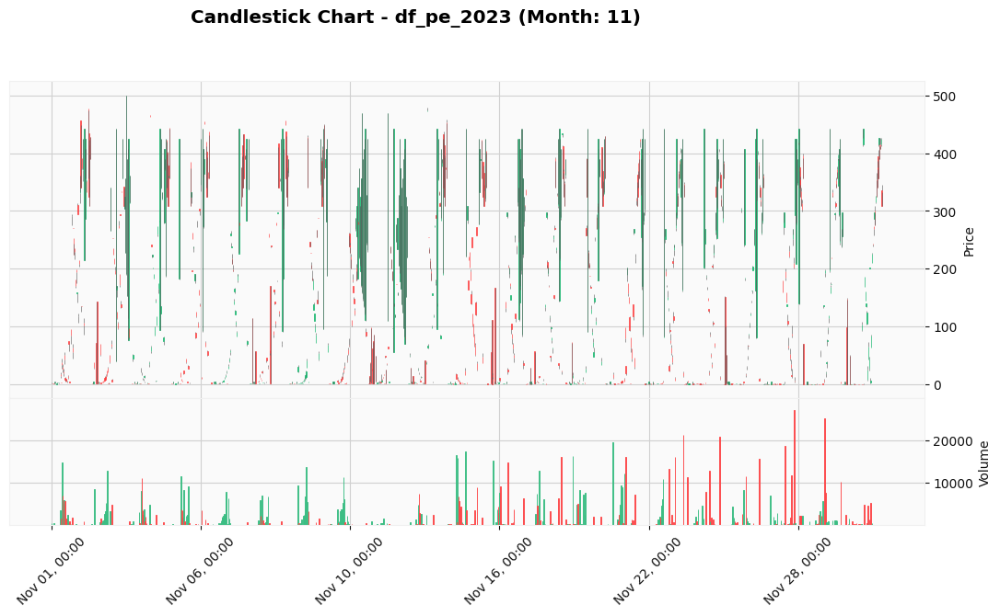

Candlestick Chart plotted for df_pe_2023 - Month 11.



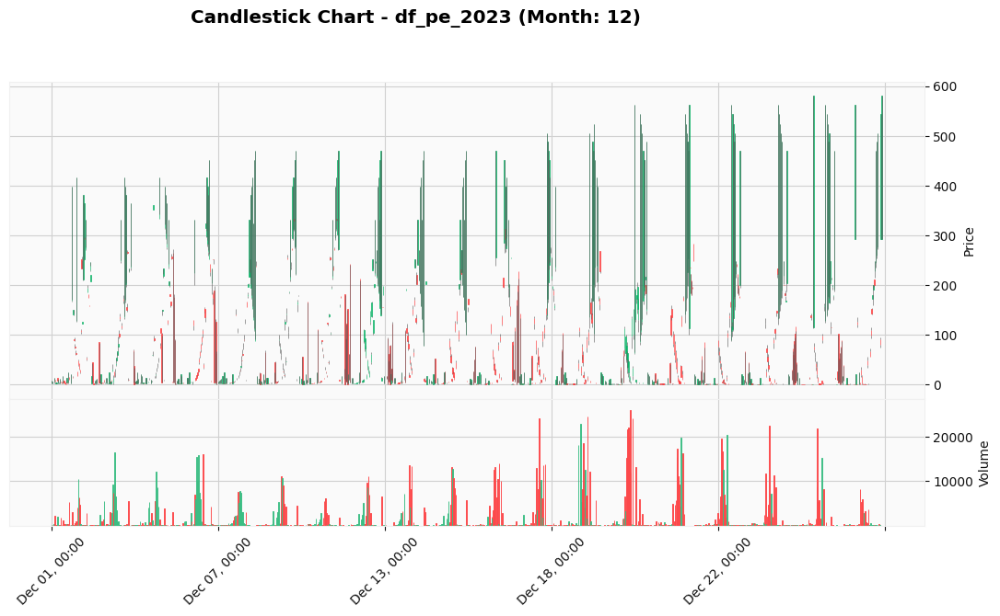

Candlestick Chart plotted for df_pe_2023 - Month 12.

--- Candlestick Chart for df_pe_2024 ---



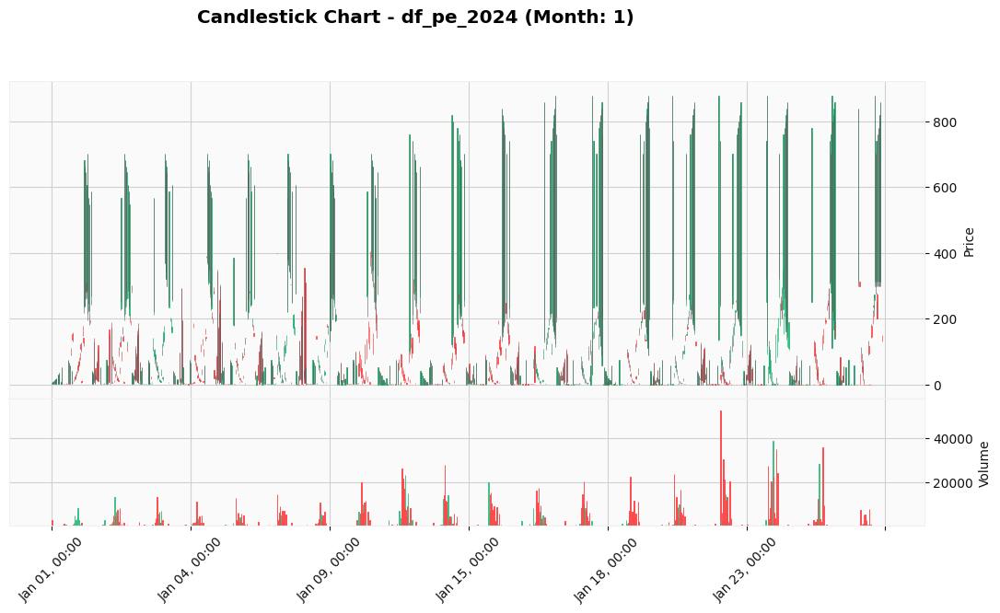

Candlestick Chart plotted for df_pe_2024 - Month 1.



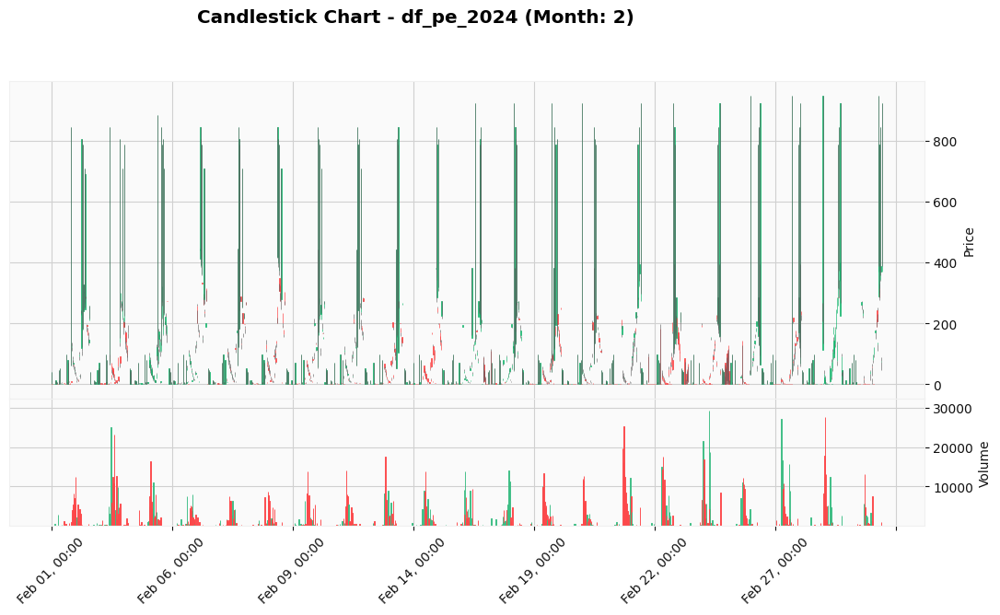

Candlestick Chart plotted for df_pe_2024 - Month 2.



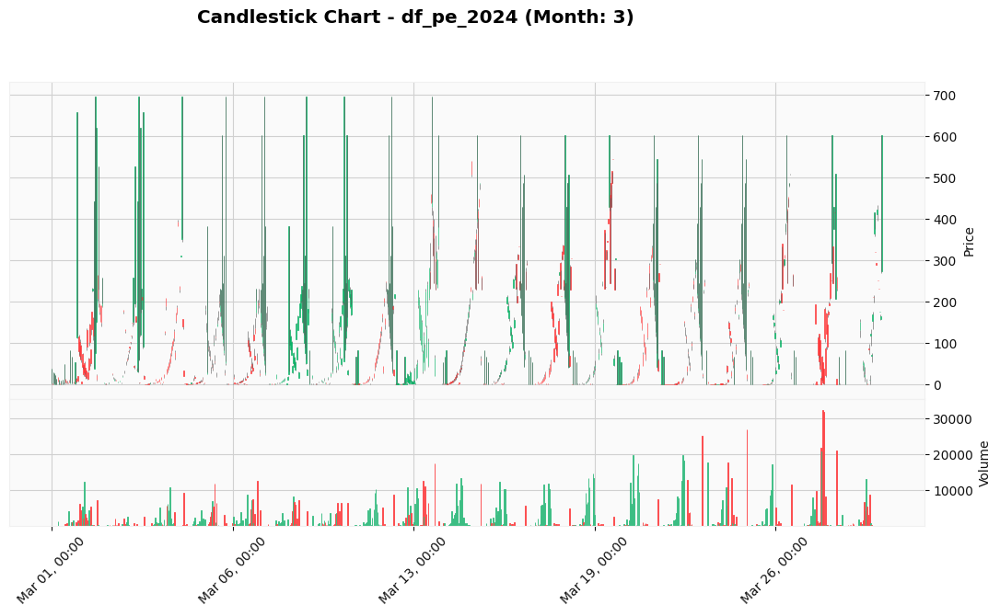

Candlestick Chart plotted for df_pe_2024 - Month 3.



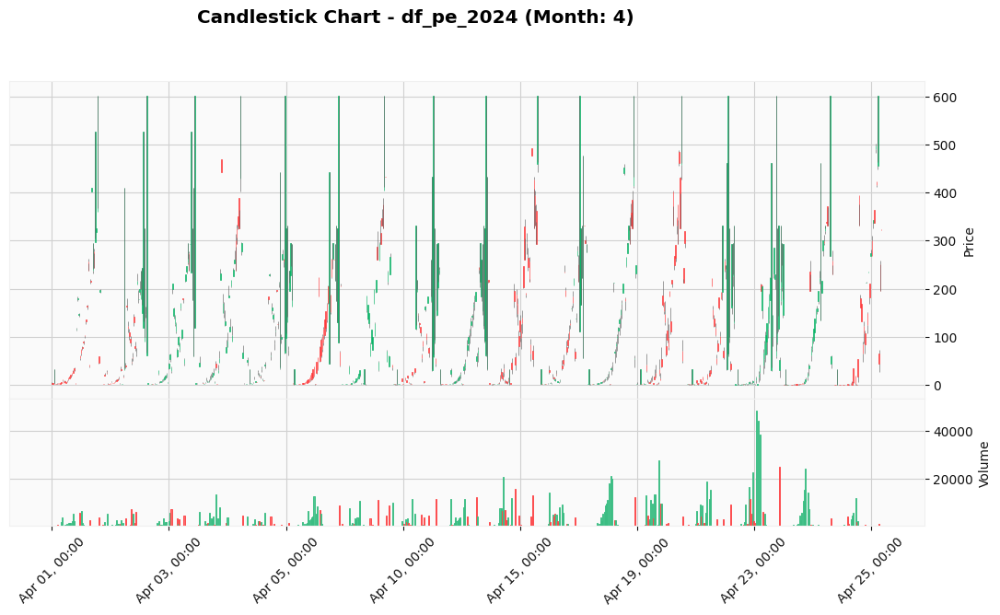

Candlestick Chart plotted for df_pe_2024 - Month 4.



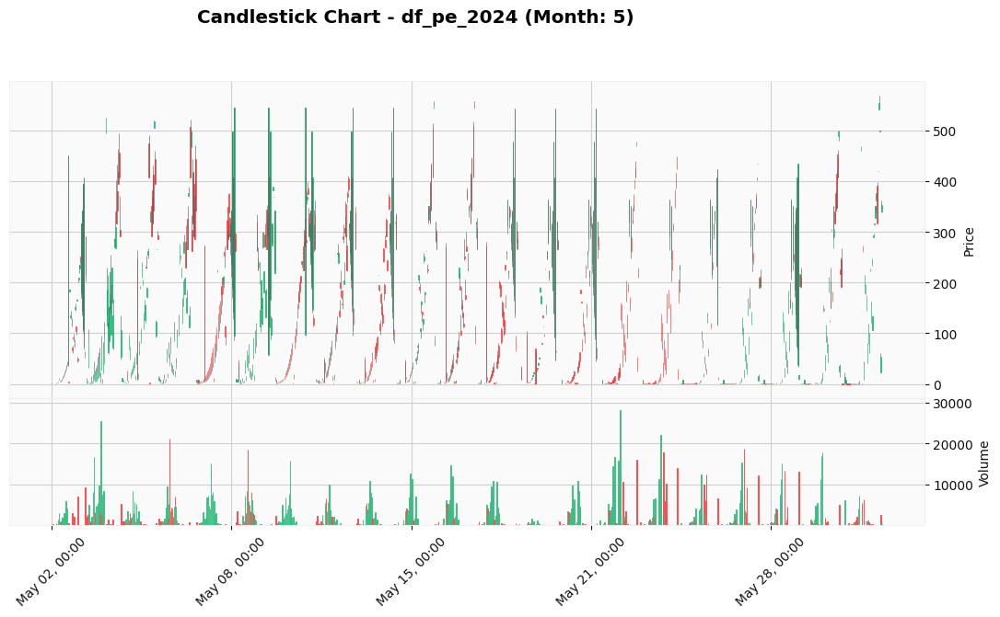

Candlestick Chart plotted for df_pe_2024 - Month 5.



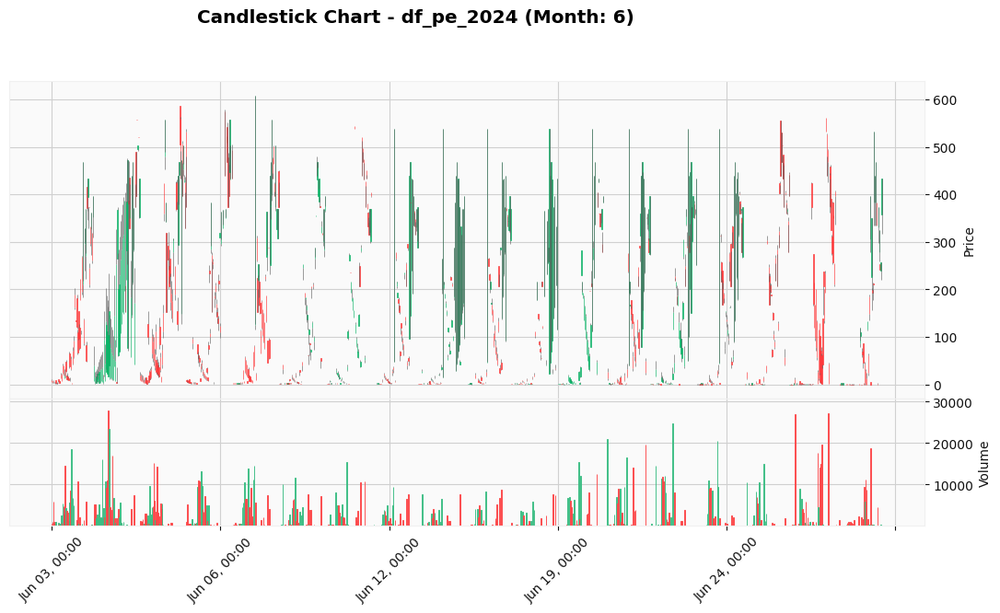

Candlestick Chart plotted for df_pe_2024 - Month 6.



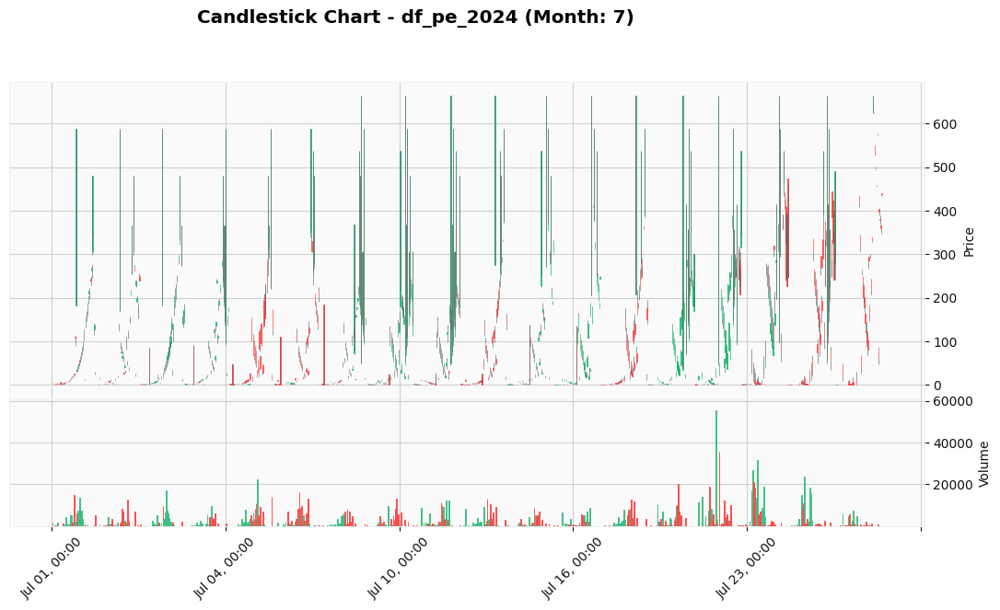

Candlestick Chart plotted for df_pe_2024 - Month 7.



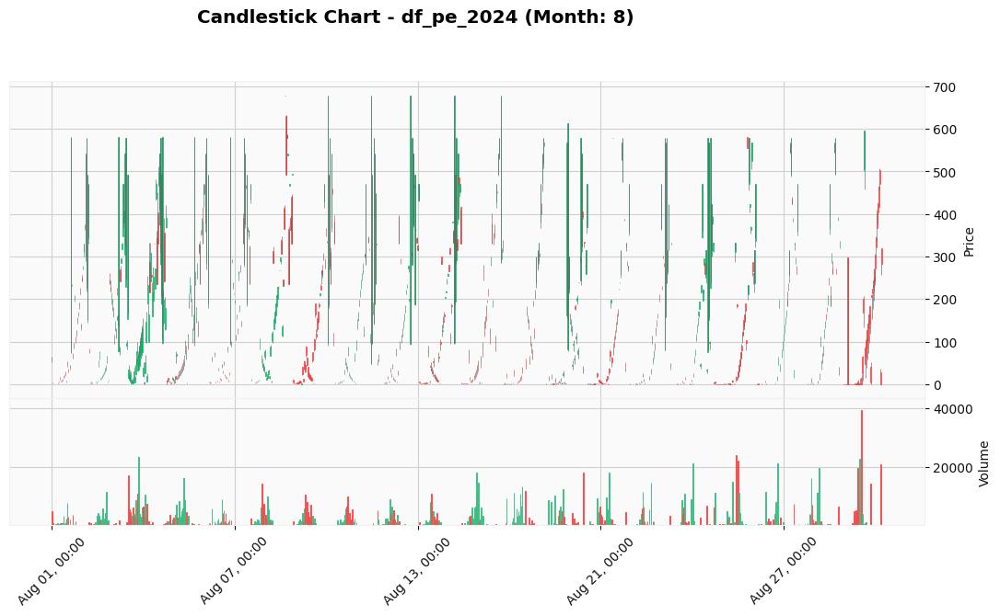

Candlestick Chart plotted for df_pe_2024 - Month 8.



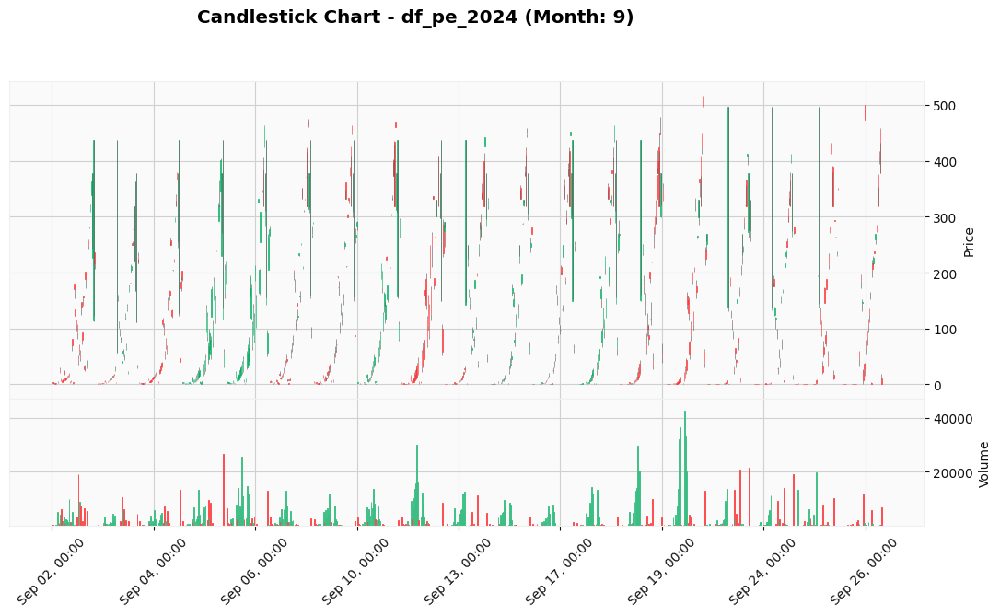

Candlestick Chart plotted for df_pe_2024 - Month 9.



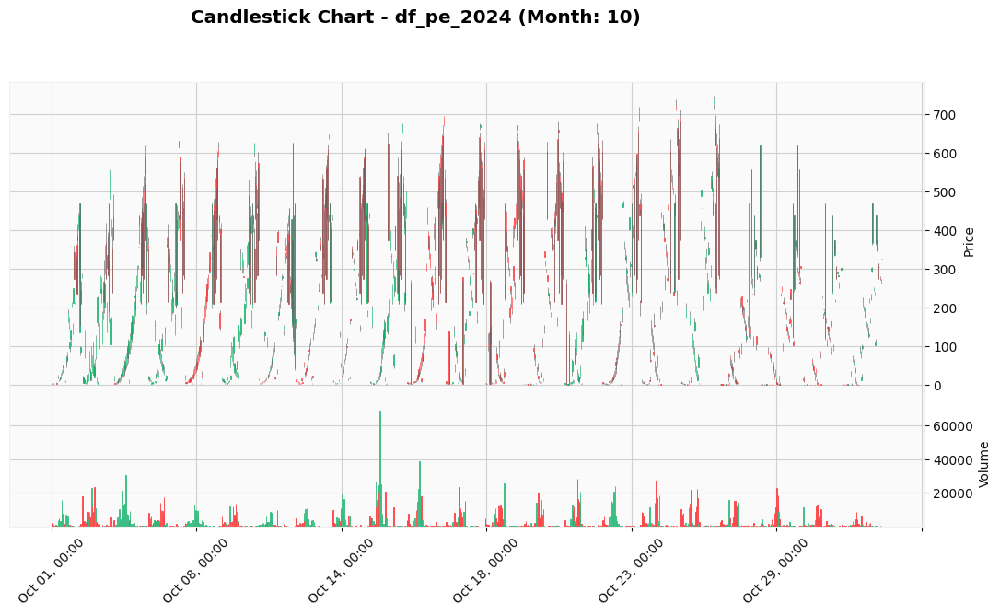

Candlestick Chart plotted for df_pe_2024 - Month 10.



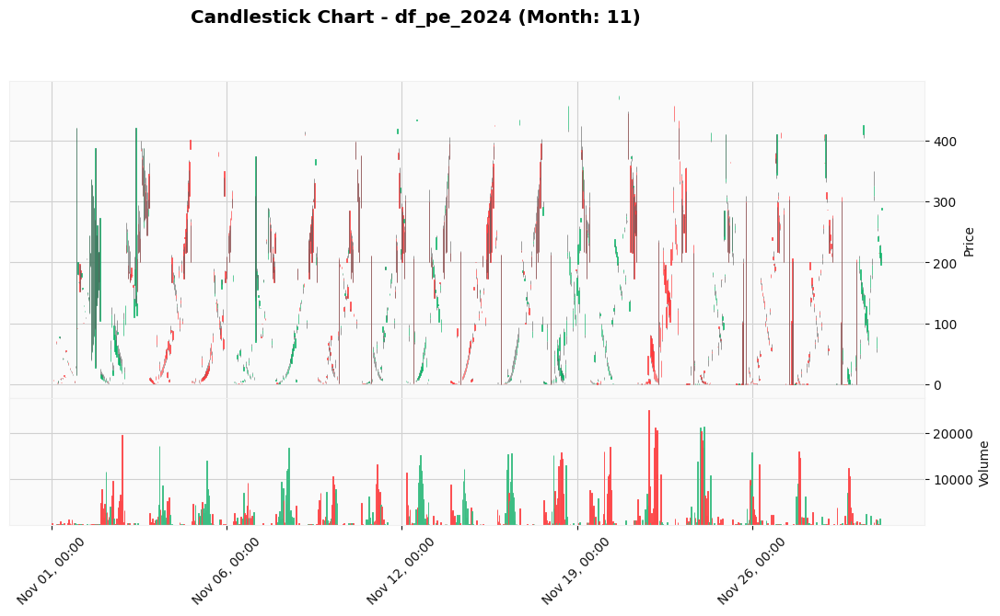

Candlestick Chart plotted for df_pe_2024 - Month 11.



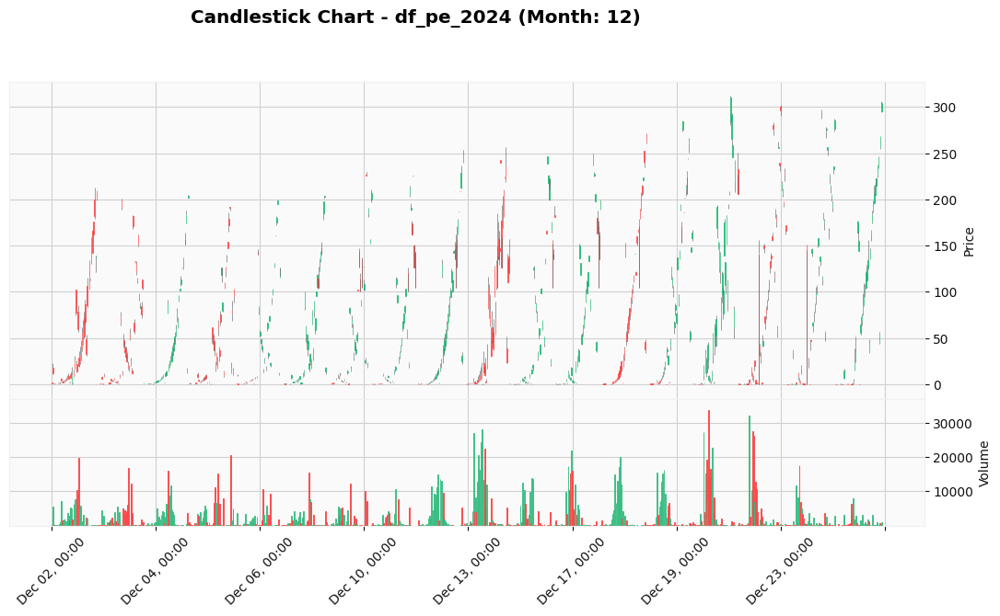

Candlestick Chart plotted for df_pe_2024 - Month 12.

--- Candlestick Chart for df_ce_all ---



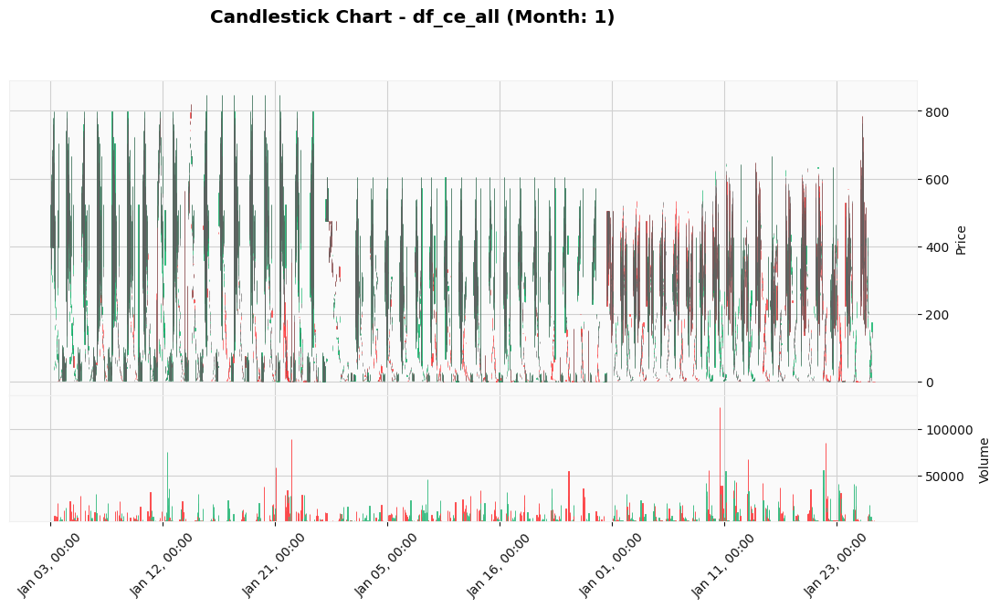

Candlestick Chart plotted for df_ce_all - Month 1.



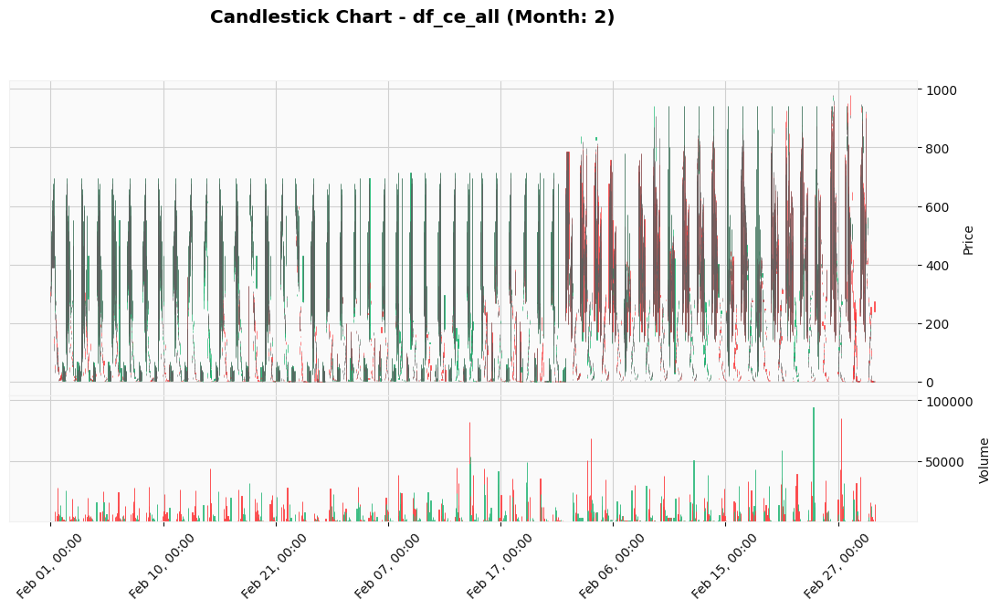

Candlestick Chart plotted for df_ce_all - Month 2.



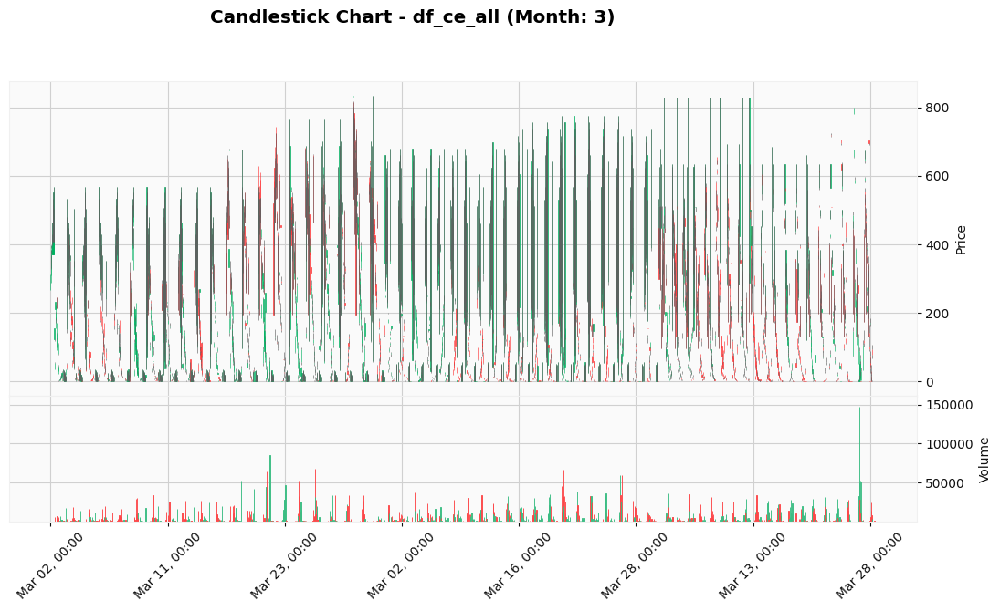

Candlestick Chart plotted for df_ce_all - Month 3.



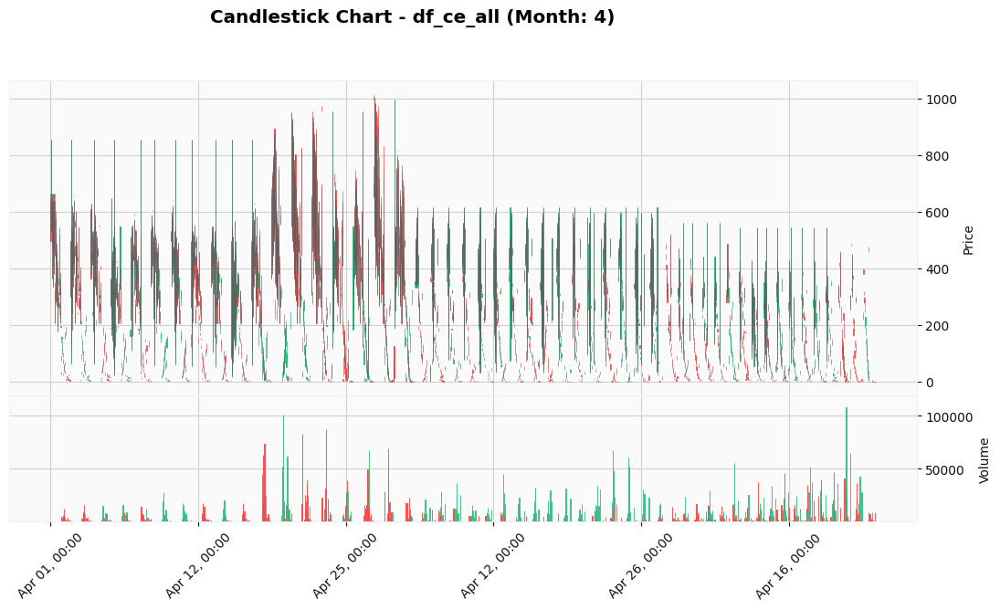

Candlestick Chart plotted for df_ce_all - Month 4.



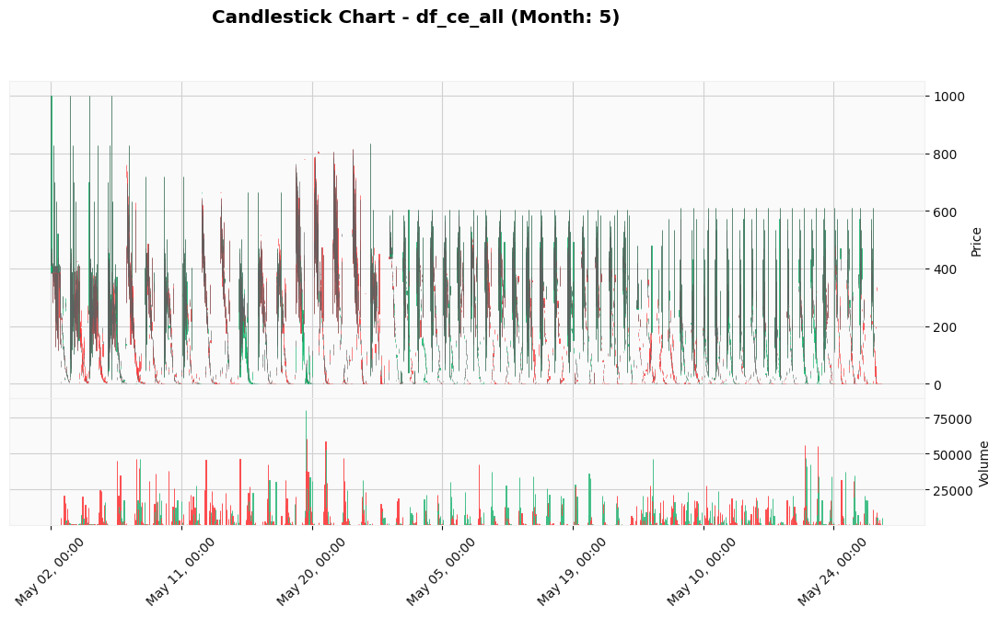

Candlestick Chart plotted for df_ce_all - Month 5.



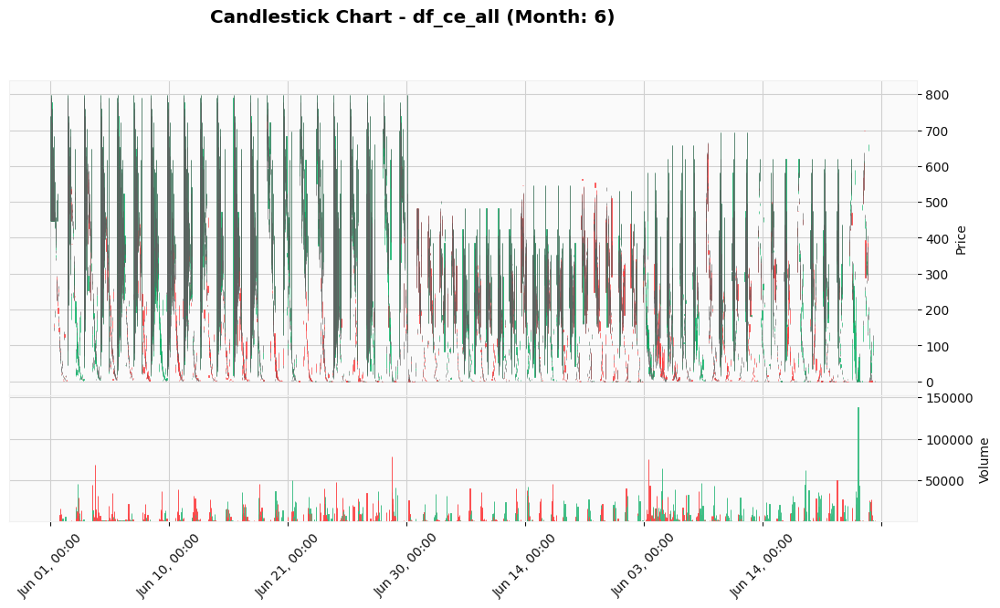

Candlestick Chart plotted for df_ce_all - Month 6.



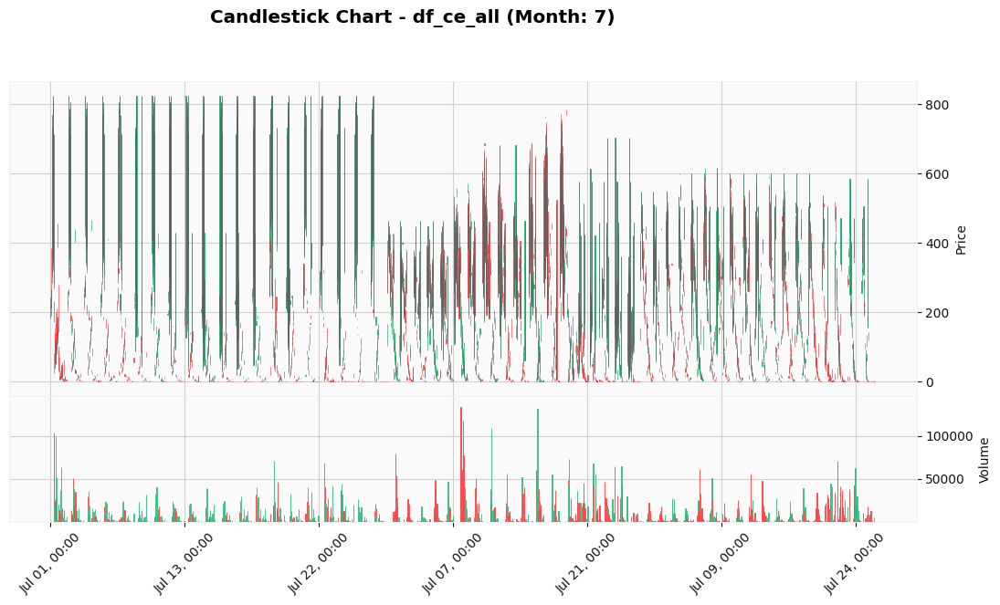

Candlestick Chart plotted for df_ce_all - Month 7.



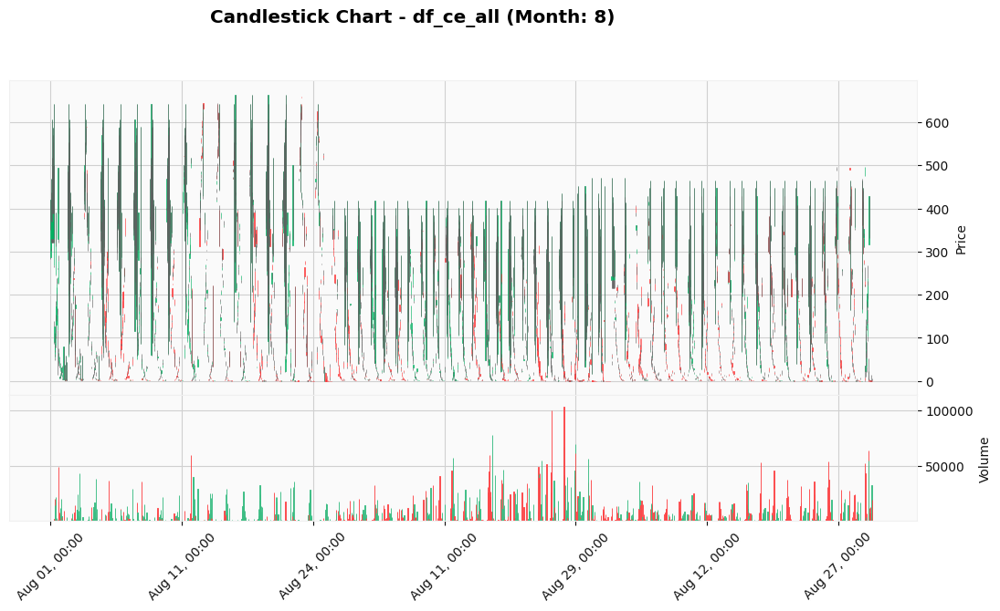

Candlestick Chart plotted for df_ce_all - Month 8.



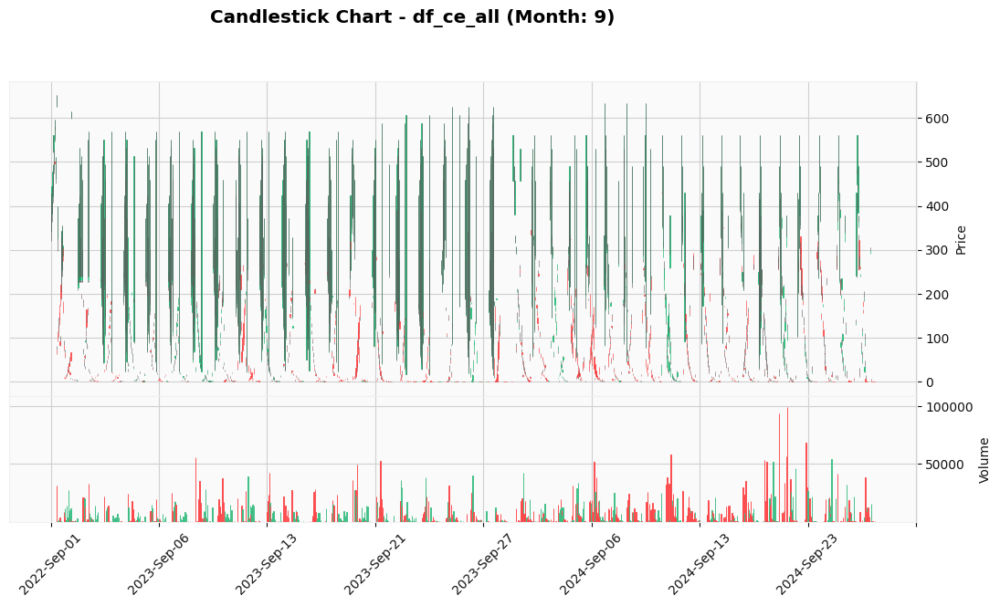

Candlestick Chart plotted for df_ce_all - Month 9.



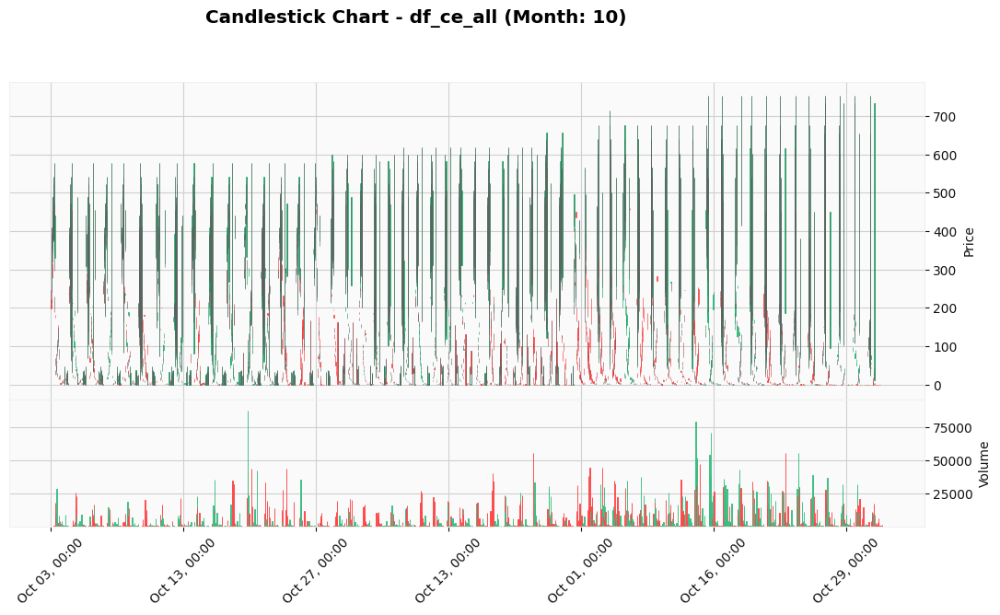

Candlestick Chart plotted for df_ce_all - Month 10.



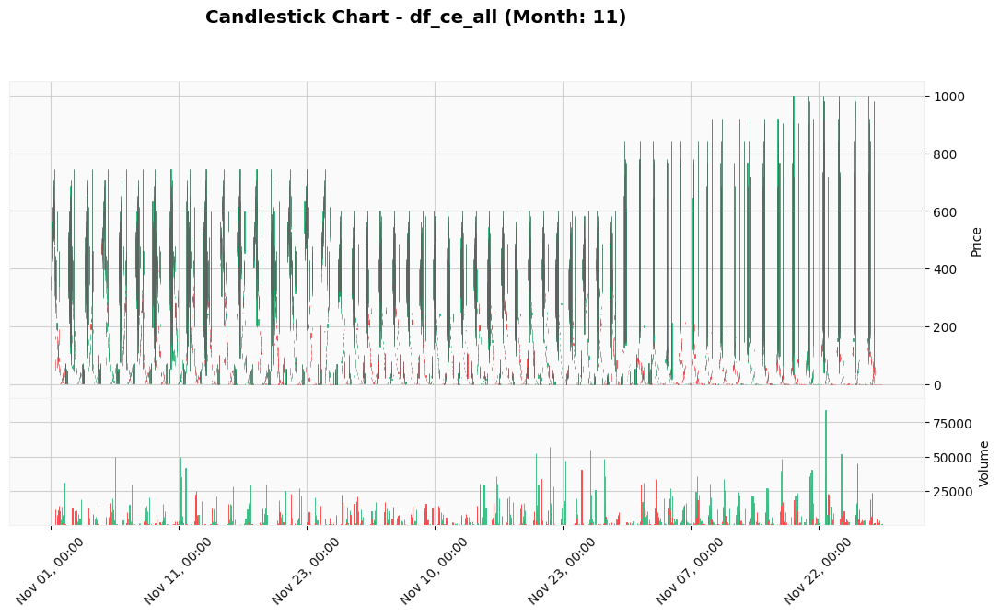

Candlestick Chart plotted for df_ce_all - Month 11.



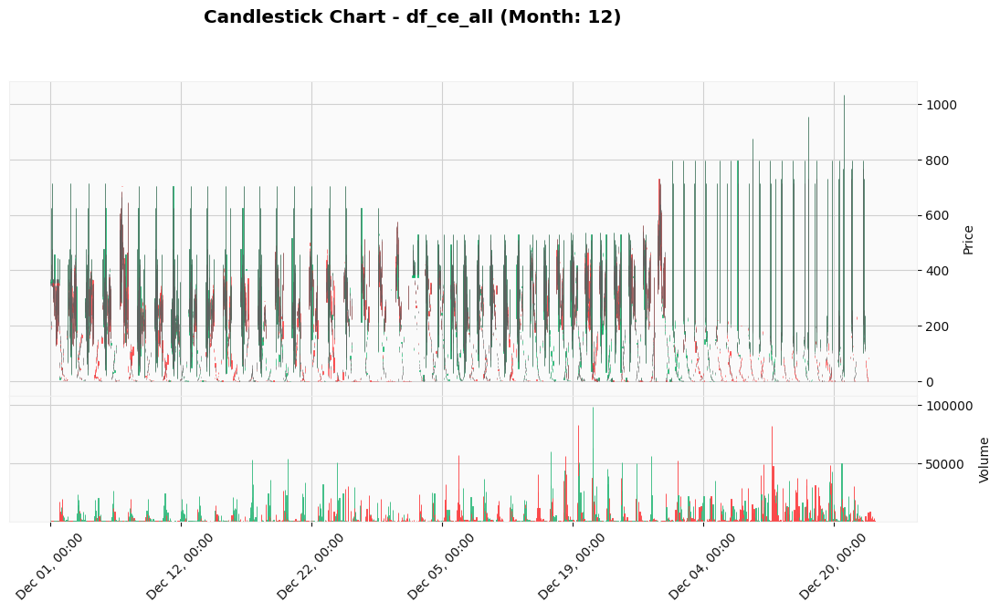

Candlestick Chart plotted for df_ce_all - Month 12.

--- Candlestick Chart for df_pe_all ---



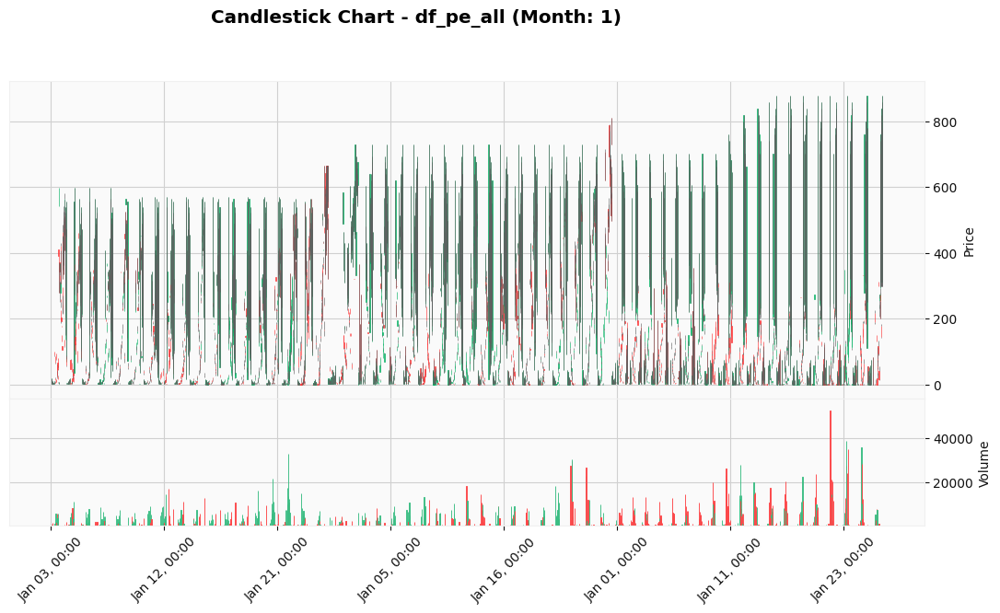

Candlestick Chart plotted for df_pe_all - Month 1.



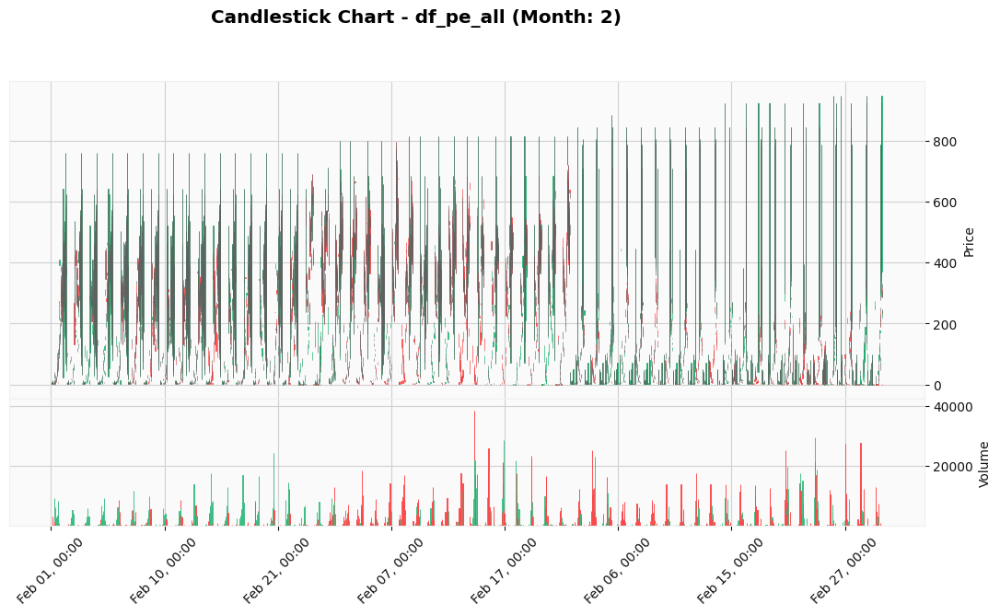

Candlestick Chart plotted for df_pe_all - Month 2.



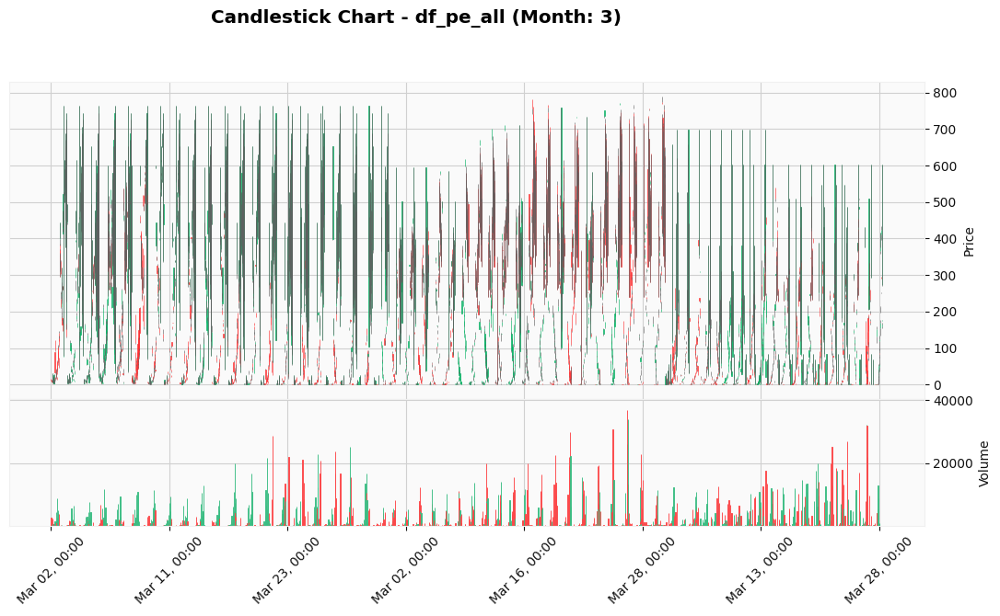

Candlestick Chart plotted for df_pe_all - Month 3.



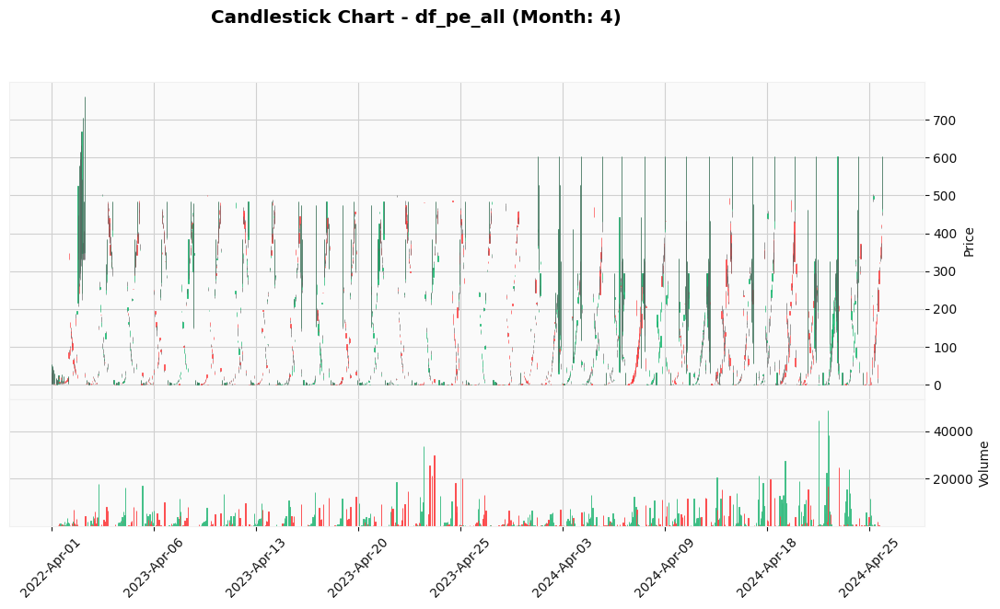

Candlestick Chart plotted for df_pe_all - Month 4.



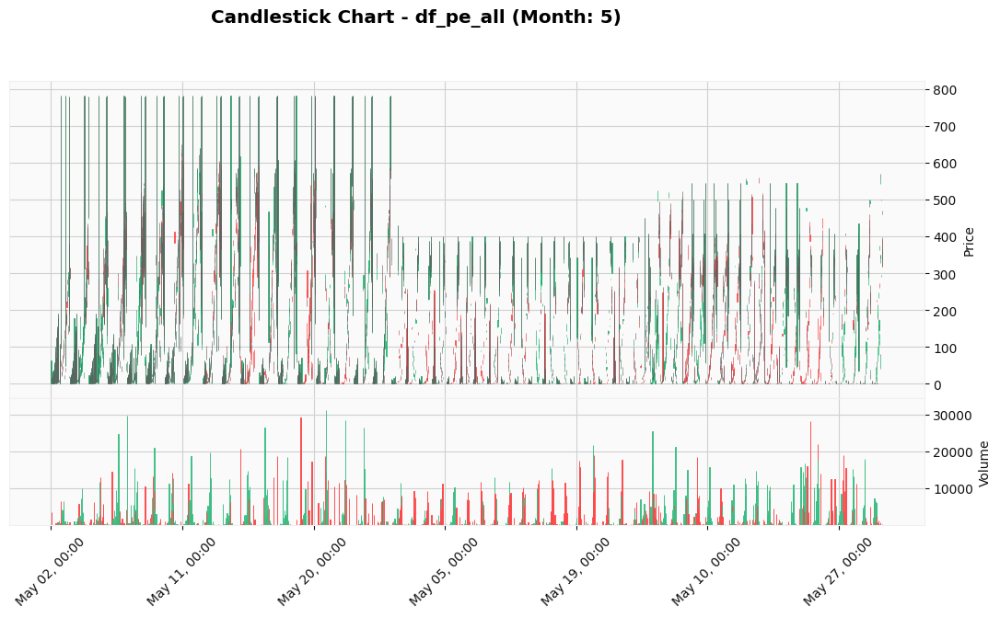

Candlestick Chart plotted for df_pe_all - Month 5.



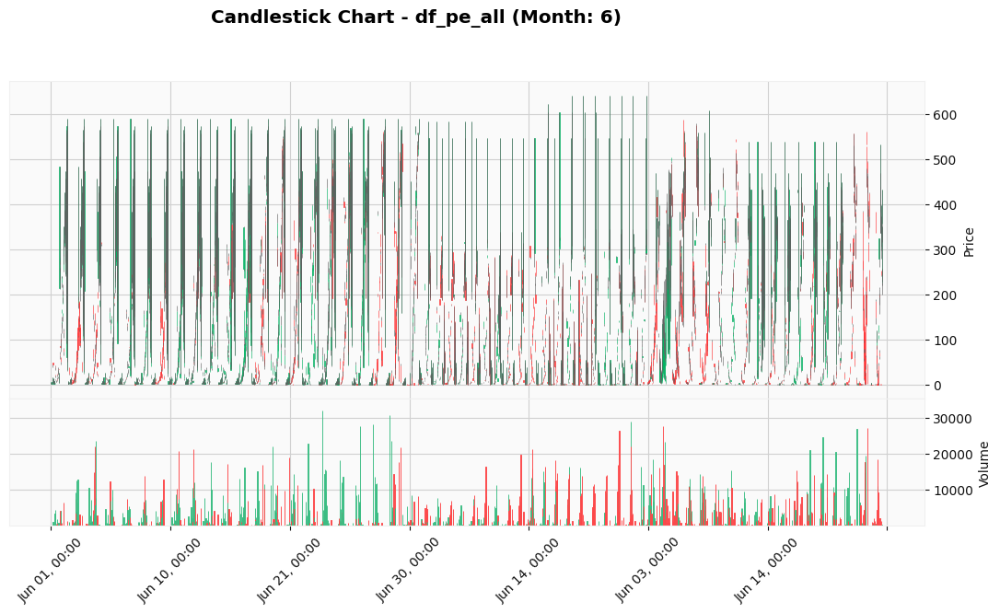

Candlestick Chart plotted for df_pe_all - Month 6.



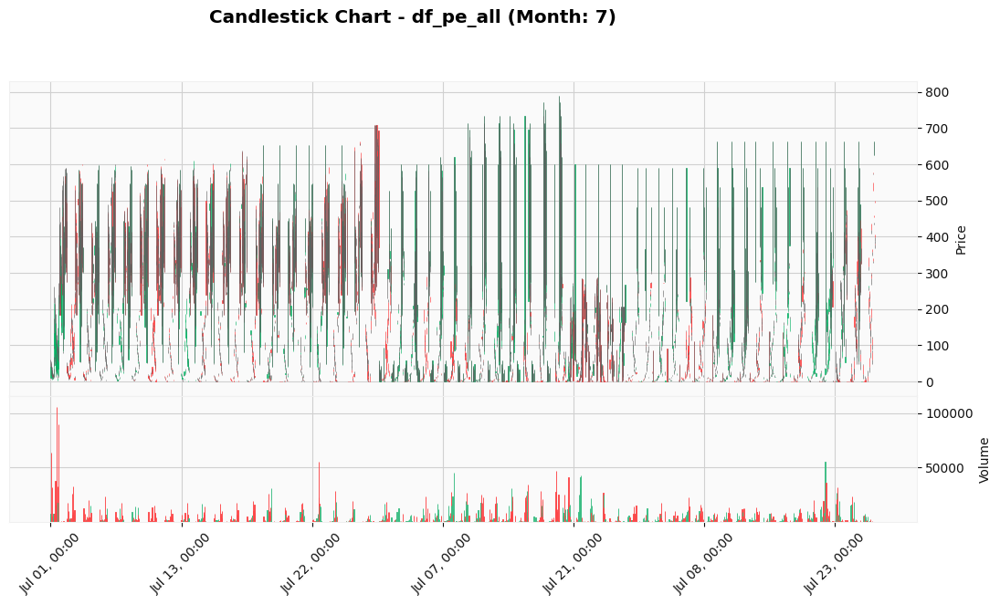

Candlestick Chart plotted for df_pe_all - Month 7.



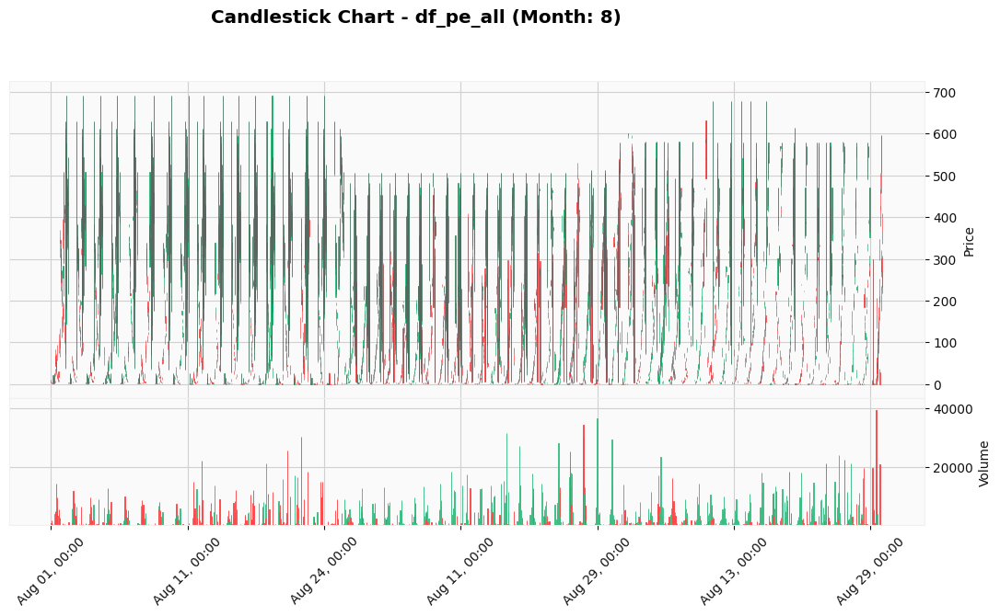

Candlestick Chart plotted for df_pe_all - Month 8.



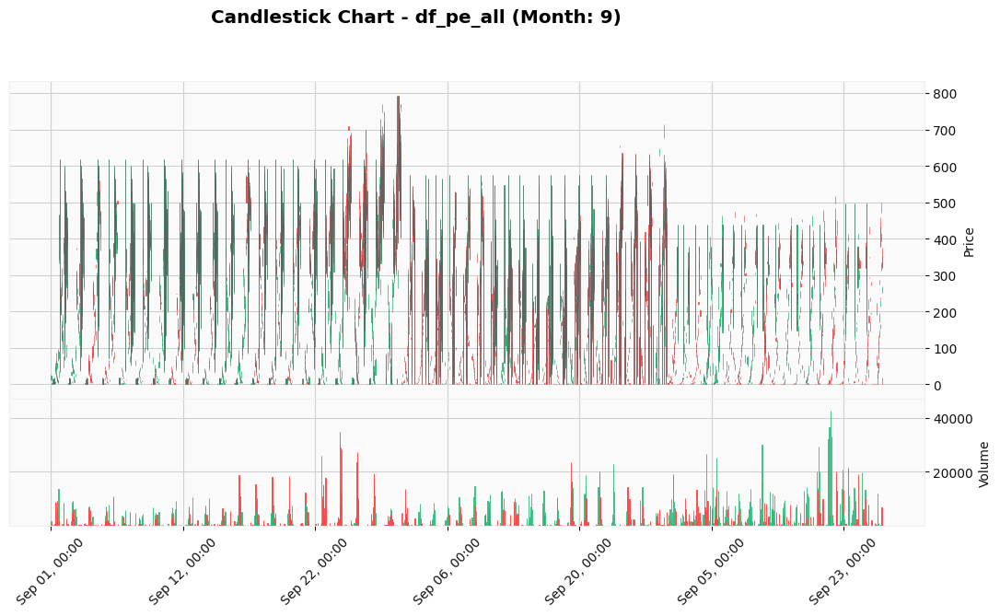

Candlestick Chart plotted for df_pe_all - Month 9.



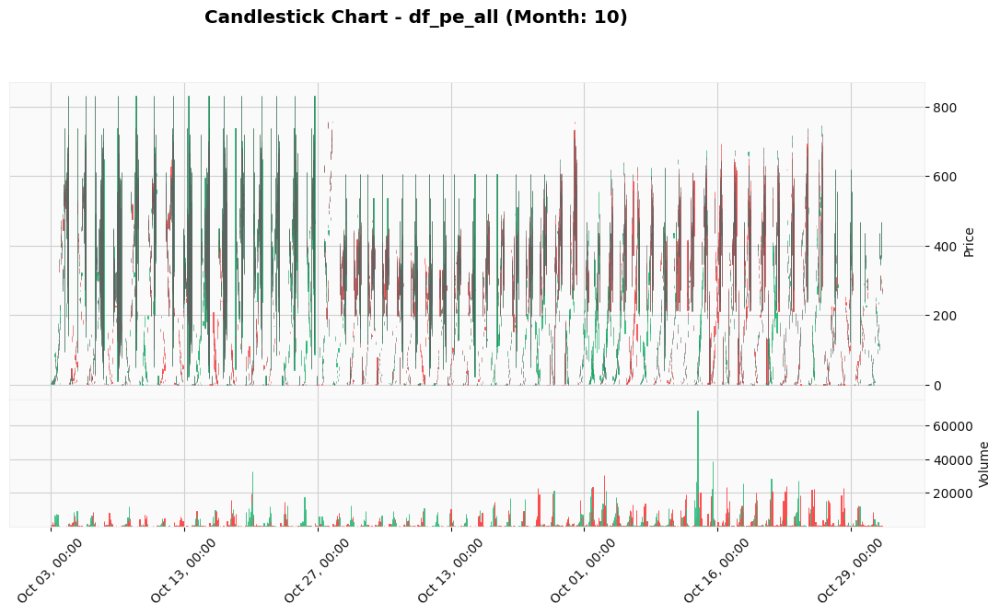

Candlestick Chart plotted for df_pe_all - Month 10.



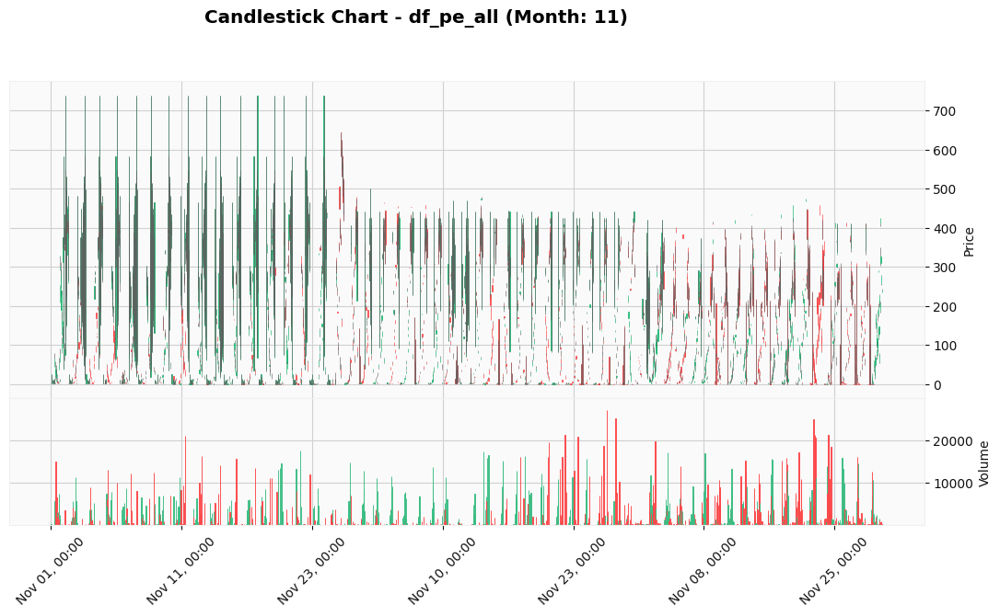

Candlestick Chart plotted for df_pe_all - Month 11.



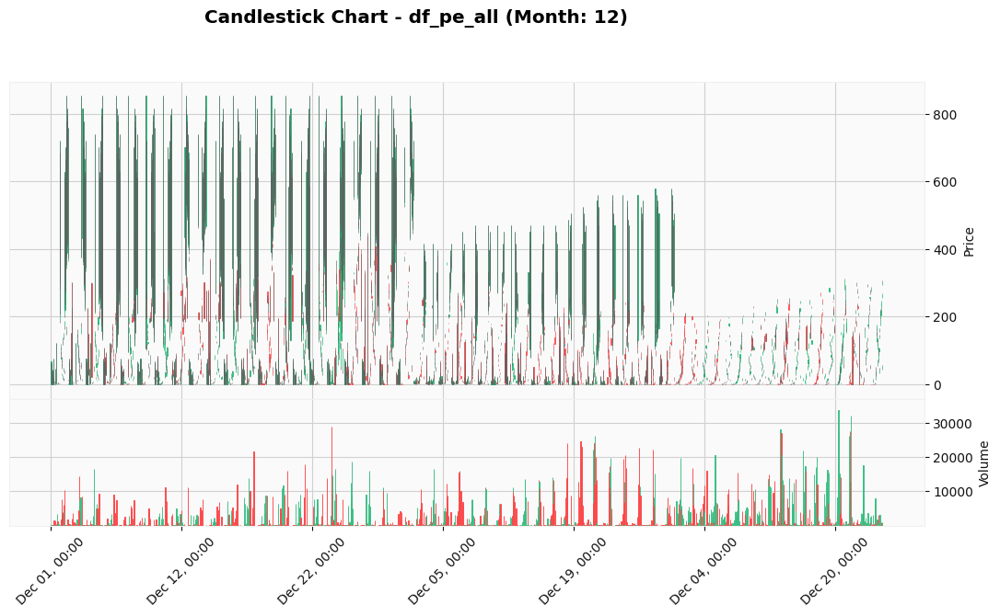

Candlestick Chart plotted for df_pe_all - Month 12.

--- Candlestick Chart for df_ce_pe_2022 ---



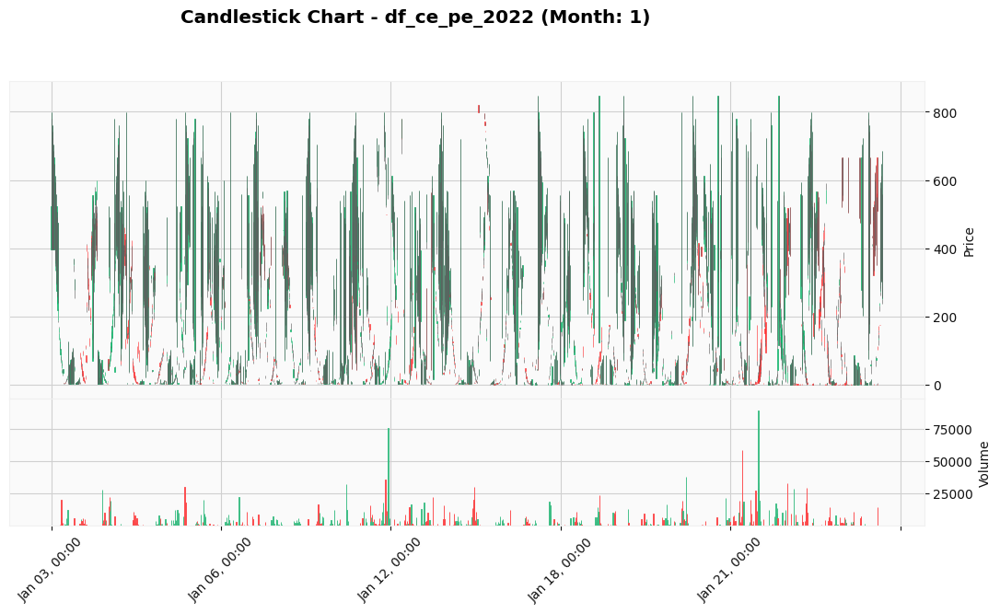

Candlestick Chart plotted for df_ce_pe_2022 - Month 1.



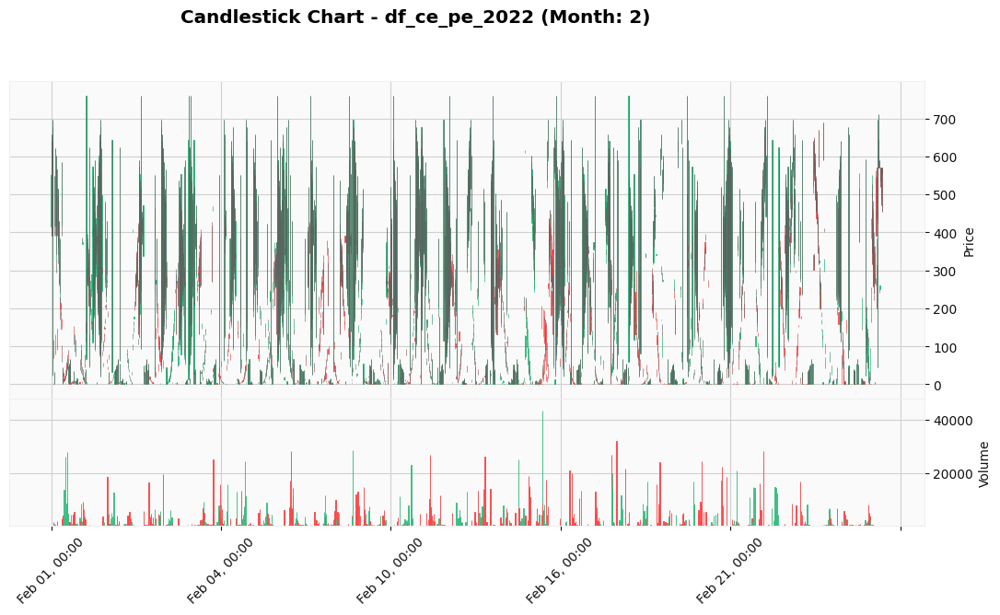

Candlestick Chart plotted for df_ce_pe_2022 - Month 2.



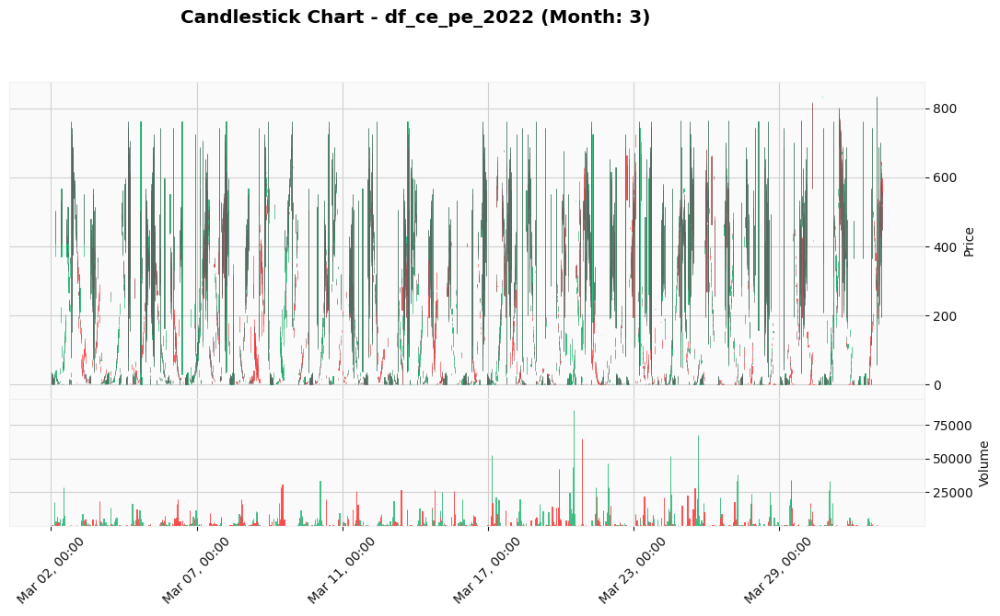

Candlestick Chart plotted for df_ce_pe_2022 - Month 3.



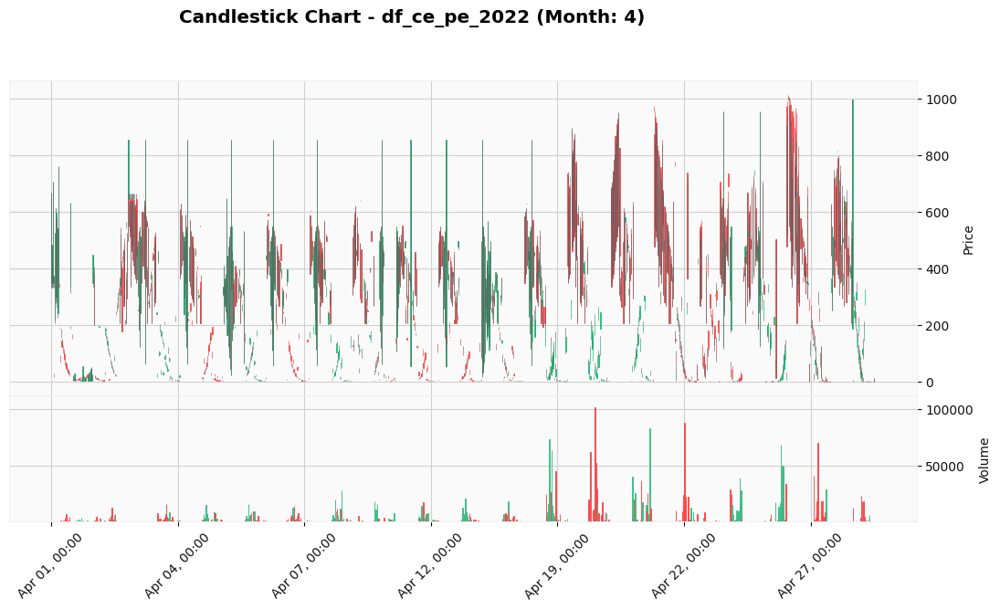

Candlestick Chart plotted for df_ce_pe_2022 - Month 4.



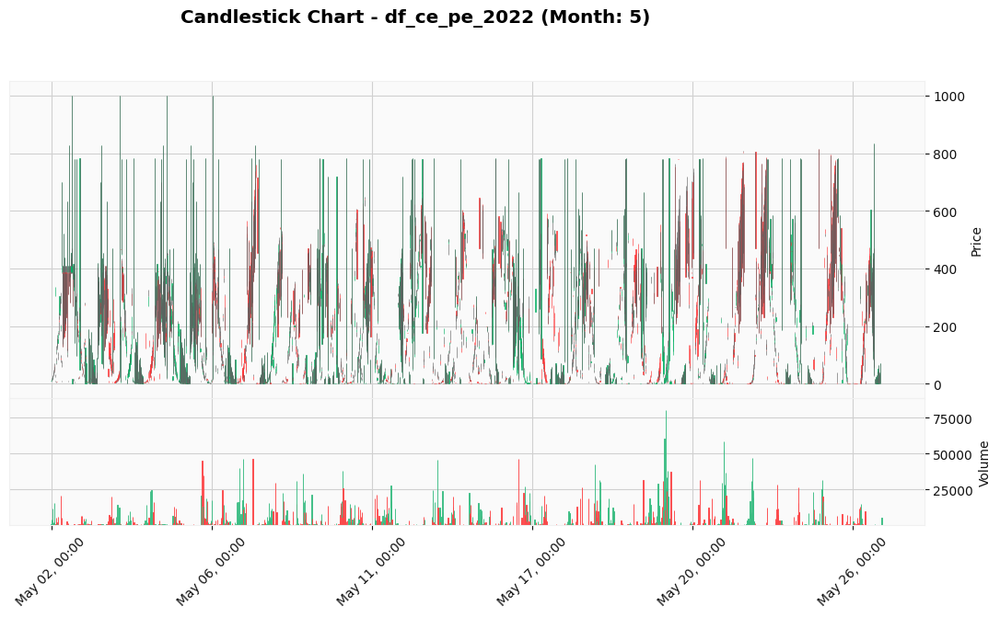

Candlestick Chart plotted for df_ce_pe_2022 - Month 5.



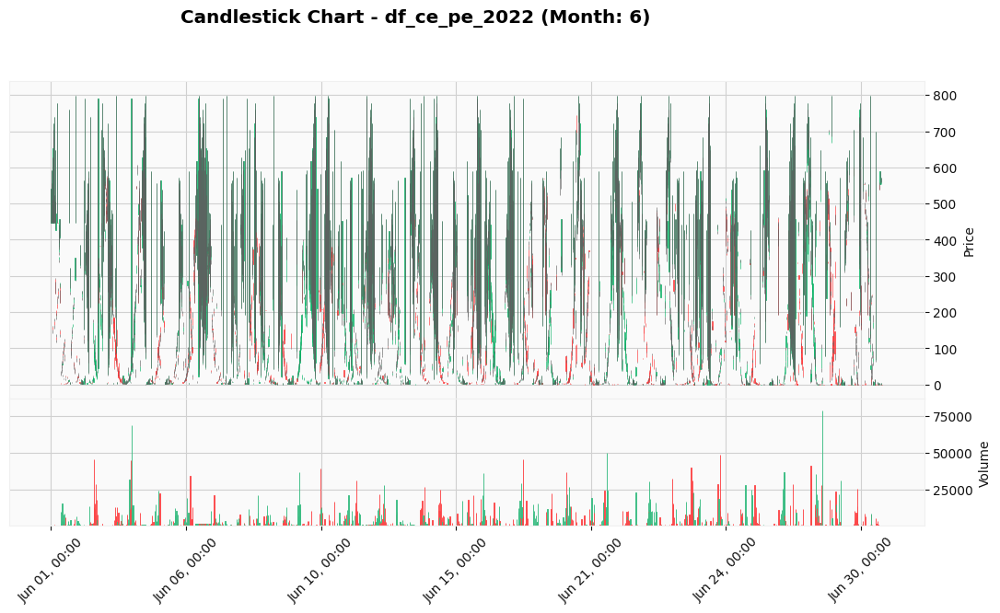

Candlestick Chart plotted for df_ce_pe_2022 - Month 6.



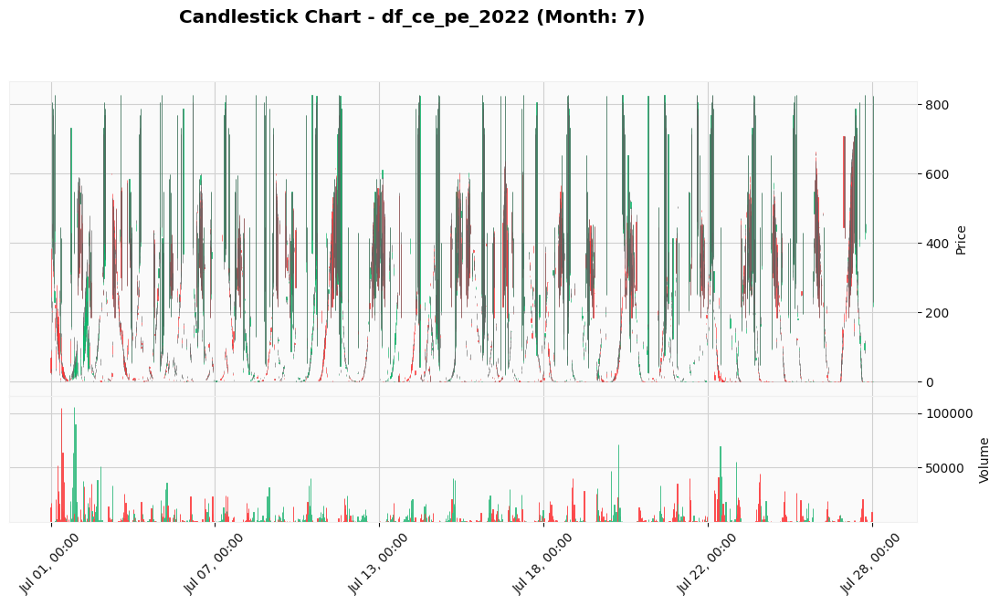

Candlestick Chart plotted for df_ce_pe_2022 - Month 7.



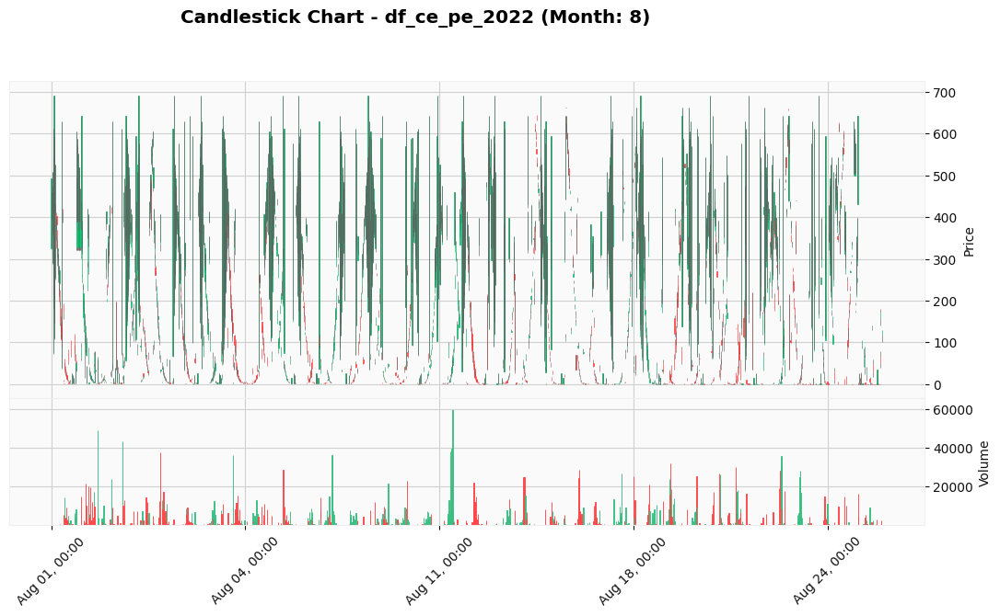

Candlestick Chart plotted for df_ce_pe_2022 - Month 8.



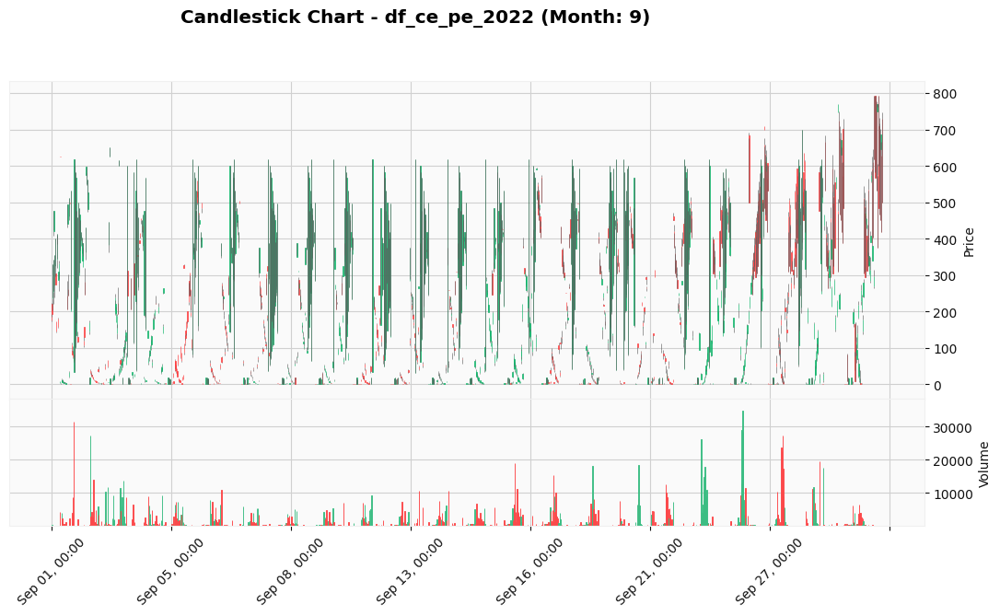

Candlestick Chart plotted for df_ce_pe_2022 - Month 9.



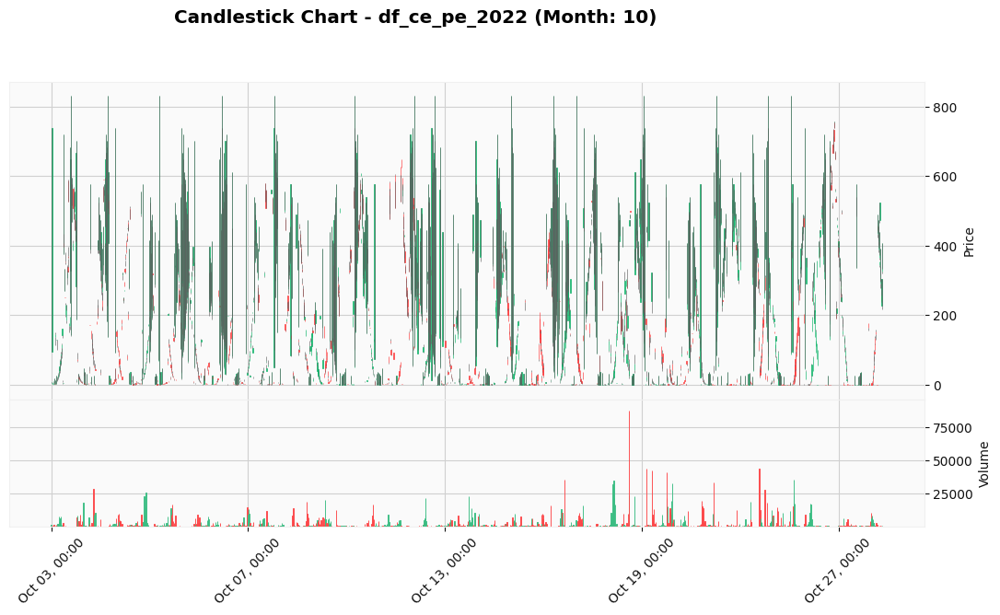

Candlestick Chart plotted for df_ce_pe_2022 - Month 10.



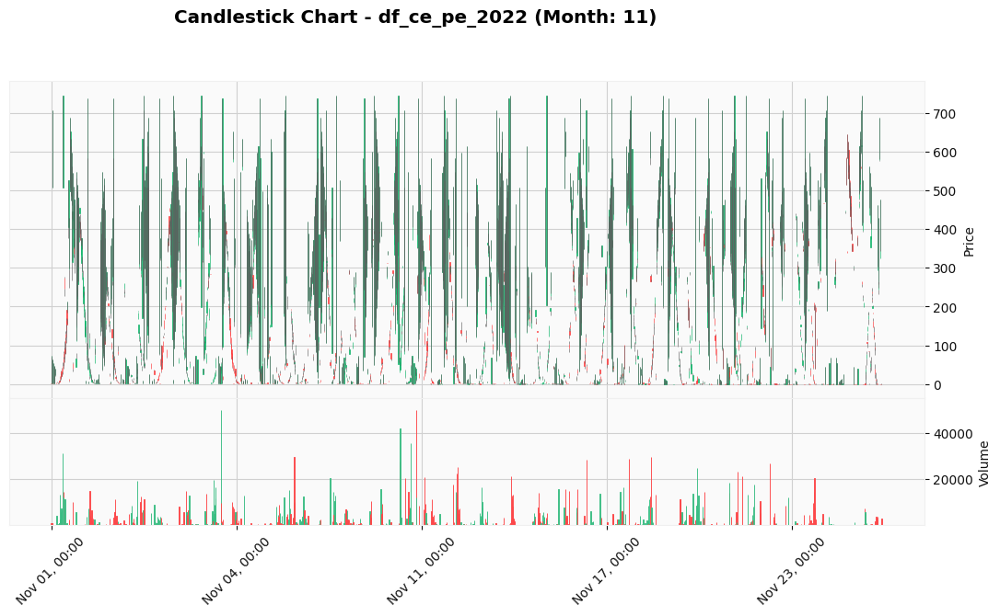

Candlestick Chart plotted for df_ce_pe_2022 - Month 11.



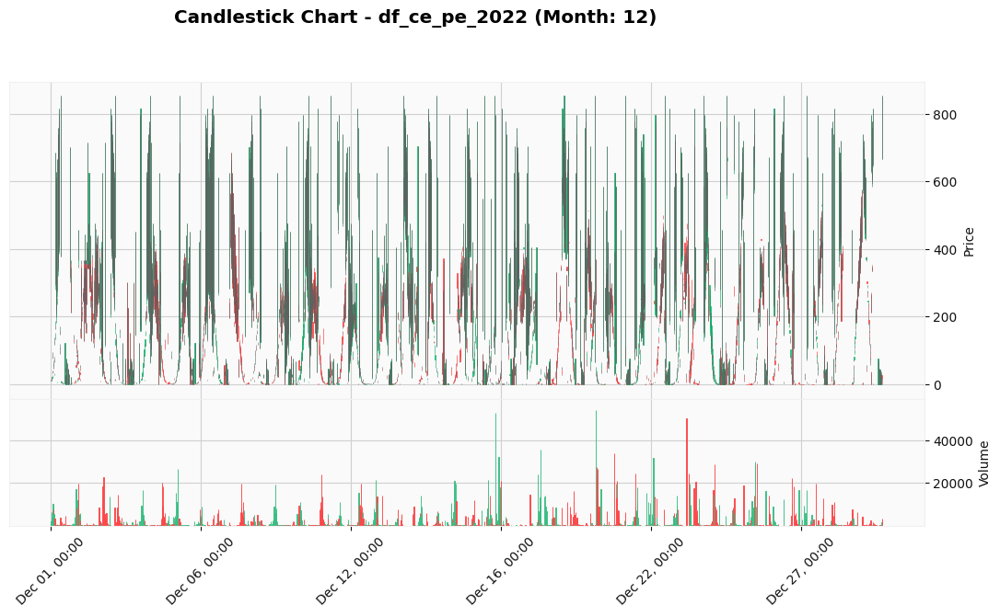

Candlestick Chart plotted for df_ce_pe_2022 - Month 12.

--- Candlestick Chart for df_ce_pe_2023 ---



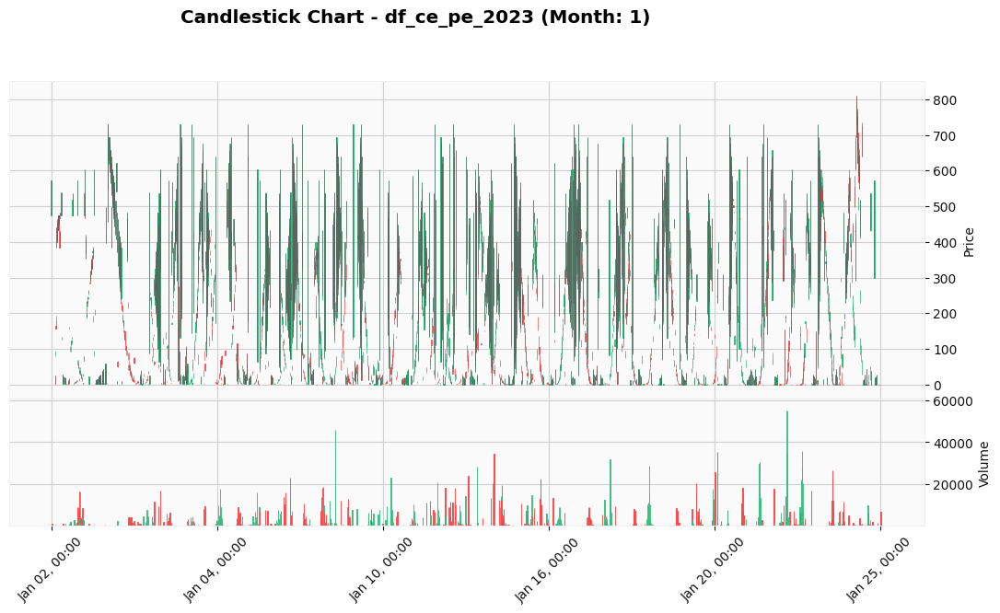

Candlestick Chart plotted for df_ce_pe_2023 - Month 1.



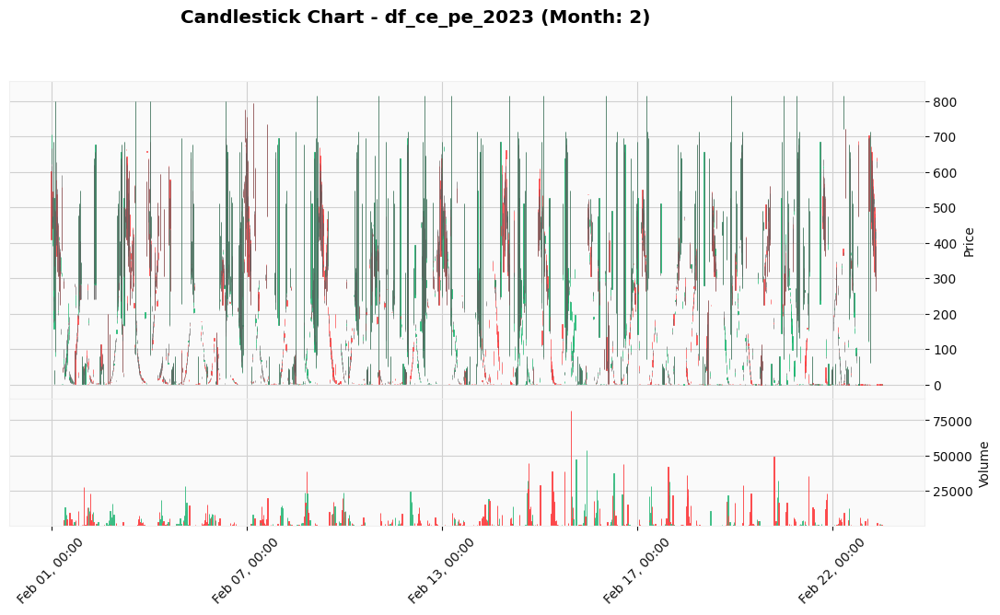

Candlestick Chart plotted for df_ce_pe_2023 - Month 2.



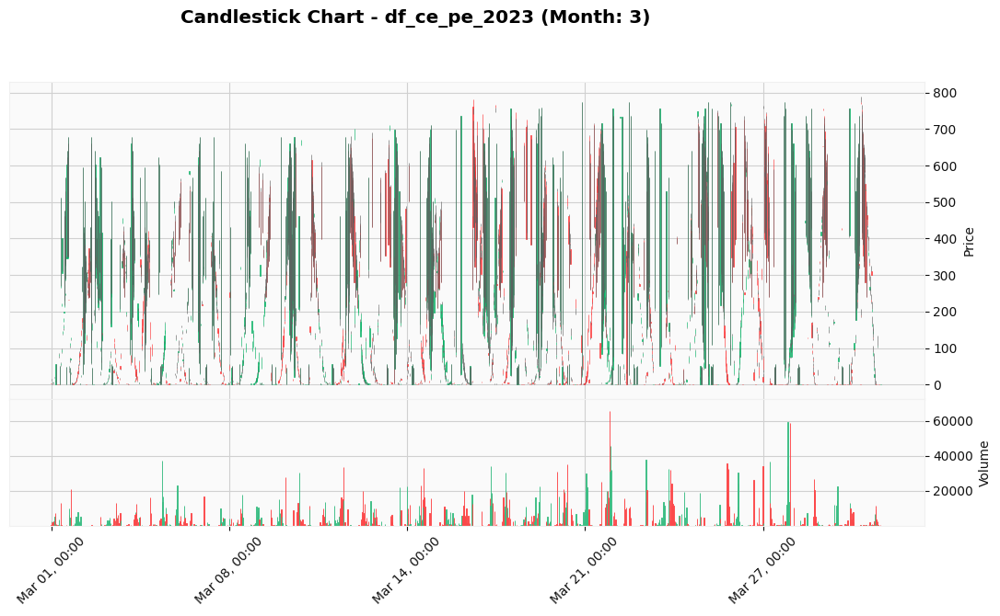

Candlestick Chart plotted for df_ce_pe_2023 - Month 3.



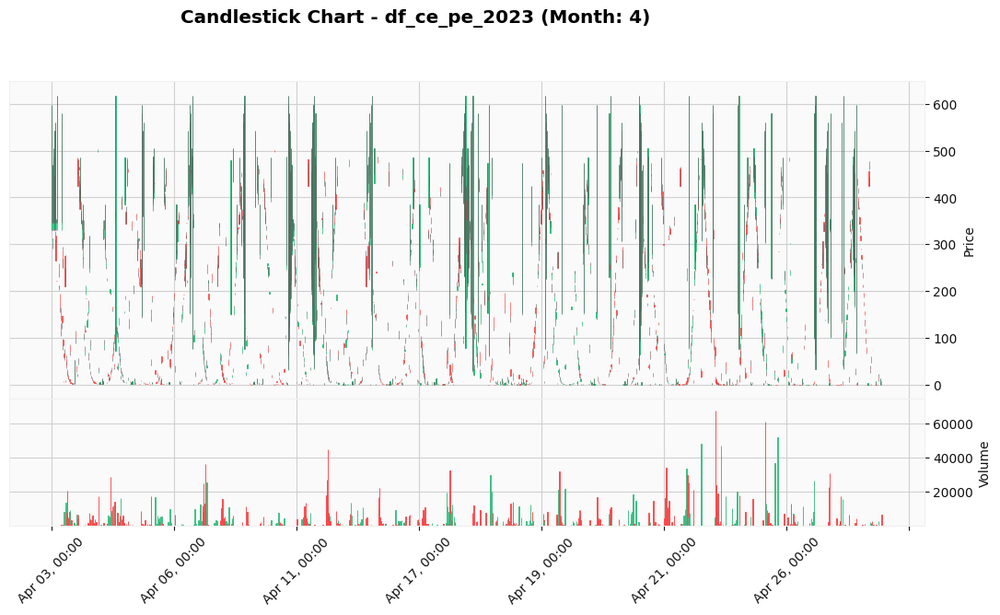

Candlestick Chart plotted for df_ce_pe_2023 - Month 4.



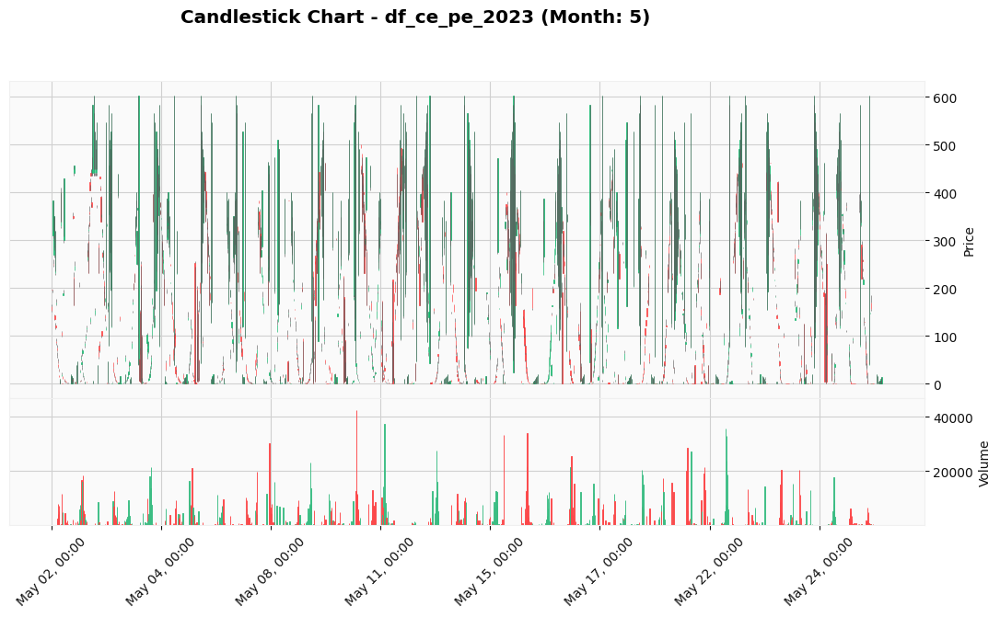

Candlestick Chart plotted for df_ce_pe_2023 - Month 5.



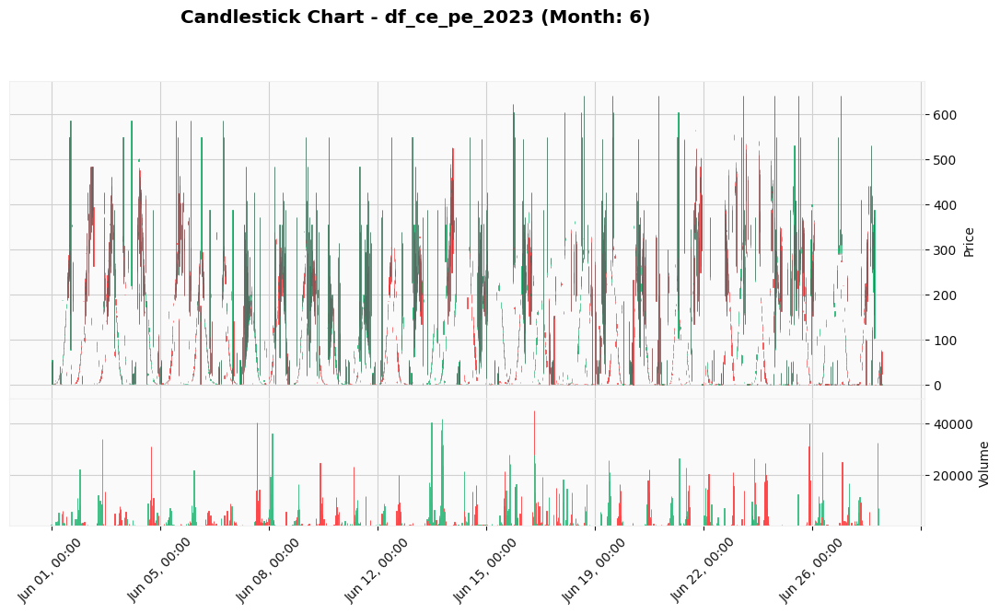

Candlestick Chart plotted for df_ce_pe_2023 - Month 6.



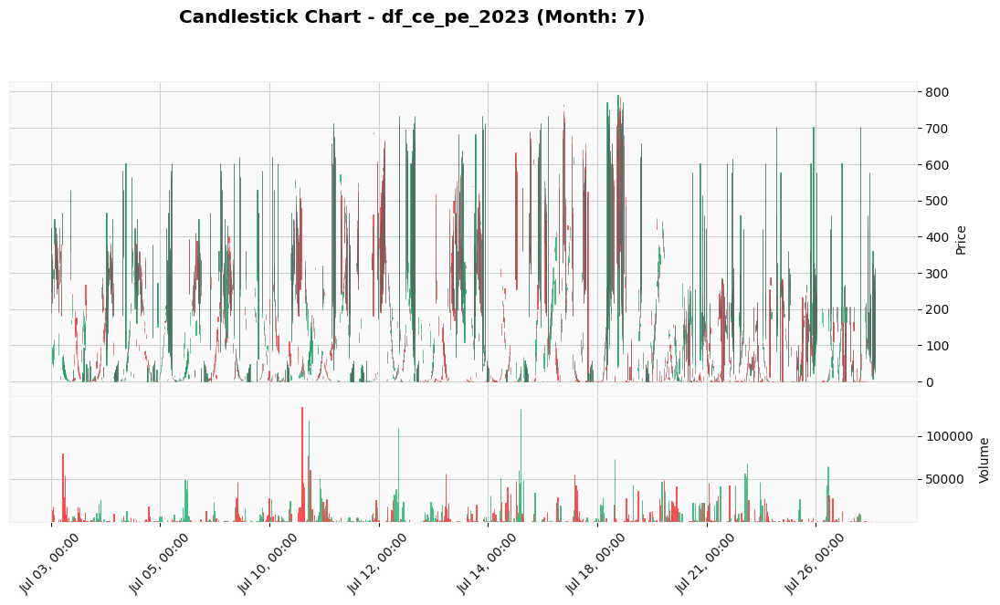

Candlestick Chart plotted for df_ce_pe_2023 - Month 7.



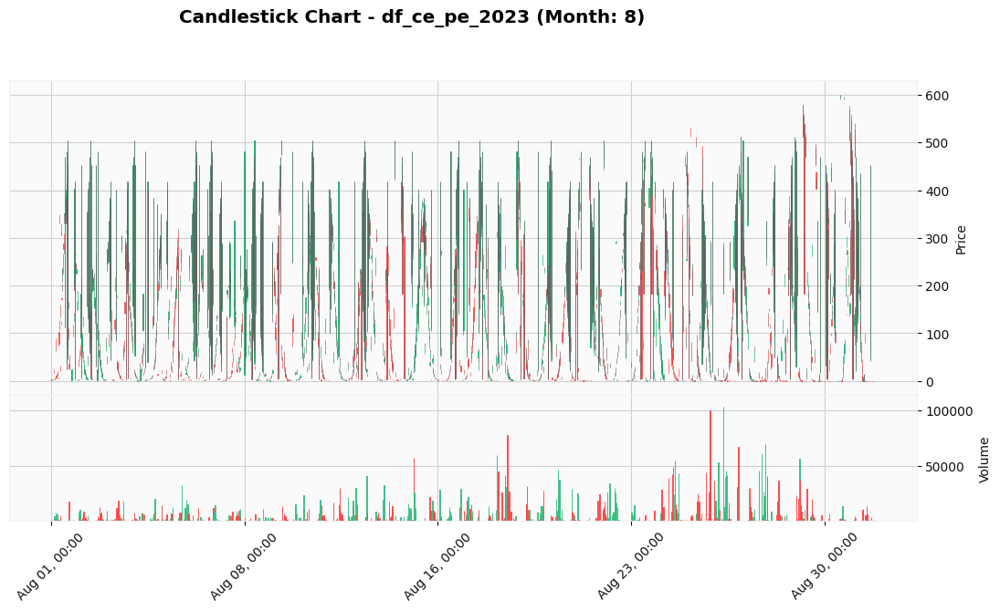

Candlestick Chart plotted for df_ce_pe_2023 - Month 8.



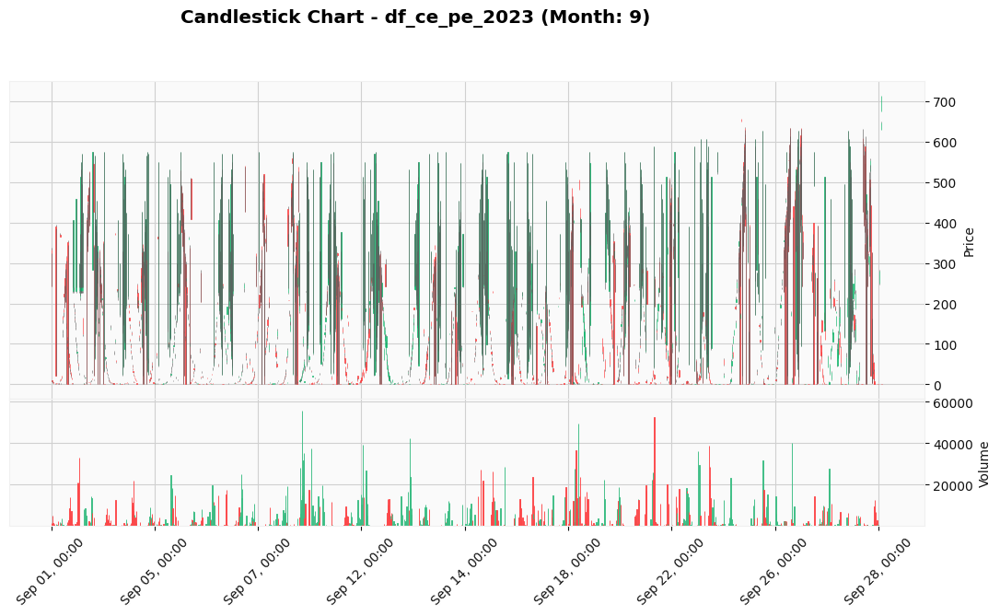

Candlestick Chart plotted for df_ce_pe_2023 - Month 9.



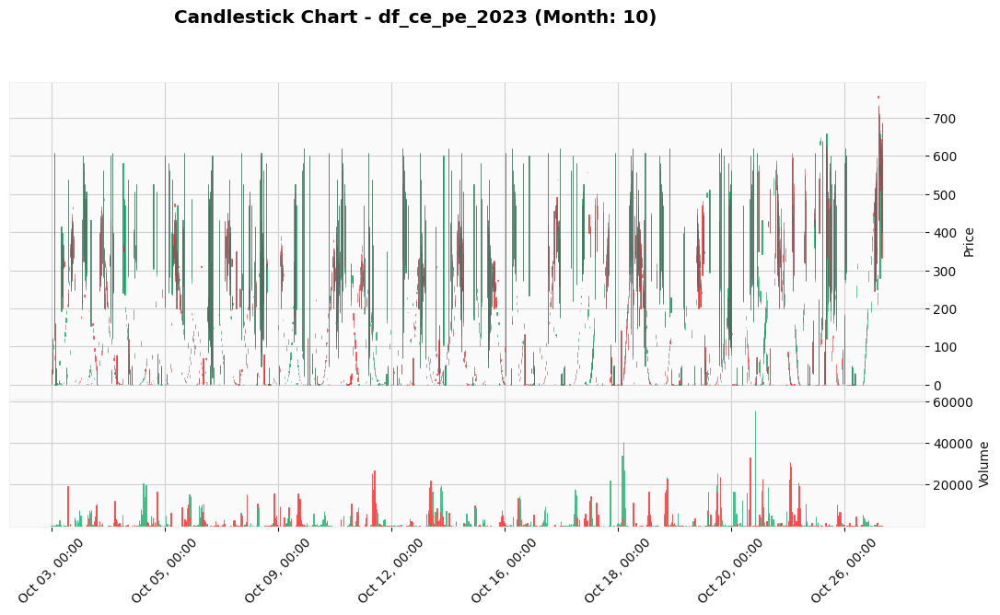

Candlestick Chart plotted for df_ce_pe_2023 - Month 10.



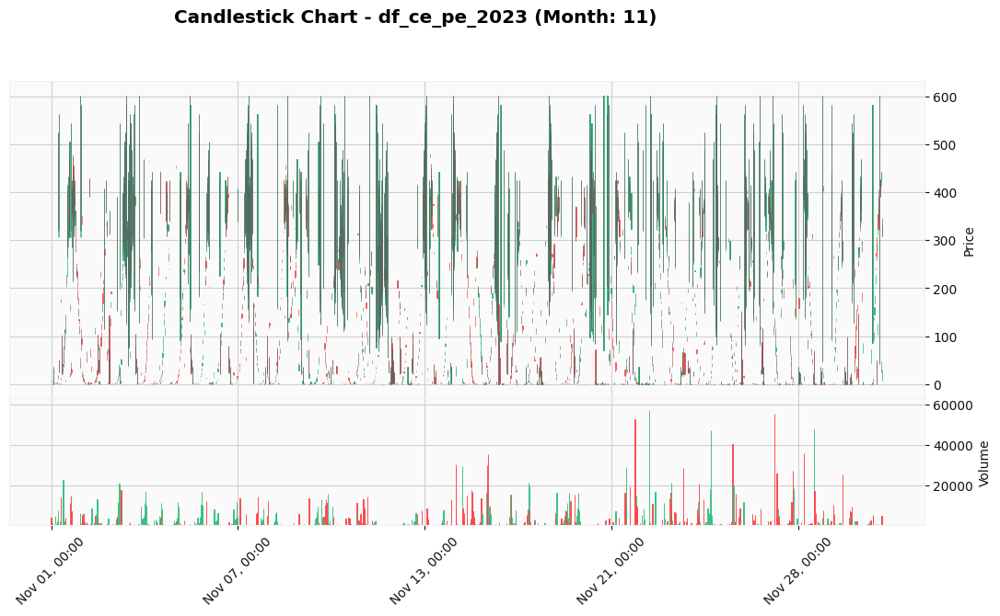

Candlestick Chart plotted for df_ce_pe_2023 - Month 11.



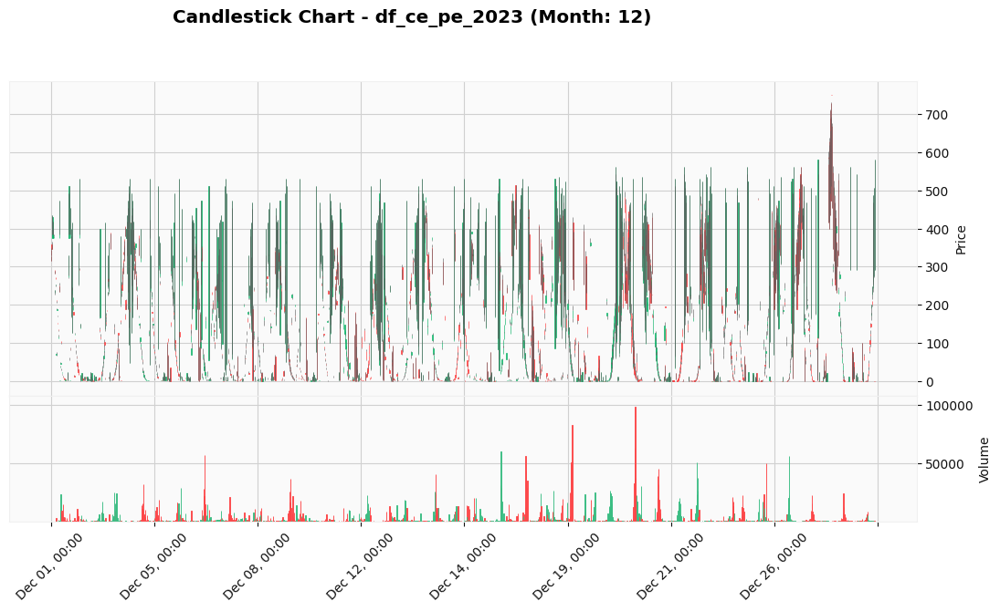

Candlestick Chart plotted for df_ce_pe_2023 - Month 12.

--- Candlestick Chart for df_ce_pe_2024 ---



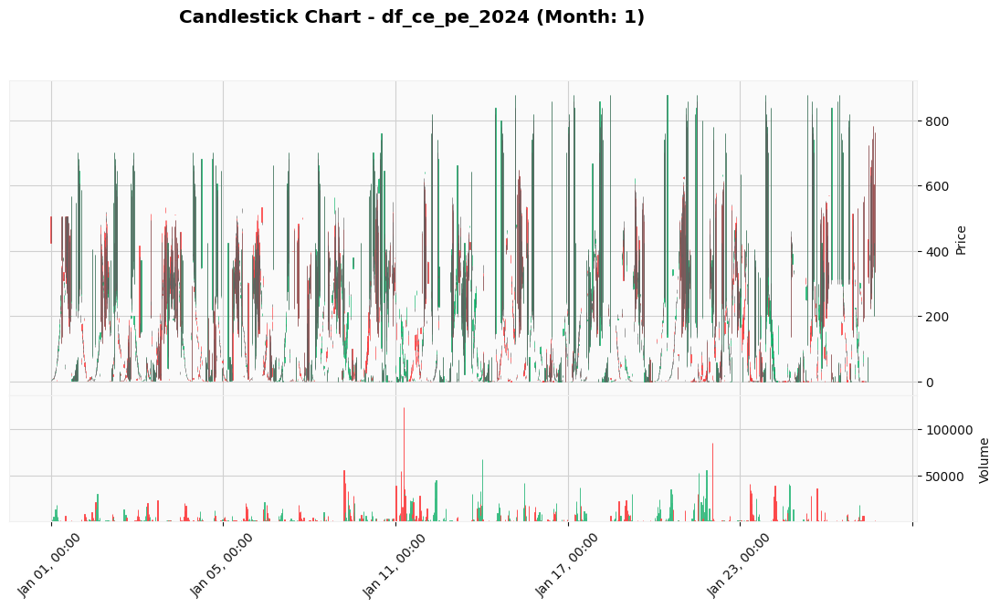

Candlestick Chart plotted for df_ce_pe_2024 - Month 1.



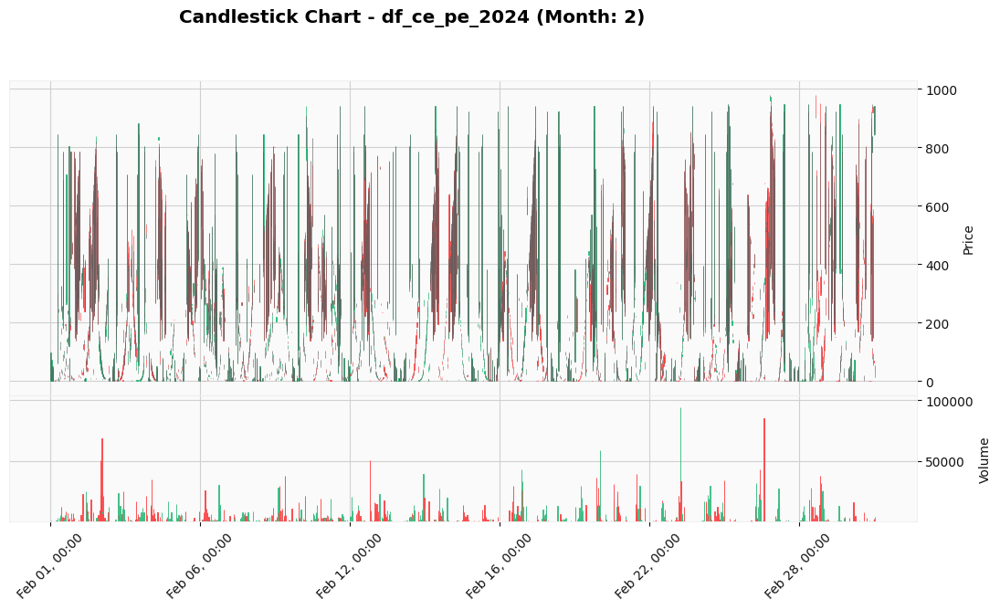

Candlestick Chart plotted for df_ce_pe_2024 - Month 2.



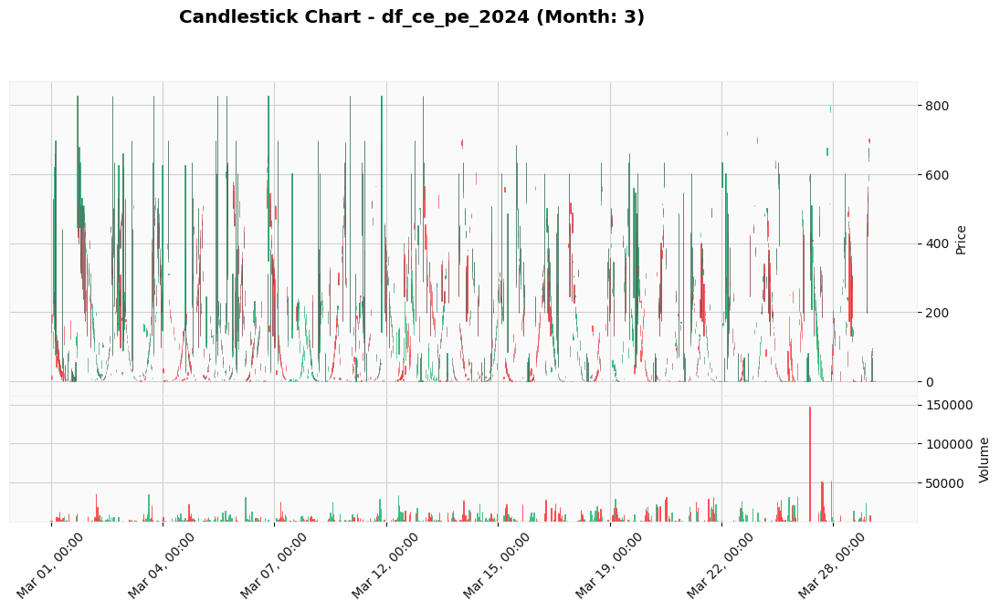

Candlestick Chart plotted for df_ce_pe_2024 - Month 3.



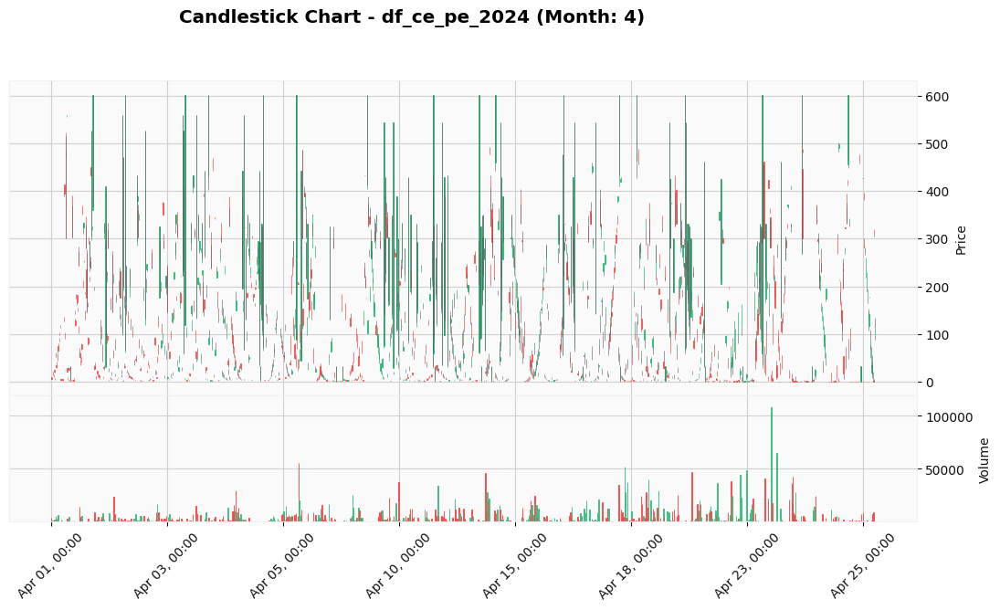

Candlestick Chart plotted for df_ce_pe_2024 - Month 4.



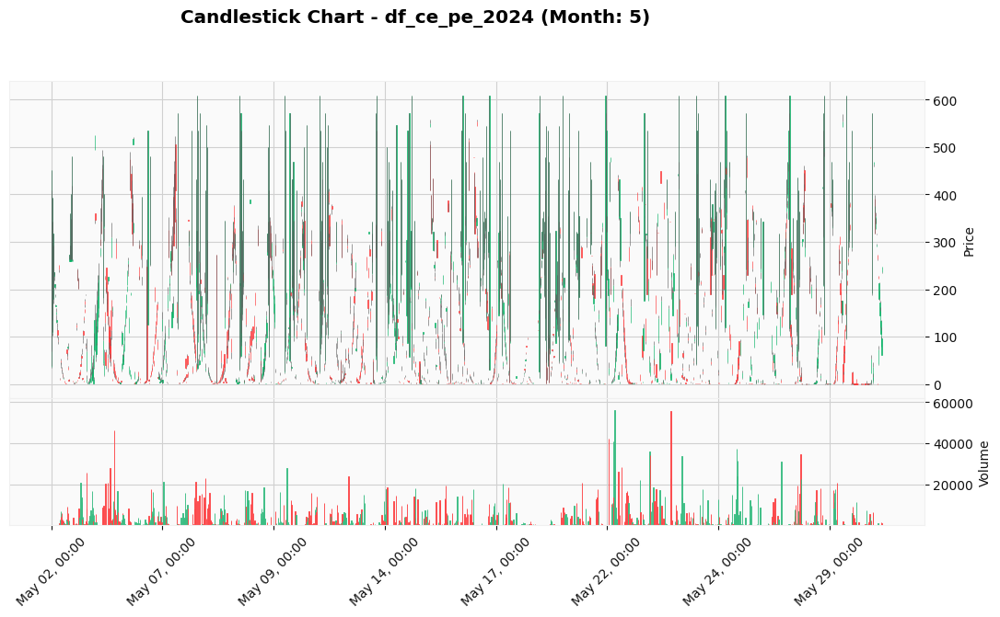

Candlestick Chart plotted for df_ce_pe_2024 - Month 5.



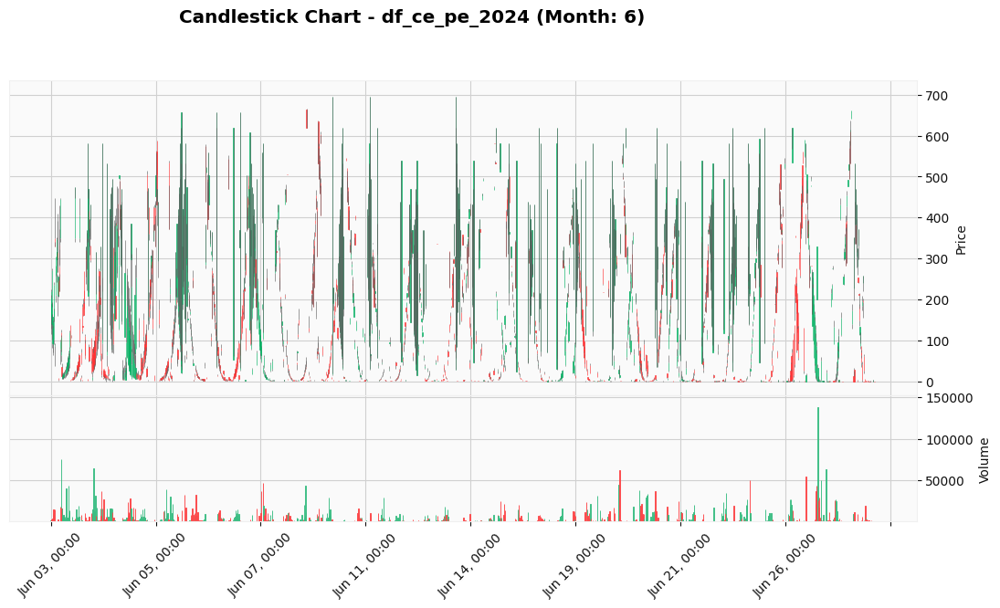

Candlestick Chart plotted for df_ce_pe_2024 - Month 6.



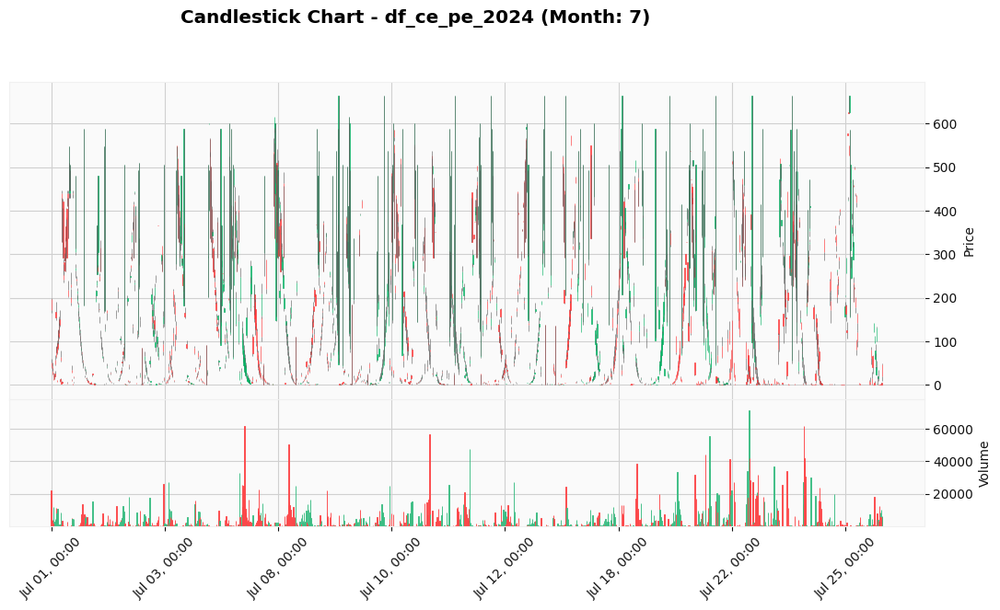

Candlestick Chart plotted for df_ce_pe_2024 - Month 7.



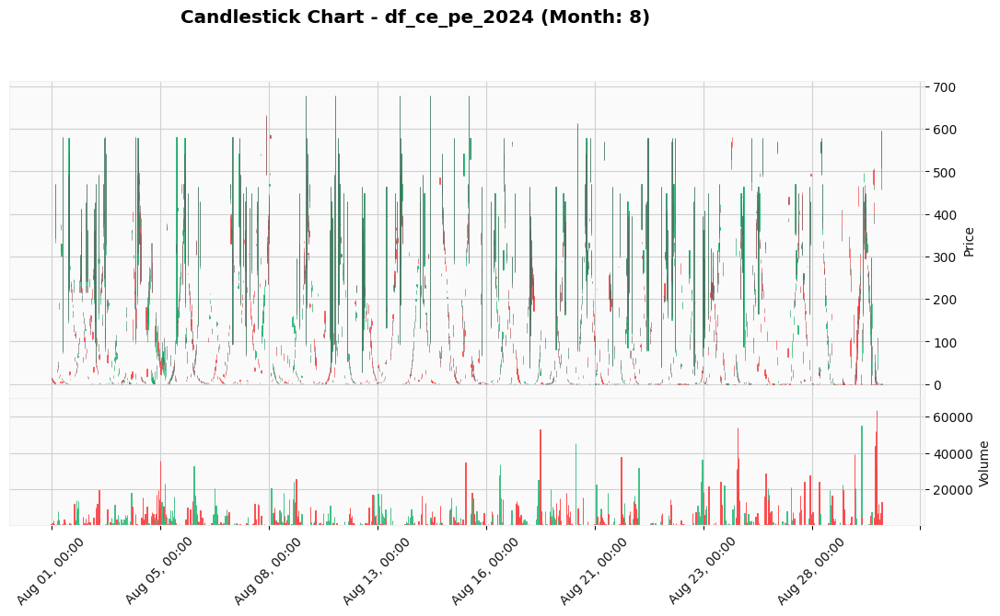

Candlestick Chart plotted for df_ce_pe_2024 - Month 8.



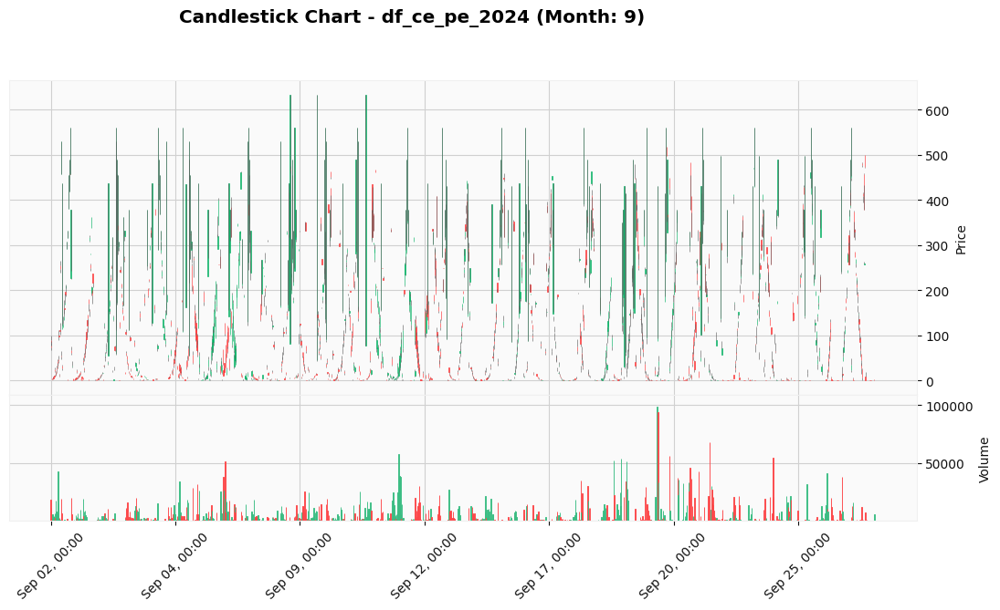

Candlestick Chart plotted for df_ce_pe_2024 - Month 9.



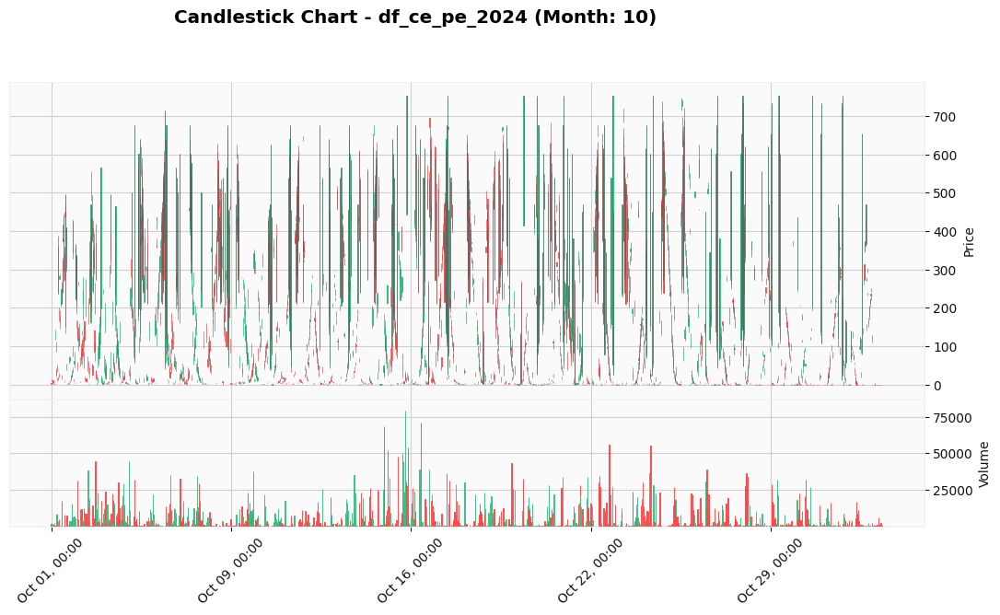

Candlestick Chart plotted for df_ce_pe_2024 - Month 10.



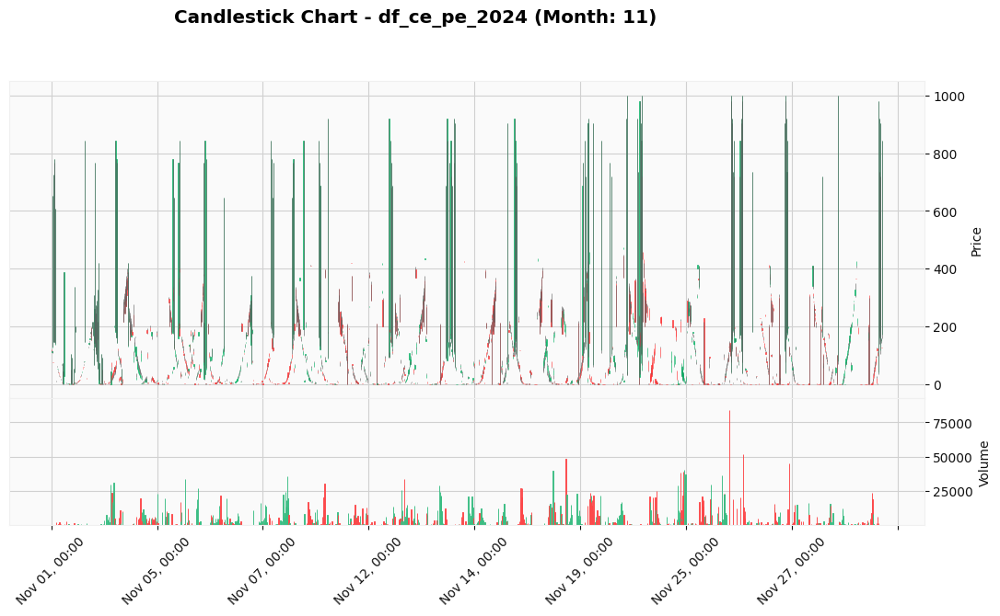

Candlestick Chart plotted for df_ce_pe_2024 - Month 11.



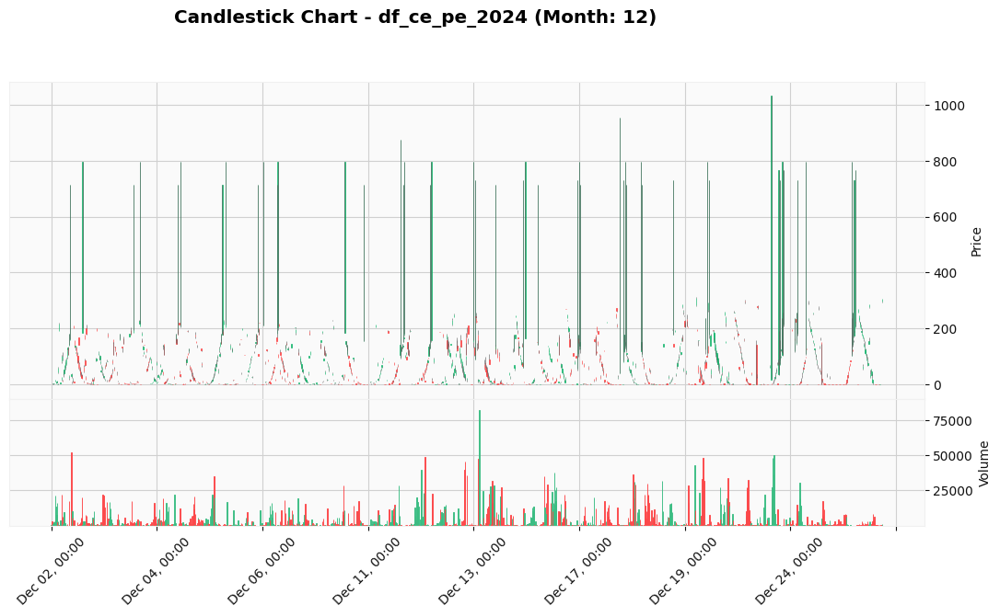

Candlestick Chart plotted for df_ce_pe_2024 - Month 12.

--- Candlestick Chart for df_options_combo ---



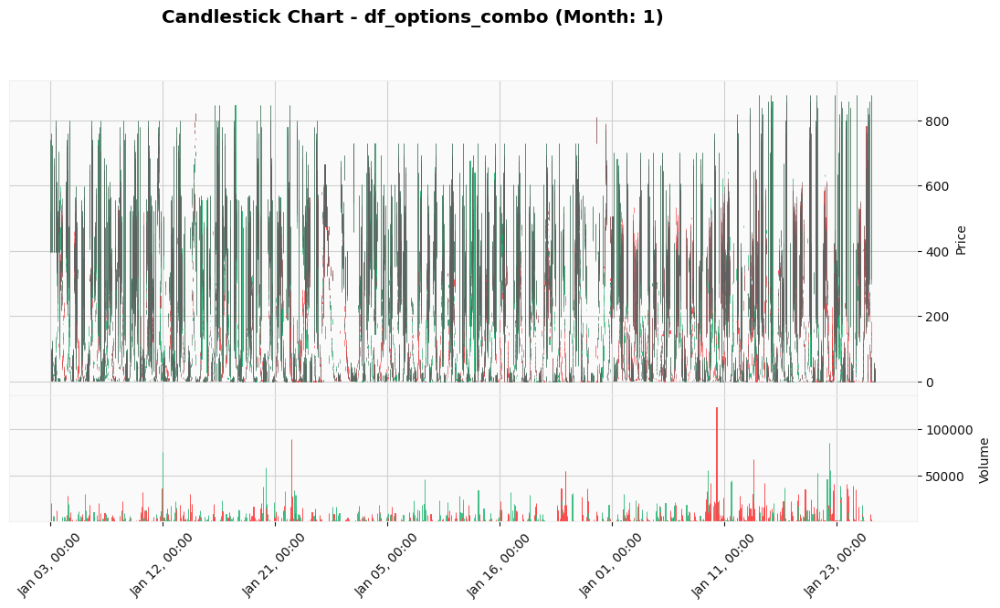

Candlestick Chart plotted for df_options_combo - Month 1.



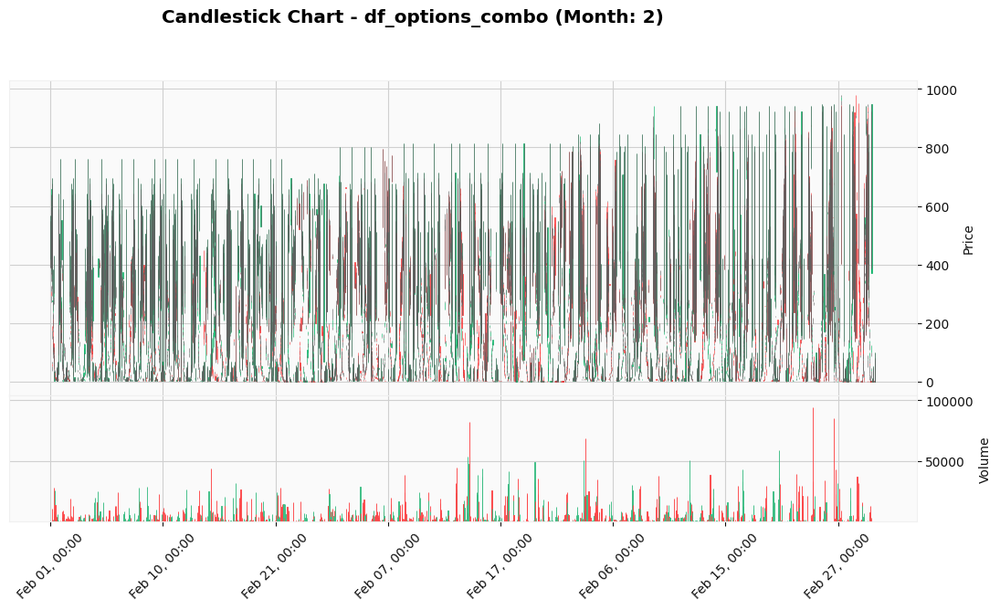

Candlestick Chart plotted for df_options_combo - Month 2.



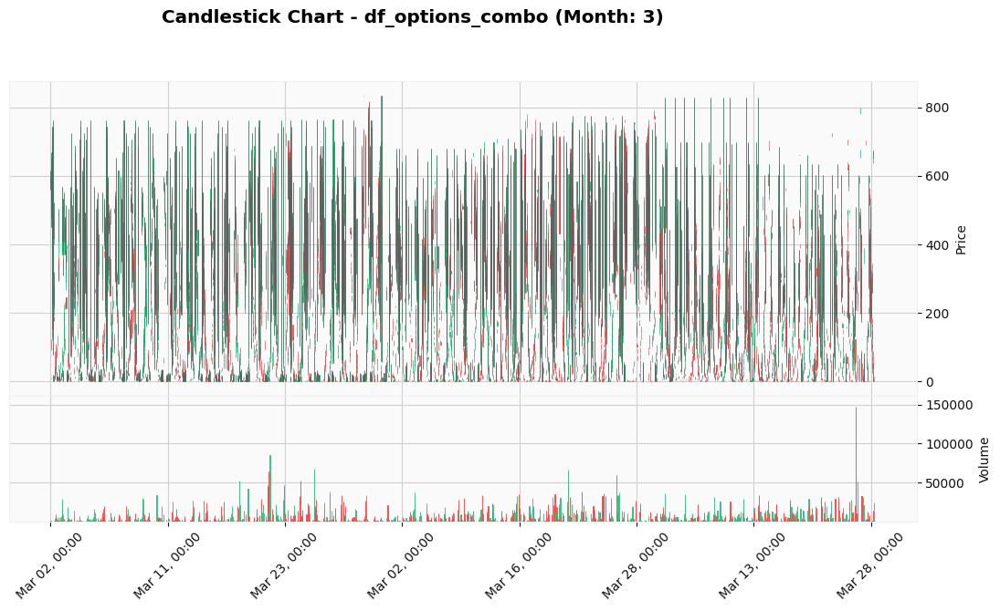

Candlestick Chart plotted for df_options_combo - Month 3.



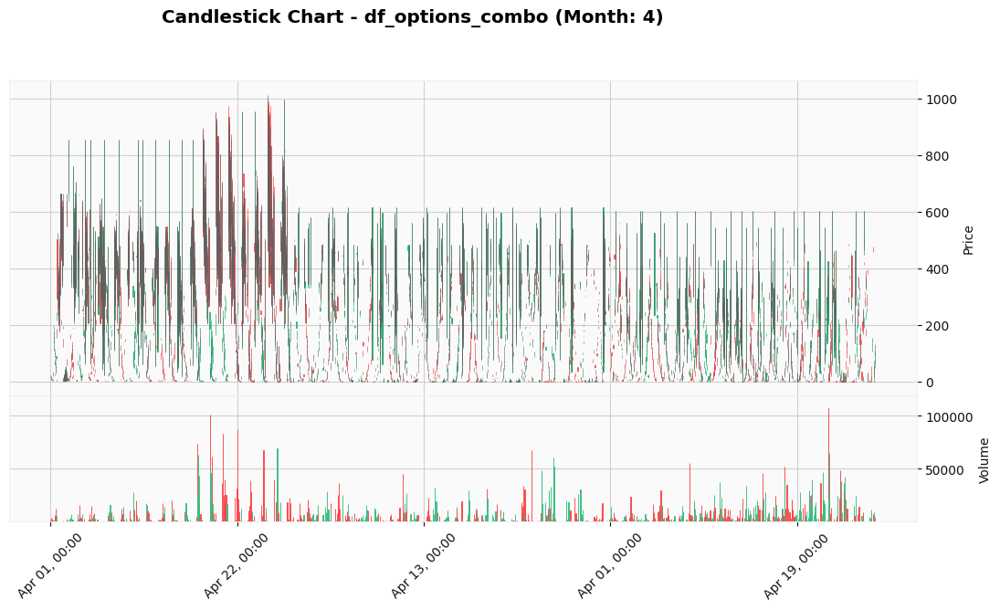

Candlestick Chart plotted for df_options_combo - Month 4.



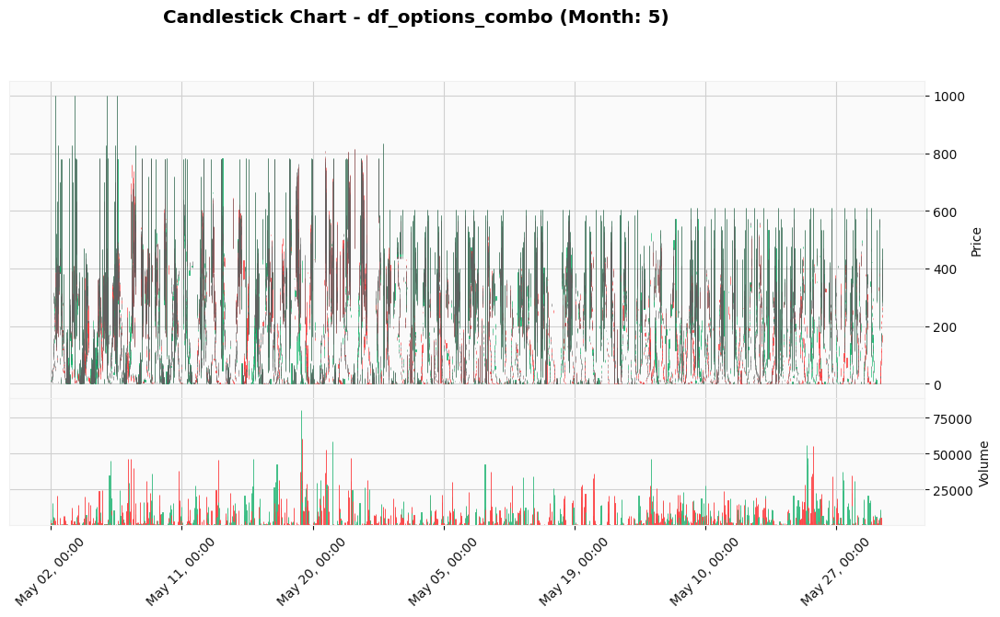

Candlestick Chart plotted for df_options_combo - Month 5.



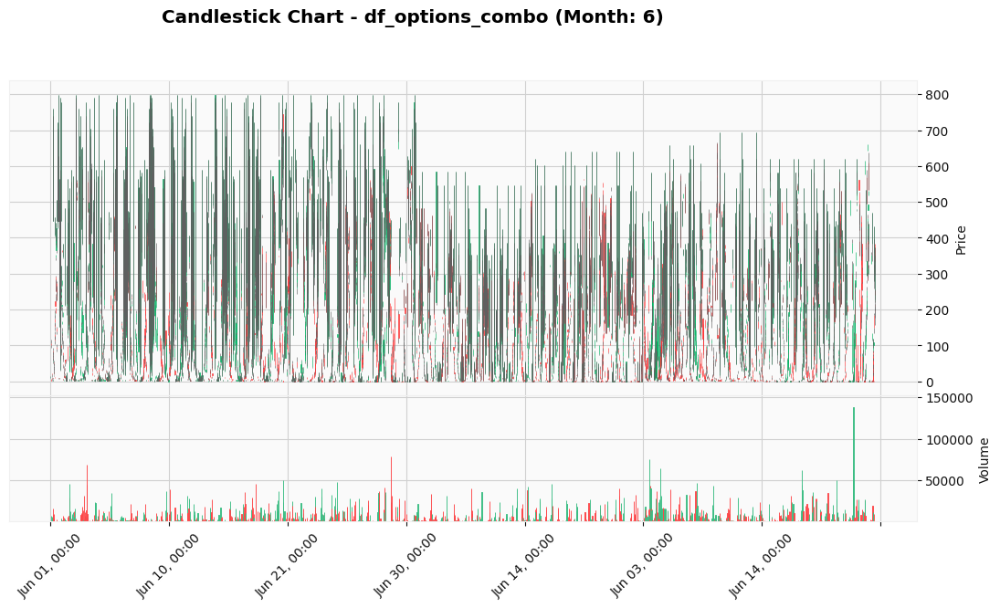

Candlestick Chart plotted for df_options_combo - Month 6.



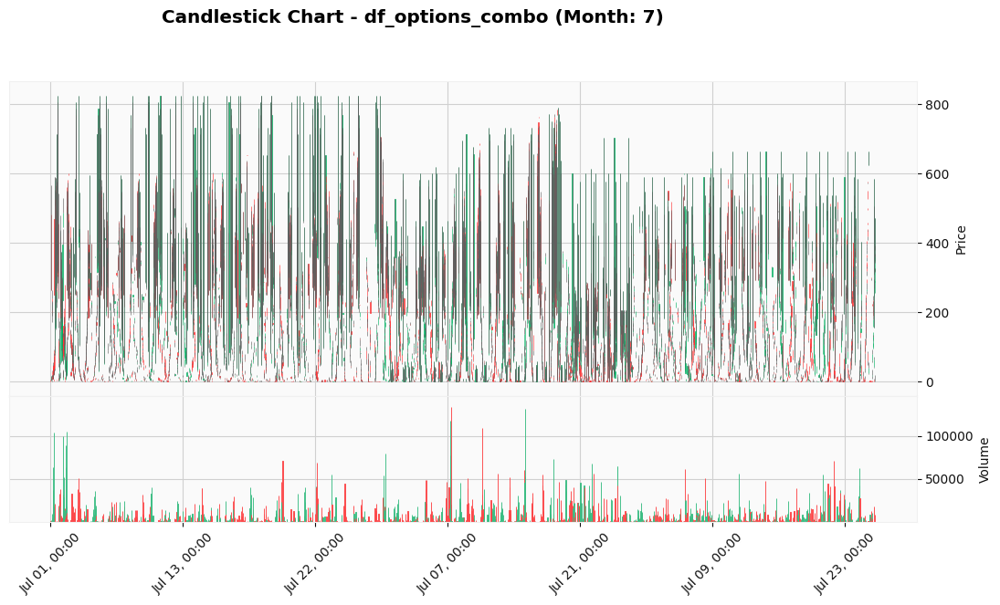

Candlestick Chart plotted for df_options_combo - Month 7.



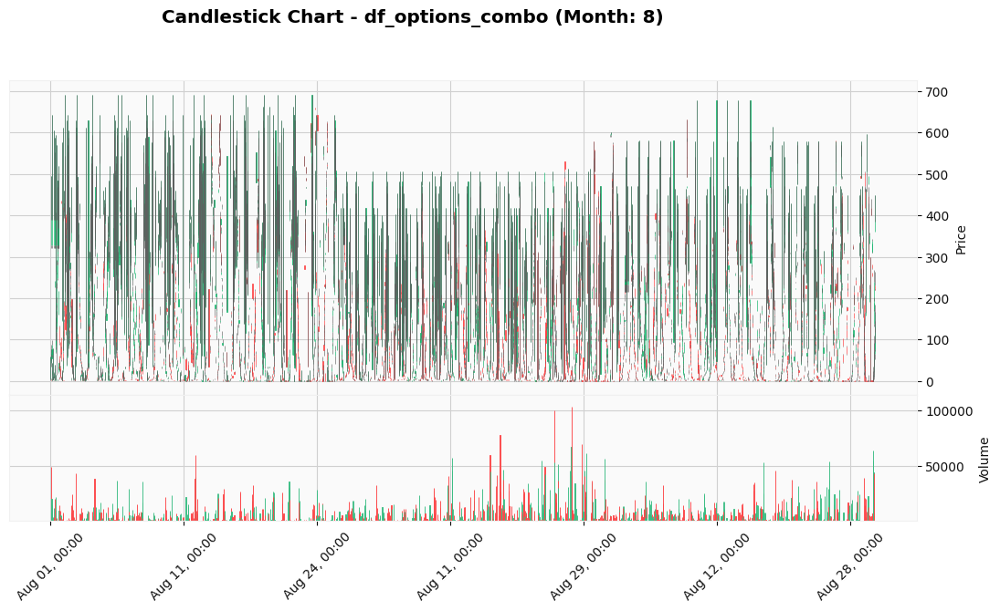

Candlestick Chart plotted for df_options_combo - Month 8.



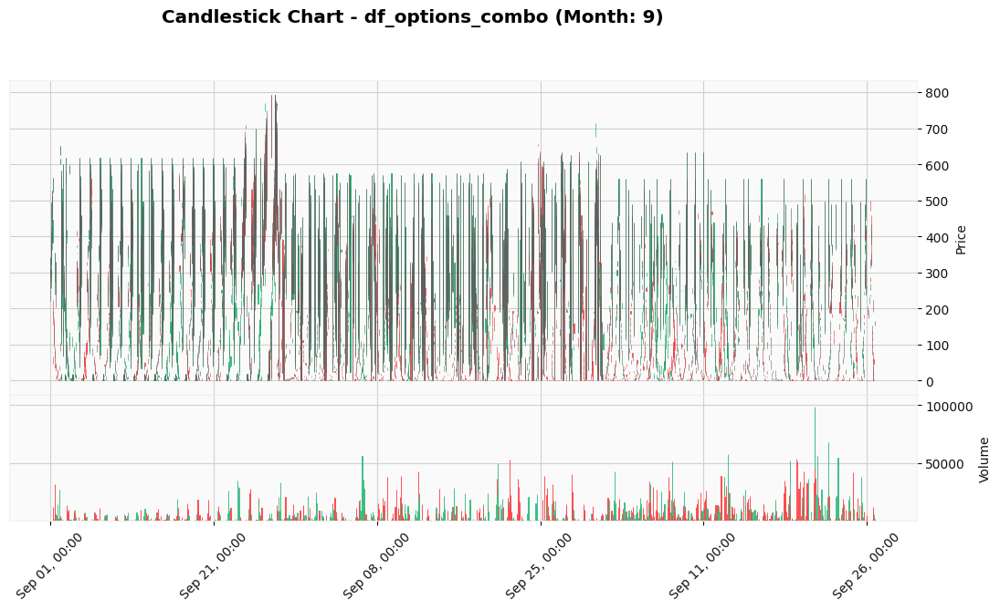

Candlestick Chart plotted for df_options_combo - Month 9.



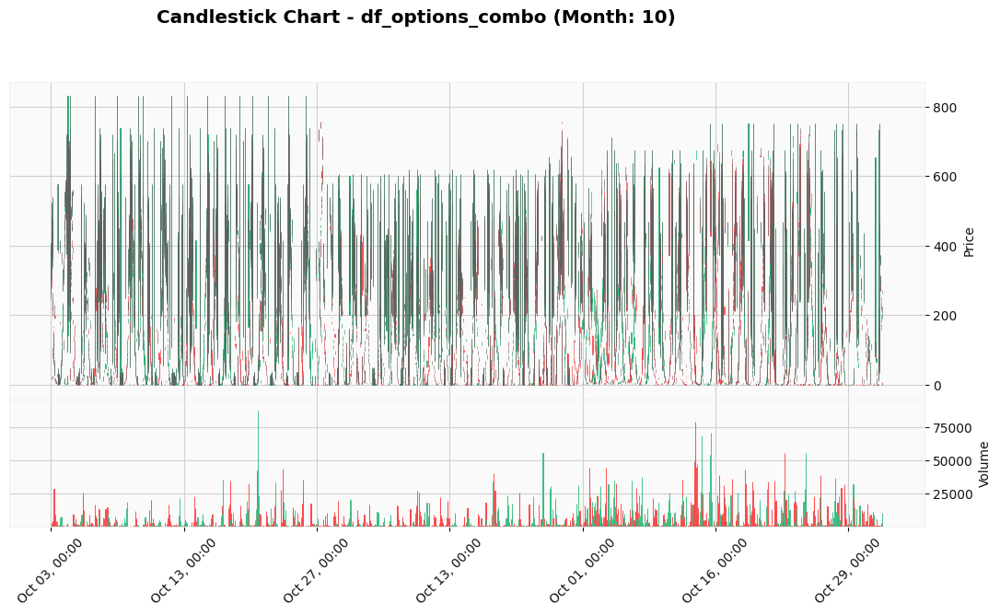

Candlestick Chart plotted for df_options_combo - Month 10.



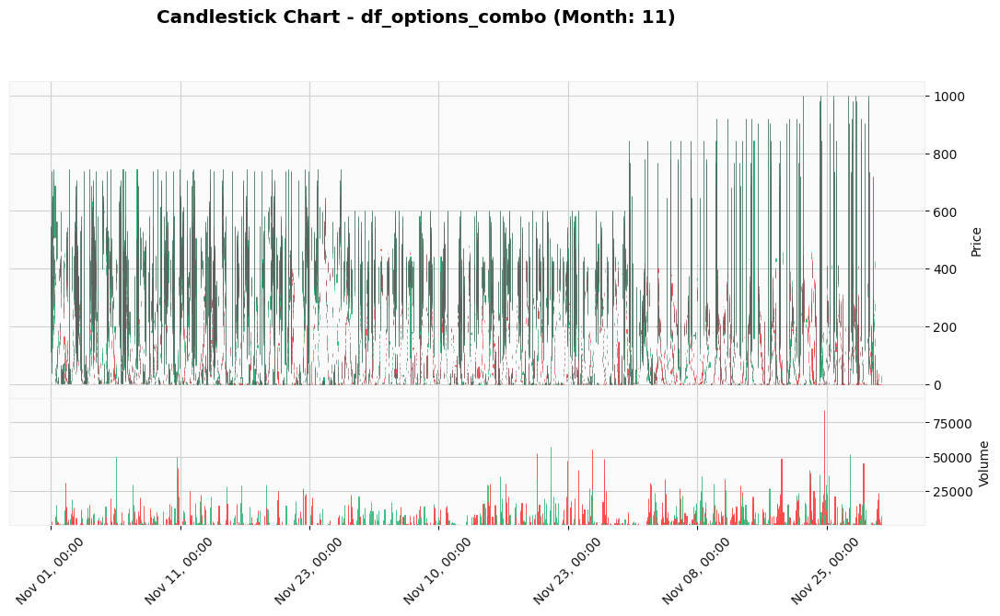

Candlestick Chart plotted for df_options_combo - Month 11.



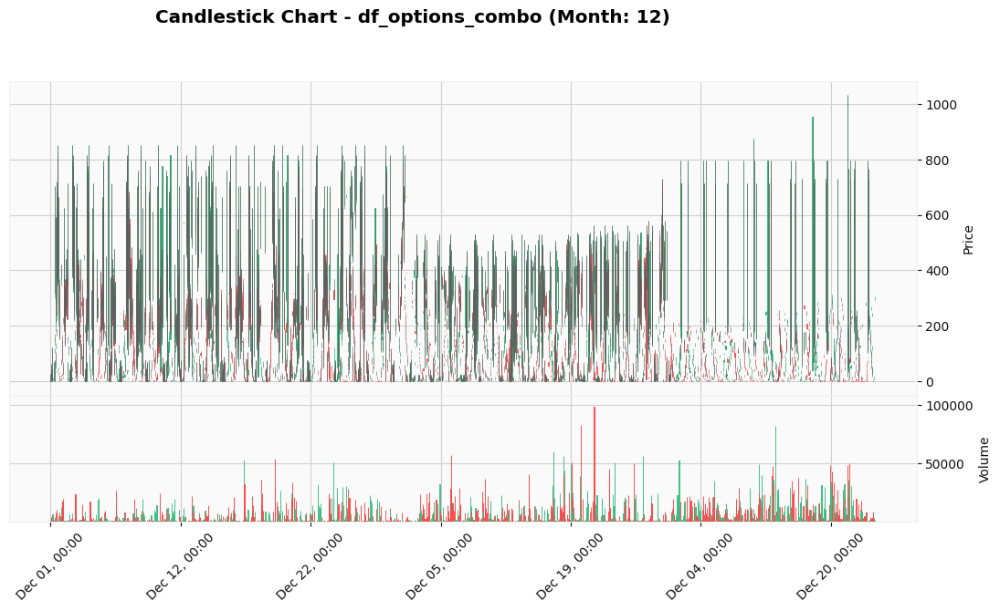

Candlestick Chart plotted for df_options_combo - Month 12.



In [66]:
# Candlestick Pattern
# Used to represent OHLC data - Open, High, Low and Close

# Data Visualization - 3

# Function to create a candlestick chart
def plot_candlestick_chart(df, dataset_name):
    print(f"--- Candlestick Chart for {dataset_name} ---\n")

    try:
        # Ensure the DataFrame has the required columns and 'Date' is a datetime object
        df['Date'] = pd.to_datetime(df['Date'])

        # Split 'Date' into separate 'Date' and 'Month' columns
        df['Month'] = df['Date'].dt.month
        df['Day'] = df['Date'].dt.day

        # Set 'Date' as the index
        df = df.set_index('Date')

        # Select the necessary columns for candlestick plotting
        required_columns = ['Open', 'High', 'Low', 'Close']
        missing_columns = [col for col in required_columns if col not in df.columns]
        if missing_columns:
            print(f"Dataset {dataset_name} is missing required columns: {missing_columns}")
            return

        # Handle missing 'Volume' column by adding a default value (e.g., 'No. of contracts')
        if 'Volume' not in df.columns:
            df['Volume'] = df['No. of contracts']

        # Filter required columns
        df_filtered = df[['Open', 'High', 'Low', 'Close', 'Volume']]

        # Group data by Month and plot daily candlesticks for each month
        for month, data in df_filtered.groupby(df['Month']):
            # Ensure Volume is positive (remove any negative values if any)
            data['Volume'] = data['Volume'].abs()

            # Plot the daily candlestick chart for each month
            mpf.plot(data, type='candle', volume=True,
                     title=f"Candlestick Chart - {dataset_name} (Month: {month})",
                     style='yahoo', figratio=(16,8), figscale=1.2,
                     ylabel='Price', ylabel_lower='Volume',
                     show_nontrading=False)  # Disable non-trading days
            print(f"Candlestick Chart plotted for {dataset_name} - Month {month}.\n")

    except Exception as e:
        print(f"An error occurred while plotting {dataset_name}: {e}\n")

# List of datasets
datasets = {
    "df_ce_2022": df_ce_2022,
    "df_ce_2023": df_ce_2023,
    "df_ce_2024": df_ce_2024,
    "df_pe_2022": df_pe_2022,
    "df_pe_2023": df_pe_2023,
    "df_pe_2024": df_pe_2024,
    "df_ce_all": df_ce_all,
    "df_pe_all": df_pe_all,
    "df_ce_pe_2022": df_ce_pe_2022,
    "df_ce_pe_2023": df_ce_pe_2023,
    "df_ce_pe_2024": df_ce_pe_2024,
    "df_options_combo": df_options_combo
}

# Plot candlestick chart for each dataset
for name, dataset in datasets.items():
    plot_candlestick_chart(dataset, name)

# Technical Analysis

Initial dataset shape: (74748, 41)
After dropping NA rows: (74549, 41)
Missing or non-numeric features: {'EMA_12', 'MACD', 'MACD_Signal', 'EMA_26'}
Features selected: ['SMA_50', 'SMA_200', 'RSI', 'Upper_Band', 'Lower_Band']
Final dataset shape: (74549, 5)
--- Random Forest Performance ---
Accuracy: 88.15%
Confusion Matrix:
[[6948  859]
 [ 908 6195]]

Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.89      0.89      7807
           1       0.88      0.87      0.88      7103

    accuracy                           0.88     14910
   macro avg       0.88      0.88      0.88     14910
weighted avg       0.88      0.88      0.88     14910



--- Logistic Regression Performance ---
Accuracy: 70.18%
Confusion Matrix:
[[6154 1653]
 [2793 4310]]

Classification Report:
              precision    recall  f1-score   support

           0       0.69      0.79      0.73      7807
           1       0.72      0.61      0.66      7103

    a

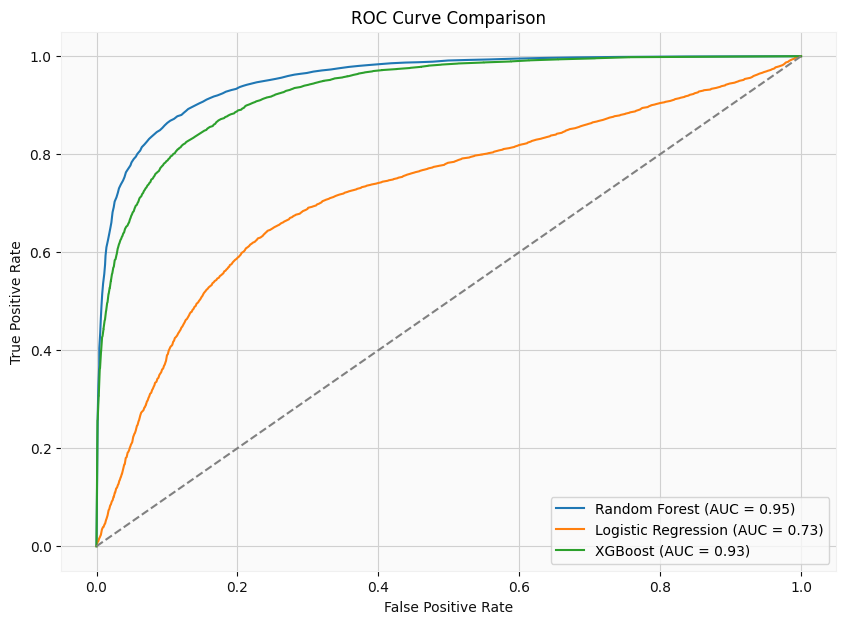

In [87]:
# Code for Technical Analysis

# Function to calculate technical indicators using pandas-ta
def calculate_indicators(df):

    # Simple Moving Averages
    df['SMA_10'] = ta.sma(df['Close'], 10)
    df['SMA_20'] = ta.sma(df['Close'], 20)
    df['SMA_30'] = ta.sma(df['Close'], 30)
    df['SMA_50'] = ta.sma(df['Close'], 50)
    df['SMA_90'] = ta.sma(df['Close'], 90)
    df['SMA_100'] = ta.sma(df['Close'], 100)
    df['SMA_180'] = ta.sma(df['Close'], 180)
    df['SMA_200'] = ta.sma(df['Close'], 200)

    # Exponential Moving Averages
    df['EMA_10'] = ta.ema(df['Close'], 10)
    df['EMA_20'] = ta.ema(df['Close'], 20)
    df['EMA_30'] = ta.ema(df['Close'], 30)
    df['EMA_50'] = ta.ema(df['Close'], 50)
    df['EMA_90'] = ta.ema(df['Close'], 90)
    df['EMA_100'] = ta.ema(df['Close'], 100)
    df['EMA_180'] = ta.ema(df['Close'], 180)
    df['EMA_200'] = ta.ema(df['Close'], 200)

    # RSI
    df['RSI'] = ta.rsi(df['Close'], 14)

    # MACD and MACD Signal
    df['MACD'], df['MACD_Signal'], _ = ta.macd(df['Close'], 12, 26, 9)

    # Bollinger Bands
    bbands_df = ta.bbands(df['Close'], 20, 2, 2)
    df['Upper_Band'] = bbands_df['BBU_20_2.0']
    df['Middle_Band'] = bbands_df['BBM_20_2.0']
    df['Lower_Band'] = bbands_df['BBL_20_2.0']

    return df

# Function to label the data: 1 for appreciation, 0 for decline
def label_data(df):

    # Calculate percentage change in close price
    df['Price_Change'] = df['Close'].pct_change()

    # 1 for price increase, 0 for decline
    df['Label'] = np.where(df['Price_Change'] > 0, 1, 0)
    return df

# Prepare dataset by labeling data
def prepare_data(df):
    df = label_data(df)

    # Drop rows with missing values
    print("Initial dataset shape:", df.shape)
    df.dropna(inplace=True)
    print("After dropping NA rows:", df.shape)

    # Verify features exist and are numeric
    features = ['SMA_50', 'SMA_200', 'EMA_12', 'EMA_26', 'RSI', 'MACD', 'MACD_Signal', 'Upper_Band', 'Lower_Band']

    # Calculate technical indicators using pandas-ta
    df = calculate_indicators(df) # Call calculate_indicators to create the features

    available_features = [f for f in features if f in df.columns and pd.api.types.is_numeric_dtype(df[f])]
    missing_features = set(features) - set(available_features)

    if missing_features:
        print("Missing or non-numeric features:", missing_features)

    # Proceed with available features only
    X = df[available_features]
    y = df['Label']

   # Impute missing values in X using linear interpolation
    for column in X.columns:
        if X[column].isnull().any():
            X[column] = X[column].interpolate(method='linear', limit_direction='both')

    print("Features selected:", X.columns.tolist())
    print("Final dataset shape:", X.shape)

    return X, y

# Prepare the data
X, y = prepare_data(df_options_combo)

# Ensure X and y are non-empty
if X.empty or y.empty:
    print("Error: Prepared dataset is empty. Please check data preprocessing steps.")
else:
    # Split data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    # Random Forest Model
    rf_model = RandomForestClassifier(n_estimators=100, random_state=42)
    rf_model.fit(X_train, y_train)
    evaluate_model(rf_model, X_test, y_test, "Random Forest")

    # Logistic Regression Model
    log_reg_model = LogisticRegression(random_state=42, max_iter=500)
    log_reg_model.fit(X_train, y_train)
    evaluate_model(log_reg_model, X_test, y_test, "Logistic Regression")

    # XGBoost Model
    xgb_model = XGBClassifier(n_estimators=100, random_state=42, use_label_encoder=False, eval_metric='logloss')
    xgb_model.fit(X_train, y_train)
    evaluate_model(xgb_model, X_test, y_test, "XGBoost")

# Combine results into a DataFrame for comparison
results = {
    "Model": ["Random Forest", "Logistic Regression", "XGBoost"],
    "Accuracy": [
        accuracy_score(y_test, rf_model.predict(X_test)),
        accuracy_score(y_test, log_reg_model.predict(X_test)),
        accuracy_score(y_test, xgb_model.predict(X_test)),
    ]
}

results_df = pd.DataFrame(results)
print("--- Model Comparison ---")
print(results_df)

# Data Visualization remains unchanged

# Data Visualization

# Plot ROC Curve for the models
plt.figure(figsize=(10, 7))

for model, name in zip([rf_model, log_reg_model, xgb_model], ["Random Forest", "Logistic Regression", "XGBoost"]):
    y_pred_prob = model.predict_proba(X_test)[:, 1]
    fpr, tpr, _ = roc_curve(y_test, y_pred_prob)
    roc_auc = auc(fpr, tpr)
    plt.plot(fpr, tpr, label=f"{name} (AUC = {roc_auc:.2f})")

plt.plot([0, 1], [0, 1], color="gray", linestyle="--")
plt.title("ROC Curve Comparison")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.legend(loc="lower right")
plt.show()

# Visualize the stock price and indicators for different models

# Define a function to plot the results for a given model
def plot_model_results(model, model_name, X_data, original_df):
    df_to_plot = X_data.copy()  # Create a copy of X_data
    df_to_plot['Predicted_Label'] = model.predict(X_data)  # Assign predictions to the copy

    # Merge df_to_plot with the original DataFrame to get necessary columns
    df_to_plot = pd.merge(df_to_plot, original_df[['Date', 'Open', 'High', 'Low', 'Close', 'No. of contracts']],
                         left_index=True, right_index=True)

    # Make 'Date' as index
    df_to_plot['Date'] = pd.to_datetime(df_to_plot['Date'])
    df_to_plot.set_index('Date', inplace=True)

    # Rename 'No. of contracts' to 'Volume' if 'Volume' is not present
    if 'Volume' not in df_to_plot.columns:
        df_to_plot = df_to_plot.rename(columns={'No. of contracts': 'Volume'})

    mpf.plot(df_to_plot, type='candle', volume=True,
             style='yahoo', figratio=(16, 8), figscale=1.2,
             title=f"Stock Price Analysis with Indicators - {model_name}")

# Option Trading Strategy

In [90]:
# Option Trading Strategy Implementation

# Code

def option_strategy(df, model, X_data): # Added model and X_data as arguments
    # Define strategies
    strategies = {
        'Bull Call Spread': lambda: "Buy a lower strike call and sell a higher strike call",
        'Bear Call Spread': lambda: "Sell a lower strike call and buy a higher strike call",
        'Straddle': lambda: "Buy a call and a put at the same strike",
        'Strangle': lambda: "Buy a call and a put at different strikes",
    }

    # Predict labels using the provided model and X_data
    # Ensure df and X_data have the same index for alignment
    df = df.loc[X_data.index]  # Align df with X_data's index
    df['Predicted_Label'] = model.predict(X_data)

    df['Strategy'] = df['Predicted_Label'].apply(
        lambda label: 'Straddle' if label == 1 else 'Bull Call Spread' if label == 0 else 'Bear Call Spread'
    )

    print("--- Suggested Option Strategies ---")
    print(df[['Close', 'Predicted_Label', 'Strategy']].head())

    return df

def main(df_options_combo, model, X_data): # Added model and X_data as arguments

    # Apply option strategy, passing model and X_data
    df_with_strategy = option_strategy(df_options_combo, model, X_data)

    return df_with_strategy

# Call the main function with your dataset, model, and data
df_options_combo = pd.read_csv('/content/drive/MyDrive/Merged Options Data NSE/df_options_combo.csv')

df_with_strategy = main(df_options_combo, rf_model, X)
# Random Forest Model has been taken as a Sample

--- Suggested Option Strategies ---
      Close  Predicted_Label          Strategy
1395  17.55                0  Bull Call Spread
1396  14.75                0  Bull Call Spread
1397  12.15                0  Bull Call Spread
1398  10.30                0  Bull Call Spread
1399   8.60                0  Bull Call Spread


# Risk Management

In [101]:
# Code of Risk Management


# Function to calculate position size based on the account risk tolerance
def calculate_position_size(account_balance, stop_loss_distance, risk_per_trade=0.02):

    """
        Calculate the optimal position size based on the risk per trade and stop-loss distance.

        Parameters:
            account_balance (float): The current balance of the account
            stop_loss_distance (float): The distance between the entry price and stop-loss price
            risk_per_trade (float): The percentage of the account balance to risk per trade

        Returns:
            float: The optimal position size
    """

    risk_amount = account_balance * risk_per_trade
    position_size = risk_amount / stop_loss_distance
    return position_size

# Function to calculate the Risk-Reward Ratio
def calculate_risk_reward(entry_price, stop_loss, take_profit):

    """
        Calculate the risk-reward ratio for the trade.

        Parameters:
            entry_price (float): The price at which the position is opened
            stop_loss (float): The price at which the position will be closed if it moves against you
            take_profit (float): The price at which the position will be closed if it moves in your favor

    Returns:
        float: The risk-reward ratio
    """

    risk = entry_price - stop_loss
    reward = take_profit - entry_price
    return reward / risk if risk != 0 else np.inf

# Function to calculate maximum drawdown (DD)
def calculate_drawdown(account_balance_series):

    """
        Calculate the maximum drawdown in the account balance series.

        Parameters:
            account_balance_series (pd.Series): A series of account balances over time

        Returns:
            float: The maximum drawdown as a percentage of the highest peak
    """

    peak_balance = account_balance_series.cummax()
    drawdown = (account_balance_series - peak_balance) / peak_balance
    max_drawdown = drawdown.min() * 100  # Convert to percentage
    return max_drawdown

# Risk Management Function to incorporate stop-loss, position sizing, and risk metrics
def risk_management(df, account_balance, model, X_data, risk_tolerance=0.02, win_probability=0.55, win_loss_ratio=2.0, stop_loss_percent=0.02, take_profit_percent=0.04):

    """
        Function to apply risk management measures to the trading strategy.

        Parameters:
            df (pd.DataFrame): The data containing stock and options details
            account_balance (float): The total account balance
            model (sklearn model): The trained model used to predict trade outcomes
            X_data (pd.DataFrame): The features for prediction
            risk_tolerance (float): The percentage of the account balance to risk per trade
            win_probability (float): The probability of a trade winning (used for Kelly Criterion)
            win_loss_ratio (float): The ratio of win to loss amount for the trade
            stop_loss_percent (float): The percentage distance for setting stop-loss from entry price
            take_profit_percent (float): The percentage distance for setting take-profit from entry price

    Returns:
            pd.DataFrame: Data with suggested position sizes and risk-reward ratios
    """

    # Calculate the optimal position size using the Kelly Criterion
    # Ensure df and X_data have the same index for alignment
    df = df.loc[X_data.index]
    position_size = calculate_position_size(account_balance, df['Close'] * stop_loss_percent, risk_per_trade=risk_tolerance)

    # Predict trade outcomes using the model
    df['Predicted_Label'] = model.predict(X_data)

    # Simulate trade execution based on the model's predictions
    df['Trade_Outcome'] = np.where(df['Predicted_Label'] == 1, "Win", "Loss")

    # Define stop loss and take profit levels based on percentages

    # Stop loss at 2% below entry price
    df['Stop_Loss'] = df['Close'] - df['Close'] * stop_loss_percent
    # Take profit at 4% above entry price
    df['Take_Profit'] = df['Close'] + df['Close'] * take_profit_percent

    # Calculate risk-reward ratio for each trade
    df['Risk_Reward_Ratio'] = df.apply(lambda x: calculate_risk_reward(x['Close'], x['Stop_Loss'], x['Take_Profit']), axis=1)

    # Calculate the total risk for the portfolio based on position size

    # The total risk based on the stop loss distance and position size
    df['Total_Risk'] = position_size * df['Stop_Loss'].abs()

    # Calculate the account balance over time based on trades and risks
    df['Account_Balance'] = account_balance - df['Total_Risk'].cumsum()

    # Calculate maximum drawdown to manage exposure
    max_drawdown = calculate_drawdown(df['Account_Balance'])

    # Ensure that the account balance does not fall below zero (cap losses)
    df['Account_Balance'] = df['Account_Balance'].clip(lower=0)

    # Add a summary of the risk management results
    print(f"Total Risk Exposure: {df['Total_Risk'].sum():.2f}")
    print(f"Maximum Drawdown: {max_drawdown:.2f}%")

    # Return the dataframe with position size, risk-reward ratios, and trade details
    return df

# Example Usage of Optimized Risk Management
account_balance = 100000
df_with_risk = risk_management(df_options_combo, account_balance, rf_model, X)

# Display the results
print("--- Optimized Risk Management Results ---")
print(df_with_risk[['Date', 'Close', 'Predicted_Label', 'Risk_Reward_Ratio', 'Total_Risk']].head())

Total Risk Exposure: 7305802000.00
Maximum Drawdown: -365285200.00%
--- Optimized Risk Management Results ---
            Date  Close  Predicted_Label  Risk_Reward_Ratio  Total_Risk
1395  2022-02-03  17.55                0                2.0     98000.0
1396  2022-02-03  14.75                0                2.0     98000.0
1397  2022-02-03  12.15                0                2.0     98000.0
1398  2022-02-03  10.30                0                2.0     98000.0
1399  2022-02-03   8.60                0                2.0     98000.0


# Backtesting

In [145]:
# Code of Backtesting

# Load the Dataset
def load_and_preprocess_data(file_path):
    df = pd.read_csv(file_path)

    # Convert 'Date' to datetime
    df['Date'] = pd.to_datetime(df['Date'])

    # Set 'Date' as index
    df.set_index('Date', inplace=True)

    # Filter data for the required timeframe: 1st January 2022 to 29th December 2024
    df_filtered = df[(df.index >= '2022-01-01') & (df.index <= '2024-12-29')]

    # Handle missing data (NaN) by forward filling
    df_filtered.fillna(method='ffill', inplace=True)

    # Add the Predicted_Label column for testing purposes (Mocked)
    df_filtered['Predicted_Label'] = np.random.choice([0, 1], size=len(df_filtered))

    # Remove duplicate dates, keeping the first occurrence
    df_filtered = df_filtered[~df_filtered.index.duplicated(keep='first')]

    return df_filtered

# Define the Options Trading Strategy
class OptionsTradingStrategy(Strategy):
    def init(self):
        close_data = pd.Series(self.data.Close, index=self.data.index)
        self.sma_90 = self.I(ta.sma, close_data, window=90)
        self.sma_200 = self.I(ta.sma, close_data, window=200)
        self.rsi = self.I(ta.rsi, close_data, window=14)

    def next(self):
        # Prediction for increase in price
        if self.data.Predicted_Label[-1] == 1:
            # Cal for buy
            if crossover(self.sma_90, self.sma_200) and self.rsi[-1] < 30:
                self.buy()
        # Prediction for decrease in price
        elif self.data.Predicted_Label[-1] == 0:
            # Call for Sell
            if crossover(self.sma_200, self.sma_90) and self.rsi[-1] > 70:
                self.sell()

# Define the Buy and Hold Strategy (Benchmark)
class BuyAndHoldStrategy(Strategy):
    def init(self):
        pass

    def next(self):
        if not self.position:
            self.buy()

# Backtest function
def backtest_strategy(df, strategy_class):
    bt = Backtest(df, strategy_class, cash=100000, commission=0, trade_on_close=True, exclusive_orders=True)
    stats = bt.run()

    # Print and plot results
    print("--- Backtest Results ---")
    print(stats)
    plot_equity_curve(stats)

    return stats

# Plot the equity curve
def plot_equity_curve(stats):

    # Extract equity curve data from stats
    # Use the index as the 'Date' and reset the index
    equity_curve = stats._equity_curve[['Equity']].reset_index()
    equity_curve.columns = ['Date', 'Equity']

    # Using Plotly for an interactive plot
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=equity_curve['Date'], y=equity_curve['Equity'], mode='lines', name='Equity Curve'))
    fig.update_layout(title='Equity Curve', xaxis_title='Date', yaxis_title='Equity Value ($)', template='plotly_dark')
    fig.show()

# Performance Metrics Calculation and Comparison
def calculate_performance_metrics(stats):
    net_returns = stats['Equity Final [$]'] - 100000
    annual_returns = stats.get('Annual Return [%]', stats.get('Return [%]', None))
    sharpe_ratio = stats['Sharpe Ratio']
    max_drawdown = stats.get('Max Drawdown [%]', stats.get('Max. Drawdown', 0.0))

    return net_returns, annual_returns, sharpe_ratio, max_drawdown

# Main Execution
def main():

    # Load and preprocess the data
    file_path = "/content/drive/MyDrive/Merged Options Data NSE/df_options_combo.csv"
    df_filtered = load_and_preprocess_data(file_path)

    # Run backtest for Custom Options Strategy
    print("Running Custom Options Strategy Backtest...")
    custom_strategy_stats = backtest_strategy(df_filtered, OptionsTradingStrategy)

    # Run backtest for Buy and Hold Strategy (Benchmark)
    print("Running Buy and Hold Strategy Backtest...")
    buy_and_hold_stats = backtest_strategy(df_filtered, BuyAndHoldStrategy)

    # Performance Metrics Comparison
    print("--- Performance Metrics Comparison ---")
    custom_metrics = calculate_performance_metrics(custom_strategy_stats)
    buy_and_hold_metrics = calculate_performance_metrics(buy_and_hold_stats)

    # Display the performance metrics
    print(f"Custom Strategy Net Returns: ${custom_metrics[0]:.2f}")
    print(f"Custom Strategy Annual Returns: {custom_metrics[1]:.2f}%")
    print(f"Custom Strategy Sharpe Ratio: {custom_metrics[2]:.2f}")
    print(f"Custom Strategy Max Drawdown: {custom_metrics[3]:.2f}%")

    print(f"Buy and Hold Strategy Net Returns: ${buy_and_hold_metrics[0]:.2f}")
    print(f"Buy and Hold Strategy Annual Returns: {buy_and_hold_metrics[1]:.2f}%")
    print(f"Buy and Hold Strategy Sharpe Ratio: {buy_and_hold_metrics[2]:.2f}")
    print(f"Buy and Hold Strategy Max Drawdown: {buy_and_hold_metrics[3]:.2f}%")

if __name__ == "__main__":
    main()

Running Custom Options Strategy Backtest...
--- Backtest Results ---
Start                     2022-01-03 00:00:00
End                       2024-12-26 00:00:00
Duration                   1088 days 00:00:00
Exposure Time [%]                         0.0
Equity Final [$]                     100000.0
Equity Peak [$]                      100000.0
Return [%]                                0.0
Buy & Hold Return [%]               -57.93499
Return (Ann.) [%]                         0.0
Volatility (Ann.) [%]                     0.0
Sharpe Ratio                              NaN
Sortino Ratio                             NaN
Calmar Ratio                              NaN
Max. Drawdown [%]                        -0.0
Avg. Drawdown [%]                         NaN
Max. Drawdown Duration                    NaN
Avg. Drawdown Duration                    NaN
# Trades                                    0
Win Rate [%]                              NaN
Best Trade [%]                            NaN
Worst Trade

Running Buy and Hold Strategy Backtest...
--- Backtest Results ---
Start                     2022-01-03 00:00:00
End                       2024-12-26 00:00:00
Duration                   1088 days 00:00:00
Exposure Time [%]                   99.706745
Equity Final [$]                      42891.0
Equity Peak [$]                     197228.55
Return [%]                            -57.109
Buy & Hold Return [%]               -57.93499
Return (Ann.) [%]                  -26.859359
Volatility (Ann.) [%]     3658564219569791...
Sharpe Ratio                              0.0
Sortino Ratio                             0.0
Calmar Ratio                              0.0
Max. Drawdown [%]                  -99.919024
Avg. Drawdown [%]                  -58.018696
Max. Drawdown Duration      962 days 00:00:00
Avg. Drawdown Duration      260 days 00:00:00
# Trades                                    1
Win Rate [%]                              0.0
Best Trade [%]                     -57.170172
Worst Trade [

--- Performance Metrics Comparison ---
Custom Strategy Net Returns: $0.00
Custom Strategy Annual Returns: 0.00%
Custom Strategy Sharpe Ratio: nan
Custom Strategy Max Drawdown: 0.00%
Buy and Hold Strategy Net Returns: $-57109.00
Buy and Hold Strategy Annual Returns: -57.11%
Buy and Hold Strategy Sharpe Ratio: 0.00
Buy and Hold Strategy Max Drawdown: 0.00%


# Thank You!!!